In [1]:
%load_ext autoreload
%autoreload 2
import Adaptation_Functions as Adaptation
import importlib
import sys
sys.path.append("Adaptation/Adaptation_Functions")
def refresh():
    importlib.reload(Adaptation)
refresh()

In [2]:
import numpy as np
import os
import time
import datetime
import ipywidgets as widgets
import matplotlib.pyplot as plt
from IPython.display import display, Markdown
from PIL import Image
import h5py

In [3]:
sigma = {
        "sigma_ee": 1,
        "sigma_ei": 1,
        "sigma_ie": 3,
        "sigma_ii": 3
        }

weights = {
           "nu_ee": 2.2, # 0.24
           "nu_ei": 3.3, # 0.26
           "nu_ie": 2.6,   # 0.33
           "nu_ii": 0.9, # 0.17
          }

inclination_and_threshold = {
                             "beta_e": 5,
                             "beta_i": 5,
                             "theta_e": 0.05,
                             "theta_i": 0.1,
                            }

parameterset = weights | inclination_and_threshold | sigma

-0.11365051915486181 0.15889469529491168
stable:  False
locally stable:  False
0.17749260086006252 1.87922996608497
stable:  False
locally stable:  False
0.41281641961098686 2.5146043328517984
stable:  True
locally stable:  True


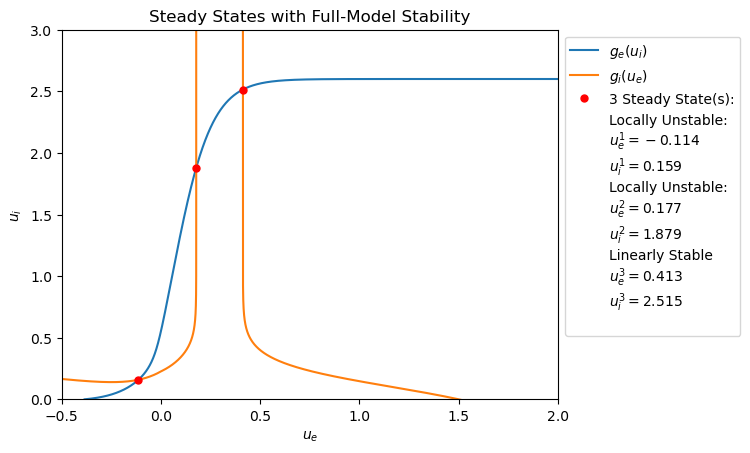

In [18]:
refresh()
param = parameterset | {"tau_i": 40, "tau_e": 20, "tau_alpha": 1200, 'g': 0.8}
I_e=1.2
I_i = 0.2
wmn_hat = Adaptation.fourier_gaussian_connectivity
Adaptation.plot_adapt_equilibrium_points(param, I_e=I_e, I_i=I_i, ue_lim=(-0.5,2), ui_lim=(0, 3), show_full_stability=True, wmn_hat=wmn_hat)

# 4) State Space

## Upper and Lower Regions

Gaussian Connectivity
Time to get points of Equilibrium: 84.276
Time for classification: 4.930


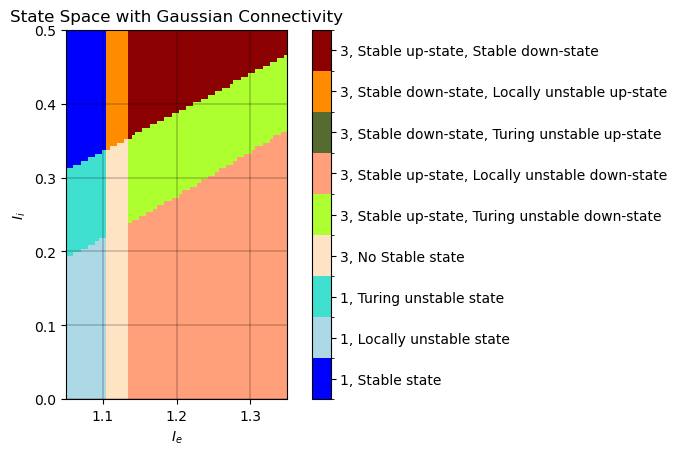

In [13]:
refresh()
param = parameterset

param["tau_e"] = 20
param["tau_i"] = 40
param["tau_alpha"] = 1200
param["g"] = 0.8

Connectivity = [
    # Adaptation.fourier_exponential_connectivity,
    Adaptation.fourier_gaussian_connectivity,
    # Adaptation.fourier_rectangular_connectivity
    ]
Connectivity_names = [
    # "Exponential Connectivity",
    "Gaussian Connectivity",
    # "Rectangular Connectivity"
    ]

dI=5e-3
# dI=1e-2
I_e_start=1.05
I_e_stop=1.35
I_i_start=0
I_i_stop=0.5
equilibrium_point_precision=5e-5
only_up_states = False
small_ticks=False
sim_mark_color = 'black'
line_color = 'black'
I_e_sim = [-1.0, 0.0, 1.5, -1.0, 0.0, 1.5, -1.0, 0.0, 1.5]
# I_e_sim = [-1.0, 0.0, 1.5]
# I_i_sim = [-2.5, -1.0, 0.0]
I_i_sim= [[-1, 0, 0.8, -2.5, -1, 0, -3, -2.5, -1]]

for wmn_hat, name in zip(Connectivity, Connectivity_names):
    print(name)
    res = Adaptation.plot_I_plane(param=param,
                                I_e_start=I_e_start,
                                I_e_stop=I_e_stop,
                                dI_e=dI,
                                only_up_states=only_up_states,
                                I_i_start=I_i_start,
                                I_i_stop=I_i_stop,
                                dI_i=dI,
                                limit=4.5,
                                plot=True,
                                show=False,
                                wmn_hat=wmn_hat,
                                small_ticks=small_ticks,
                                title = 'State Space with ' + name,
                                print_times=True,
                                return_res=True,
                                equilibrium_point_precision=equilibrium_point_precision)

Gaussian Connectivity
Time to get points of Equilibrium: 1054.657
Time for classification: 23.951


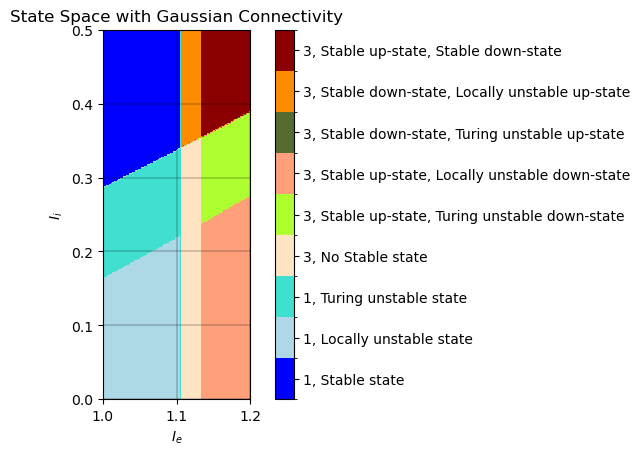

In [12]:
refresh()
param = parameterset

param["tau_e"] = 20
param["tau_i"] = 40
param["tau_alpha"] = 1200
param["g"] = 0.8

Connectivity = [
    # Adaptation.fourier_exponential_connectivity,
    Adaptation.fourier_gaussian_connectivity,
    # Adaptation.fourier_rectangular_connectivity
    ]
Connectivity_names = [
    # "Exponential Connectivity",
    "Gaussian Connectivity",
    # "Rectangular Connectivity"
    ]

dI=2e-3
# dI=1e-2
I_e_start=1.05
I_e_stop=1.35
I_i_start=0
I_i_stop=0.5
equilibrium_point_precision=2e-5
only_up_states = False
small_ticks=False
sim_mark_color = 'black'
line_color = 'black'
I_e_sim = [-1.0, 0.0, 1.5, -1.0, 0.0, 1.5, -1.0, 0.0, 1.5]
# I_e_sim = [-1.0, 0.0, 1.5]
# I_i_sim = [-2.5, -1.0, 0.0]
I_i_sim= [[-1, 0, 0.8, -2.5, -1, 0, -3, -2.5, -1]]

for wmn_hat, name in zip(Connectivity, Connectivity_names):
    print(name)
    res = Adaptation.plot_I_plane(param=param,
                                I_e_start=I_e_start,
                                I_e_stop=I_e_stop,
                                dI_e=dI,
                                only_up_states=only_up_states,
                                I_i_start=I_i_start,
                                I_i_stop=I_i_stop,
                                dI_i=dI,
                                limit=4.5,
                                plot=True,
                                show=False,
                                wmn_hat=wmn_hat,
                                small_ticks=small_ticks,
                                title = 'State Space with ' + name,
                                print_times=True,
                                return_res=True,
                                equilibrium_point_precision=equilibrium_point_precision)

# 5) Simulation

In [13]:
refresh()
def show_simulation(param,
                    connectivity,
                    I_e,
                    I_i):
     
    print('I_e: ', I_e)
    print('I_i: ', I_i)

    dx = 8e-2
    dt = 2e-1

    x_min = -5
    x_max = 5
    t_max = 50e3
   
    if connectivity == "exp":
        wmn = Adaptation.exponential_connectivity
        wmn_hat = Adaptation.fourier_exponential_connectivity
    elif connectivity == "gauss":
        wmn = Adaptation.gaussian_connectivity
        wmn_hat = Adaptation.fourier_gaussian_connectivity
    elif connectivity == "rect":
        wmn = Adaptation.rectangular_connectivity
        wmn_hat = Adaptation.fourier_rectangular_connectivity
    else:
        raise Exception("No valid Connectivity")

    perturbation_box_size = 0.4
    perturbation_strength = 0.1
    # perturbation_type = 'random'
    perturbation_type = 'box'

    limit_e = 4
    limit_i = 4

    ue_lim = (-limit_e, limit_e)
    ui_lim = (-limit_i, limit_i)

    x = np.arange(x_min, x_max + dx, dx)
    t = np.arange(0, t_max + dt, dt)
    if len(x)%2 != 0: x = x[:-1]

    ue_eqs, ui_eqs = Adaptation.get_adapt_equilibrium_points(param, I_e, I_i, improve_solution=True, ue_lim=ue_lim, ui_lim=ui_lim)

    I_range = 0.1
    dI = 5e-3

    res = Adaptation.plot_I_plane(param=param,
                                I_e_start=I_e - I_range,
                                I_e_stop=I_e + I_range,
                                dI_e=dI,
                                I_i_start=I_i - I_range,
                                I_i_stop=I_i + I_range,
                                dI_i=dI,
                                limit=limit_e,
                                plot=True,
                                wmn_hat=wmn_hat,
                                print_times=True,
                                return_res=False,
                                show=False)
    plt.axhline(y=I_i)
    plt.axvline(x=I_e)
    plt.scatter(I_e,I_i, color="green", s=20)
    plt.show()

    Adaptation.plot_adapt_equilibrium_points(param,
                                            wmn_hat=wmn_hat,
                                            I_e=I_e,
                                            I_i=I_i,
                                            ue_lim=(-1, 2),
                                            ui_lim=(-1, 4),
                                            show_full_stability=True)

    for j, (ue_eq, ui_eq) in enumerate(zip(ue_eqs, ui_eqs)):
        # if j != 2:
        #     continue
        stability = Adaptation.type_of_instability(param=param, ue_eq=ue_eq, ui_eq=ui_eq, wmn_hat=wmn_hat)
        print(f"Type of Instability: {stability}")
        if stability == ['Locally Unstable'] or stability == ['Stable']:
            print('skipped')
            print()
            continue

        ue_0 = np.zeros((len(x),))
        ui_0 = np.zeros((len(x),))
        alpha0 = np.zeros((len(x),))

        ue_0 += ue_eq
        ui_0 += ui_eq
        alpha0 += ue_eq

        # Pertubation
        if perturbation_type == "box":
            mask = abs(x) <= perturbation_box_size
            ue_0[mask] += perturbation_strength
            ui_0[mask] += perturbation_strength
            alpha0[mask] += perturbation_strength

        elif perturbation_type == "random":
            pert = (2 * np.random.rand(len(x), ) - 1) * perturbation_strength
            ue_0 += pert
            ui_0 += pert
            alpha0 += pert
        else:
            raise Exception('No valid perturbation given')

        stability = Adaptation.type_of_instability(param=param, ue_eq=ue_eq, ui_eq=ui_eq, wmn_hat=wmn_hat)
        print(f"ue_0: {ue_eq}")
        print(f"ui_0: {ui_eq}")
        print(f"alpha: {ue_eq}")

        u_e, u_i, alpha = Adaptation.create_spatial_adapt_plot(ue_0=ue_0, ui_0=ui_0, alpha0=alpha0,
                                                                I_e=I_e, I_i=I_i,
                                                                x=x, t=t,
                                                                w=wmn,
                                                                steps=10,
                                                                param=param,
                                                                fft=True, averages=False,
                                                                show_fft=False)
        
        Adaptation.plot_first_node(t=t, u_e=u_e, u_i=u_i, alpha=alpha, t_start=5, cutoff_frequency = 10)
        # t_1 = int(95 * 1000 / dt)
        # t_2 = int(100 * 1000 / dt)
        # Adaptation.wave_speed_plot(u_e[:, t_1:t_2], x, t[t_1:t_2])

    t_start = 10
    t_stop = 15
    t_new = t/1000
    if t_stop==None: t_stop=t_new[-1]
    mask = np.where((t_new >= t_start) & (t_new <= t_stop))
    t_new = t_new[mask]
    ue_first = u_e[0, :][mask]  
    ui_first = u_i[0, :][mask]
    alpha_first = alpha[0, :][mask]

    print("u_e max: ", max(ue_first), "u_e min: ", min(ue_first))
    print("u_i max: ", max(ui_first), "u_i min: ", min(ui_first))

    fig, ax1 = plt.subplots()
    ax1.plot(t_new, ue_first, 'b', label=r'$u_e$')
    ax1.set_xlabel('t [s]')
    ax1.set_ylabel('Excitatory Input Voltage', color='b')
    ax1.tick_params('y', colors='b')
    ax2 = ax1.twinx()
    ax2.plot(t_new, alpha_first, 'darkorange', label=r'$\alpha$')
    ax2.tick_params('y', colors='darkorange')
    ax2.set_ylabel('Adaptation', color='darkorange')
    fig.tight_layout()
    # fig.legend()
    plt.show()

I_e:  1.2
I_i:  0.3
Time to get points of Equilibrium: 3.288
Time for classification: 2.633


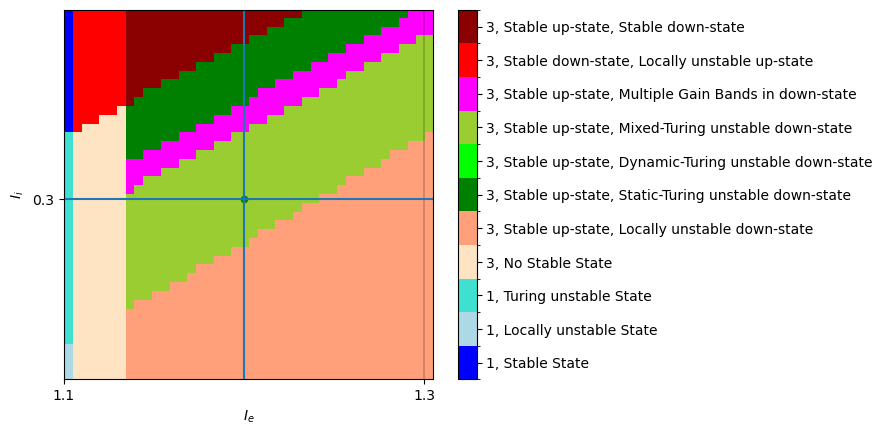

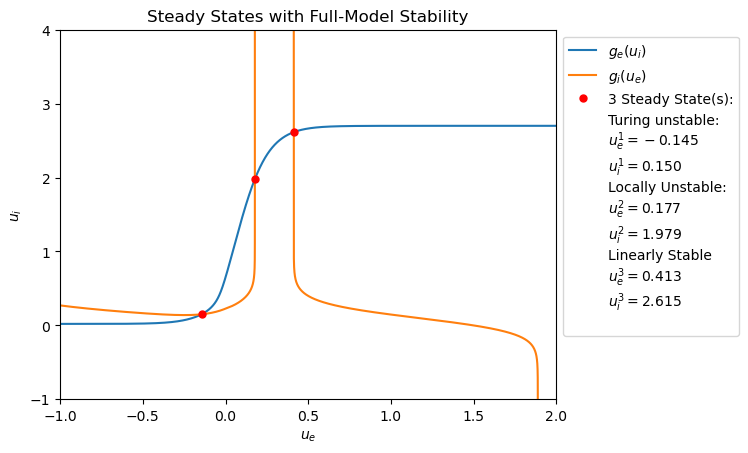

Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906991303
ui_0: 0.15006273090899575
alpha: -0.14517165906991303


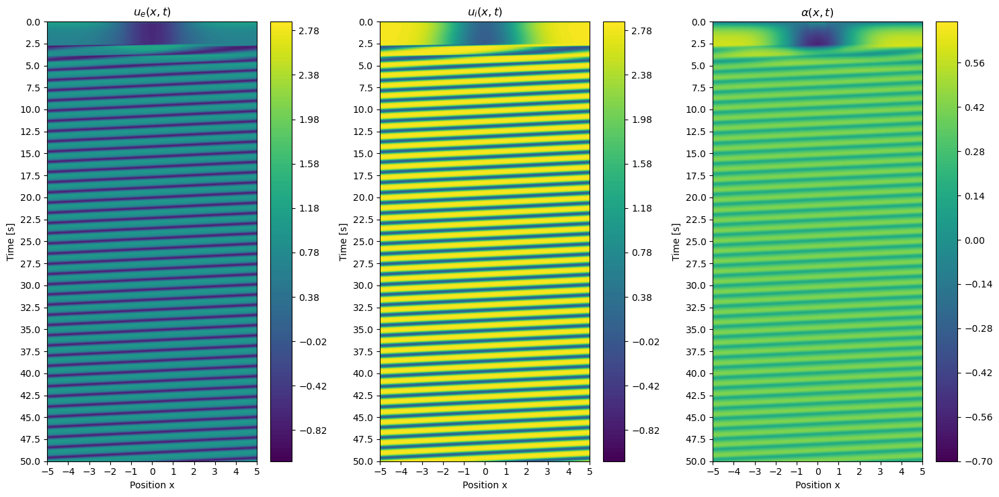

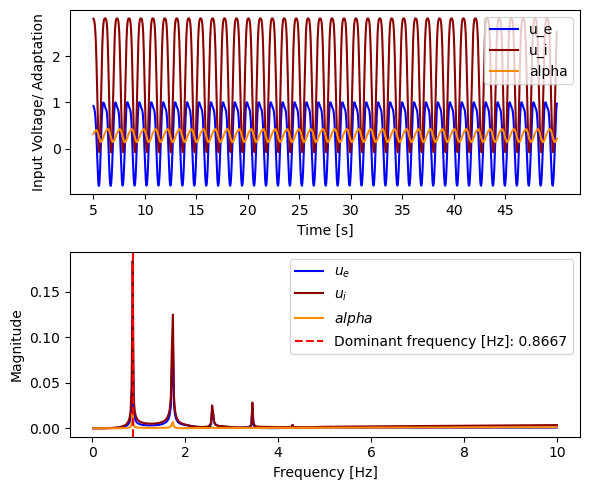

Type of Instability: ['Locally Unstable']
skipped

Type of Instability: ['Stable']
skipped

u_e max:  1.0003894381502283 u_e min:  -0.8038105110446463
u_i max:  2.8167857674025027 u_i min:  -0.08065231355383351


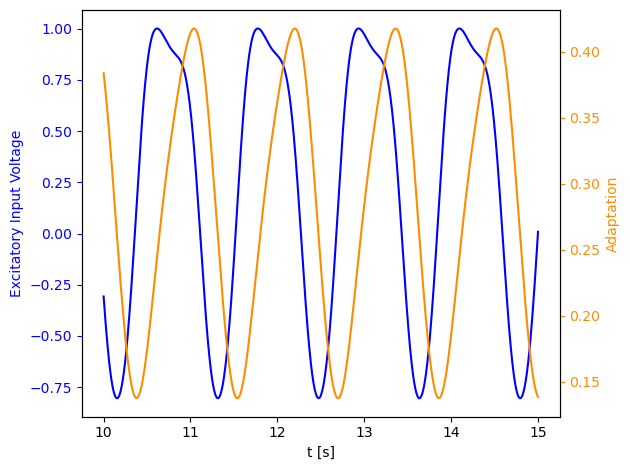

In [ ]:
refresh()
param = parameterset

param["tau_e"] = 20
param["tau_i"] = 40
param["tau_alpha"] = 1200
param["g"] = 0.8

I_e = 1.2
I_i = 0.3

show_simulation(param=param,
                connectivity=connectivity,
                I_e=I_e,
                I_i=I_i
                )

## Computation

In [5]:
def parameter_variation(
        param,
        name,
        I_e,
        I_i,
        variable,
        variable_start,
        variable_stop,
        steps,
        skip=True,
        connectivity='gauss',
        perturbation_type = 'box',
        perturbation_box_size = 0.4,
        perturbation_strength = 0.05,
        step_solver=Adaptation.spatial_adapt_Runge_Kutta,
        t_max = 25000,
        dt = 1e-1,
        t_start = 50,
        dx = 8e-2,
        I_range = 0.1,
        dI= 5e-3
        ):
    
    if connectivity == "exp":
        wmn = Adaptation.exponential_connectivity
        wmn_hat = Adaptation.fourier_exponential_connectivity
    elif connectivity == "gauss":
        wmn = Adaptation.gaussian_connectivity
        wmn_hat = Adaptation.fourier_gaussian_connectivity
    elif connectivity == "rect":
        wmn = Adaptation.rectangular_connectivity
        wmn_hat = Adaptation.fourier_rectangular_connectivity
    else:
        raise Exception("No valid Connectivity")
    
    limit_e = 4
    limit_i = 4

    ue_lim = (-limit_e, limit_e)
    ui_lim = (-limit_i, limit_i)

    x_min = -5
    x_max = 5

    x = np.arange(x_min, x_max + dx, dx)
    t = np.arange(0, t_max + dt, dt)
    if len(x)%2 != 0: x = x[:-1]

    print('I_e: ', I_e)
    print('I_i: ', I_i)
    print('Variable: ', variable)

    ue_eqs, ui_eqs = Adaptation.get_adapt_equilibrium_points(param,
                                                             I_e,
                                                             I_i,
                                                             improve_solution=True,
                                                             ue_lim=ue_lim,
                                                             ui_lim=ui_lim)
    print(ue_eqs)

    Adaptation.plot_I_plane(param=param,
                           I_e_start=I_e - I_range,
                           I_e_stop=I_e + I_range,
                           dI_e=dI,
                           I_i_start=I_i - I_range,
                           I_i_stop=I_i + I_range,
                           dI_i=dI,
                           limit=limit_e,
                           plot=True,
                           wmn_hat=wmn_hat,
                           print_times=True,
                           small_ticks=False,
                           return_res=False,
                           show=False)
    plt.axhline(y=I_i)
    plt.axvline(x=I_e)
    plt.scatter(I_e, I_i, color="green", s=20)
    plt.show()
    
    variable_list = np.linspace(variable_start, variable_stop, steps)
    frequency_list = np.zeros_like(variable_list)
    amplitude_list_e = np.zeros_like(variable_list)
    amplitude_list_i = np.zeros_like(variable_list)
    amplitude_list_alpha = np.zeros_like(variable_list)
    midpoint_list_e = np.zeros_like(variable_list)
    midpoint_list_i = np.zeros_like(variable_list)
    midpoint_list_eq_i = np.zeros_like(variable_list)
    midpoint_list_eq_e = np.zeros_like(variable_list)
    
    result = {
        "variable": variable,
        "variable_values": variable_list,
        'frequencies': frequency_list,
        'amplitude_e': amplitude_list_e,
        'amplitude_i': amplitude_list_i,
        'amplitude_alpha': amplitude_list_alpha,
        'midpoint_e': midpoint_list_e,
        'midpoint_i': midpoint_list_i,
        'midpoint_eq_e': midpoint_list_eq_e,
        'midpoint_eq_i': midpoint_list_eq_i
    }

    with h5py.File(name, 'a') as f:

        check_calculated_values = False
        if "variable_values" in f:
            if (result["variable_values"] == np.array(f["variable_values"][()]) ).all():
                check_calculated_values = True
        if check_calculated_values == False:
            for key, value in result.items():
                if key in f:
                    del f[key]
                f.create_dataset(key, data=value)

        for idx, variable_value in enumerate(variable_list):
            if float(f["frequencies"][idx]) == 0.0:
                param[variable] = variable_value
                print()
                print(variable, " = ", variable_value)
                print(idx + 1, ' / ', len(variable_list))
                ue_eqs, ui_eqs = Adaptation.get_adapt_equilibrium_points(param,
                                                                         I_e,
                                                                         I_i,
                                                                         improve_solution=True,
                                                                         ue_lim=ue_lim,
                                                                         ui_lim=ui_lim)
                
                for j, (ue_eq, ui_eq) in enumerate(zip(ue_eqs, ui_eqs)):
                    # if j != 2:
                    #     continue
                    stability = Adaptation.type_of_instability(param=param, ue_eq=ue_eq, ui_eq=ui_eq, wmn_hat=wmn_hat)
                    if skip:
                        if stability == ['Locally Unstable'] or stability == ['Stable']:
                            # print('skipped')
                            # print()
                            continue
                    print(f"Type of Instability: {stability}")

                    ue_0 = np.zeros((len(x),))
                    ui_0 = np.zeros((len(x),))
                    alpha0 = np.zeros((len(x),))

                    ue_0 += ue_eq
                    ui_0 += ui_eq
                    alpha0 += ue_eq

                    # Pertubation
                    if perturbation_type == "box":
                        mask = abs(x) <= perturbation_box_size
                        ue_0[mask] += perturbation_strength
                        ui_0[mask] += perturbation_strength
                        alpha0[mask] += perturbation_strength

                    elif perturbation_type == "random":
                        np.random.seed(42)
                        pert1 = (2 * np.random.rand(len(x), ) - 1) * perturbation_strength
                        pert2 = (2 * np.random.rand(len(x), ) - 1) * perturbation_strength
                        pert3 = (2 * np.random.rand(len(x), ) - 1) * perturbation_strength
                        ue_0 += pert1
                        ui_0 += pert2
                        alpha0 += pert3
                    else:
                        raise Exception('No valid perturbation given')

                    stability = Adaptation.type_of_instability(param=param, ue_eq=ue_eq, ui_eq=ui_eq, wmn_hat=wmn_hat)
                    print(f"ue_0: {ue_eq}")
                    print(f"ui_0: {ui_eq}")
                    print(f"alpha: {ue_eq}")
                    
                    u_e, u_i, alpha = Adaptation.spatial_adapt_num_solver(ue_0=ue_0, ui_0=ui_0, alpha0=alpha0,
                                                                         I_e=I_e, I_i=I_i,
                                                                         x=x, t=t,
                                                                         w=wmn,
                                                                         param=param,
                                                                         fft=True,
                                                                         spatial_step_solver=step_solver)
                    Adaptation.plot_first_node(t=t, u_e=u_e, u_i=u_i, alpha=alpha, t_start=t_start, cutoff_frequency = 8)
                    t_new = t/1000
                    mask = np.where((t_new >= t_start))
                    t_new = t_new[mask]
                    ue_first = u_e[0, :][mask]
                    frequency_list[idx] = Adaptation.frequency_zero_crossing(ue_first, t_new)
                    t_start_amp = np.max(t_new) - 20
                    mask = np.where((t_new >= t_start_amp))
                    t_new = t_new[mask]
                    ui_first = u_i[0, :][mask]
                    alpha_first = alpha[0, :][mask]
                    amplitude_list_e[idx] = np.max(ue_first) - np.min(ue_first)
                    amplitude_list_i[idx] = np.max(ui_first) - np.min(ui_first)
                    amplitude_list_alpha[idx] = np.max(alpha_first) - np.min(alpha_first)

                    midpoint_list_e[idx] = (np.max(ue_first) + np.min(ue_first))/2
                    midpoint_list_i[idx] = (np.max(ui_first) + np.min(ui_first))/2
                    midpoint_list_eq_e[idx] = (ue_eqs[2] + ue_eqs[0])/2
                    midpoint_list_eq_i[idx] = (ui_eqs[2] + ui_eqs[0])/2

                    f['frequencies'][idx] = frequency_list[idx]
                    f['amplitude_e'][idx] = amplitude_list_e[idx]
                    f['amplitude_i'][idx] = amplitude_list_i[idx]
                    f['amplitude_alpha'][idx] = amplitude_list_alpha[idx]
                    f['midpoint_e'][idx] = midpoint_list_e[idx]
                    f['midpoint_i'][idx] = midpoint_list_i[idx]
                    f['midpoint_eq_e'][idx] = midpoint_list_eq_e[idx]
                    f['midpoint_eq_i'][idx] = midpoint_list_eq_i[idx]

                    print("Frequency: ", frequency_list[idx])
                    print("Amplitude: ", amplitude_list_e[idx])
                    print('Midpoint Oscillation e: ', midpoint_list_e[idx])
                    print('Midpoint Equilibrium e: ', midpoint_list_eq_e[idx])
            else:
                print("Skipped, already run")
                print("frequency: ", f["frequencies"][idx])
    return result

### Adaptation Strength

I_e:  1.2
I_i:  0.3
Variable:  g
[-0.14517166  0.17749262  0.41281642]
Time to get points of Equilibrium: 3.425
Time for classification: 2.848


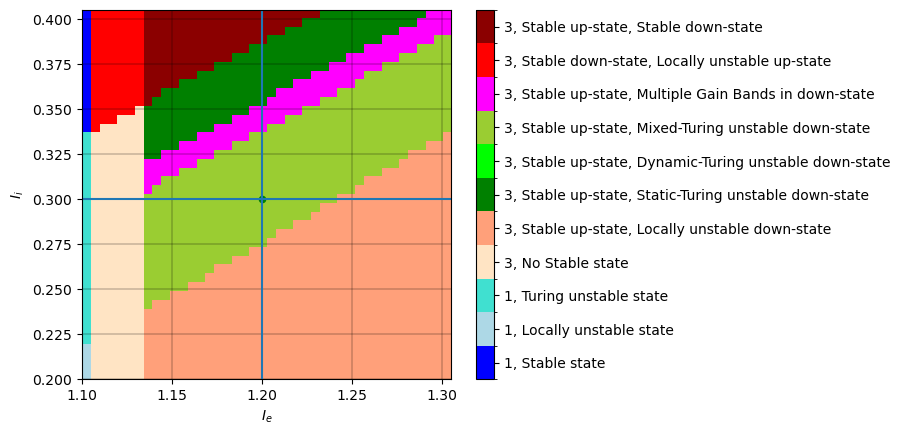

Skipped, already run
frequency:  0.23125
Skipped, already run
frequency:  0.25
Skipped, already run
frequency:  0.2625
Skipped, already run
frequency:  0.275
Skipped, already run
frequency:  0.2875
Skipped, already run
frequency:  0.29375
Skipped, already run
frequency:  0.3125
Skipped, already run
frequency:  0.325
Skipped, already run
frequency:  0.3375
Skipped, already run
frequency:  0.35
Skipped, already run
frequency:  0.35625
Skipped, already run
frequency:  0.3625
Skipped, already run
frequency:  0.375
Skipped, already run
frequency:  0.3875
Skipped, already run
frequency:  0.39375
Skipped, already run
frequency:  0.40625
Skipped, already run
frequency:  0.4125
Skipped, already run
frequency:  0.425
Skipped, already run
frequency:  0.4375
Skipped, already run
frequency:  0.44375
Skipped, already run
frequency:  0.45625
Skipped, already run
frequency:  0.4625
Skipped, already run
frequency:  0.475
Skipped, already run
frequency:  0.4875
Skipped, already run
frequency:  0.49375
S

In [6]:
refresh()
param = parameterset

param["tau_e"] = 20
param["tau_i"] = 40
param["tau_alpha"] = 1200
param["g"] = 0.8

I_e = 1.2
I_i = 0.3

perturbation_type = 'random'
# perturbation_type = 'box'
perturbation_box_size = 0.4
perturbation_strength = 0.01

connectivity = 'gauss'

dt=2e-1
t_max=100e3
t_start = 20

variable = 'g'
variable_start=0.1
variable_stop=1.05
steps=100

name = 'Simulation_Data/gauss_result_g'
gauss_result_g = parameter_variation(
                              param=param,
                              name=name,
                              I_e=I_e,
                              I_i=I_i,
                              variable=variable,
                              variable_start=variable_start,
                              connectivity=connectivity,
                              perturbation_type=perturbation_type,
                              perturbation_strength=perturbation_strength,
                              perturbation_box_size=perturbation_box_size,
                              variable_stop=variable_stop,
                              steps=steps,
                              t_max=t_max,
                              t_start=t_start,
                              dt=dt,
                              )

I_e:  1.2
I_i:  0.3
Variable:  g
[-0.14517166  0.17749262  0.41281642]
Time to get points of Equilibrium: 3.457
Time for classification: 4.009


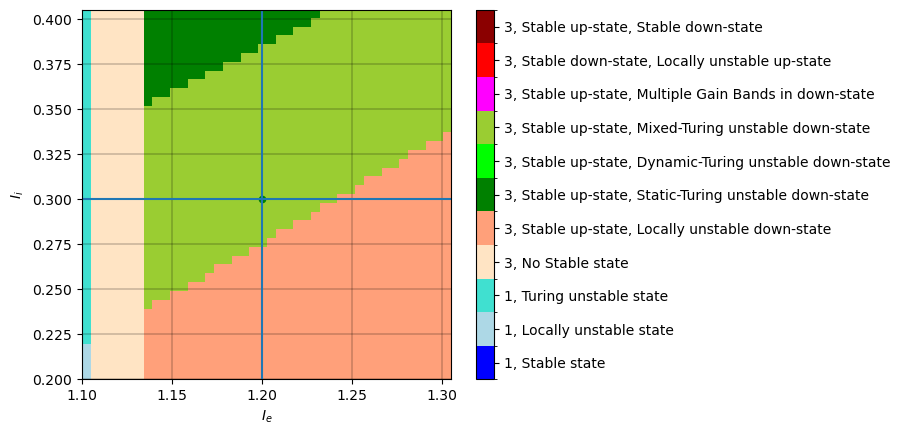


g  =  0.1
1  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990473
ui_0: 0.15006273090899755
alpha: -0.14517165906990473


/Users/felixstoffregen/Library/Mobile Documents/com~apple~CloudDocs/Studium/Master/Masterarbeit/Neural_Field_Model/Adaptation_Functions/A0Basic_Functions.py:88: RuntimeWarning: invalid value encountered in divide
  result = np.where(np.isclose(denominator, 0), nu, np.sin(denominator) / denominator)


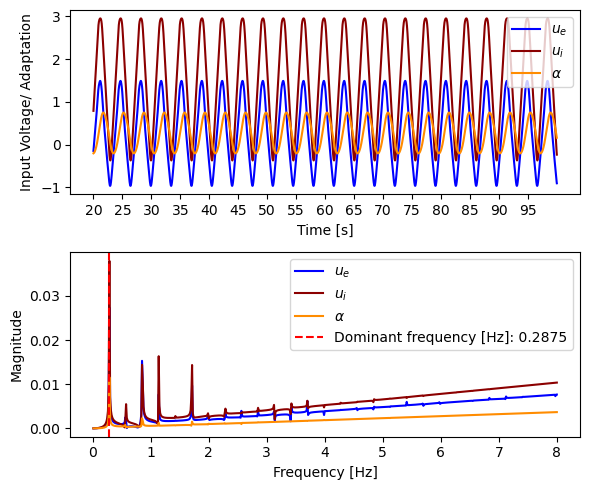

Frequency:  0.2875
Amplitude:  2.4554678290498217
Midpoint Oscillation e:  0.2609190857294228
Midpoint Equilibrium e:  0.28988023064310464

g  =  0.10959595959595961
2  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


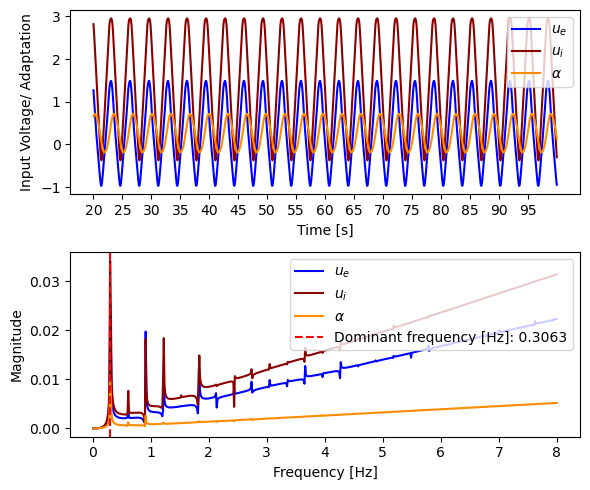

Frequency:  0.30625
Amplitude:  2.4587887436637432
Midpoint Oscillation e:  0.26052583610375174
Midpoint Equilibrium e:  0.28666869889985974

g  =  0.1191919191919192
3  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


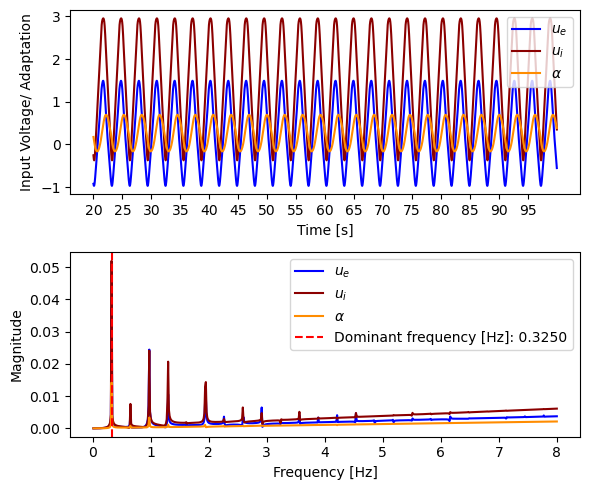

Frequency:  0.325
Amplitude:  2.4618290688239632
Midpoint Oscillation e:  0.2600778547436267
Midpoint Equilibrium e:  0.28350853702882817

g  =  0.12878787878787878
4  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


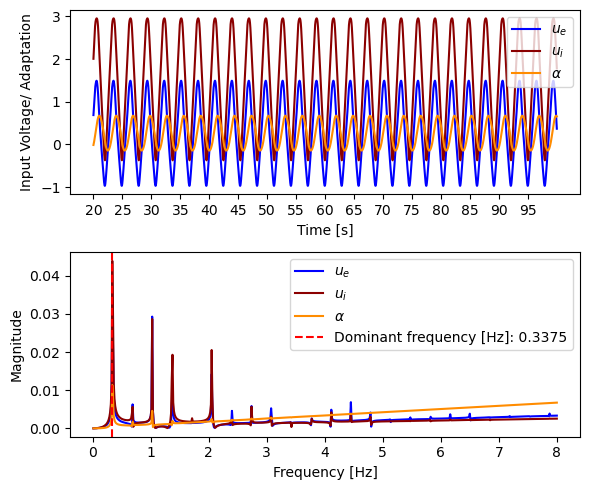

Frequency:  0.3375
Amplitude:  2.4645990218780804
Midpoint Oscillation e:  0.2596016288503922
Midpoint Equilibrium e:  0.28039832546358595

g  =  0.1383838383838384
5  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


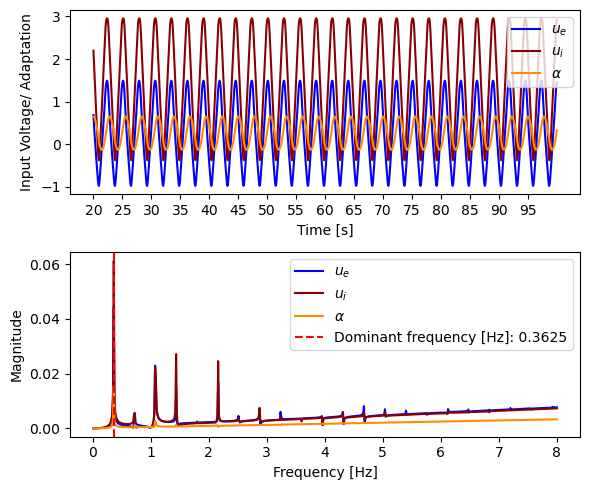

Frequency:  0.3625
Amplitude:  2.467184186739479
Midpoint Oscillation e:  0.25908100560134706
Midpoint Equilibrium e:  0.2773366914433826

g  =  0.147979797979798
6  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


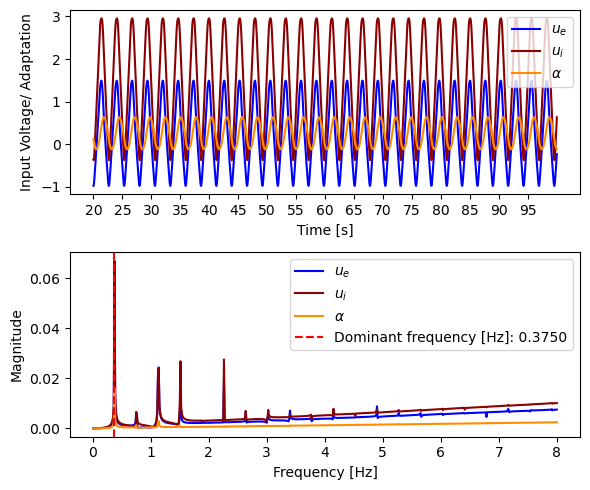

Frequency:  0.375
Amplitude:  2.46958664923992
Midpoint Oscillation e:  0.25853272274917105
Midpoint Equilibrium e:  0.2743223070509888

g  =  0.1575757575757576
7  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


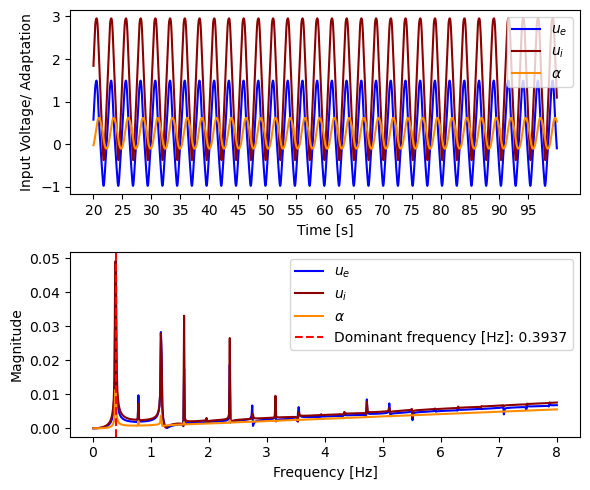

Frequency:  0.39375
Amplitude:  2.471826288234661
Midpoint Oscillation e:  0.25796154266033444
Midpoint Equilibrium e:  0.27135388734438726

g  =  0.1671717171717172
8  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


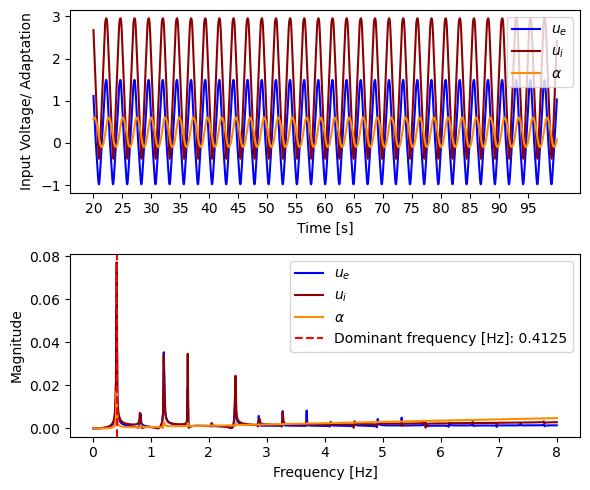

Frequency:  0.4125
Amplitude:  2.473905710378226
Midpoint Oscillation e:  0.2573644059487777
Midpoint Equilibrium e:  0.26843018857685375

g  =  0.1767676767676768
9  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


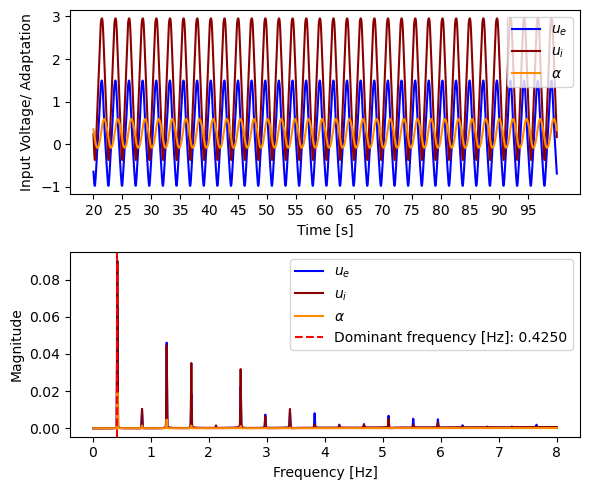

Frequency:  0.425
Amplitude:  2.4758629989977923
Midpoint Oscillation e:  0.25675669006274415
Midpoint Equilibrium e:  0.265550006500325

g  =  0.1863636363636364
10  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


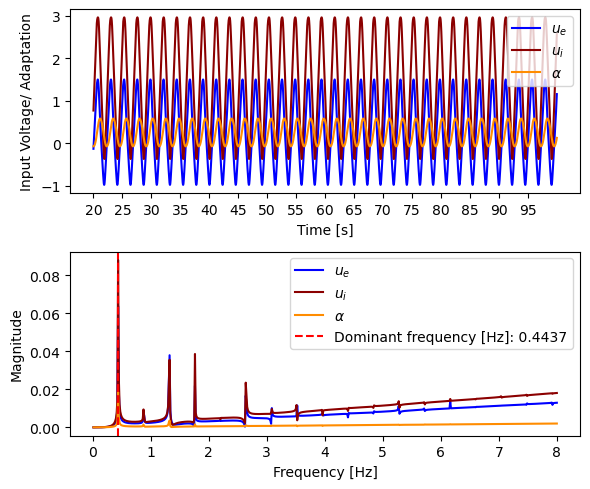

Frequency:  0.44375
Amplitude:  2.4777005516937782
Midpoint Oscillation e:  0.25613614614962626
Midpoint Equilibrium e:  0.26271217474727543

g  =  0.19595959595959597
11  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


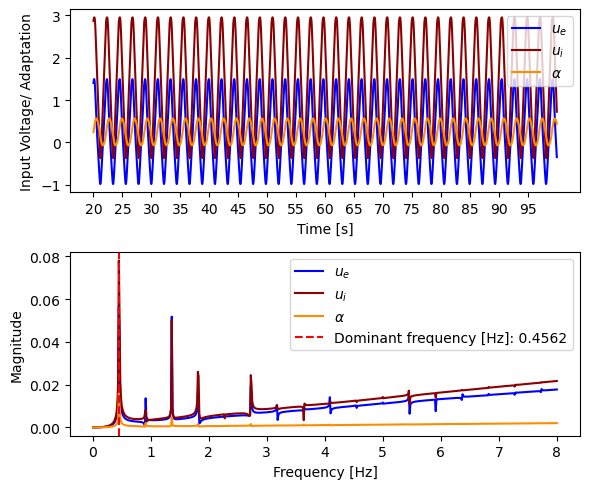

Frequency:  0.45625
Amplitude:  2.479428613335296
Midpoint Oscillation e:  0.25550513984643514
Midpoint Equilibrium e:  0.25991556328663645

g  =  0.20555555555555557
12  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


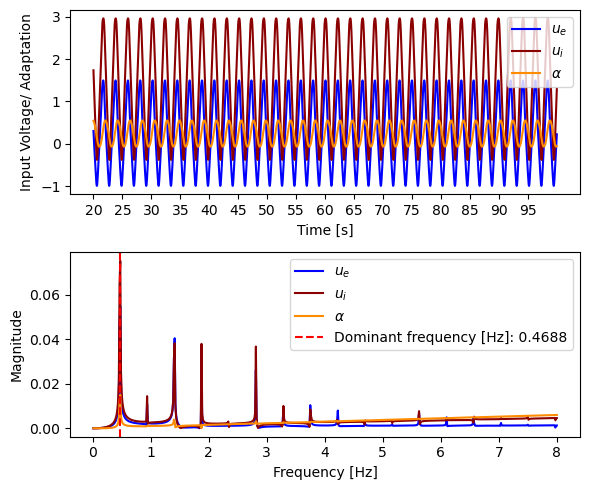

Frequency:  0.46875
Amplitude:  2.4810562145084942
Midpoint Oscillation e:  0.2548656704518464
Midpoint Equilibrium e:  0.25715907694956336

g  =  0.21515151515151518
13  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


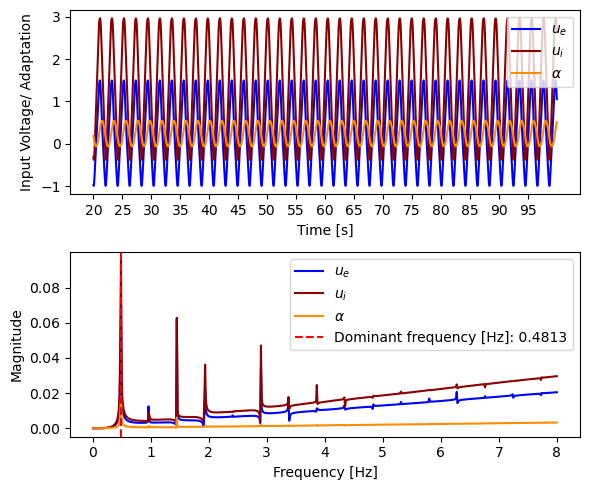

Frequency:  0.48125
Amplitude:  2.4825915424198235
Midpoint Oscillation e:  0.25421933935295343
Midpoint Equilibrium e:  0.25444165402112456

g  =  0.22474747474747475
14  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


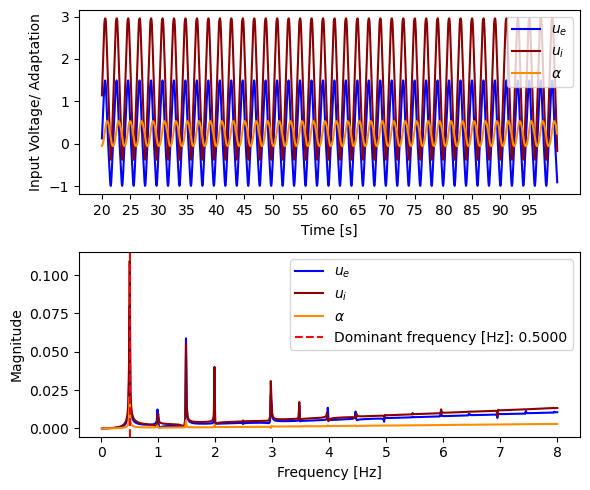

Frequency:  0.5
Amplitude:  2.4840401322574026
Midpoint Oscillation e:  0.2535686181859842
Midpoint Equilibrium e:  0.2517622648942182

g  =  0.23434343434343435
15  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


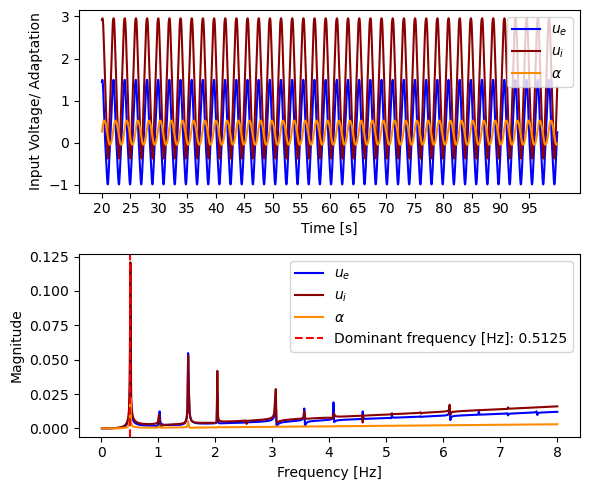

Frequency:  0.5125
Amplitude:  2.4854113317425917
Midpoint Oscillation e:  0.25291312870444754
Midpoint Equilibrium e:  0.24911991078225476

g  =  0.24393939393939396
16  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


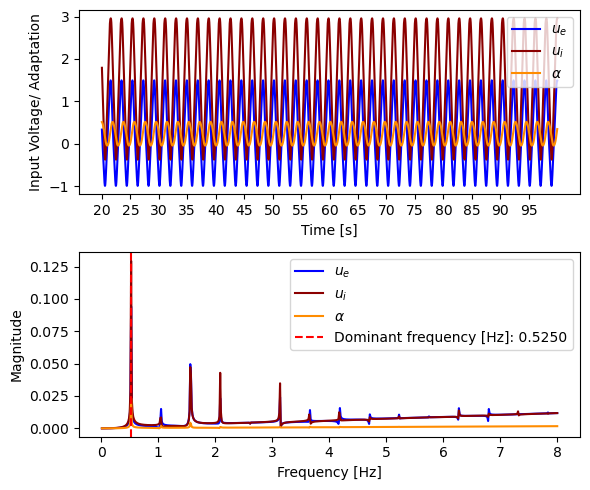

Frequency:  0.525
Amplitude:  2.486709578078526
Midpoint Oscillation e:  0.25225484119002656
Midpoint Equilibrium e:  0.24651362248733893

g  =  0.25353535353535356
17  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


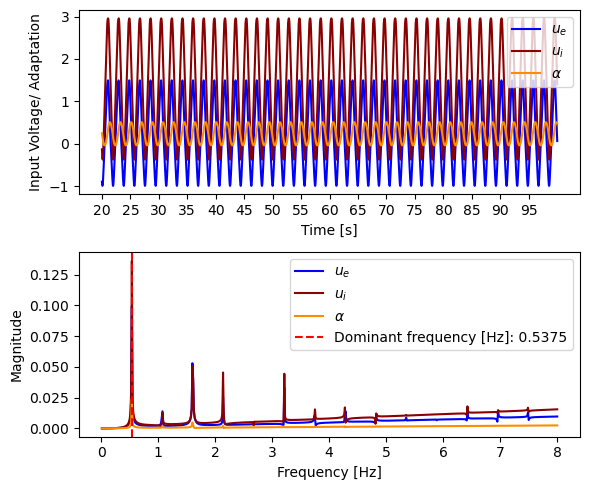

Frequency:  0.5375
Amplitude:  2.487940237851424
Midpoint Oscillation e:  0.25159472378604214
Midpoint Equilibrium e:  0.24394245922088625

g  =  0.26313131313131316
18  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


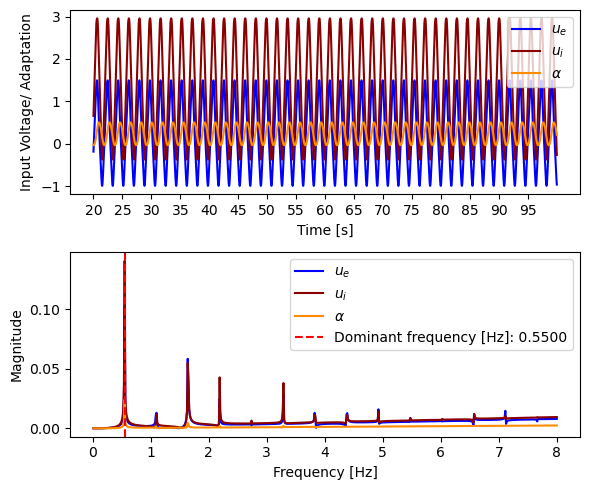

Frequency:  0.55
Amplitude:  2.4891064590915577
Midpoint Oscillation e:  0.2509347309750325
Midpoint Equilibrium e:  0.2414055074737767

g  =  0.27272727272727276
19  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


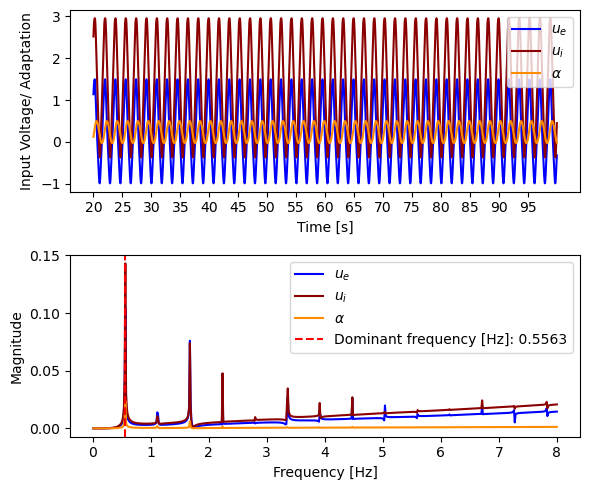

Frequency:  0.55625
Amplitude:  2.490216005089043
Midpoint Oscillation e:  0.25027393917738067
Midpoint Equilibrium e:  0.23890187993332163

g  =  0.2823232323232323
20  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


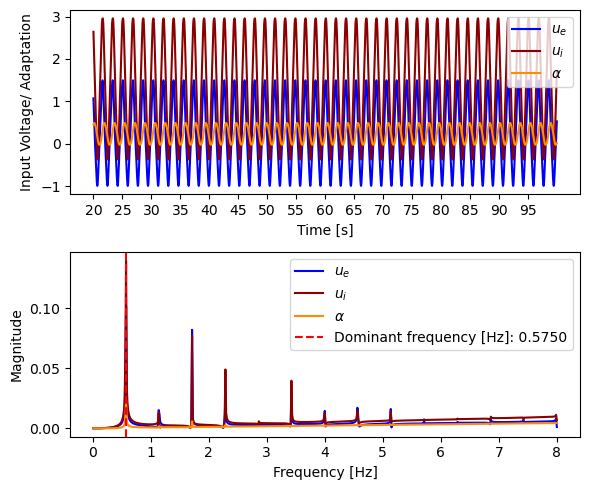

Frequency:  0.575
Amplitude:  2.4912712107070556
Midpoint Oscillation e:  0.24961393850184554
Midpoint Equilibrium e:  0.23643071444445896

g  =  0.2919191919191919
21  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


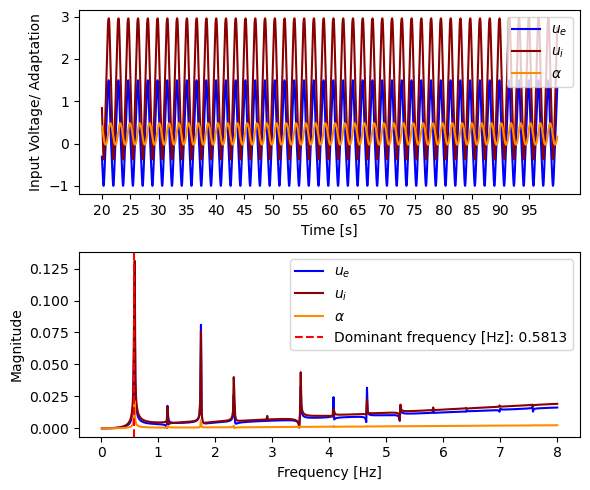

Frequency:  0.58125
Amplitude:  2.4922760911854156
Midpoint Oscillation e:  0.24895572333100957
Midpoint Equilibrium e:  0.23399117301274658

g  =  0.3015151515151515
22  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


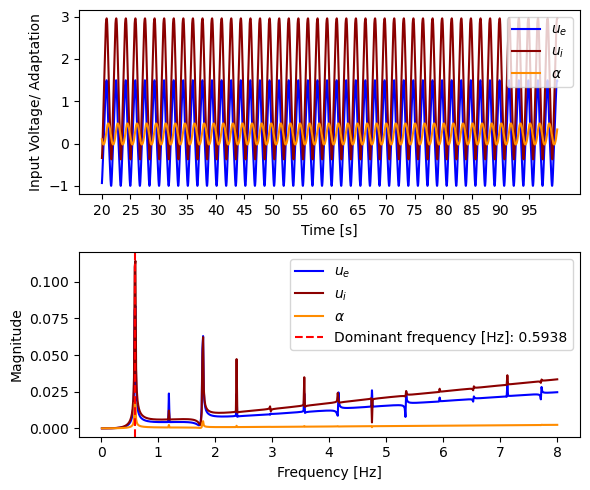

Frequency:  0.59375
Amplitude:  2.4932340796052874
Midpoint Oscillation e:  0.24829988758076738
Midpoint Equilibrium e:  0.2315824408468406

g  =  0.3111111111111111
23  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


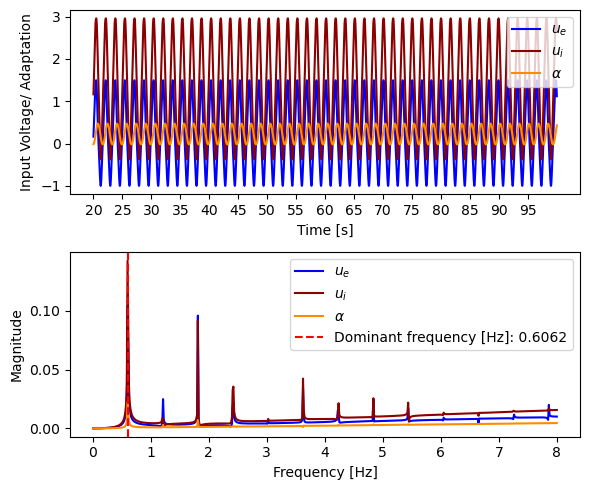

Frequency:  0.60625
Amplitude:  2.494148449055607
Midpoint Oscillation e:  0.24764714824946676
Midpoint Equilibrium e:  0.22920372543827183

g  =  0.3207070707070707
24  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


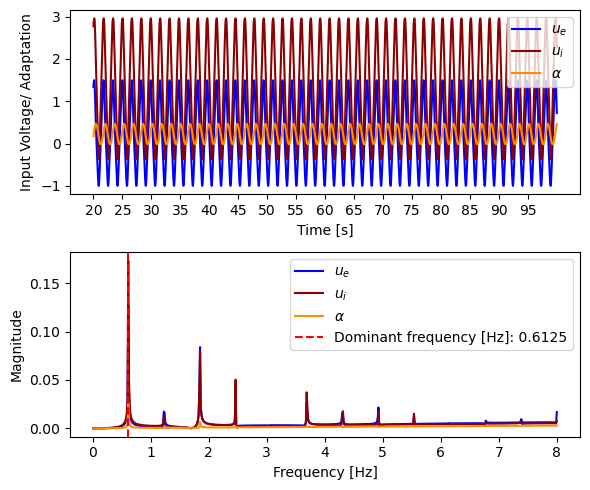

Frequency:  0.6125
Amplitude:  2.495022233449284
Midpoint Oscillation e:  0.2469983868711061
Midpoint Equilibrium e:  0.22685425567644718

g  =  0.3303030303030303
25  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


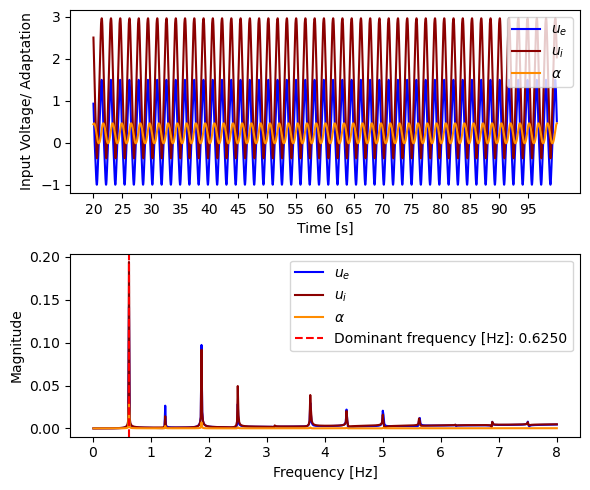

Frequency:  0.625
Amplitude:  2.4958574545323726
Midpoint Oscillation e:  0.24635410720966933
Midpoint Equilibrium e:  0.22453328099689168

g  =  0.3398989898989899
26  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


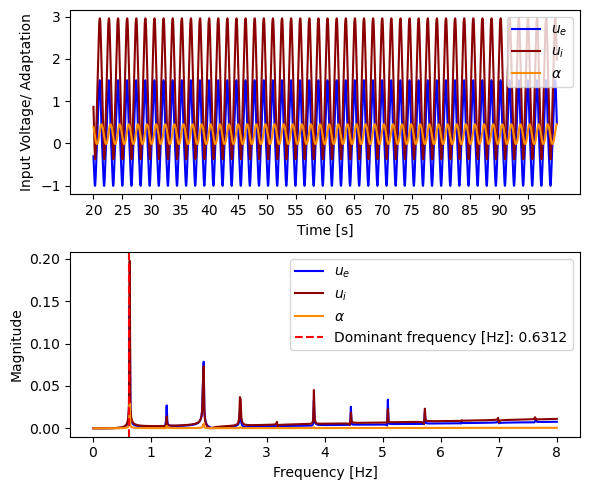

Frequency:  0.63125
Amplitude:  2.496657822702245
Midpoint Oscillation e:  0.245715306750533
Midpoint Equilibrium e:  0.22224007056086137

g  =  0.3494949494949495
27  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


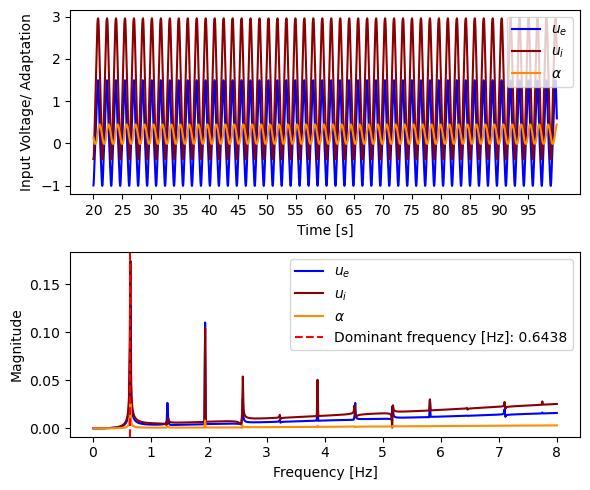

Frequency:  0.64375
Amplitude:  2.4974250254638184
Midpoint Oscillation e:  0.2450825662552537
Midpoint Equilibrium e:  0.2199739124645167

g  =  0.3590909090909091
28  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


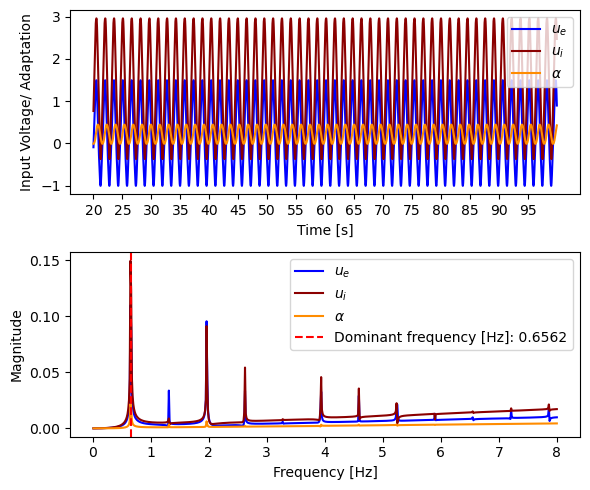

Frequency:  0.65625
Amplitude:  2.498160710298168
Midpoint Oscillation e:  0.24445679042315038
Midpoint Equilibrium e:  0.21773411297595752

g  =  0.36868686868686873
29  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


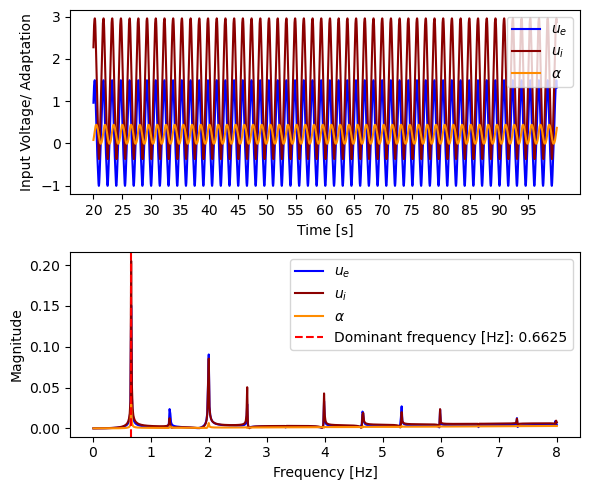

Frequency:  0.6625
Amplitude:  2.4988667835264913
Midpoint Oscillation e:  0.2438385917544449
Midpoint Equilibrium e:  0.2155199957984557

g  =  0.37828282828282833
30  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


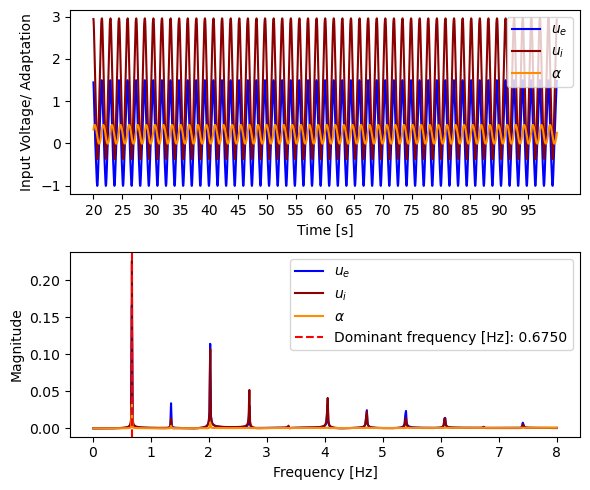

Frequency:  0.675
Amplitude:  2.499544730647969
Midpoint Oscillation e:  0.24322858263628888
Midpoint Equilibrium e:  0.21333090135831906

g  =  0.38787878787878793
31  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


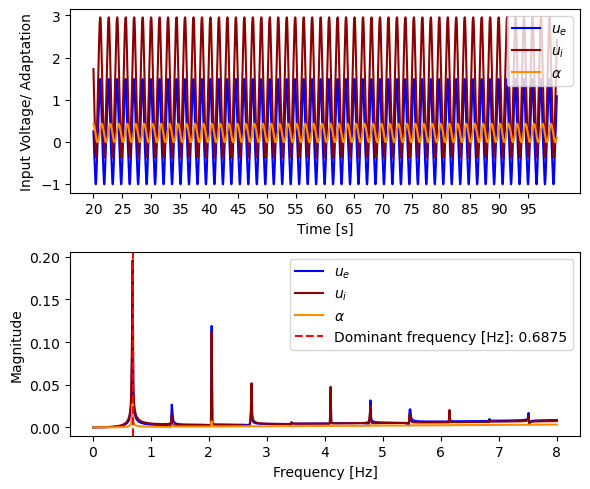

Frequency:  0.6875
Amplitude:  2.5001961913370168
Midpoint Oscillation e:  0.24262747058596568
Midpoint Equilibrium e:  0.21116618611586835

g  =  0.39747474747474754
32  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


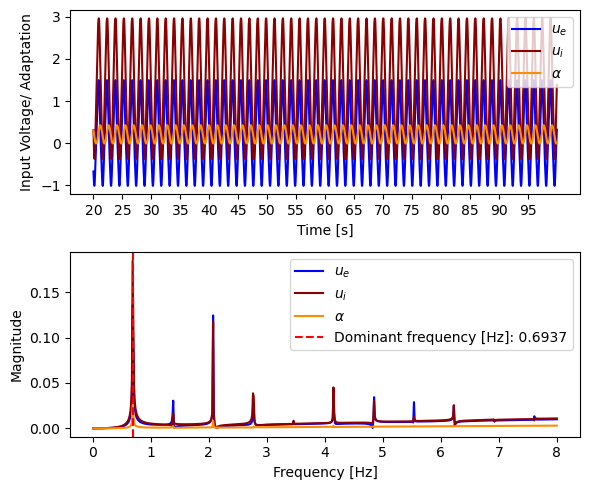

Frequency:  0.69375
Amplitude:  2.5008212236108283
Midpoint Oscillation e:  0.24203615883226193
Midpoint Equilibrium e:  0.20902522189802564

g  =  0.40707070707070714
33  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


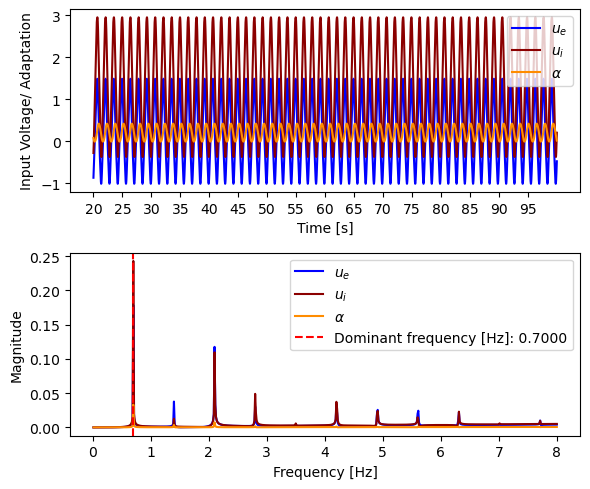

Frequency:  0.7
Amplitude:  2.501421006579764
Midpoint Oscillation e:  0.24145524944572638
Midpoint Equilibrium e:  0.20690739525116042

g  =  0.41666666666666674
34  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


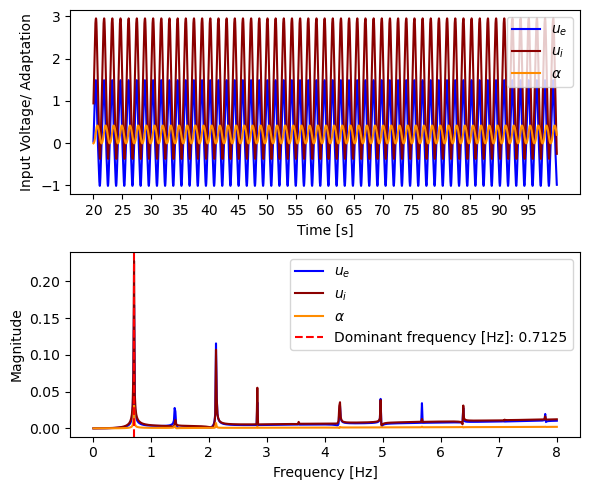

Frequency:  0.7125
Amplitude:  2.501996327290947
Midpoint Oscillation e:  0.24088510590292112
Midpoint Equilibrium e:  0.20481210681271667

g  =  0.42626262626262634
35  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


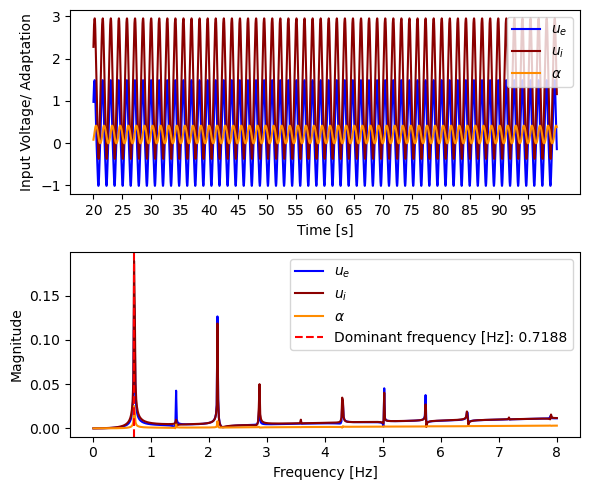

Frequency:  0.71875
Amplitude:  2.5025477060322
Midpoint Oscillation e:  0.2403262563900781
Midpoint Equilibrium e:  0.20273877070038082

g  =  0.43585858585858595
36  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


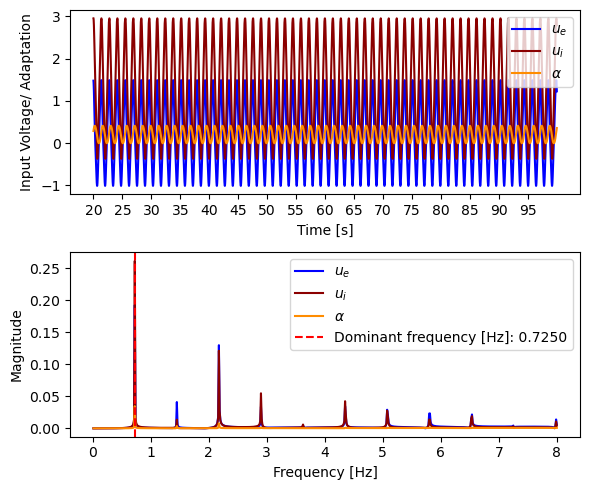

Frequency:  0.725
Amplitude:  2.503075021557473
Midpoint Oscillation e:  0.23977944368842607
Midpoint Equilibrium e:  0.20068681391736237

g  =  0.44545454545454555
37  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


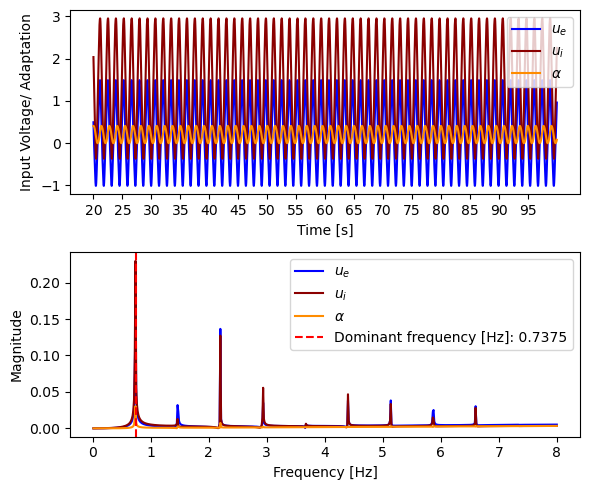

Frequency:  0.7375
Amplitude:  2.503578904733147
Midpoint Oscillation e:  0.2392450580684976
Midpoint Equilibrium e:  0.19865567577260285

g  =  0.45505050505050515
38  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


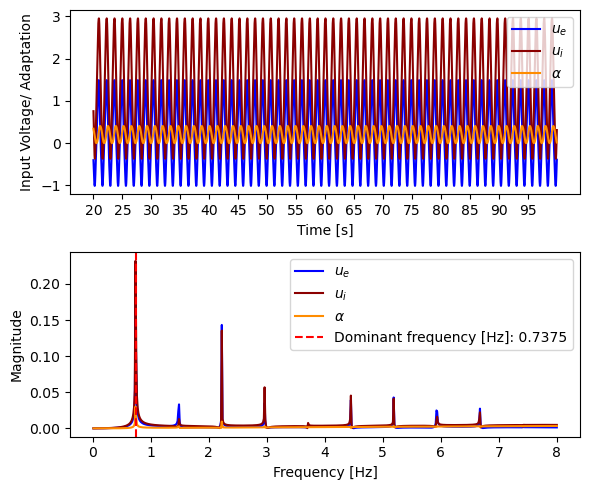

Frequency:  0.7375
Amplitude:  2.504060626683099
Midpoint Oscillation e:  0.23872320465966446
Midpoint Equilibrium e:  0.19664480731452222

g  =  0.46464646464646464
39  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


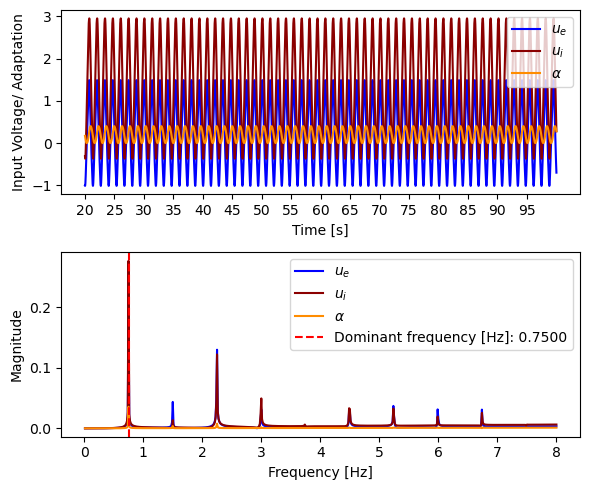

Frequency:  0.75
Amplitude:  2.504521486158014
Midpoint Oscillation e:  0.23821442707291596
Midpoint Equilibrium e:  0.1946536707771414

g  =  0.47424242424242424
40  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


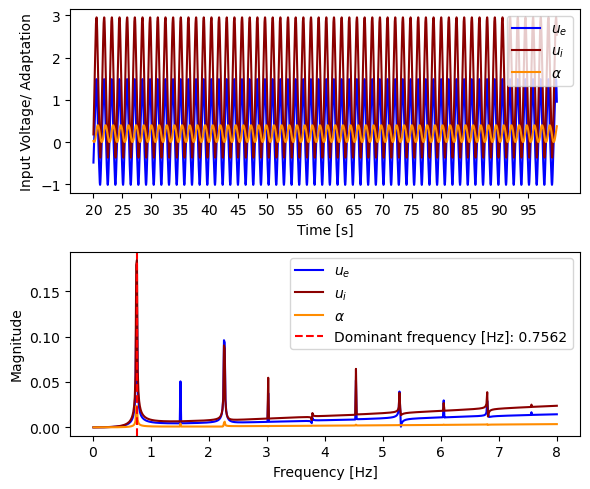

Frequency:  0.75625
Amplitude:  2.504963497092029
Midpoint Oscillation e:  0.2377215755136034
Midpoint Equilibrium e:  0.1926817390372364

g  =  0.48383838383838385
41  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


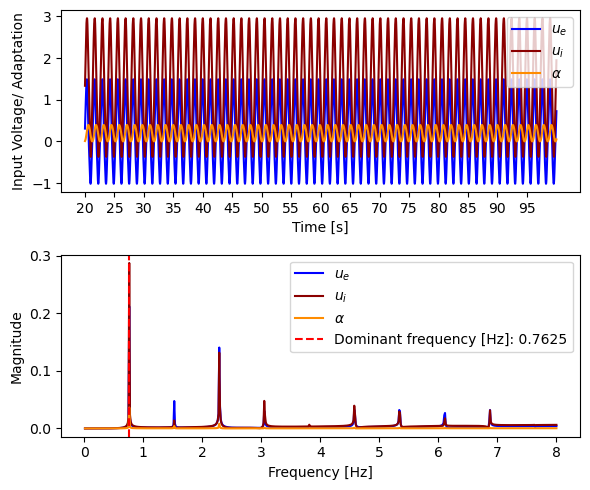

Frequency:  0.7625
Amplitude:  2.5053882391802462
Midpoint Oscillation e:  0.23724637222288014
Midpoint Equilibrium e:  0.19072849508130407

g  =  0.49343434343434345
42  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


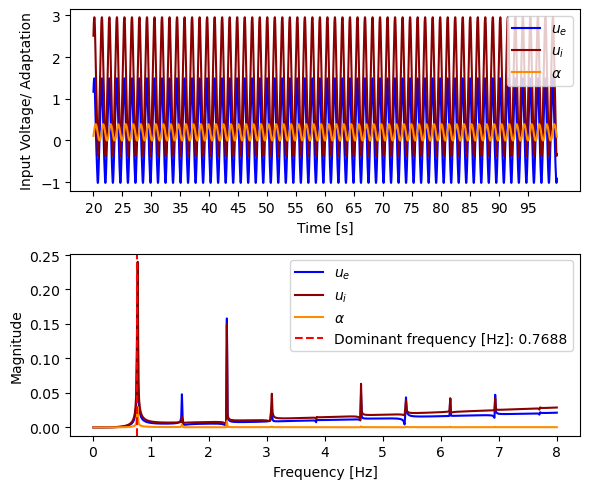

Frequency:  0.76875
Amplitude:  2.5057907429176844
Midpoint Oscillation e:  0.23676870447082465
Midpoint Equilibrium e:  0.1887934314810472

g  =  0.503030303030303
43  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


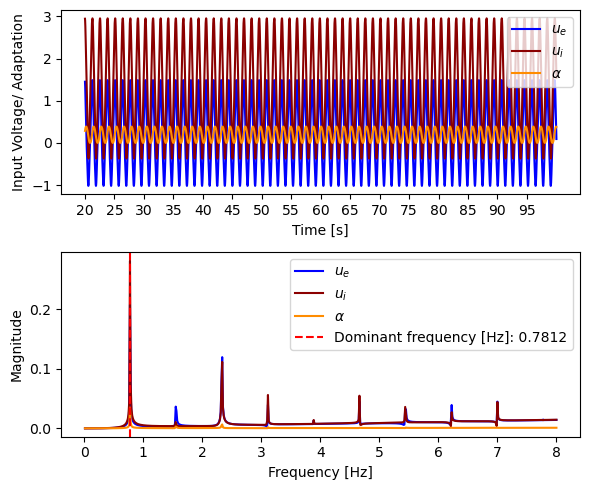

Frequency:  0.78125
Amplitude:  2.5061718470178675
Midpoint Oscillation e:  0.2362883610425729
Midpoint Equilibrium e:  0.18687604987609552

g  =  0.5126262626262627
44  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


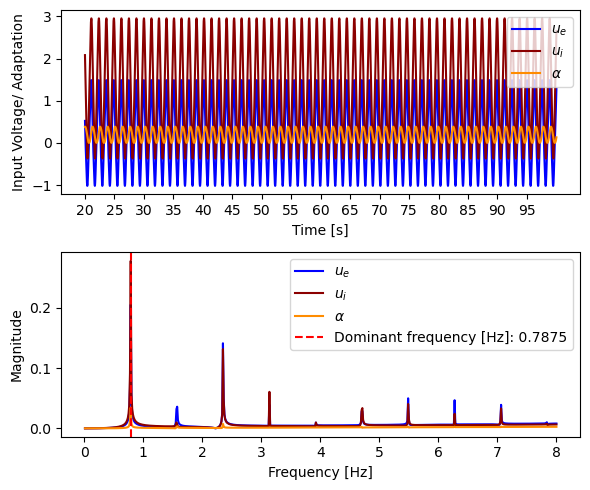

Frequency:  0.7875
Amplitude:  2.5065324522527668
Midpoint Oscillation e:  0.23580549759059444
Midpoint Equilibrium e:  0.18497586046264397

g  =  0.5222222222222223
45  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


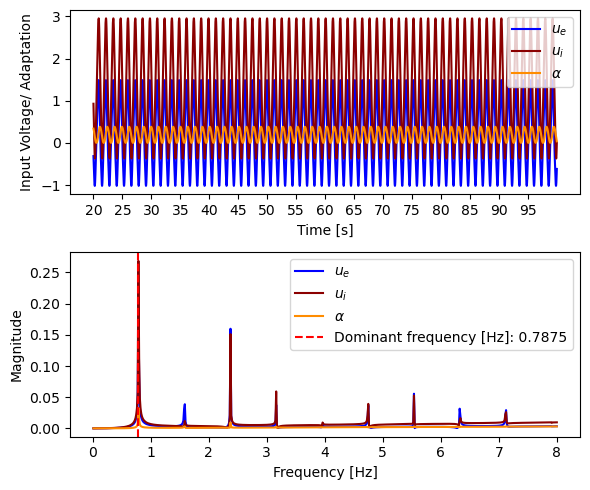

Frequency:  0.7875
Amplitude:  2.5068734176305876
Midpoint Oscillation e:  0.23532026571014641
Midpoint Equilibrium e:  0.18309238148666435

g  =  0.5318181818181819
46  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


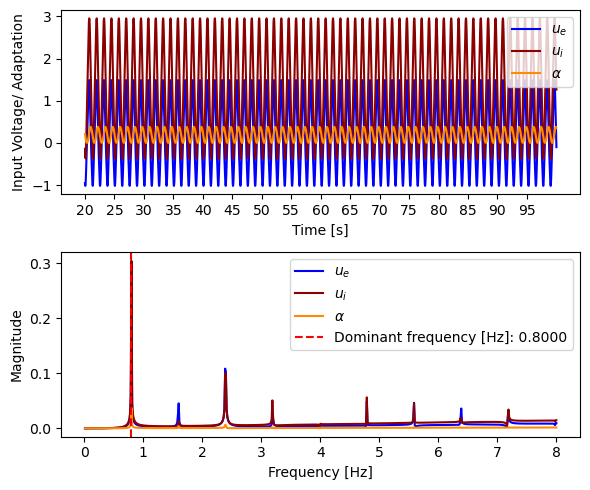

Frequency:  0.8
Amplitude:  2.507195552184128
Midpoint Oscillation e:  0.23483281827103275
Midpoint Equilibrium e:  0.1812251387402975

g  =  0.5414141414141415
47  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


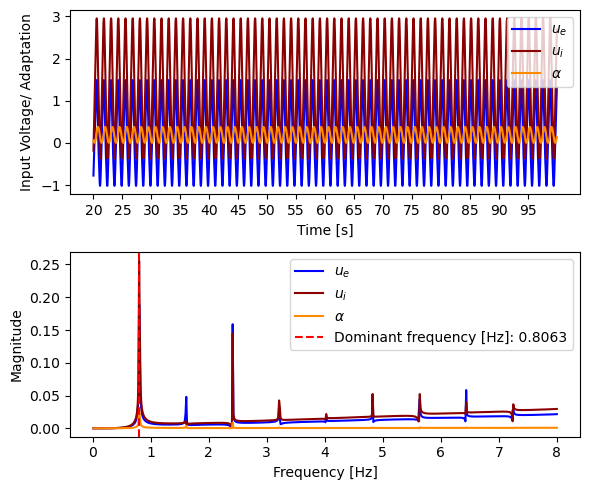

Frequency:  0.80625
Amplitude:  2.507499639328074
Midpoint Oscillation e:  0.23434329790632802
Midpoint Equilibrium e:  0.1793736650599858

g  =  0.5510101010101011
48  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


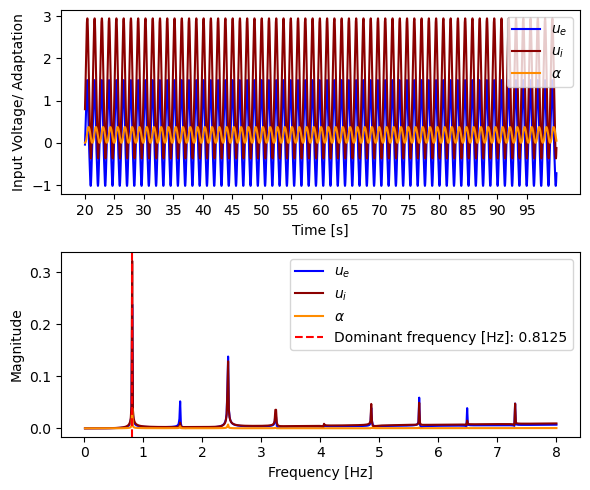

Frequency:  0.8125
Amplitude:  2.5077864149691322
Midpoint Oscillation e:  0.23385184851438168
Midpoint Equilibrium e:  0.1775374998248468

g  =  0.5606060606060607
49  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


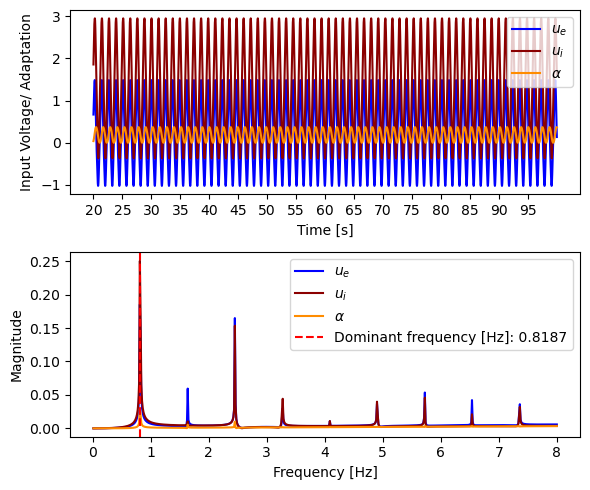

Frequency:  0.81875
Amplitude:  2.508056583672531
Midpoint Oscillation e:  0.23335860937296804
Midpoint Equilibrium e:  0.17571618845369394

g  =  0.5702020202020203
50  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


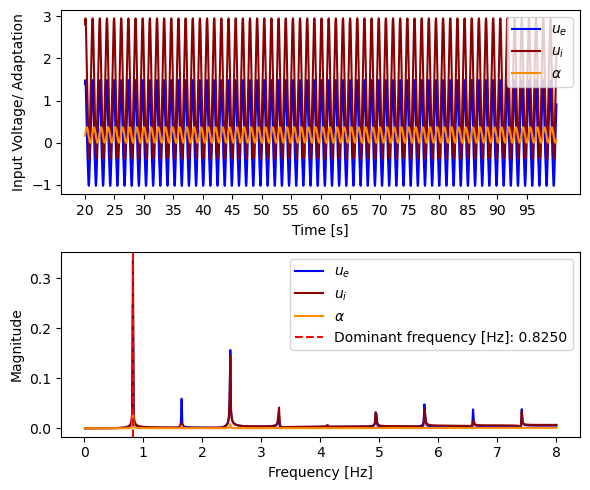

Frequency:  0.825
Amplitude:  2.508310816707607
Midpoint Oscillation e:  0.23286371426408636
Midpoint Equilibrium e:  0.17390928189905686

g  =  0.5797979797979799
51  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


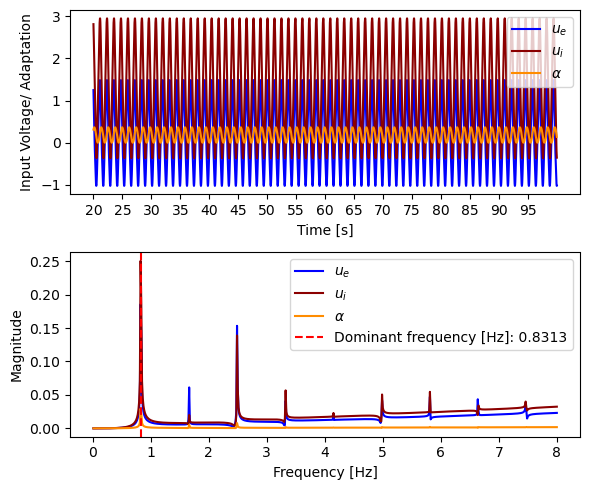

Frequency:  0.83125
Amplitude:  2.508549746285401
Midpoint Oscillation e:  0.23236729762347785
Midpoint Equilibrium e:  0.17211633613640542

g  =  0.5893939393939395
52  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


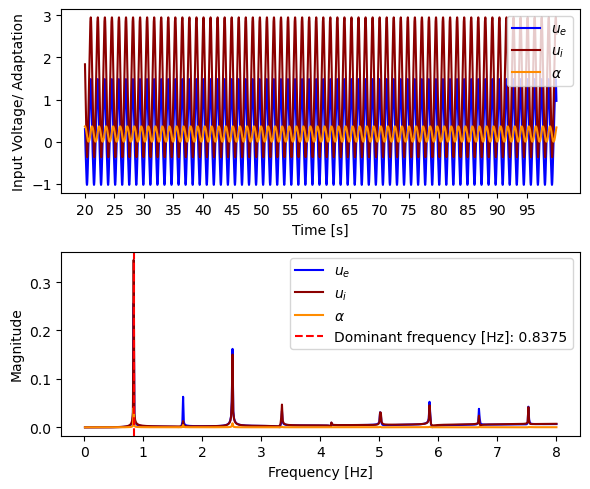

Frequency:  0.8375
Amplitude:  2.5087739864094702
Midpoint Oscillation e:  0.23186948387690232
Midpoint Equilibrium e:  0.17033691164669706

g  =  0.5989898989898991
53  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


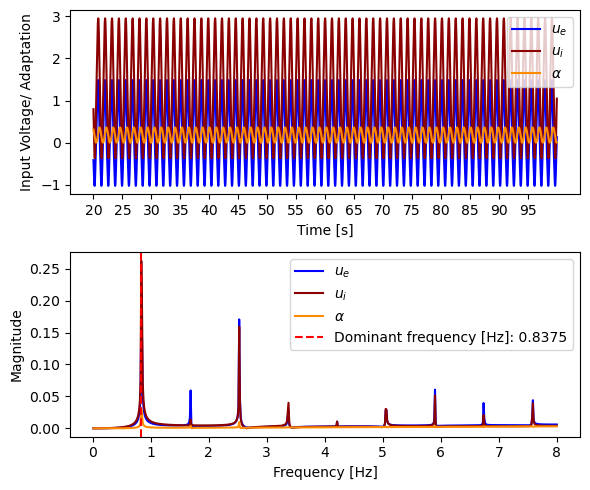

Frequency:  0.8375
Amplitude:  2.5089841141054445
Midpoint Oscillation e:  0.23137039744590826
Midpoint Equilibrium e:  0.16857057289020258

g  =  0.6085858585858587
54  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


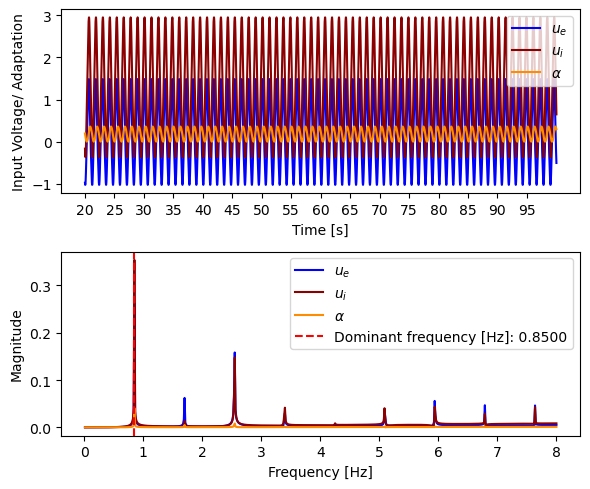

Frequency:  0.85
Amplitude:  2.5091806813192186
Midpoint Oscillation e:  0.23087015790631327
Midpoint Equilibrium e:  0.1668168877694122

g  =  0.6181818181818182
55  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


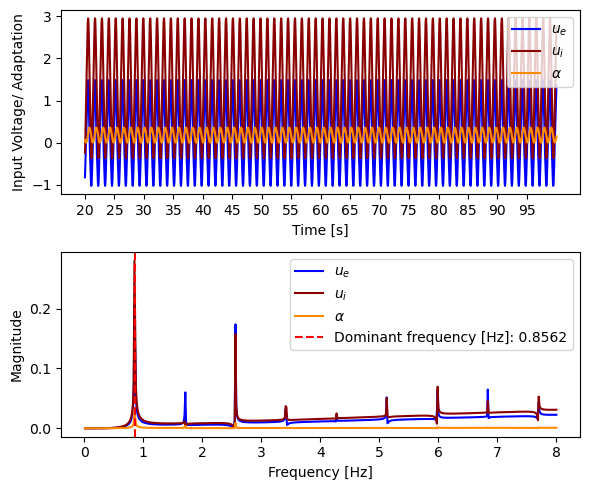

Frequency:  0.85625
Amplitude:  2.5093642139406436
Midpoint Oscillation e:  0.23036888075216255
Midpoint Equilibrium e:  0.16507542707863238

g  =  0.6277777777777778
56  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


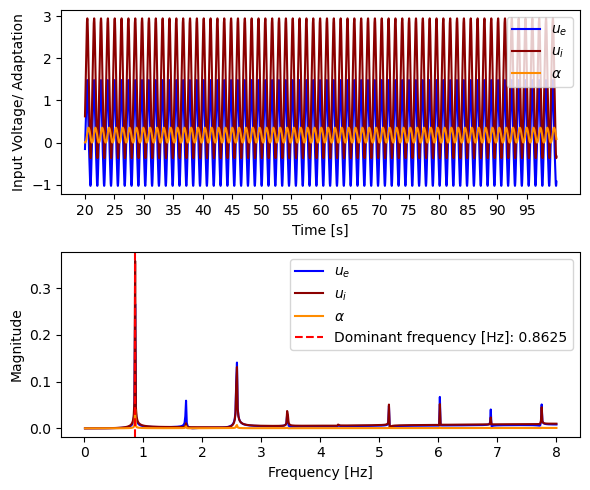

Frequency:  0.8625
Amplitude:  2.509535213854944
Midpoint Oscillation e:  0.22986667785082626
Midpoint Equilibrium e:  0.16334576393765585

g  =  0.6373737373737374
57  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


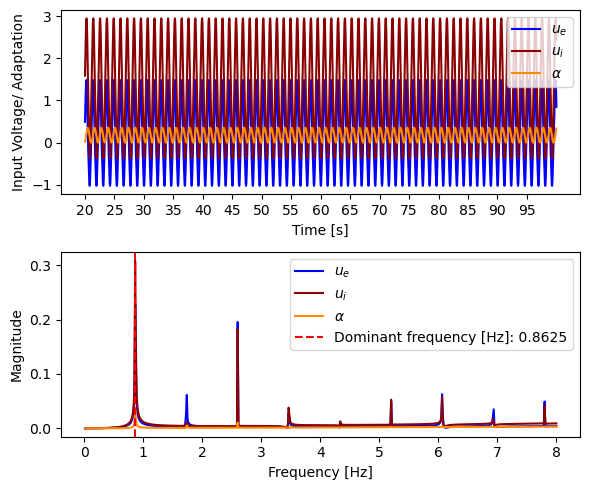

Frequency:  0.8625
Amplitude:  2.509694158866952
Midpoint Oscillation e:  0.22936365674722536
Midpoint Equilibrium e:  0.161627473206658

g  =  0.646969696969697
58  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


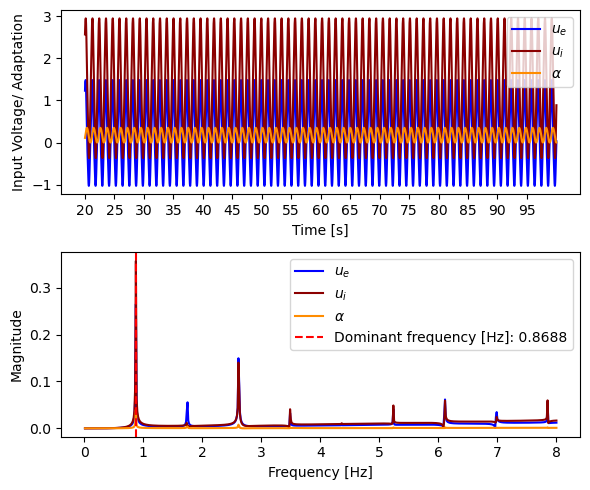

Frequency:  0.86875
Amplitude:  2.509841505284667
Midpoint Oscillation e:  0.22885992145818768
Midpoint Equilibrium e:  0.15992013087915438

g  =  0.6565656565656566
59  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


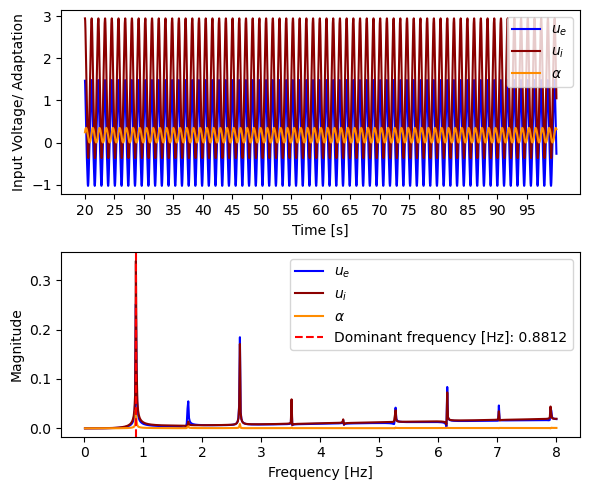

Frequency:  0.88125
Amplitude:  2.5099776881166243
Midpoint Oscillation e:  0.22835557209558777
Midpoint Equilibrium e:  0.15822331344954044

g  =  0.6661616161616162
60  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


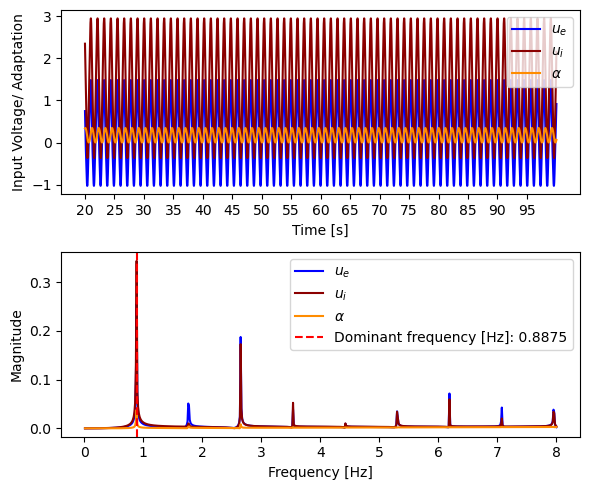

Frequency:  0.8875
Amplitude:  2.5101031229052415
Midpoint Oscillation e:  0.22785070510595984
Midpoint Equilibrium e:  0.15653659725133412

g  =  0.6757575757575758
61  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


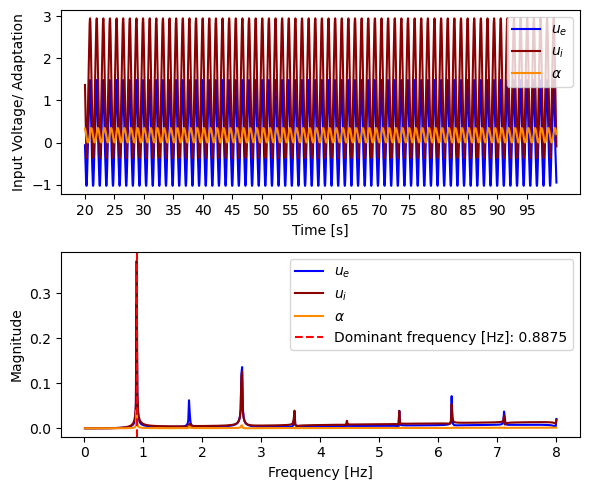

Frequency:  0.8875
Amplitude:  2.51021820533479
Midpoint Oscillation e:  0.22734541339915115
Midpoint Equilibrium e:  0.15485955776180038

g  =  0.6853535353535354
62  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


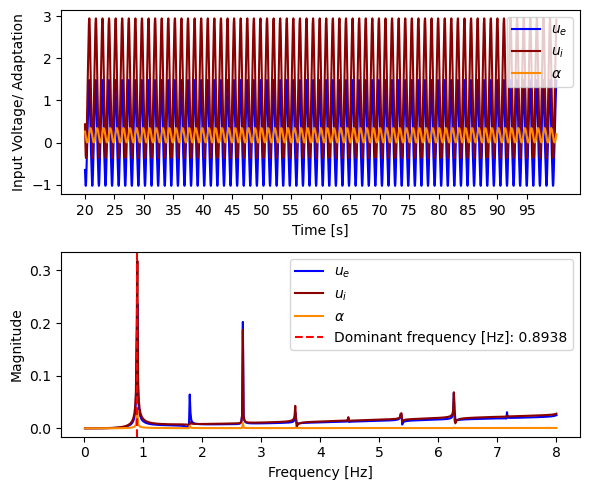

Frequency:  0.89375
Amplitude:  2.510323314260674
Midpoint Oscillation e:  0.22683978608877509
Midpoint Equilibrium e:  0.1531917688681224

g  =  0.694949494949495
63  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


In [17]:
refresh()
param = parameterset | {'tau_e': 20, 'tau_i': 40, 'tau_alpha': 1200, 'g': 0.8}

# param["tau_e"] = 20
# param["tau_i"] = 40
# param["tau_alpha"] = 1200
# param["g"] = 0.8

I_e = 1.2
I_i = 0.3

perturbation_type = 'random'
# perturbation_type = 'box'
perturbation_box_size = 0.4
perturbation_strength = 0.01

connectivity = 'rect'

dt=2e-1
t_max=100e3
t_start = 20

variable = 'g'
variable_start=0.1
variable_stop=1.05
steps=100

name = 'Simulation_Data/rect_result_g'
gauss_result_g = parameter_variation(
                              param=param,
                              name=name,
                              I_e=I_e,
                              I_i=I_i,
                              variable=variable,
                              variable_start=variable_start,
                              connectivity=connectivity,
                              perturbation_type=perturbation_type,
                              perturbation_strength=perturbation_strength,
                              perturbation_box_size=perturbation_box_size,
                              variable_stop=variable_stop,
                              steps=steps,
                              t_max=t_max,
                              t_start=t_start,
                              dt=dt,
                              )

### Adaptation Timeconstant

I_e:  1.2
I_i:  0.3
Variable:  tau_alpha
[-0.14517166  0.17749262  0.41281642]
Time to get points of Equilibrium: 3.463
Time for classification: 2.733


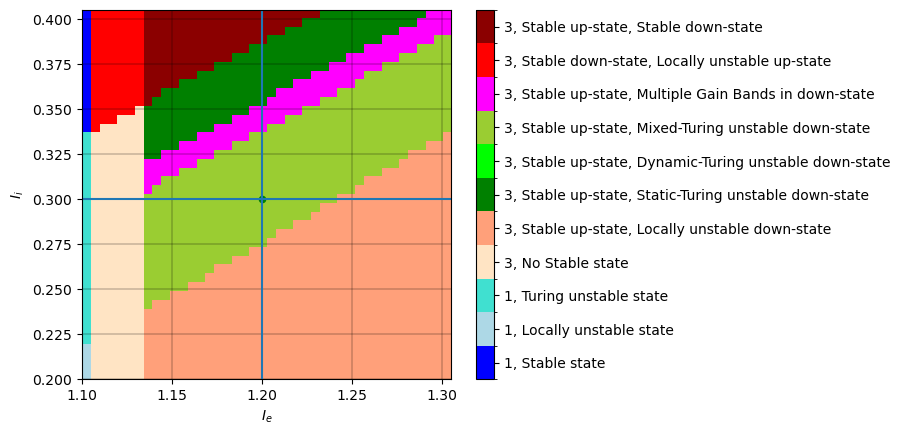


tau_alpha  =  800.0
1  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990473
ui_0: 0.15006273090899755
alpha: -0.14517165906990473


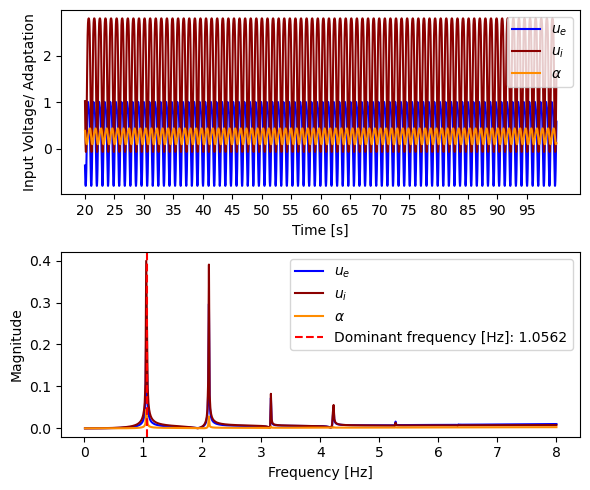

Frequency:  1.05625
Amplitude:  1.8111872595867595
Midpoint Oscillation e:  0.10291739061277005
Midpoint Equilibrium e:  0.13382238024901644

tau_alpha  =  822.2222222222222
2  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


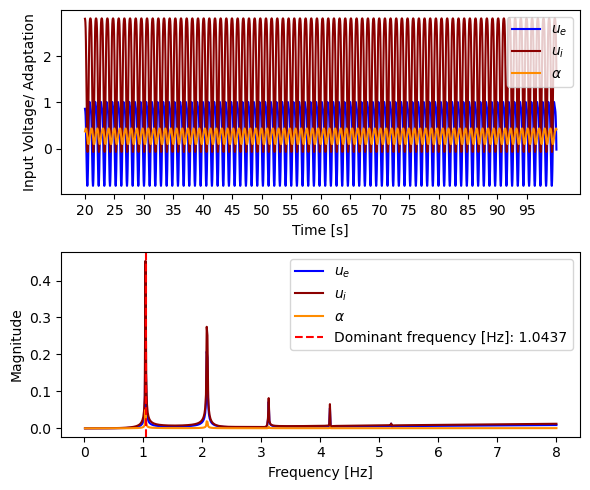

Frequency:  1.04375
Amplitude:  1.8107617943831353
Midpoint Oscillation e:  0.1026112919346146
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  844.4444444444445
3  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


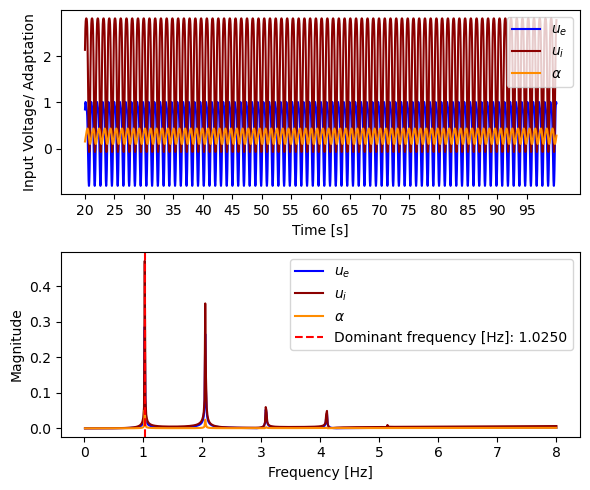

Frequency:  1.025
Amplitude:  1.8103367900828844
Midpoint Oscillation e:  0.10231219352029025
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  866.6666666666666
4  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


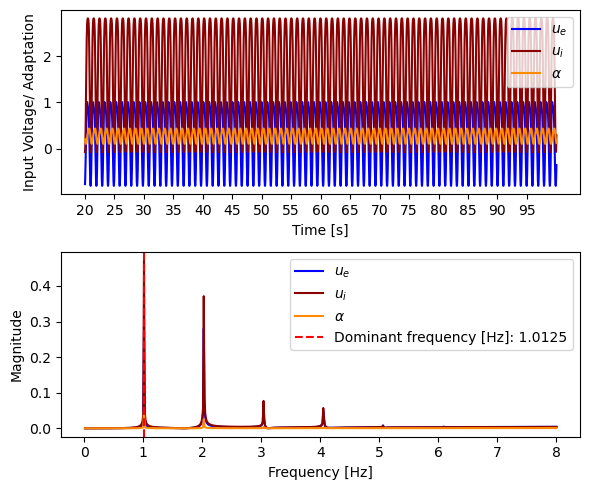

Frequency:  1.0125
Amplitude:  1.80991314571151
Midpoint Oscillation e:  0.10201990865537802
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  888.8888888888889
5  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


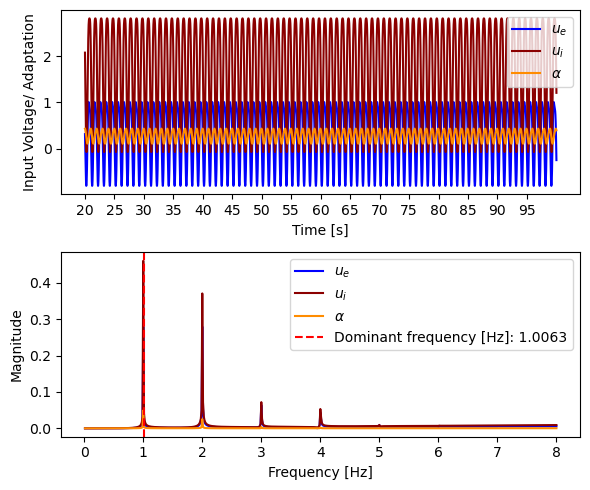

Frequency:  1.00625
Amplitude:  1.8094916091217805
Midpoint Oscillation e:  0.10173424804985287
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  911.1111111111111
6  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


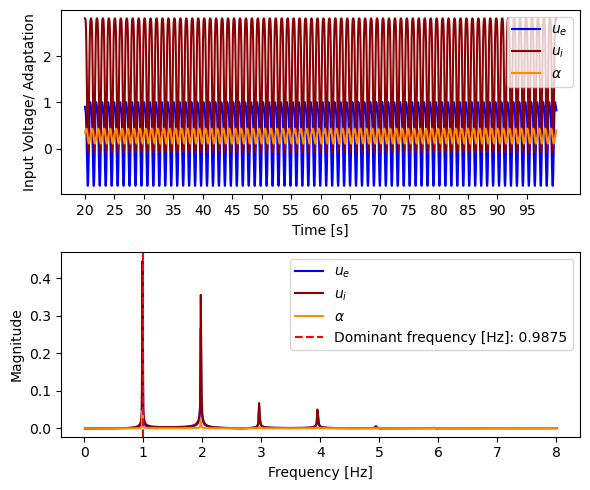

Frequency:  0.9875
Amplitude:  1.8090728002541443
Midpoint Oscillation e:  0.1014550214942413
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  933.3333333333333
7  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


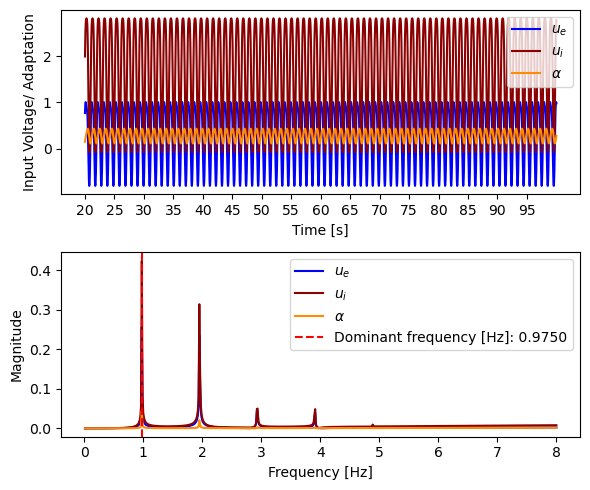

Frequency:  0.975
Amplitude:  1.8086572314939469
Midpoint Oscillation e:  0.1011820400543268
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  955.5555555555555
8  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


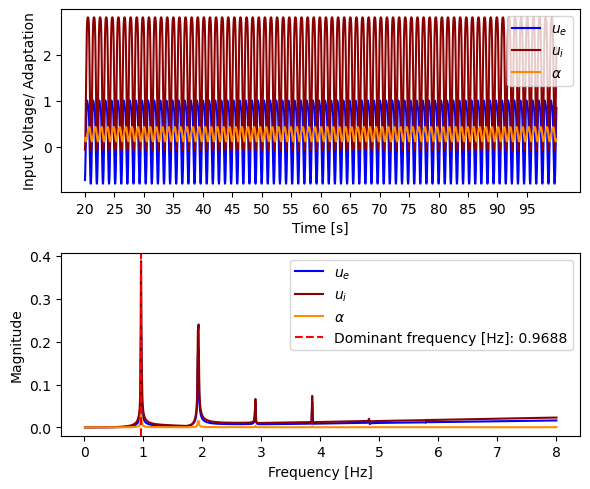

Frequency:  0.96875
Amplitude:  1.8082453241827046
Midpoint Oscillation e:  0.10091511690633759
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  977.7777777777778
9  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


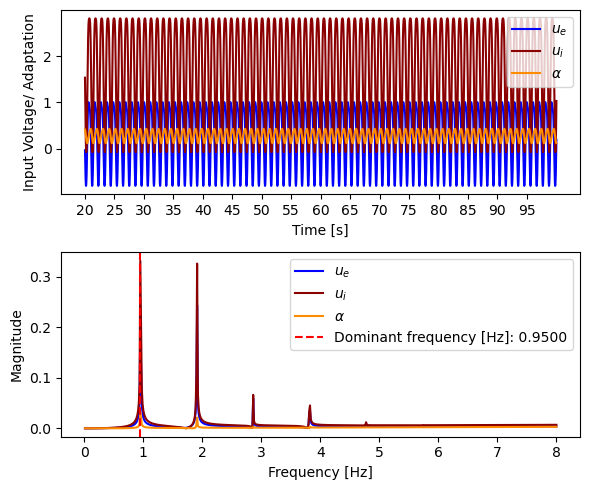

Frequency:  0.95
Amplitude:  1.8078374221248676
Midpoint Oscillation e:  0.10065406836704854
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1000.0
10  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


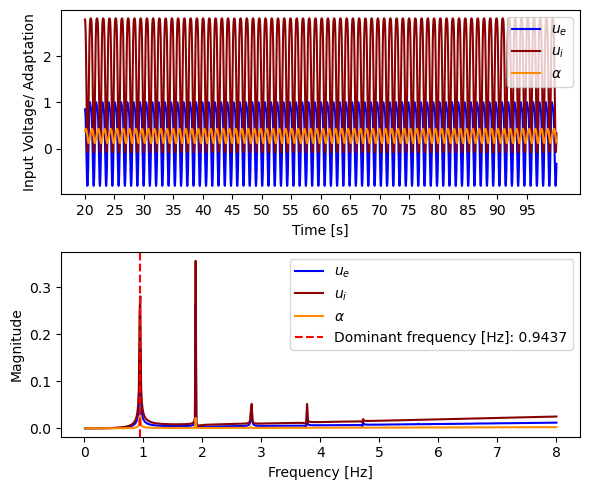

Frequency:  0.94375
Amplitude:  1.8074338044612013
Midpoint Oscillation e:  0.1003987144441974
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1022.2222222222222
11  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


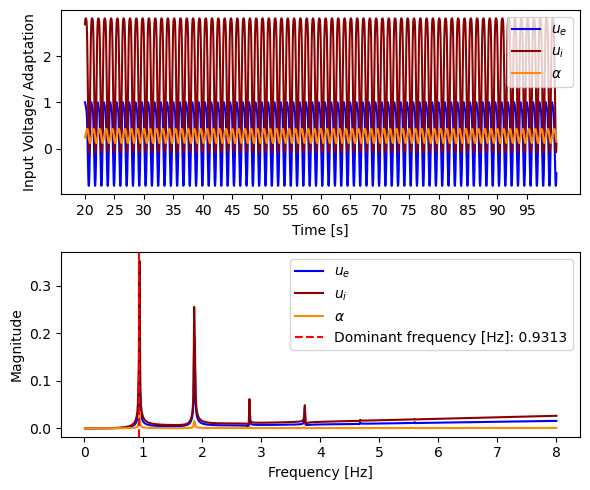

Frequency:  0.93125
Amplitude:  1.8070346933224908
Midpoint Oscillation e:  0.10014887967576303
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1044.4444444444443
12  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


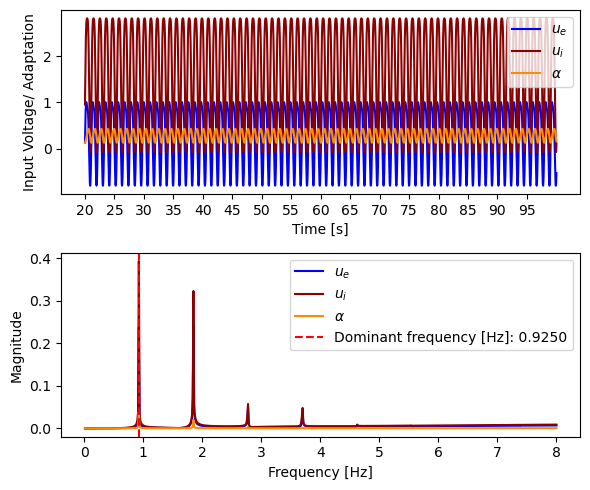

Frequency:  0.925
Amplitude:  1.806640264356865
Midpoint Oscillation e:  0.09990439312881733
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1066.6666666666665
13  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


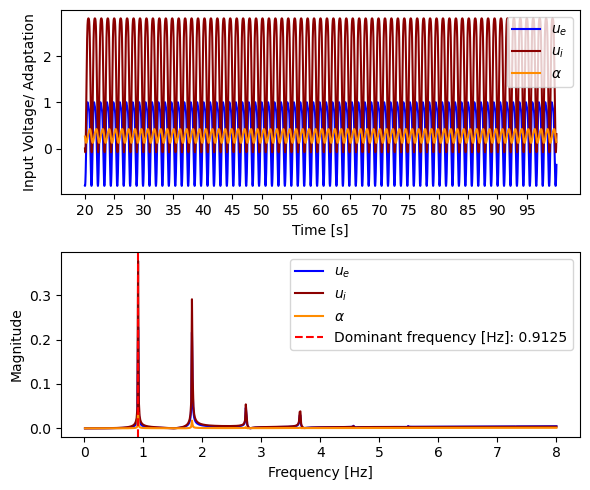

Frequency:  0.9125
Amplitude:  1.806250652601969
Midpoint Oscillation e:  0.09966508878734459
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1088.888888888889
14  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


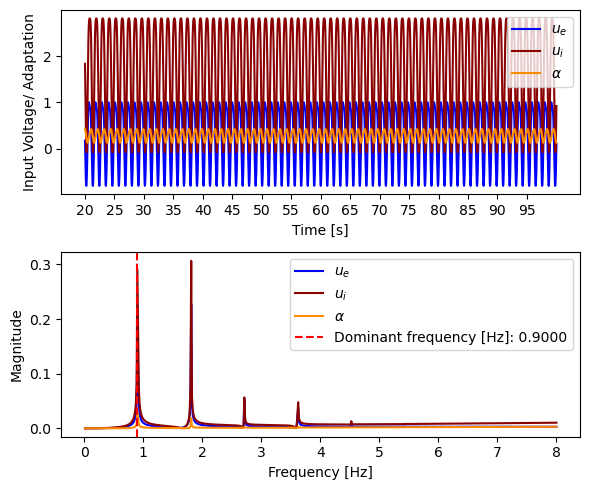

Frequency:  0.9
Amplitude:  1.8058659589508963
Midpoint Oscillation e:  0.09943080572741353
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1111.111111111111
15  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


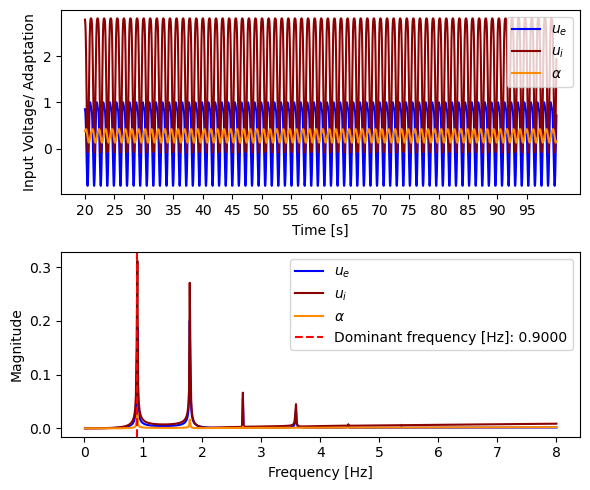

Frequency:  0.9
Amplitude:  1.805486254928795
Midpoint Oscillation e:  0.09920138805508638
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1133.3333333333333
16  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


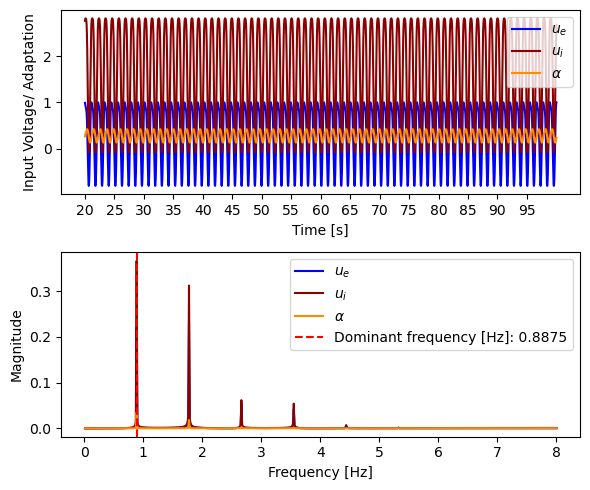

Frequency:  0.8875
Amplitude:  1.8051115875051984
Midpoint Oscillation e:  0.09897668526698694
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1155.5555555555557
17  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


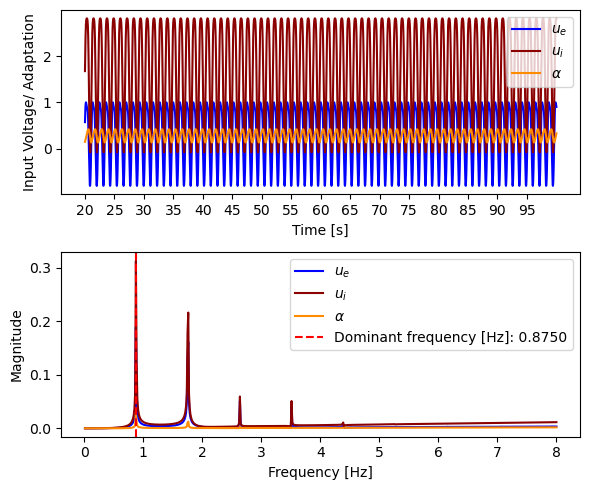

Frequency:  0.875
Amplitude:  1.8047419823986763
Midpoint Oscillation e:  0.09875655153272656
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1177.7777777777778
18  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


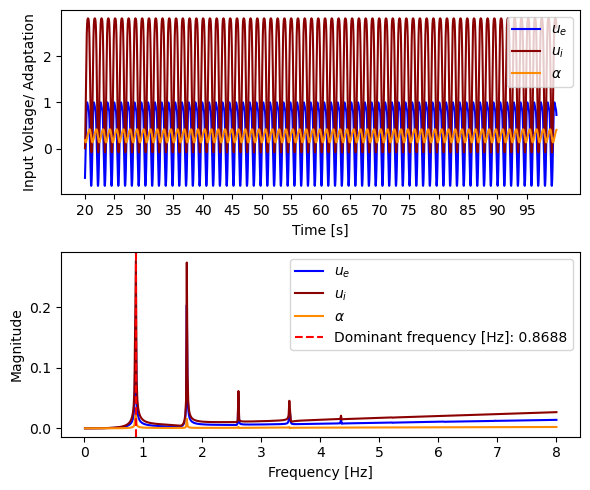

Frequency:  0.86875
Amplitude:  1.8043774473438894
Midpoint Oscillation e:  0.09854084644460925
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1200.0
19  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


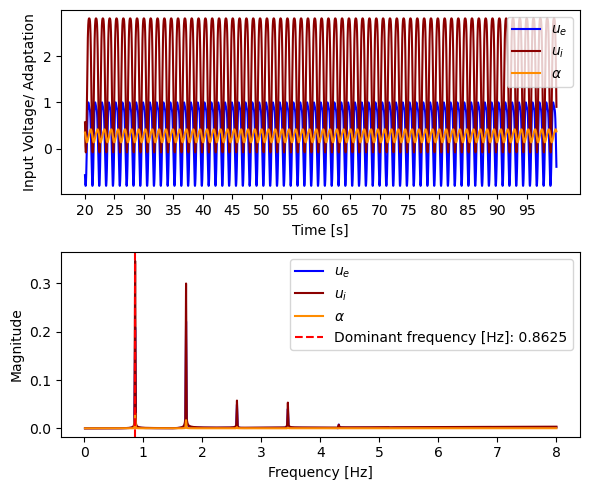

Frequency:  0.8625
Amplitude:  1.8040179747166616
Midpoint Oscillation e:  0.09832943455006465
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1222.2222222222222
20  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


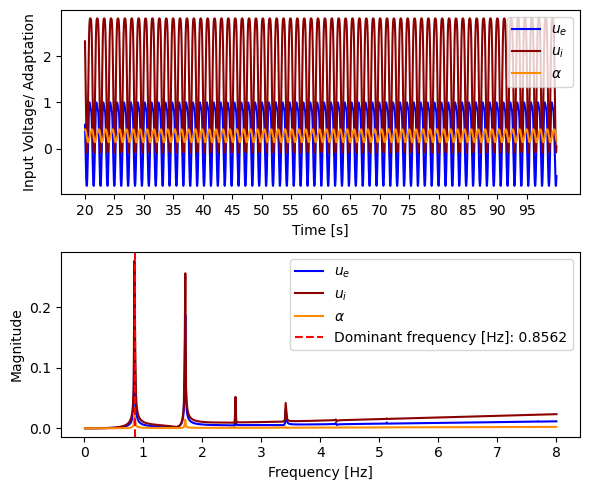

Frequency:  0.85625
Amplitude:  1.8036635452171579
Midpoint Oscillation e:  0.09812218470647593
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1244.4444444444443
21  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


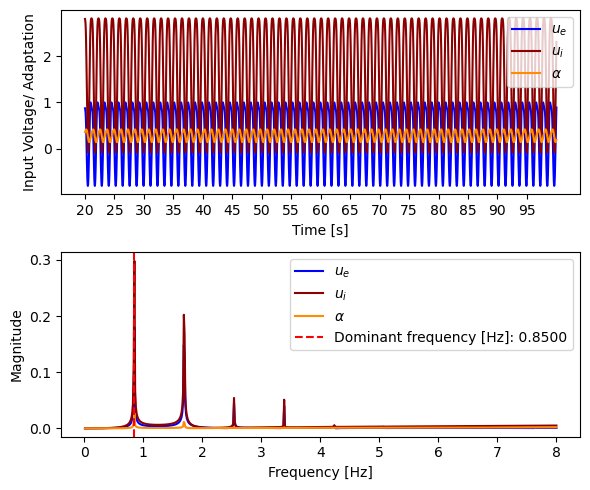

Frequency:  0.85
Amplitude:  1.803314126899885
Midpoint Oscillation e:  0.09791897136190675
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1266.6666666666665
22  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


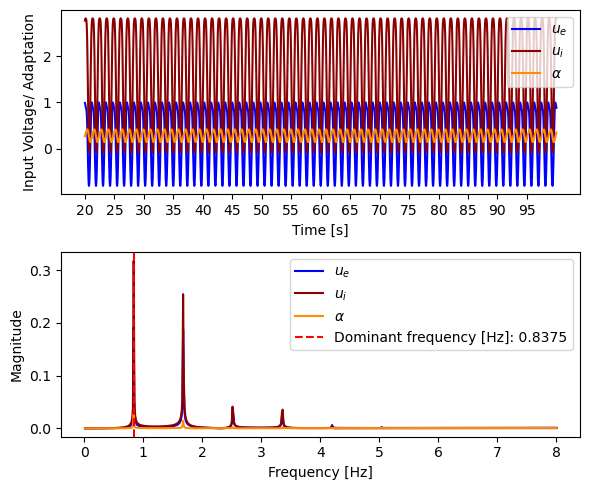

Frequency:  0.8375
Amplitude:  1.8029696802608155
Midpoint Oscillation e:  0.0977196727913976
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1288.888888888889
23  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


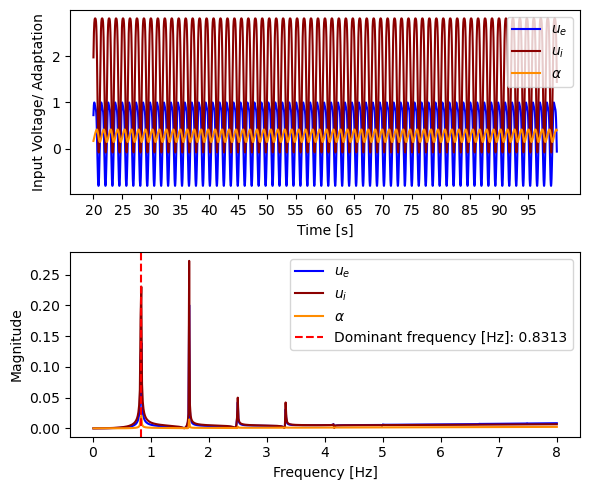

Frequency:  0.83125
Amplitude:  1.802630157601308
Midpoint Oscillation e:  0.09752417221860221
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1311.111111111111
24  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


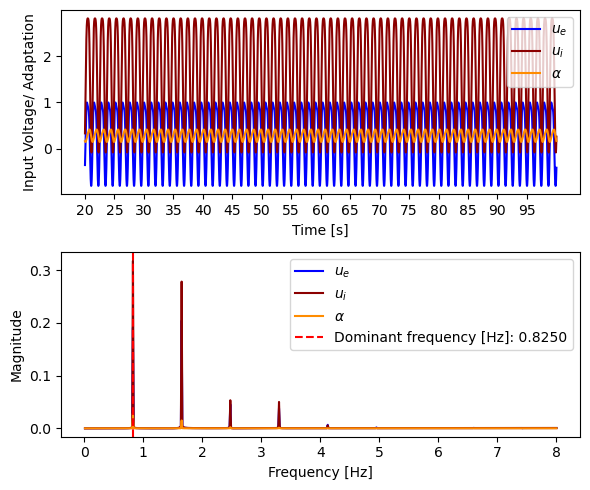

Frequency:  0.825
Amplitude:  1.8022955175187687
Midpoint Oscillation e:  0.09733236321093958
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1333.3333333333333
25  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


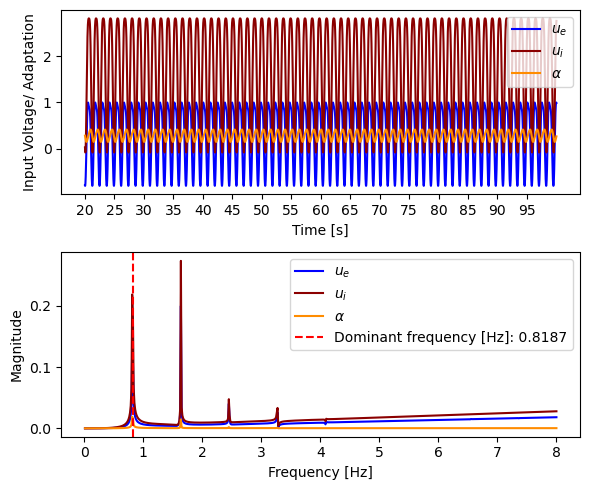

Frequency:  0.81875
Amplitude:  1.8019656680940042
Midpoint Oscillation e:  0.0971441207629044
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1355.5555555555557
26  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


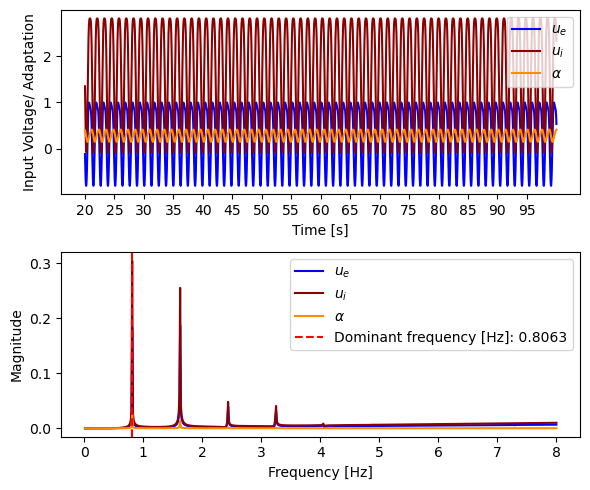

Frequency:  0.80625
Amplitude:  1.8016405837450575
Midpoint Oscillation e:  0.09695935930216482
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1377.7777777777778
27  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


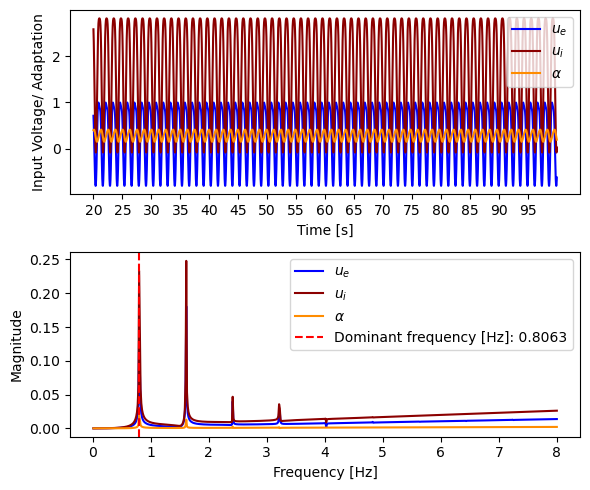

Frequency:  0.80625
Amplitude:  1.8013201531486587
Midpoint Oscillation e:  0.09677795570134257
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1400.0
28  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


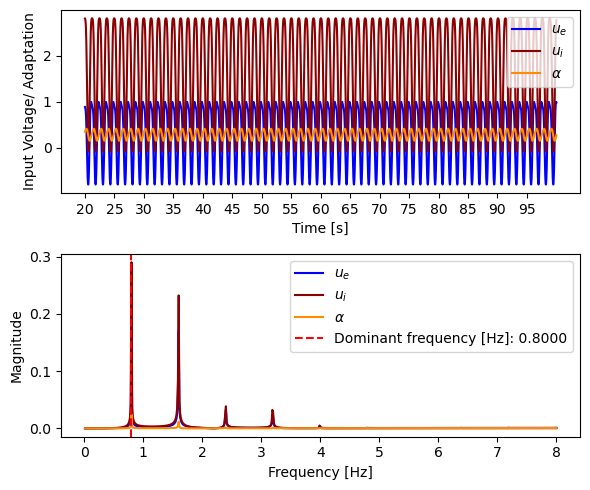

Frequency:  0.8
Amplitude:  1.8010043500075783
Midpoint Oscillation e:  0.09659983472347294
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1422.2222222222222
29  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


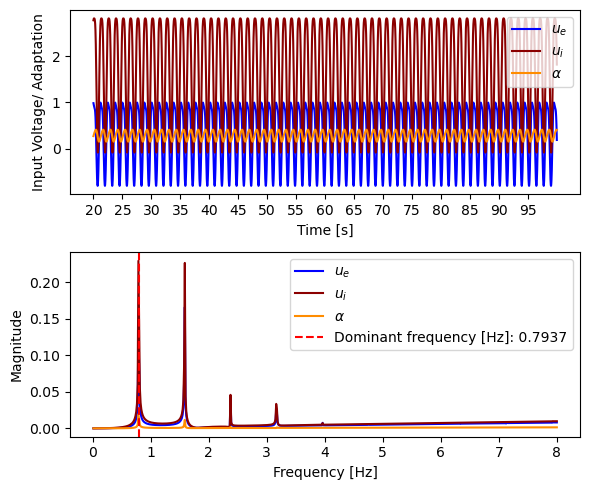

Frequency:  0.79375
Amplitude:  1.800693086123628
Midpoint Oscillation e:  0.09642489470899479
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1444.4444444444443
30  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


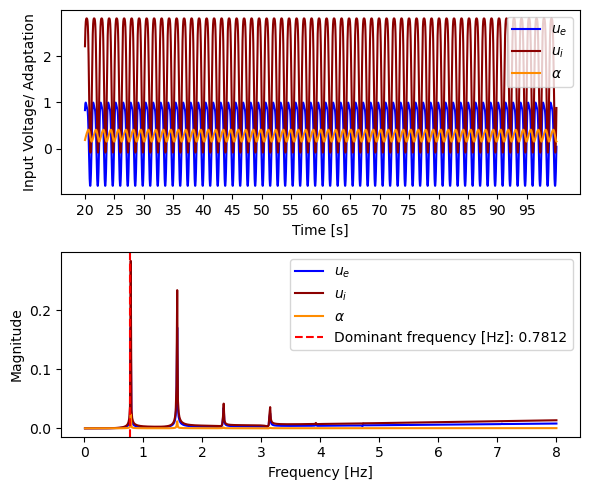

Frequency:  0.78125
Amplitude:  1.800386316594397
Midpoint Oscillation e:  0.09625305959934316
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1466.6666666666665
31  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


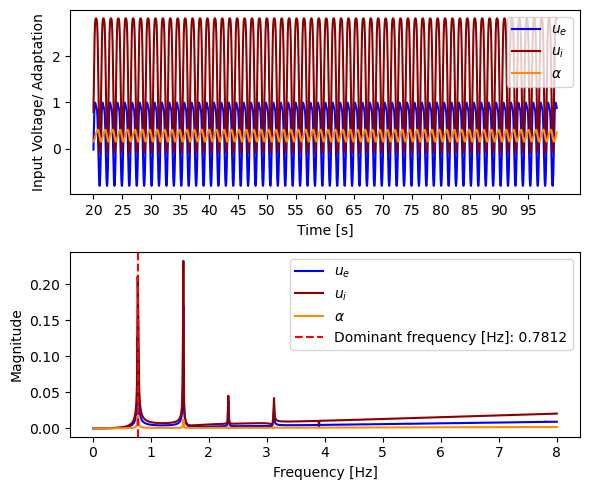

Frequency:  0.78125
Amplitude:  1.8000838657867995
Midpoint Oscillation e:  0.09608420621022795
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1488.888888888889
32  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


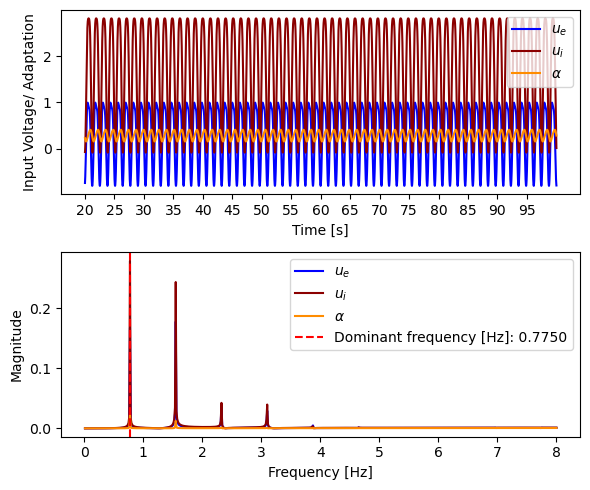

Frequency:  0.775
Amplitude:  1.799785813907782
Midpoint Oscillation e:  0.09591828616905212
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1511.111111111111
33  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


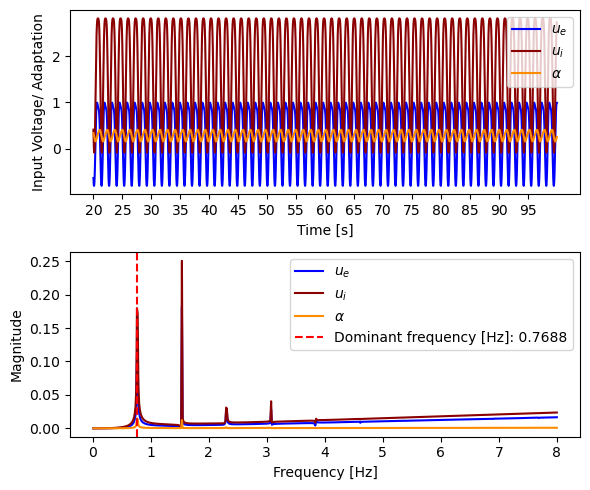

Frequency:  0.76875
Amplitude:  1.799491953880639
Midpoint Oscillation e:  0.09575519007091332
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1533.3333333333333
34  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


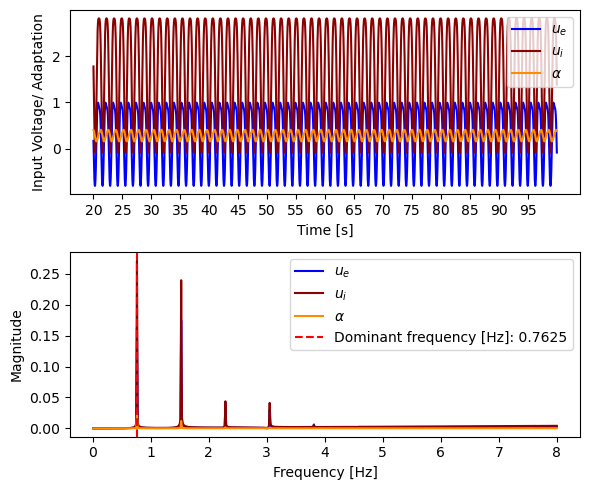

Frequency:  0.7625
Amplitude:  1.7992023041517342
Midpoint Oscillation e:  0.09559487722728122
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1555.5555555555557
35  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


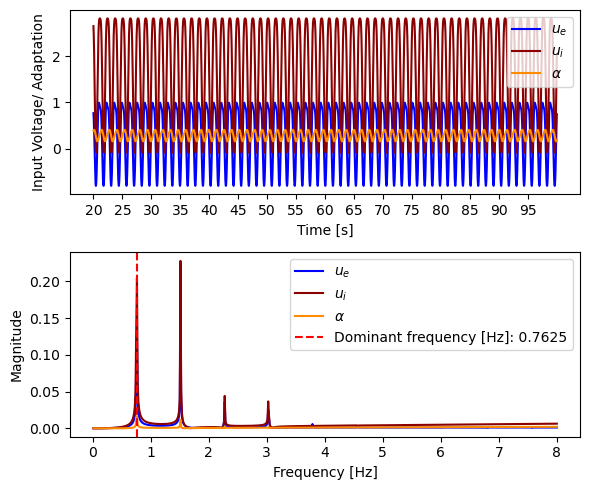

Frequency:  0.7625
Amplitude:  1.7989168102836772
Midpoint Oscillation e:  0.09543718306408883
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1577.7777777777778
36  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


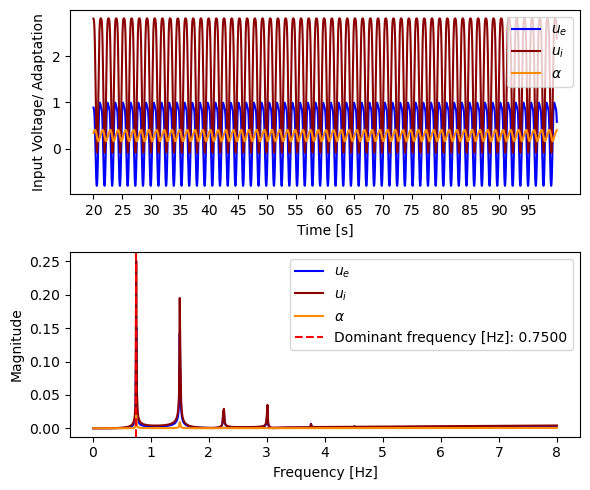

Frequency:  0.75
Amplitude:  1.7986351916017624
Midpoint Oscillation e:  0.09528222523938013
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1600.0
37  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


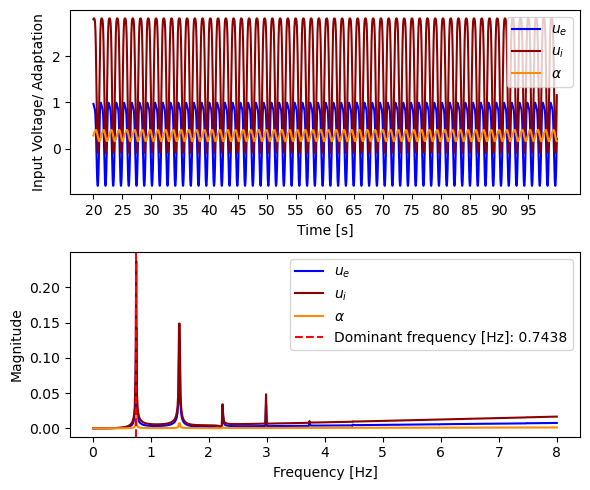

Frequency:  0.74375
Amplitude:  1.7983576779626267
Midpoint Oscillation e:  0.09512969324867987
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1622.2222222222222
38  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


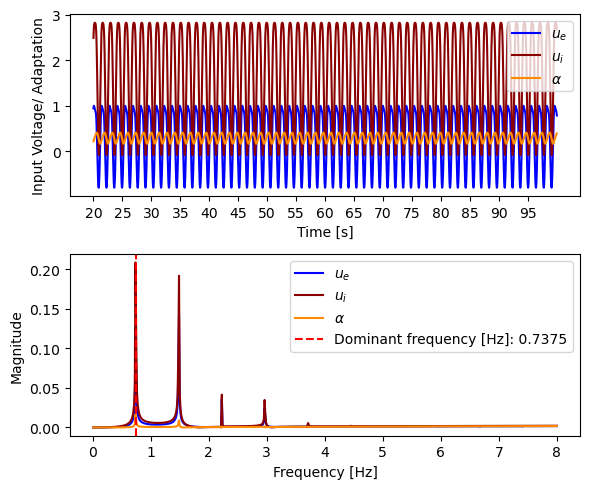

Frequency:  0.7375
Amplitude:  1.7980840278716348
Midpoint Oscillation e:  0.09497970393546973
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1644.4444444444443
39  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


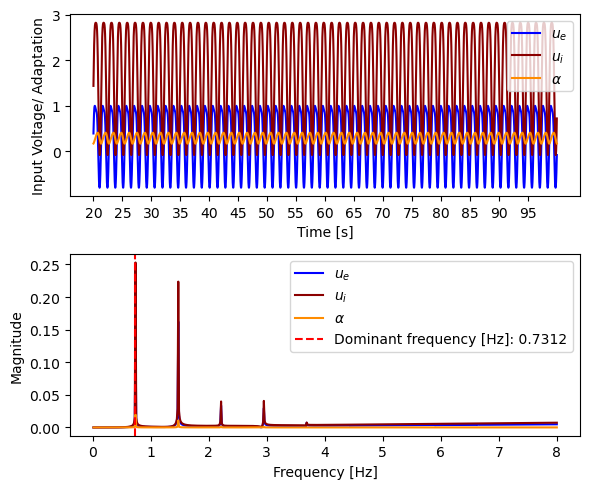

Frequency:  0.73125
Amplitude:  1.7978140285075725
Midpoint Oscillation e:  0.09483218389793485
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1666.6666666666665
40  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


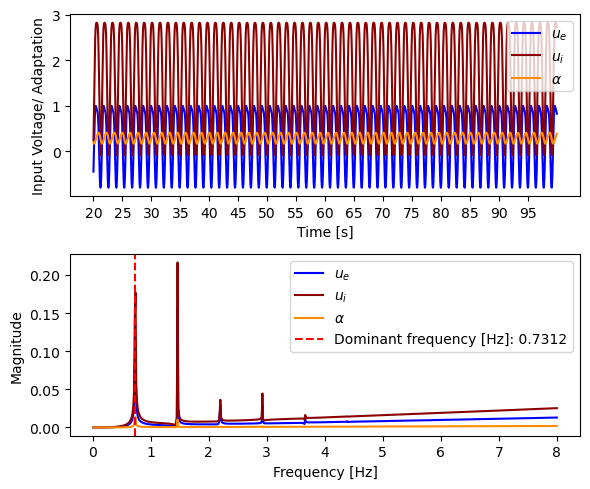

Frequency:  0.73125
Amplitude:  1.7975477233841544
Midpoint Oscillation e:  0.09468695966203822
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1688.888888888889
41  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


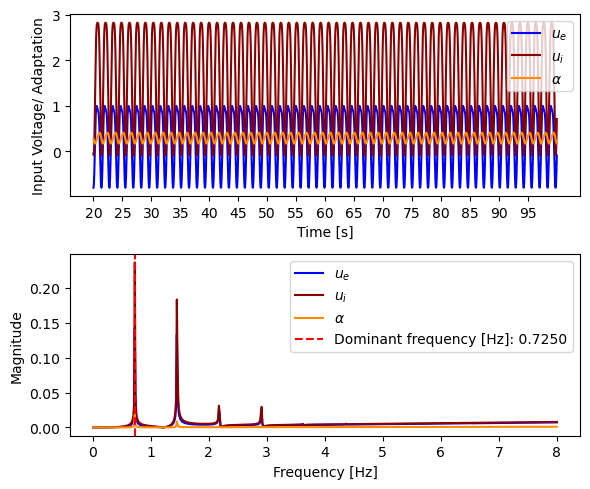

Frequency:  0.725
Amplitude:  1.7972852663254049
Midpoint Oscillation e:  0.09454393772216735
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1711.111111111111
42  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


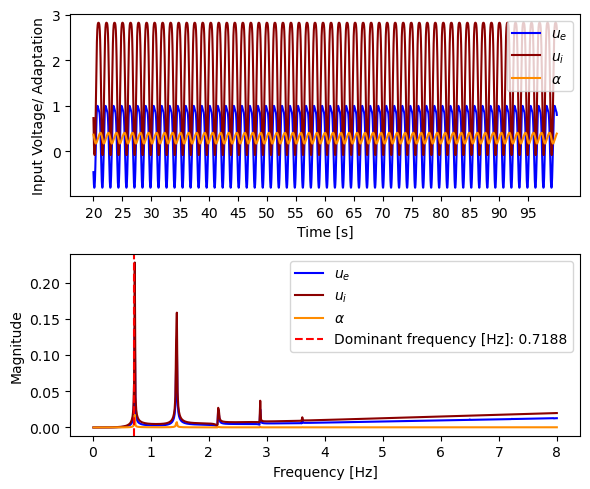

Frequency:  0.71875
Amplitude:  1.7970262067484861
Midpoint Oscillation e:  0.09440330032969829
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1733.3333333333333
43  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


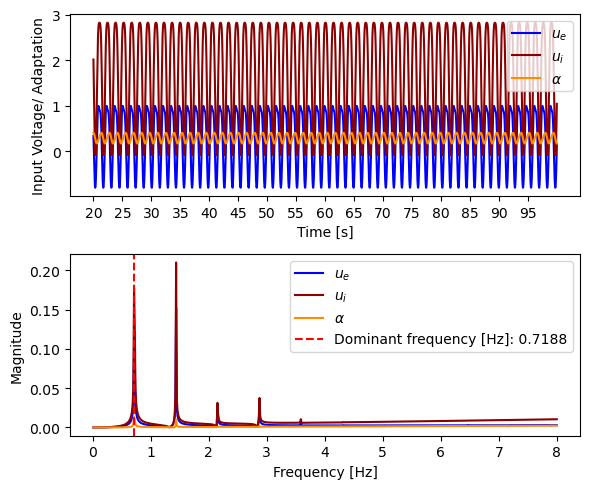

Frequency:  0.71875
Amplitude:  1.796770740917951
Midpoint Oscillation e:  0.09426475287400288
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1755.5555555555557
44  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


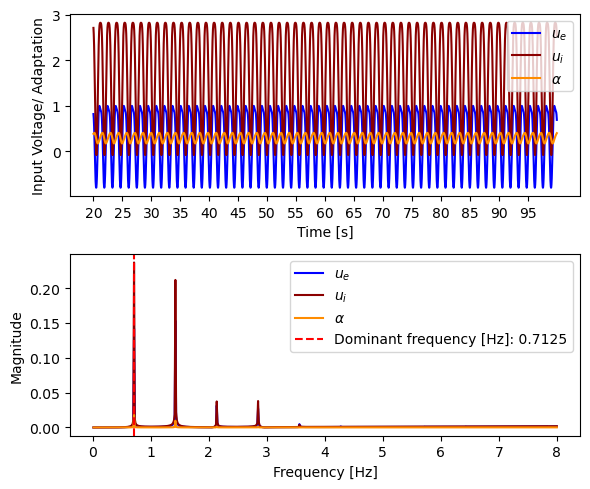

Frequency:  0.7125
Amplitude:  1.7965187574004569
Midpoint Oscillation e:  0.09412826279182351
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1777.7777777777778
45  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


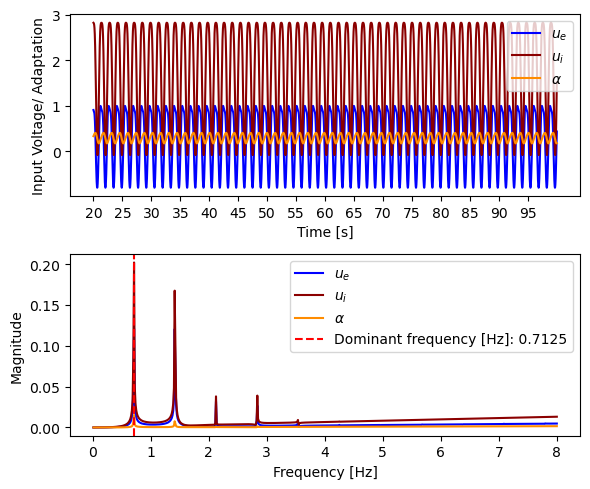

Frequency:  0.7125
Amplitude:  1.7962700005702097
Midpoint Oscillation e:  0.09399398252270985
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1800.0
46  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


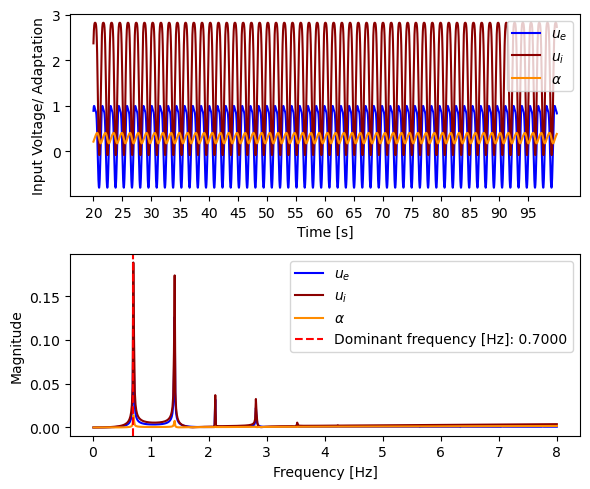

Frequency:  0.7
Amplitude:  1.796027386876055
Midpoint Oscillation e:  0.09386297903680607
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1822.2222222222222
47  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


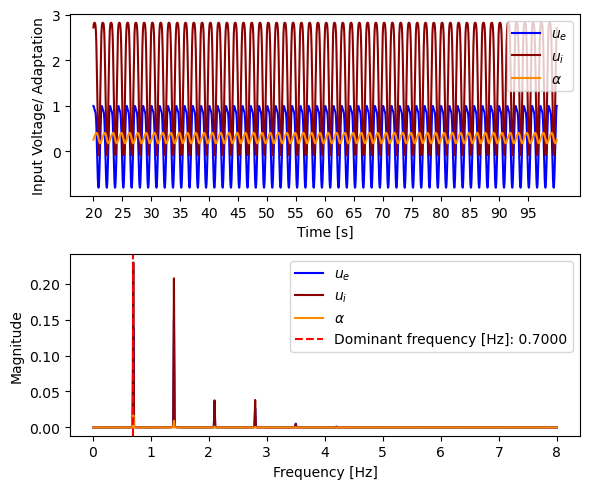

Frequency:  0.7
Amplitude:  1.7957846416093268
Midpoint Oscillation e:  0.0937322159270616
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1844.4444444444443
48  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


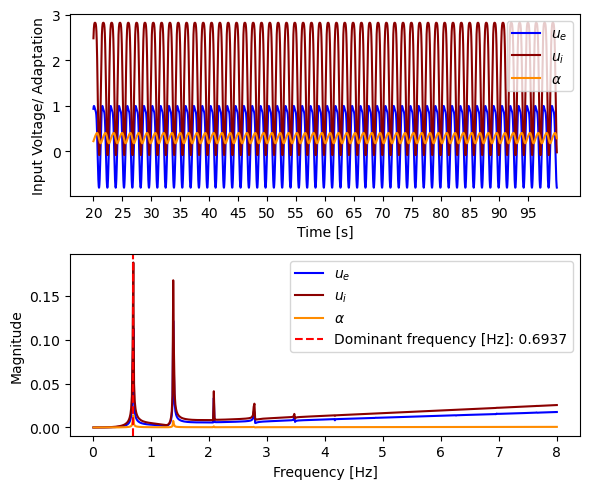

Frequency:  0.69375
Amplitude:  1.7955458535672895
Midpoint Oscillation e:  0.09360381556344405
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1866.6666666666665
49  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


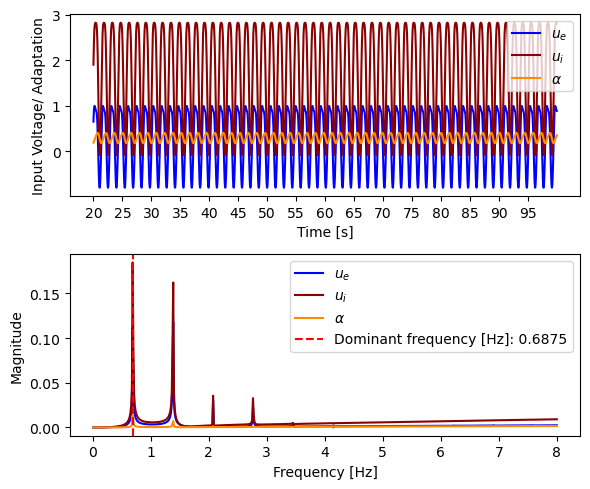

Frequency:  0.6875
Amplitude:  1.7953101187063645
Midpoint Oscillation e:  0.0934773734129748
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1888.888888888889
50  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


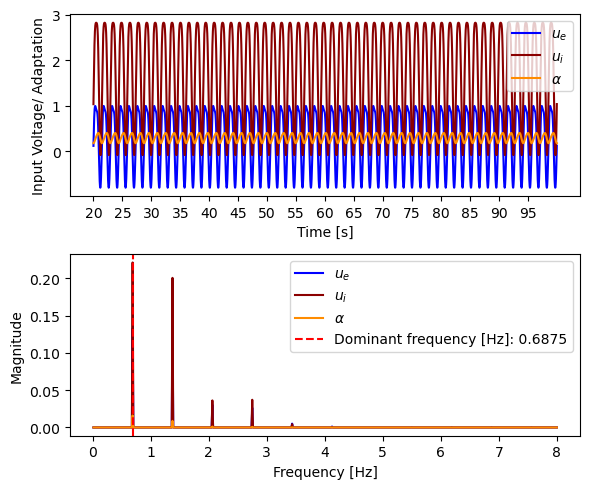

Frequency:  0.6875
Amplitude:  1.7950776145758627
Midpoint Oscillation e:  0.09335264131694904
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1911.111111111111
51  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


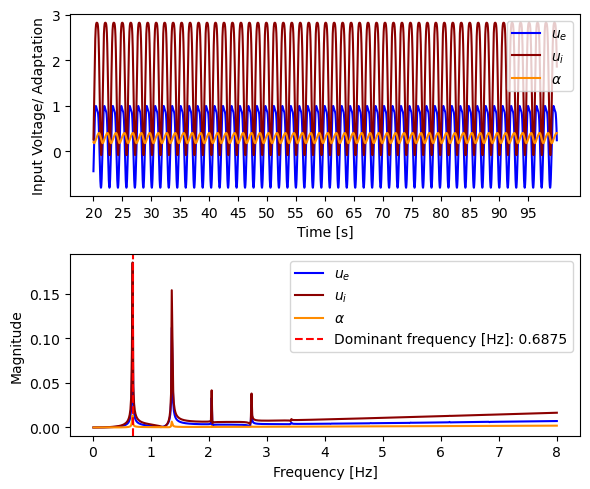

Frequency:  0.6875
Amplitude:  1.7948480443628518
Midpoint Oscillation e:  0.09322974403502005
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1933.3333333333333
52  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


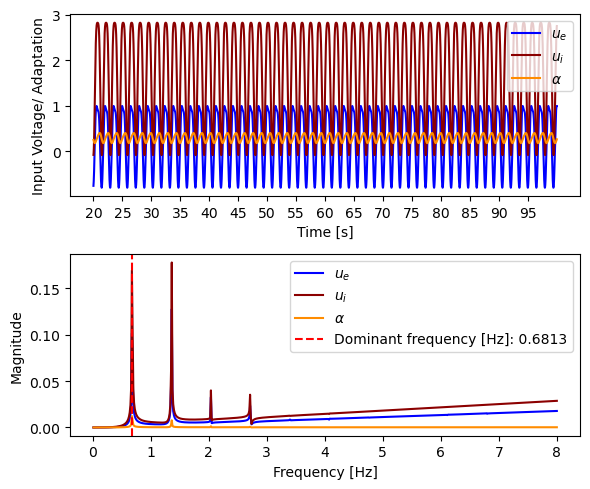

Frequency:  0.68125
Amplitude:  1.7946214198286752
Midpoint Oscillation e:  0.09310862783810114
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1955.5555555555554
53  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


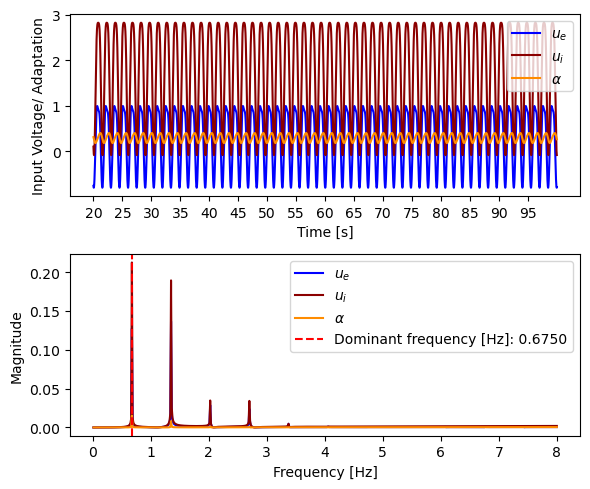

Frequency:  0.675
Amplitude:  1.7943977461241967
Midpoint Oscillation e:  0.09298920915649017
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1977.7777777777778
54  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


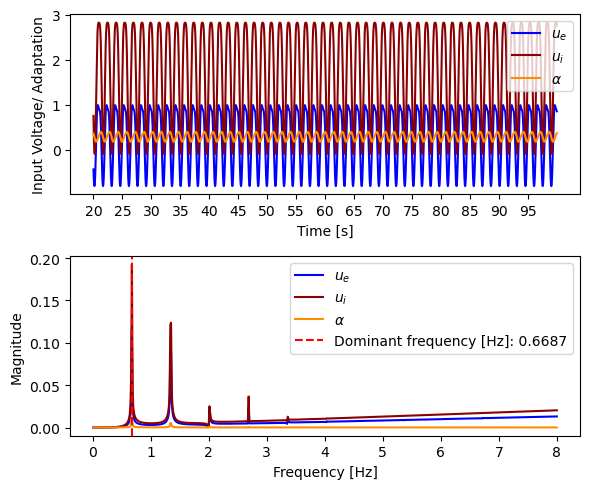

Frequency:  0.66875
Amplitude:  1.7941767624763294
Midpoint Oscillation e:  0.09287147620871655
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2000.0
55  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


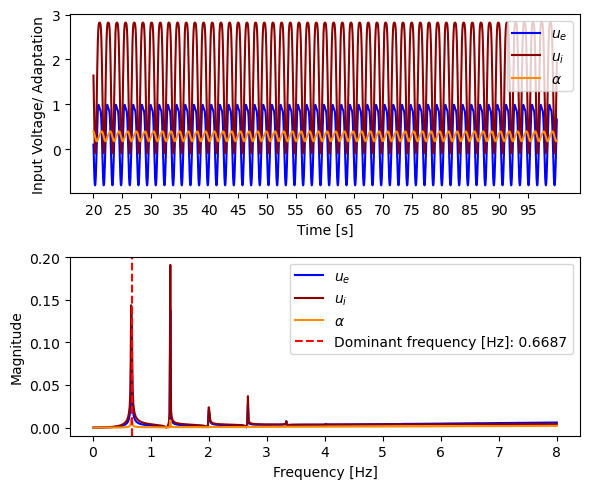

Frequency:  0.66875
Amplitude:  1.7939587833532544
Midpoint Oscillation e:  0.09275533584864504
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2022.2222222222222
56  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


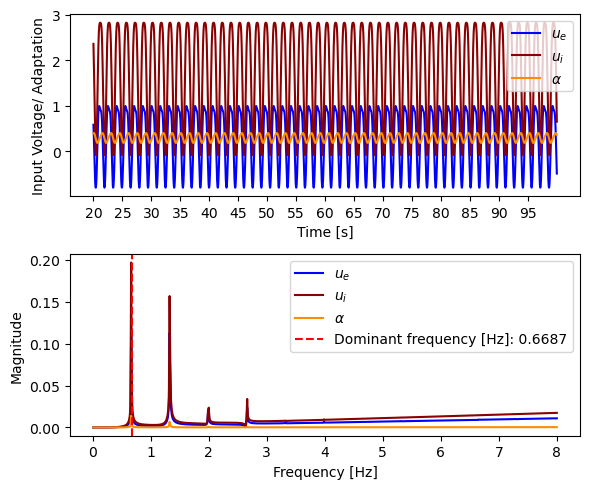

Frequency:  0.66875
Amplitude:  1.7937433940296255
Midpoint Oscillation e:  0.0926407863759906
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2044.4444444444443
57  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


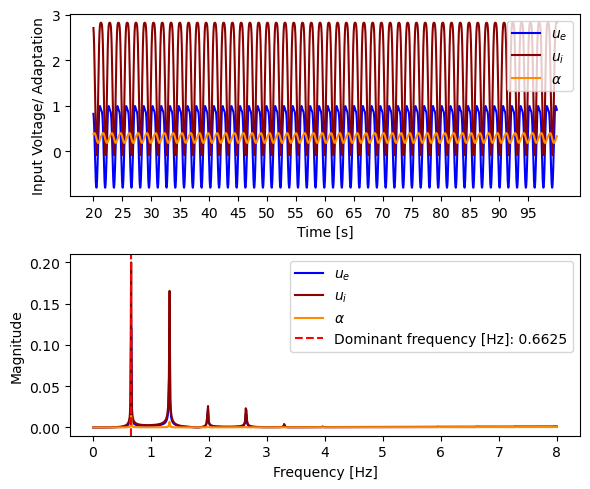

Frequency:  0.6625
Amplitude:  1.7935307316214364
Midpoint Oscillation e:  0.092527815908092
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2066.6666666666665
58  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


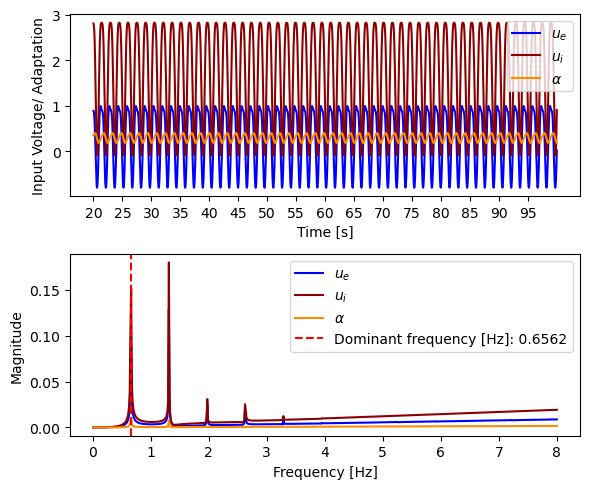

Frequency:  0.65625
Amplitude:  1.7933206451593517
Midpoint Oscillation e:  0.09241641422844776
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2088.8888888888887
59  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


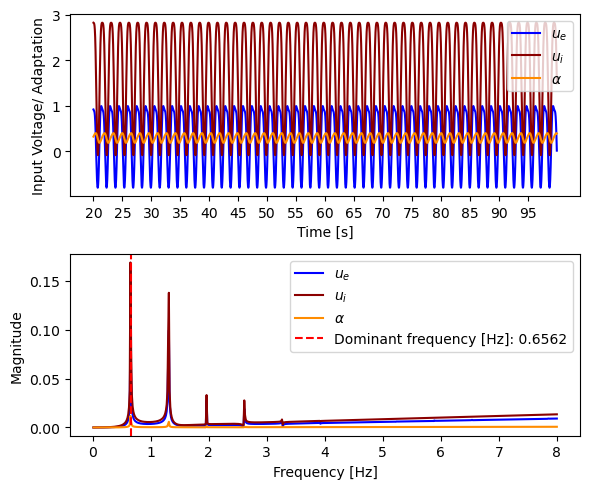

Frequency:  0.65625
Amplitude:  1.7931131977922528
Midpoint Oscillation e:  0.09230649743048996
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2111.1111111111113
60  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


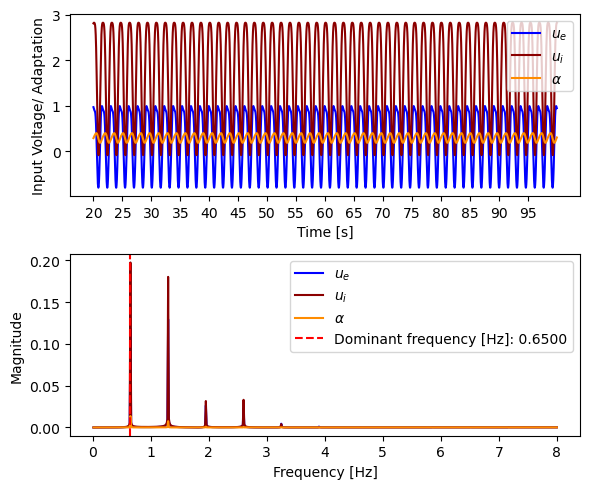

Frequency:  0.65
Amplitude:  1.7929083481779404
Midpoint Oscillation e:  0.09219795112580792
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2133.333333333333
61  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


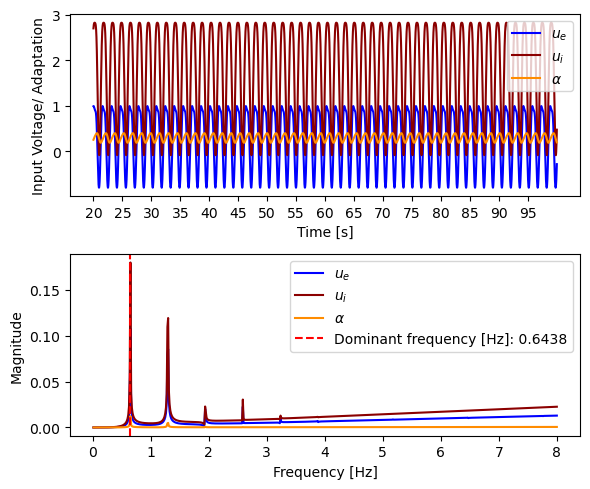

Frequency:  0.64375
Amplitude:  1.7927058738227424
Midpoint Oscillation e:  0.0920909101697095
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2155.5555555555557
62  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


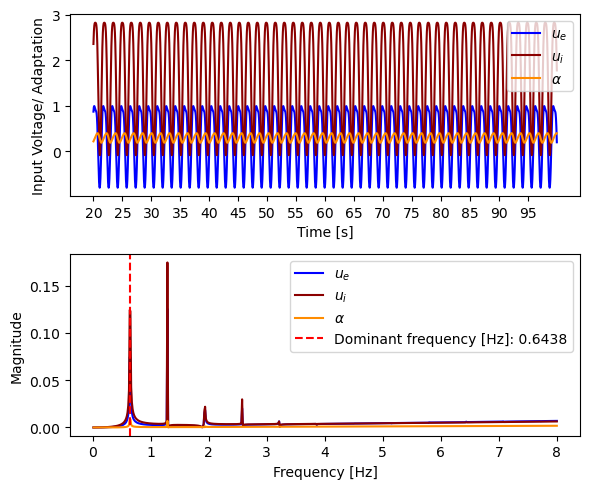

Frequency:  0.64375
Amplitude:  1.7925059129029342
Midpoint Oscillation e:  0.09198526359121184
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2177.777777777778
63  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


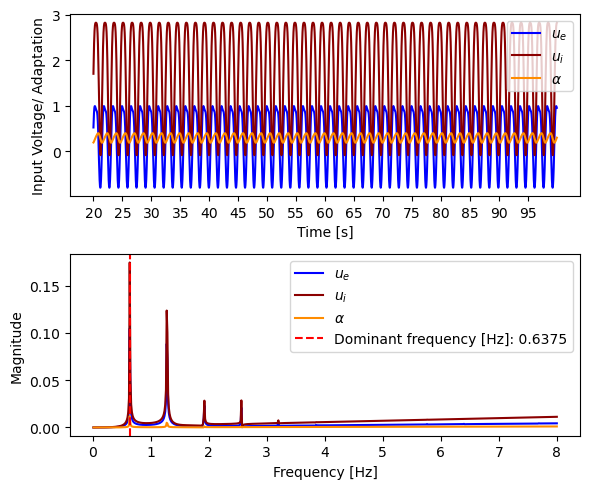

Frequency:  0.6375
Amplitude:  1.7923083808964924
Midpoint Oscillation e:  0.09188090841510271
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2200.0
64  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


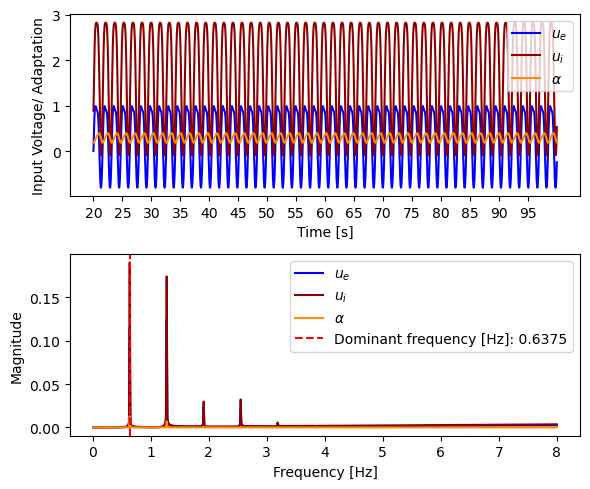

Frequency:  0.6375
Amplitude:  1.7921130966092278
Midpoint Oscillation e:  0.09177797413096994
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2222.222222222222
65  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


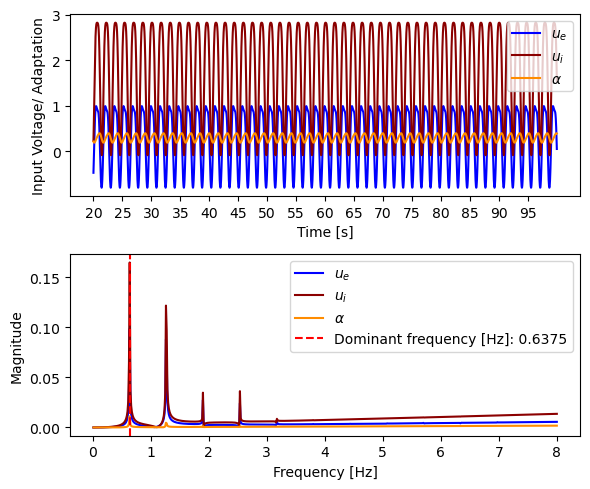

Frequency:  0.6375
Amplitude:  1.7919201882969196
Midpoint Oscillation e:  0.09167635462480417
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2244.4444444444443
66  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


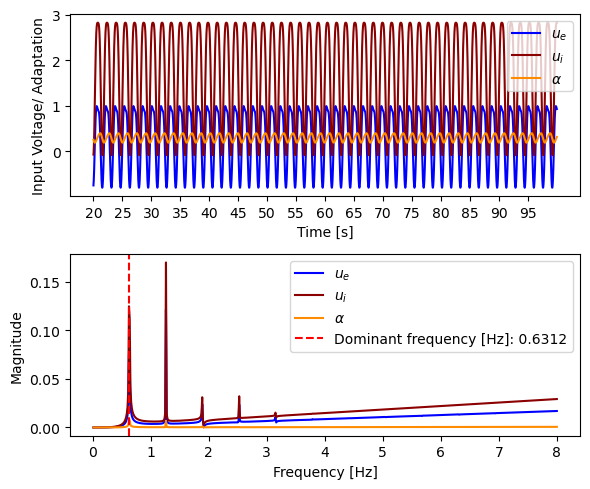

Frequency:  0.63125
Amplitude:  1.7917295764784802
Midpoint Oscillation e:  0.09157597017703473
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2266.6666666666665
67  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


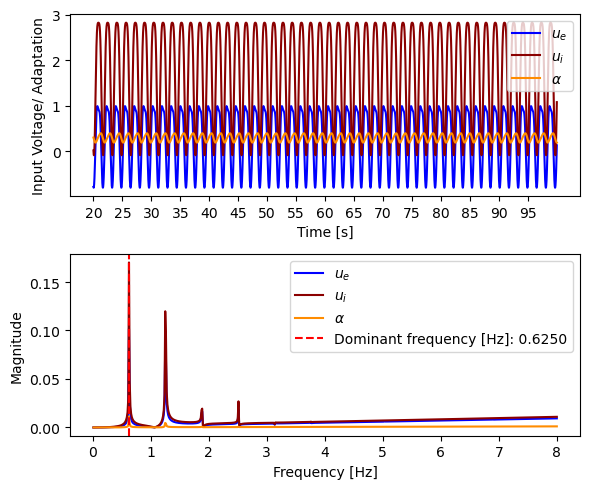

Frequency:  0.625
Amplitude:  1.7915570204013629
Midpoint Oscillation e:  0.09146890195878576
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2288.8888888888887
68  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


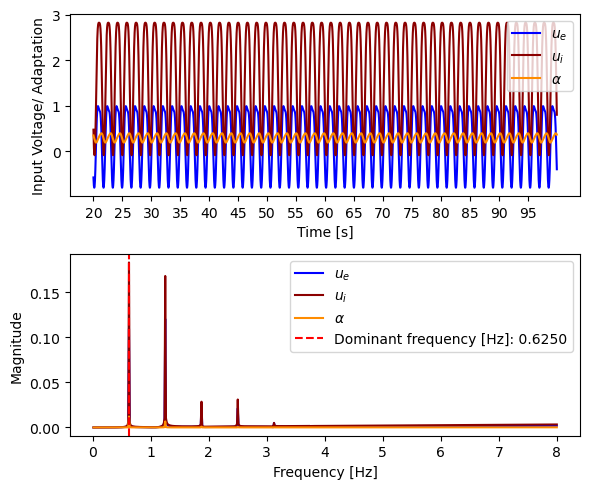

Frequency:  0.625
Amplitude:  1.791371396505474
Midpoint Oscillation e:  0.09137070951161291
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2311.1111111111113
69  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


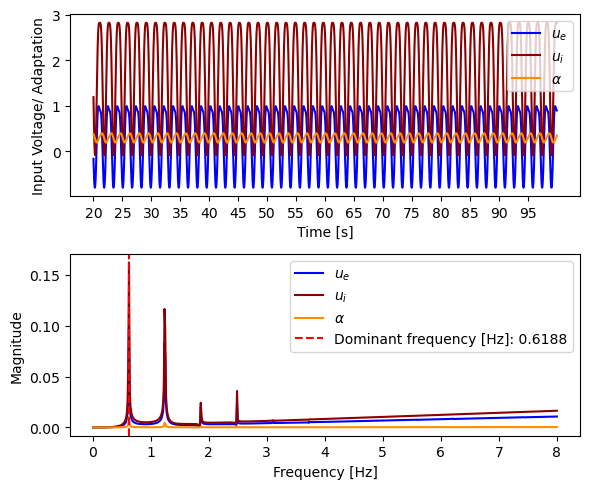

Frequency:  0.61875
Amplitude:  1.7911878997932558
Midpoint Oscillation e:  0.09127378274675896
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2333.333333333333
70  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


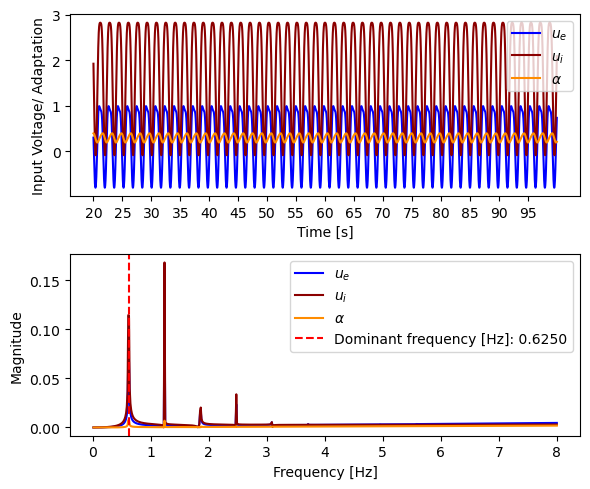

Frequency:  0.625
Amplitude:  1.7910065835852067
Midpoint Oscillation e:  0.09117794210704194
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2355.5555555555557
71  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


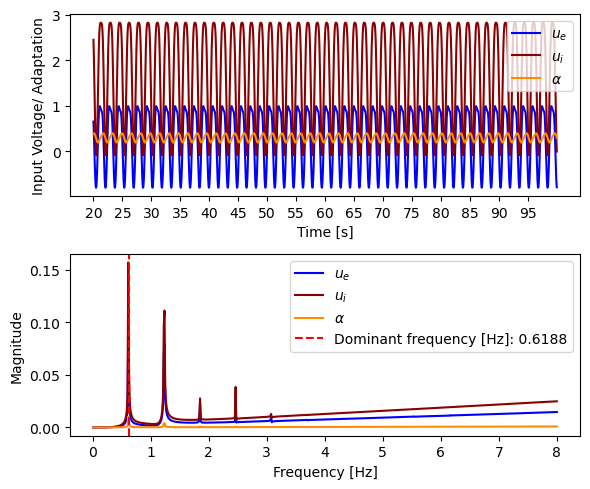

Frequency:  0.61875
Amplitude:  1.7908272945332793
Midpoint Oscillation e:  0.0910833135318635
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2377.777777777778
72  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


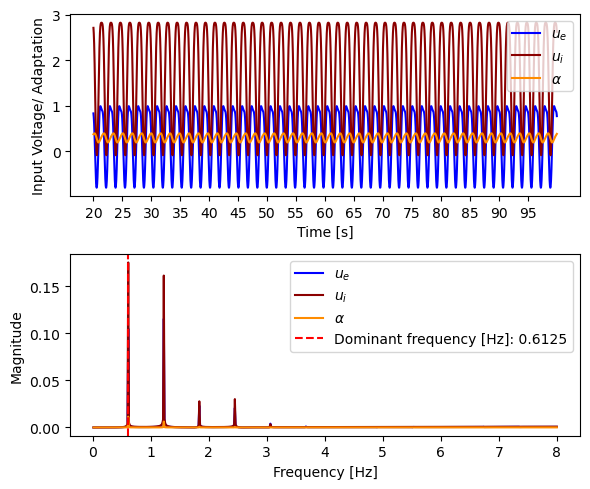

Frequency:  0.6125
Amplitude:  1.790650093910533
Midpoint Oscillation e:  0.09098981246252141
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2400.0
73  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


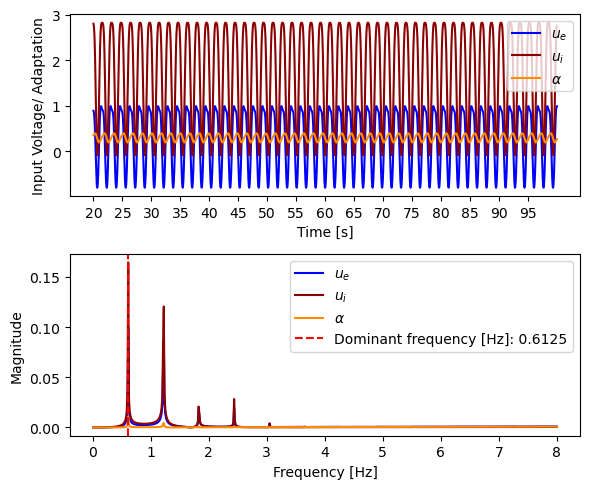

Frequency:  0.6125
Amplitude:  1.790474941477631
Midpoint Oscillation e:  0.09089737240184609
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2422.222222222222
74  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


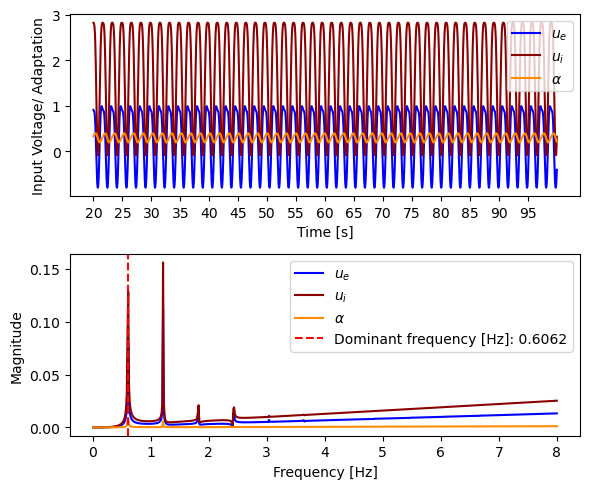

Frequency:  0.60625
Amplitude:  1.7903017149049427
Midpoint Oscillation e:  0.09080606248430584
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2444.4444444444443
75  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


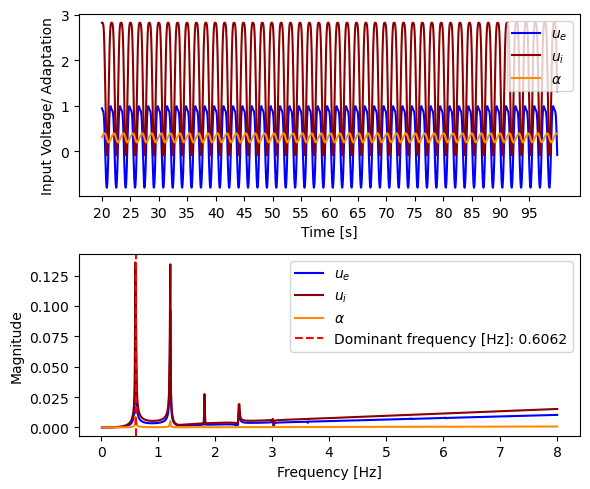

Frequency:  0.60625
Amplitude:  1.7901304483745488
Midpoint Oscillation e:  0.0907157888856952
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2466.6666666666665
76  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


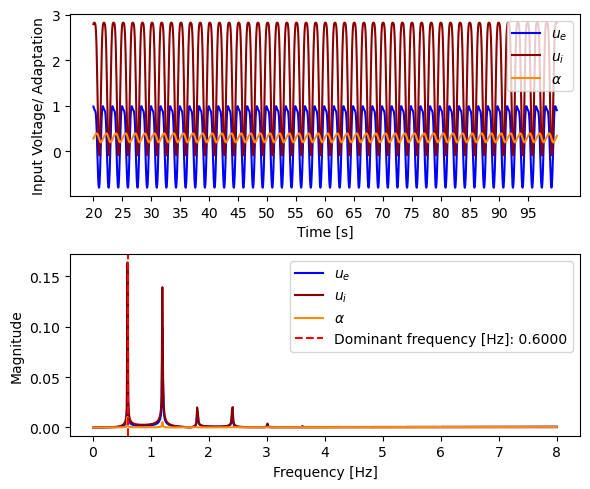

Frequency:  0.6
Amplitude:  1.7899611184280804
Midpoint Oscillation e:  0.09062659059182943
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2488.8888888888887
77  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


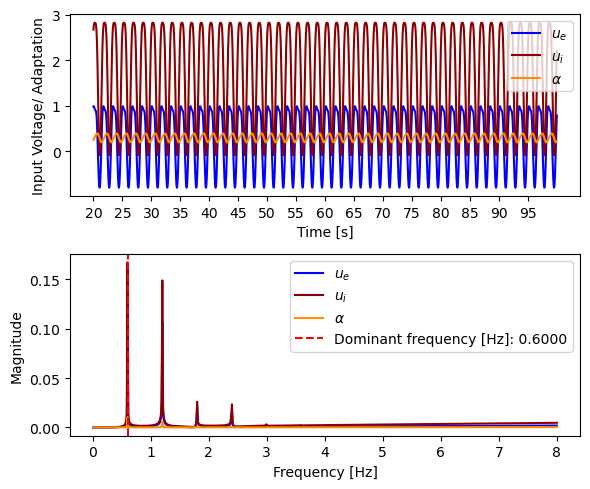

Frequency:  0.6
Amplitude:  1.7897991411615348
Midpoint Oscillation e:  0.09054116295716036
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2511.1111111111113
78  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


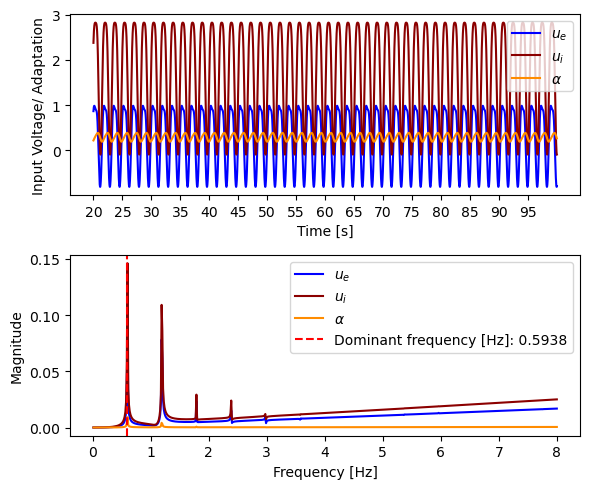

Frequency:  0.59375
Amplitude:  1.789633196511696
Midpoint Oscillation e:  0.09045382264398599
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2533.333333333333
79  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


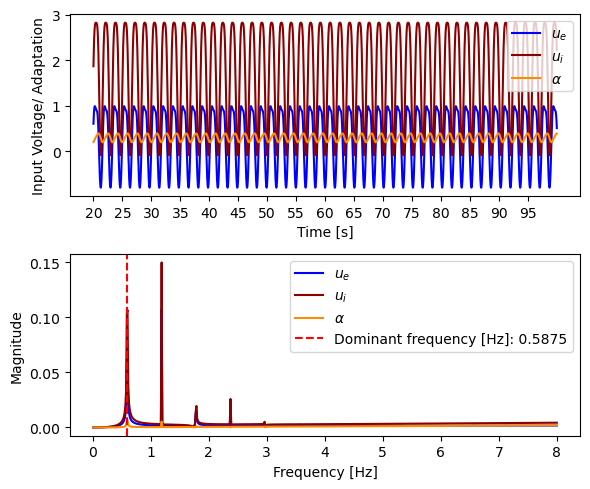

Frequency:  0.5875
Amplitude:  1.7894690402257964
Midpoint Oscillation e:  0.09036744889861298
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2555.5555555555557
80  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


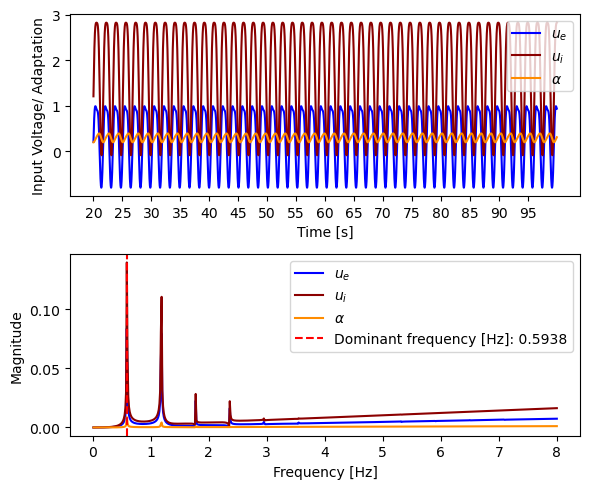

Frequency:  0.59375
Amplitude:  1.7893065549682057
Midpoint Oscillation e:  0.09028206759280388
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2577.777777777778
81  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


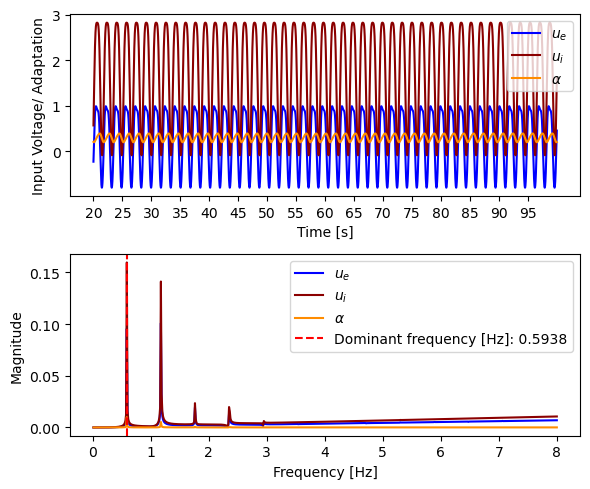

Frequency:  0.59375
Amplitude:  1.789145866549588
Midpoint Oscillation e:  0.0901975794653001
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2600.0
82  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


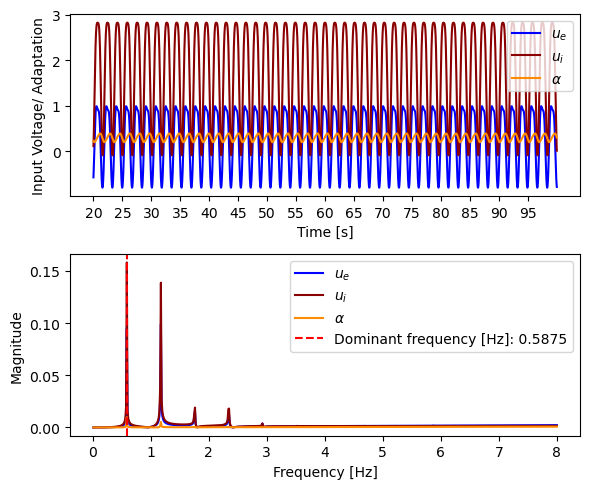

Frequency:  0.5875
Amplitude:  1.7889869123000568
Midpoint Oscillation e:  0.09011395965695601
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2622.222222222222
83  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


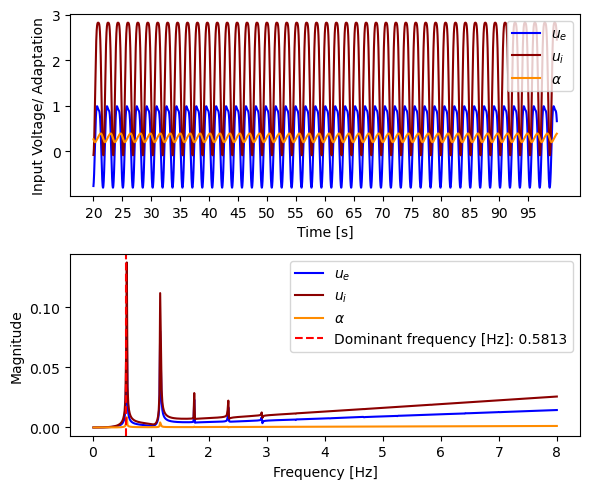

Frequency:  0.58125
Amplitude:  1.7888295925645643
Midpoint Oscillation e:  0.09003130146197608
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2644.4444444444443
84  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


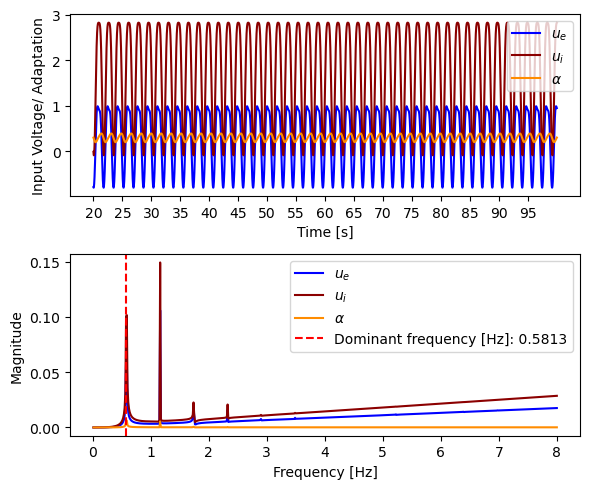

Frequency:  0.58125
Amplitude:  1.78867389508515
Midpoint Oscillation e:  0.08994950767703236
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2666.6666666666665
85  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


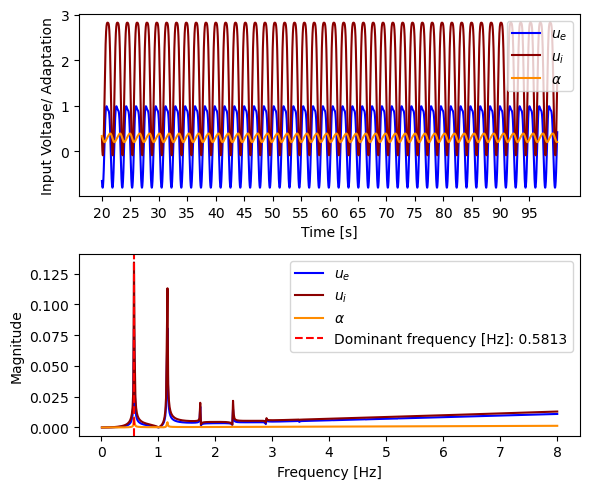

Frequency:  0.58125
Amplitude:  1.788519816794282
Midpoint Oscillation e:  0.08986860172843608
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2688.8888888888887
86  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


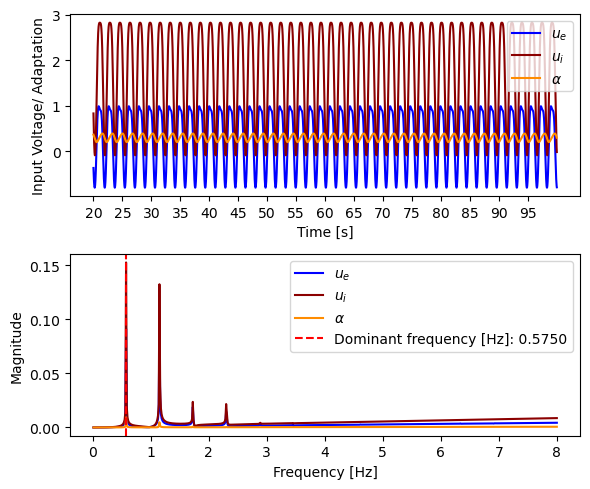

Frequency:  0.575
Amplitude:  1.7883672971322893
Midpoint Oscillation e:  0.08978851106969954
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2711.1111111111113
87  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


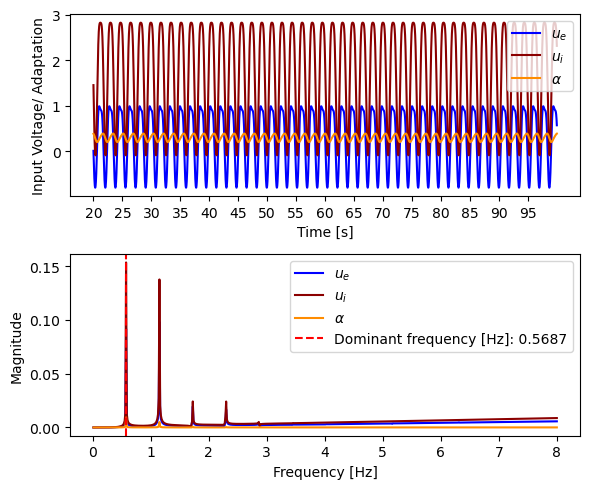

Frequency:  0.56875
Amplitude:  1.788216348060233
Midpoint Oscillation e:  0.0897092778911247
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2733.333333333333
88  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


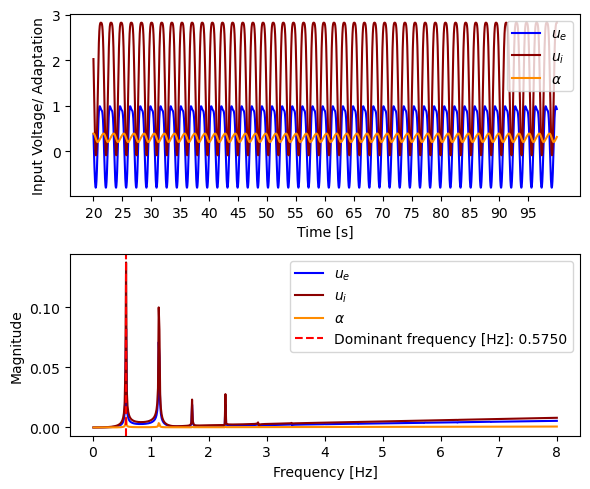

Frequency:  0.575
Amplitude:  1.788066977095438
Midpoint Oscillation e:  0.08963085687991795
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2755.5555555555557
89  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


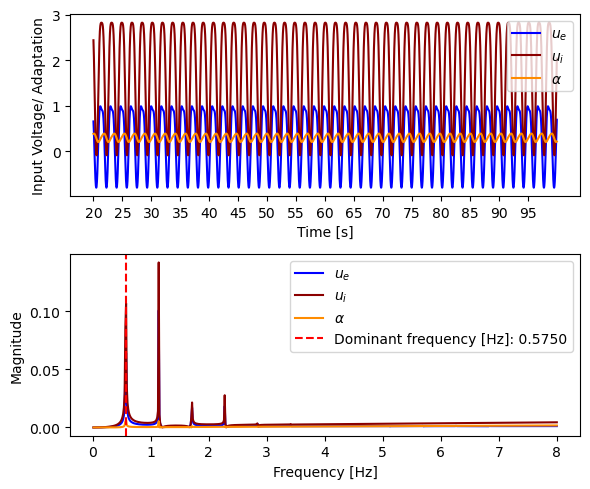

Frequency:  0.575
Amplitude:  1.787919608323341
Midpoint Oscillation e:  0.08955352292120095
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2777.7777777777774
90  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


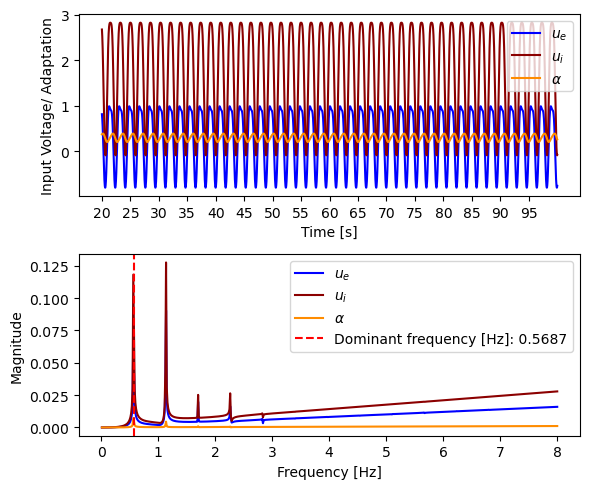

Frequency:  0.56875
Amplitude:  1.7877738831590193
Midpoint Oscillation e:  0.08947707059566706
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2800.0
91  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


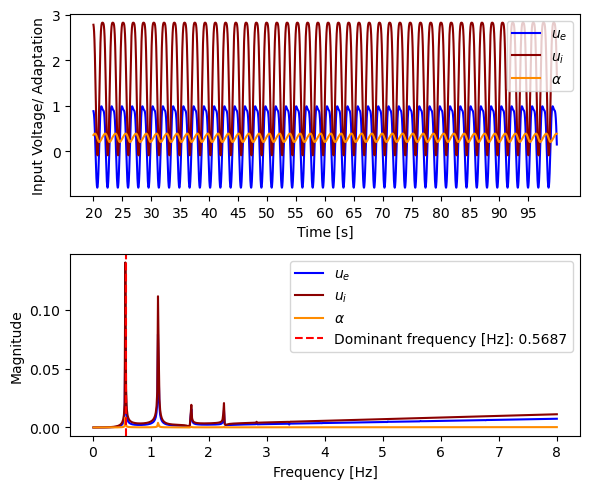

Frequency:  0.56875
Amplitude:  1.787629670823095
Midpoint Oscillation e:  0.08940144554173857
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2822.222222222222
92  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


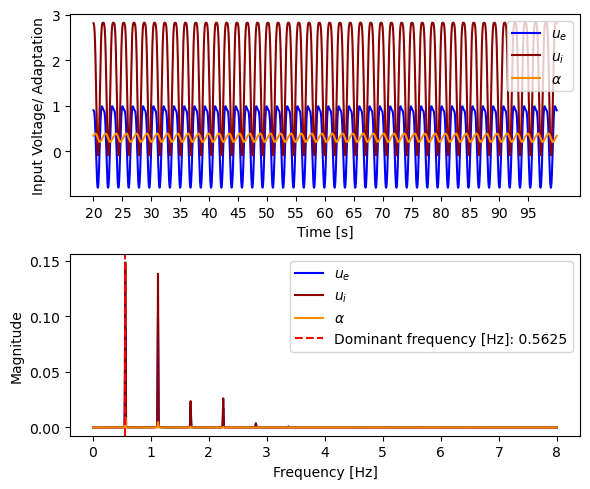

Frequency:  0.5625
Amplitude:  1.787486981783577
Midpoint Oscillation e:  0.08932653305833815
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2844.4444444444443
93  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


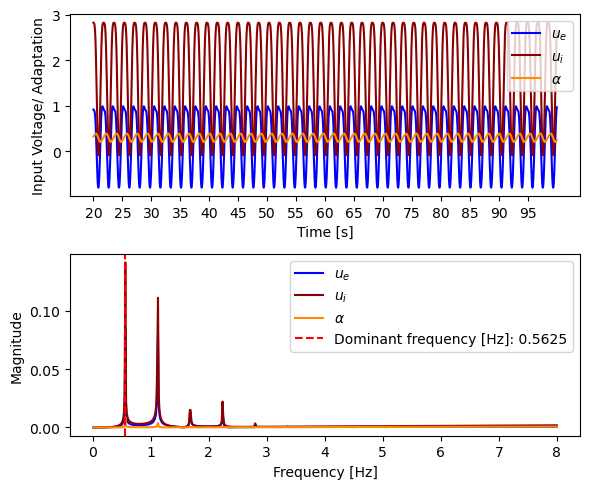

Frequency:  0.5625
Amplitude:  1.7873457437230709
Midpoint Oscillation e:  0.0892524149220203
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2866.6666666666665
94  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


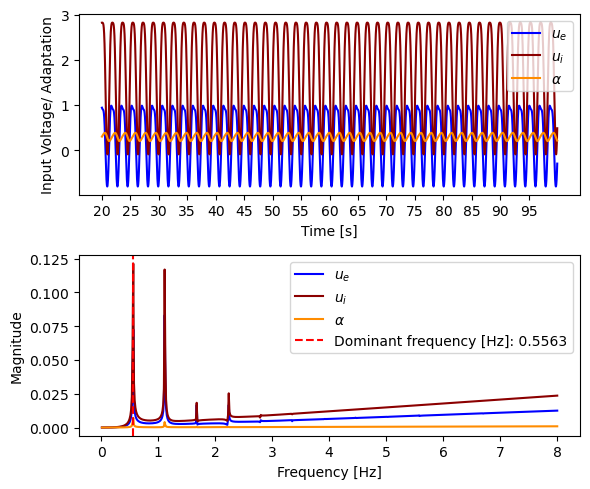

Frequency:  0.55625
Amplitude:  1.7872058970407458
Midpoint Oscillation e:  0.08917904686801709
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2888.8888888888887
95  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


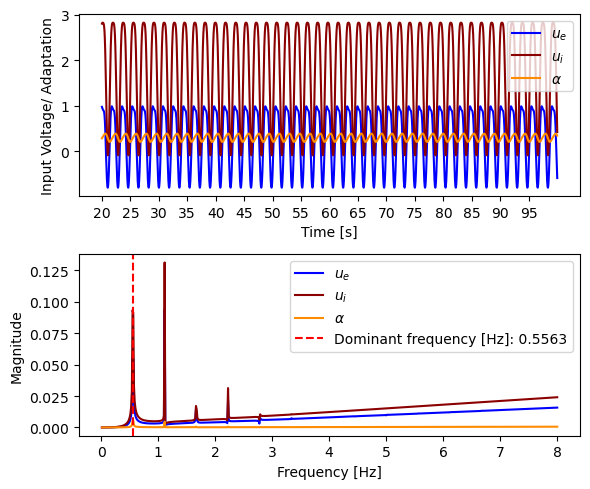

Frequency:  0.55625
Amplitude:  1.7870674514491625
Midpoint Oscillation e:  0.08910643076145708
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2911.111111111111
96  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


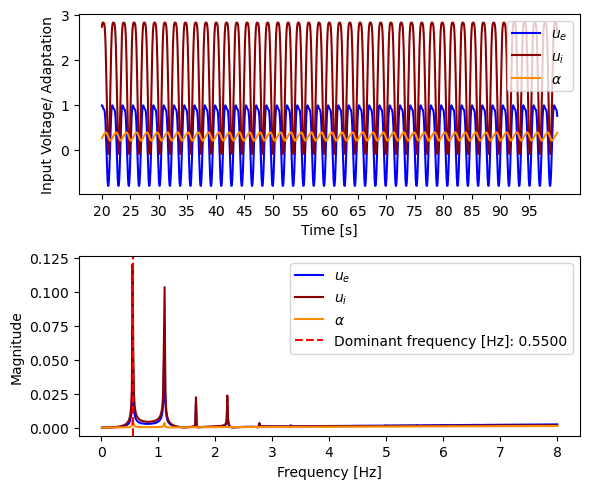

Frequency:  0.55
Amplitude:  1.7871386861086205
Midpoint Oscillation e:  0.08913875193415721
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2933.333333333333
97  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


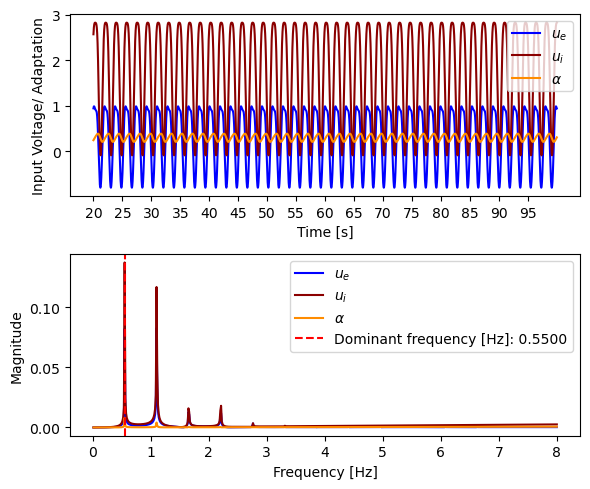

Frequency:  0.55
Amplitude:  1.7870079683885085
Midpoint Oscillation e:  0.08907001693927408
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2955.5555555555557
98  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


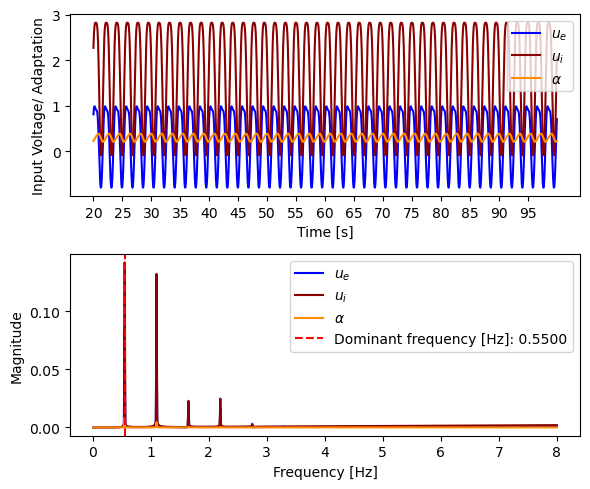

Frequency:  0.55
Amplitude:  1.7868786078486039
Midpoint Oscillation e:  0.08900205567322739
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2977.777777777778
99  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


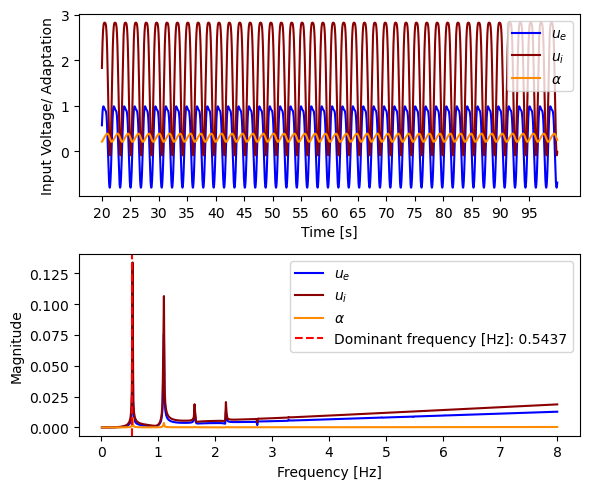

Frequency:  0.54375
Amplitude:  1.7867506329898706
Midpoint Oscillation e:  0.08893482189403878
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  3000.0
100  /  100
Type of Instability: ['Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


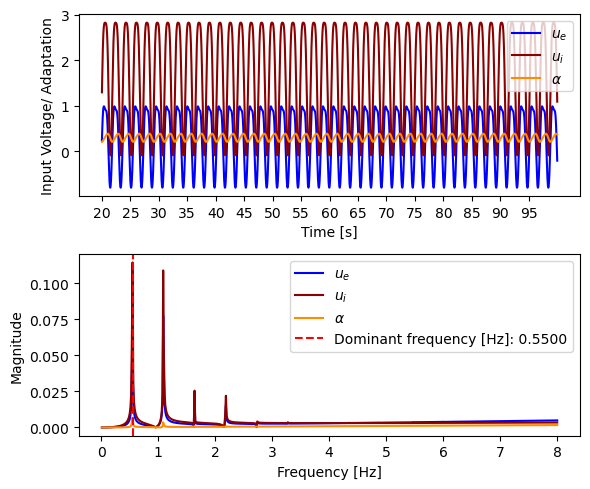

Frequency:  0.55
Amplitude:  1.7866239301837803
Midpoint Oscillation e:  0.08886832937822459
Midpoint Equilibrium e:  0.13382238024901616


In [27]:
refresh()
param = parameterset

param["tau_e"] = 20
param["tau_i"] = 40
param["tau_alpha"] = 1200
param["g"] = 0.8

I_e = 1.2
I_i = 0.3

perturbation_type = 'random'
# perturbation_type = 'box'
perturbation_box_size = 0.4
perturbation_strength = 0.01

connectivity = 'gauss'

dt=2e-1
t_max=100e3
t_start = 20

variable = 'tau_alpha'
variable_start=800
variable_stop=3000
steps=100

name = 'Simulation_Data/gauss_result_tau_alpha'
gauss_result_tau_alpha = parameter_variation(
                              param=param,
                              name=name,
                              I_e=I_e,
                              I_i=I_i,
                              variable=variable,
                              variable_start=variable_start,
                              connectivity=connectivity,
                              perturbation_type=perturbation_type,
                              perturbation_strength=perturbation_strength,
                              perturbation_box_size=perturbation_box_size,
                              variable_stop=variable_stop,
                              steps=steps,
                              t_max=t_max,
                              t_start=t_start,
                              dt=dt,
                              )

I_e:  1.2
I_i:  0.3
Variable:  tau_alpha
[-0.14517166  0.17749262  0.41281642]


/Users/felixstoffregen/Library/Mobile Documents/com~apple~CloudDocs/Studium/Master/Masterarbeit/Neural_Field_Model/Adaptation_Functions/A0Basic_Functions.py:88: RuntimeWarning: invalid value encountered in divide
  result = np.where(np.isclose(denominator, 0), nu, np.sin(denominator) / denominator)
/Users/felixstoffregen/Library/Mobile Documents/com~apple~CloudDocs/Studium/Master/Masterarbeit/Neural_Field_Model/Adaptation_Functions/A0Basic_Functions.py:88: RuntimeWarning: invalid value encountered in scalar divide
  result = np.where(np.isclose(denominator, 0), nu, np.sin(denominator) / denominator)


Time to get points of Equilibrium: 3.509
Time for classification: 6.619


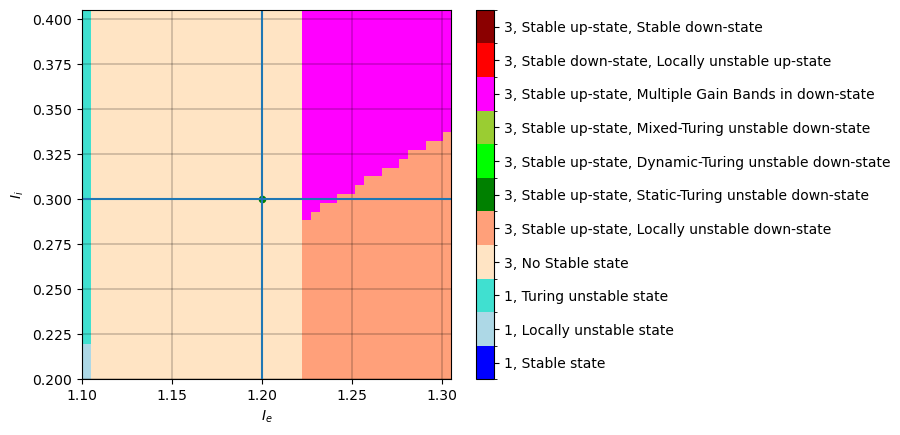


tau_alpha  =  800.0
1  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990473
ui_0: 0.15006273090899755
alpha: -0.14517165906990473


/Users/felixstoffregen/Library/Mobile Documents/com~apple~CloudDocs/Studium/Master/Masterarbeit/Neural_Field_Model/Adaptation_Functions/A0Basic_Functions.py:88: RuntimeWarning: invalid value encountered in divide
  result = np.where(np.isclose(denominator, 0), nu, np.sin(denominator) / denominator)
/Users/felixstoffregen/Library/Mobile Documents/com~apple~CloudDocs/Studium/Master/Masterarbeit/Neural_Field_Model/Adaptation_Functions/A0Basic_Functions.py:88: RuntimeWarning: invalid value encountered in scalar divide
  result = np.where(np.isclose(denominator, 0), nu, np.sin(denominator) / denominator)


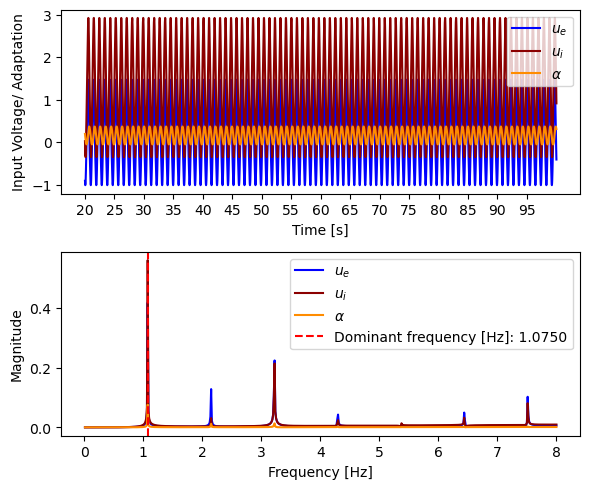

Frequency:  1.075
Amplitude:  2.4833955365410034
Midpoint Oscillation e:  0.22742112215268462
Midpoint Equilibrium e:  0.13382238024901644
Type of Instability: ['Dynamic Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


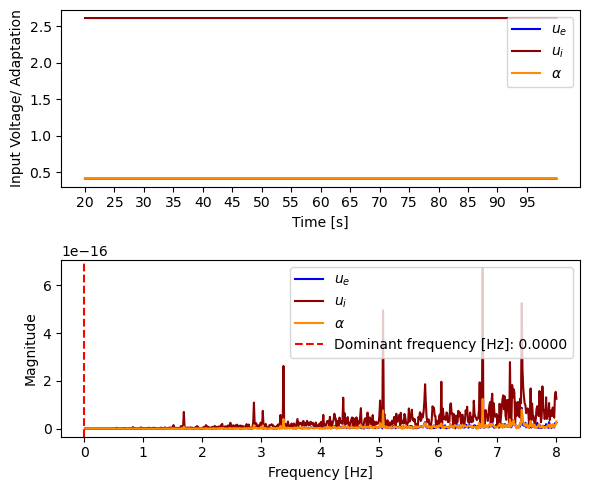

Frequency:  0.0
Amplitude:  0.0
Midpoint Oscillation e:  0.41281641956788506
Midpoint Equilibrium e:  0.13382238024901644

tau_alpha  =  822.2222222222222
2  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


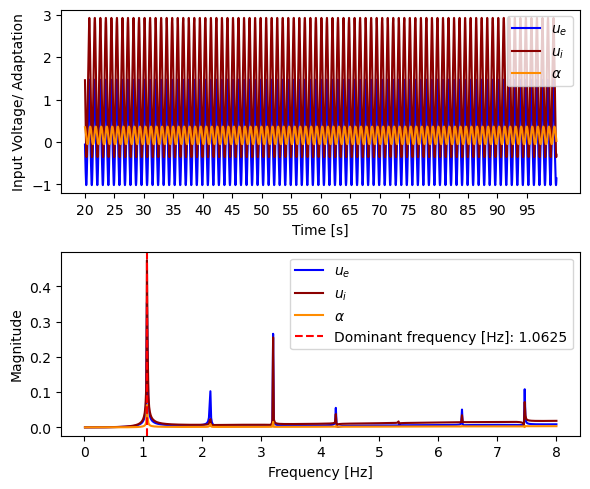

Frequency:  1.0625
Amplitude:  2.48561053419094
Midpoint Oscillation e:  0.2267271856990285
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Dynamic Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


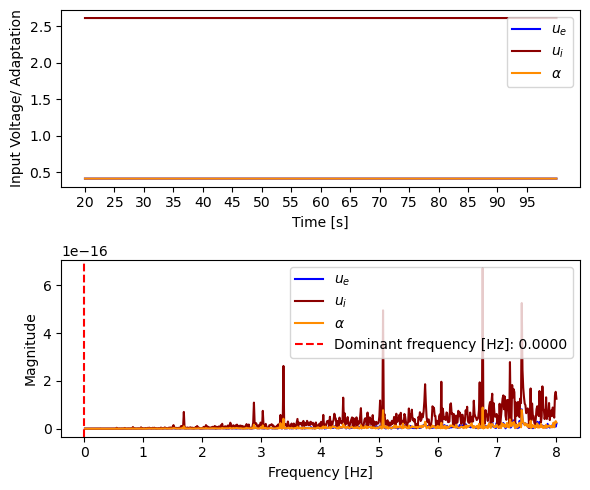

Frequency:  0.0
Amplitude:  0.0
Midpoint Oscillation e:  0.41281641956788373
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  844.4444444444445
3  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


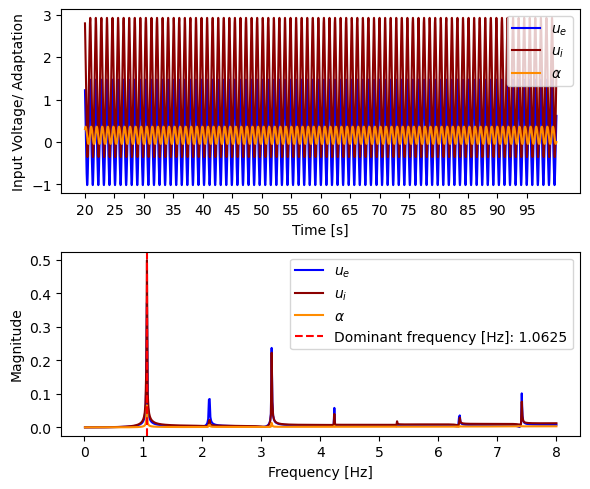

Frequency:  1.0625
Amplitude:  2.4876978097163223
Midpoint Oscillation e:  0.22606442270211857
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Dynamic Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


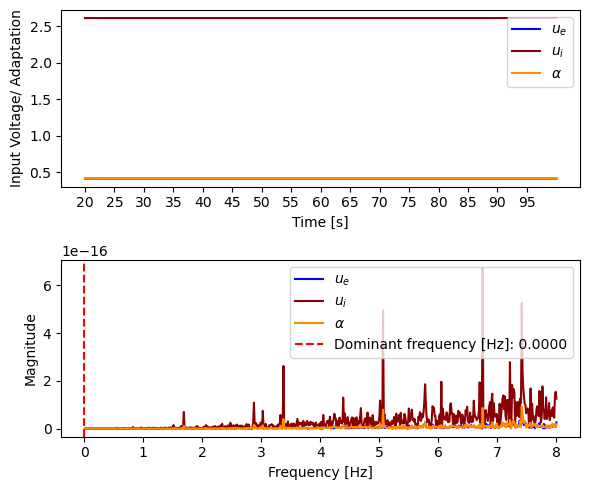

Frequency:  0.0
Amplitude:  0.0
Midpoint Oscillation e:  0.4128164195678824
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  866.6666666666666
4  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


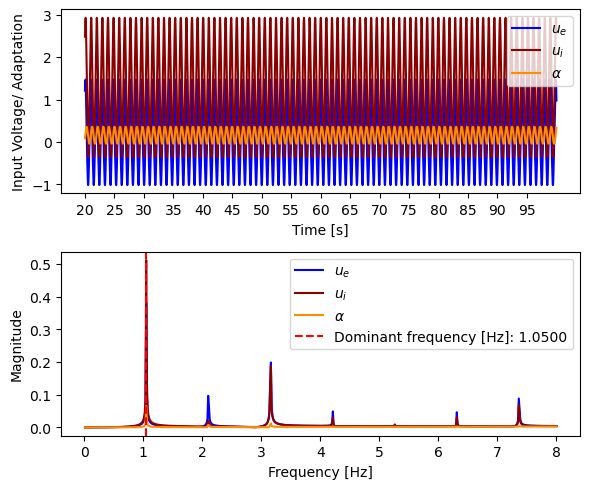

Frequency:  1.05
Amplitude:  2.4896682069534695
Midpoint Oscillation e:  0.2254317068443964
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Dynamic Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


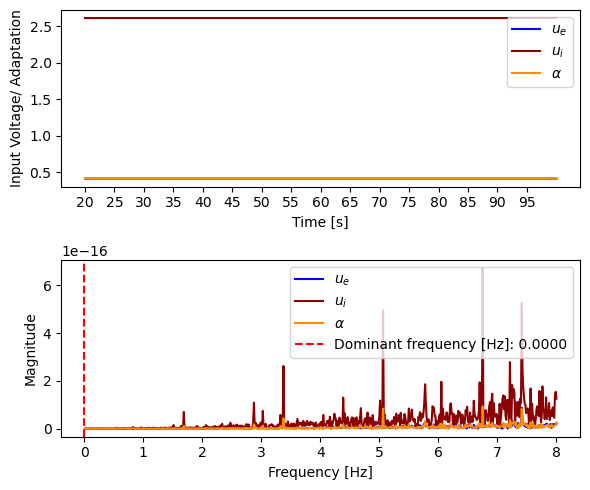

Frequency:  0.0
Amplitude:  0.0
Midpoint Oscillation e:  0.4128164195678809
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  888.8888888888889
5  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


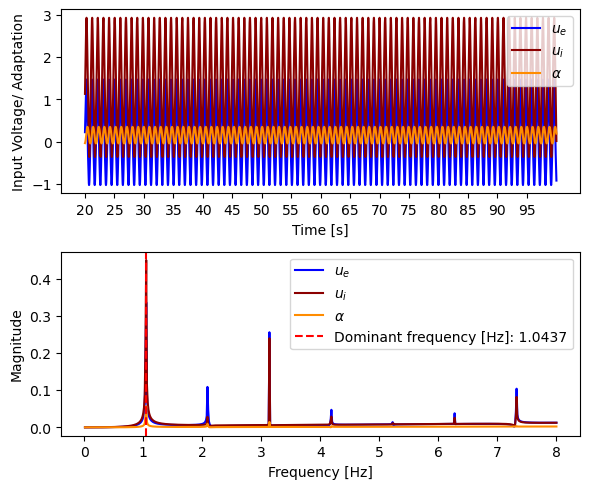

Frequency:  1.04375
Amplitude:  2.491531578663281
Midpoint Oscillation e:  0.22482808590884773
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Dynamic Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


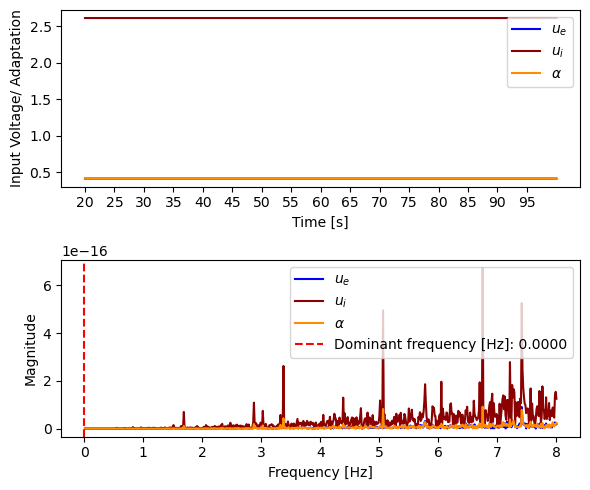

Frequency:  0.0
Amplitude:  0.0
Midpoint Oscillation e:  0.4128164195678793
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  911.1111111111111
6  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


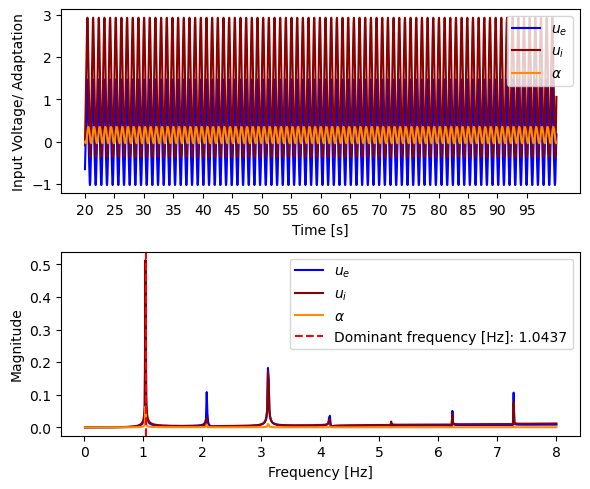

Frequency:  1.04375
Amplitude:  2.493297032341739
Midpoint Oscillation e:  0.22425288230420992
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Dynamic Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


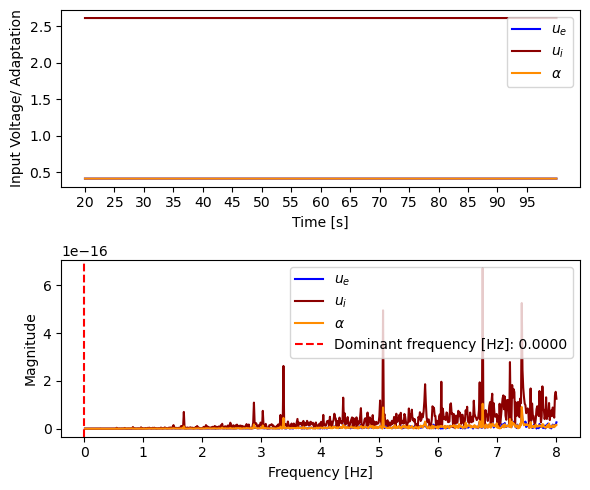

Frequency:  0.0
Amplitude:  0.0
Midpoint Oscillation e:  0.41281641956787796
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  933.3333333333333
7  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


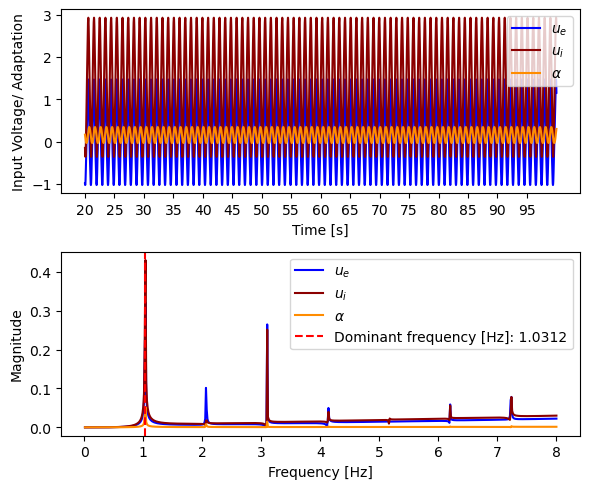

Frequency:  1.03125
Amplitude:  2.49497257990168
Midpoint Oscillation e:  0.22370550328011418
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Dynamic Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


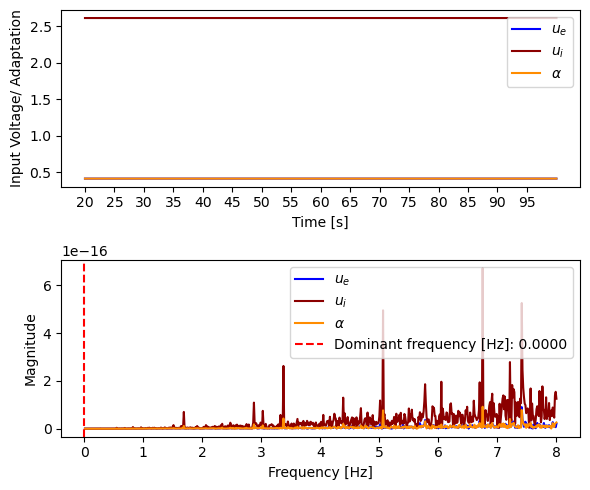

Frequency:  0.0
Amplitude:  0.0
Midpoint Oscillation e:  0.41281641956787646
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  955.5555555555555
8  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


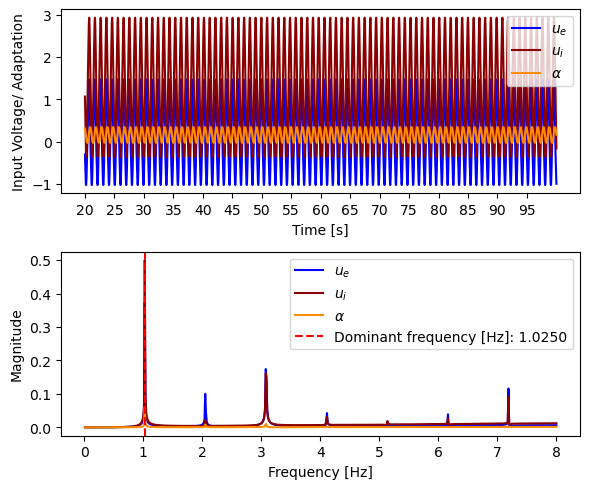

Frequency:  1.025
Amplitude:  2.4965658481705795
Midpoint Oscillation e:  0.22318572360866107
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Dynamic Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


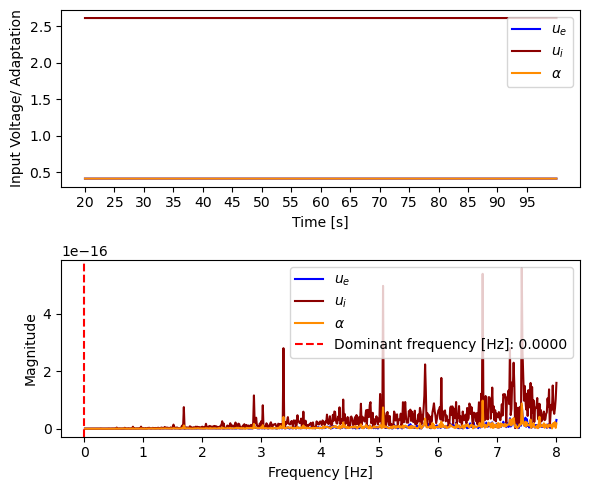

Frequency:  0.0
Amplitude:  0.0
Midpoint Oscillation e:  0.41281641956787557
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  977.7777777777778
9  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


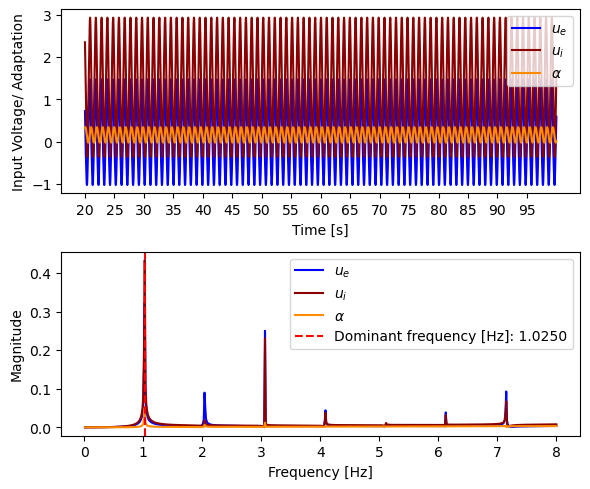

Frequency:  1.025
Amplitude:  2.498084134429504
Midpoint Oscillation e:  0.2226937415194301
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Dynamic Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


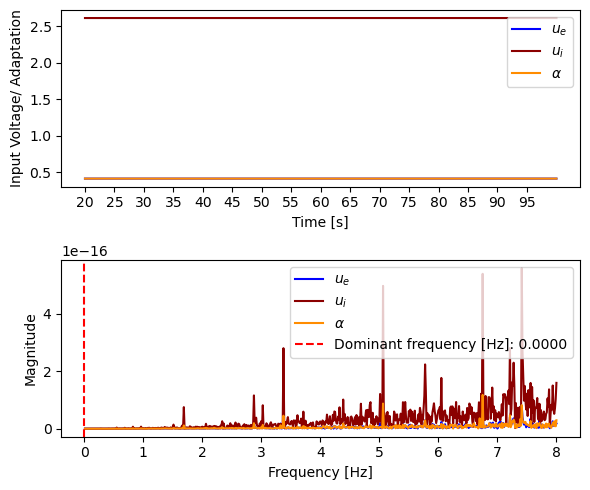

Frequency:  0.0
Amplitude:  0.0
Midpoint Oscillation e:  0.4128164195678738
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1000.0
10  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


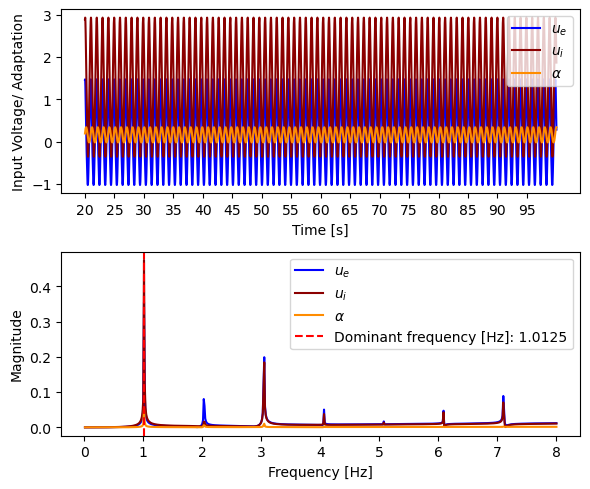

Frequency:  1.0125
Amplitude:  2.4995344686278402
Midpoint Oscillation e:  0.22223040839216257
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Dynamic Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


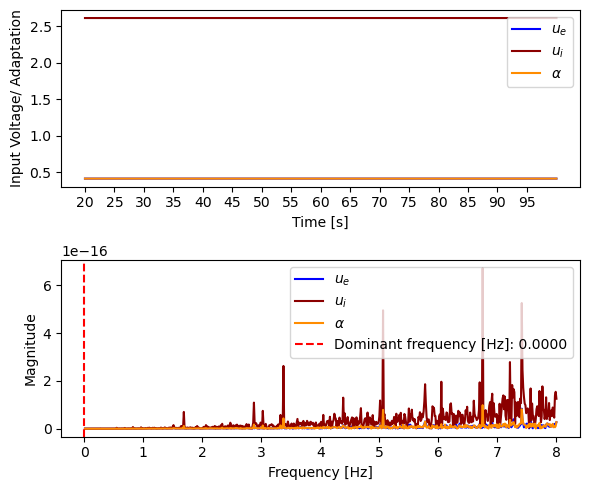

Frequency:  0.0
Amplitude:  0.0
Midpoint Oscillation e:  0.41281641956787246
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1022.2222222222222
11  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


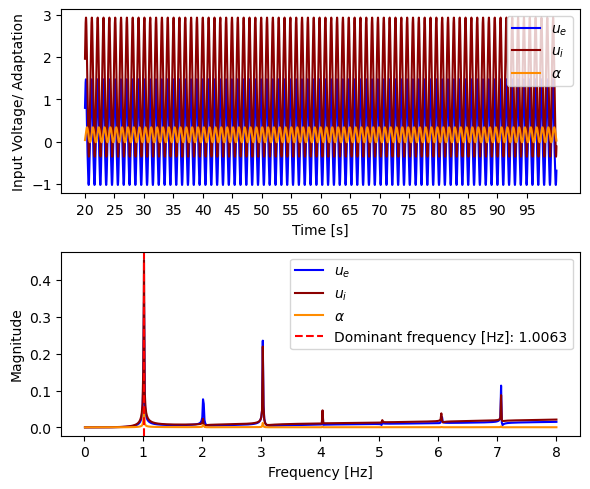

Frequency:  1.00625
Amplitude:  2.500923945375631
Midpoint Oscillation e:  0.2217973740890009
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Dynamic Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


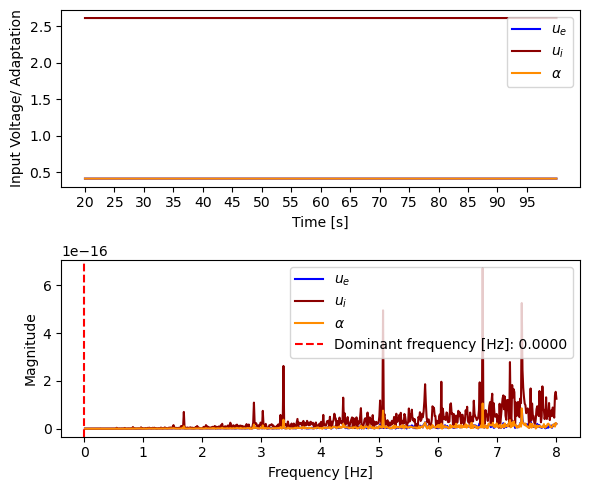

Frequency:  0.0
Amplitude:  0.0
Midpoint Oscillation e:  0.41281641956787113
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1044.4444444444443
12  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


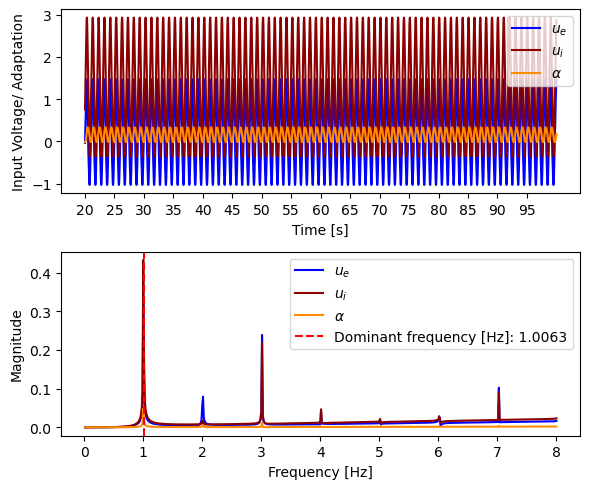

Frequency:  1.00625
Amplitude:  2.5022598987798386
Midpoint Oscillation e:  0.22139746307686903
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Dynamic Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


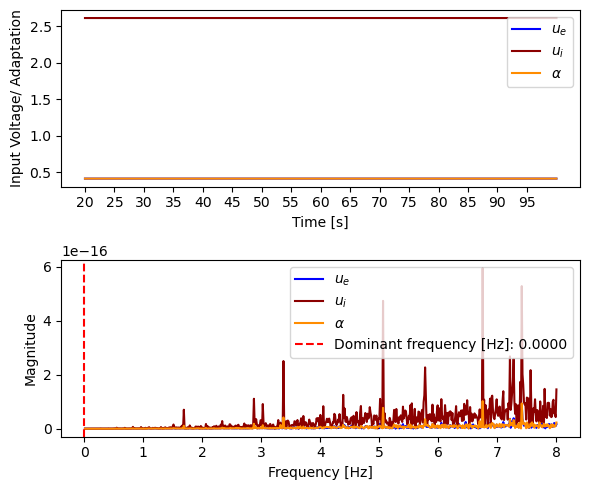

Frequency:  0.0
Amplitude:  0.0
Midpoint Oscillation e:  0.4128164195678695
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1066.6666666666665
13  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


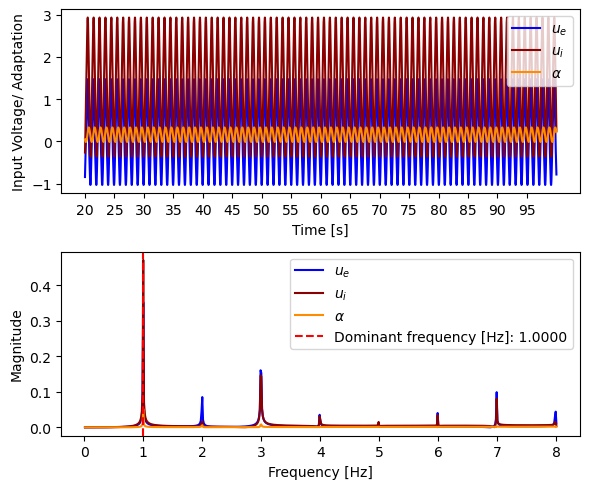

Frequency:  1.0
Amplitude:  2.503549759531986
Midpoint Oscillation e:  0.22103548364836845
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Dynamic Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


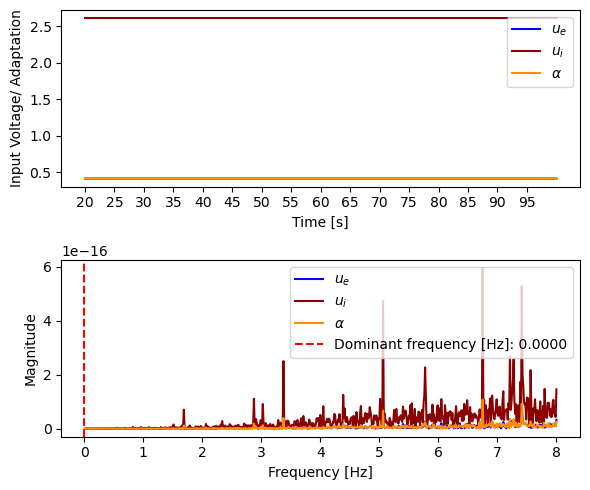

Frequency:  0.0
Amplitude:  0.0
Midpoint Oscillation e:  0.4128164195678682
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1088.888888888889
14  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


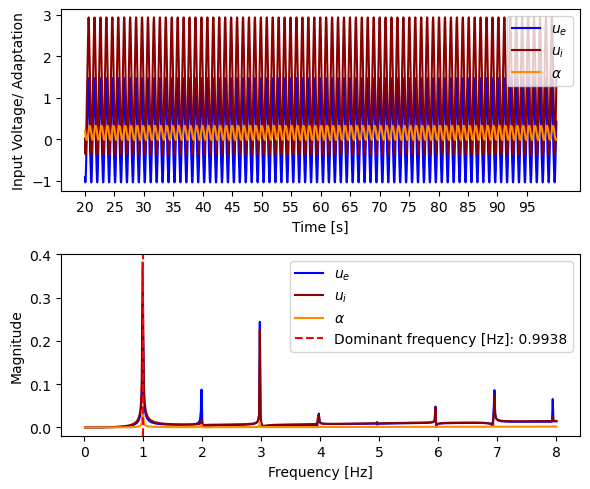

Frequency:  0.99375
Amplitude:  2.5048019895571776
Midpoint Oscillation e:  0.22071895352223048
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Dynamic Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


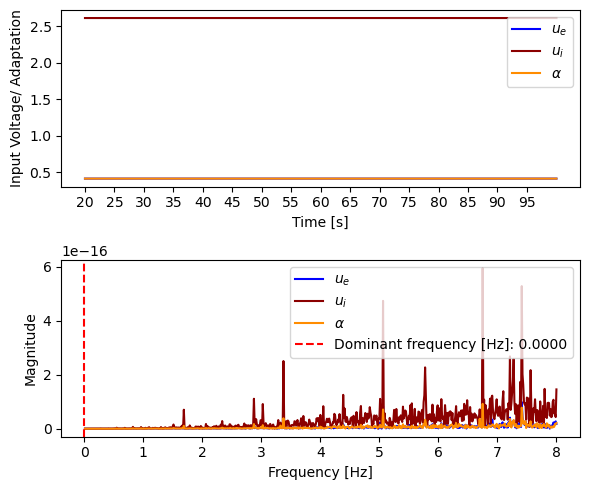

Frequency:  0.0
Amplitude:  0.0
Midpoint Oscillation e:  0.41281641956786624
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1111.111111111111
15  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


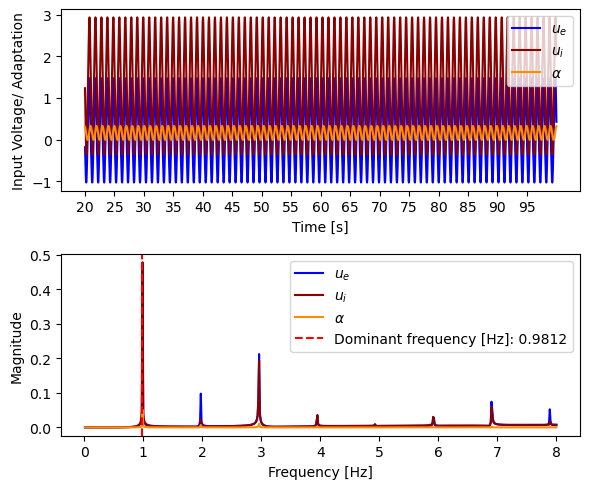

Frequency:  0.98125
Amplitude:  2.506025223675242
Midpoint Oscillation e:  0.2204605212606462
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Dynamic Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


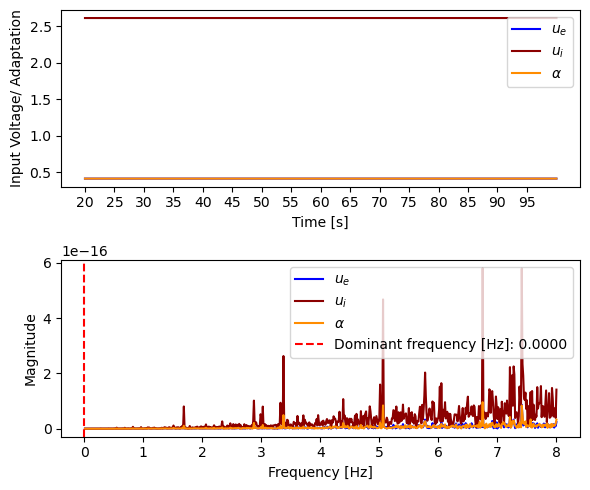

Frequency:  0.0
Amplitude:  0.0
Midpoint Oscillation e:  0.4128164195678649
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1133.3333333333333
16  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


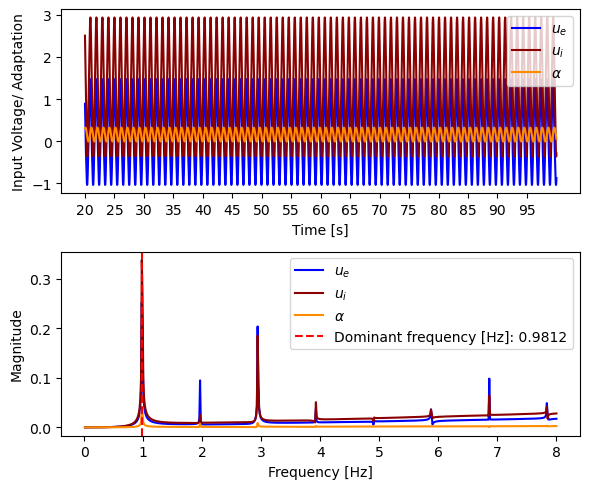

Frequency:  0.98125
Amplitude:  2.5072295970095624
Midpoint Oscillation e:  0.22028117222457222
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


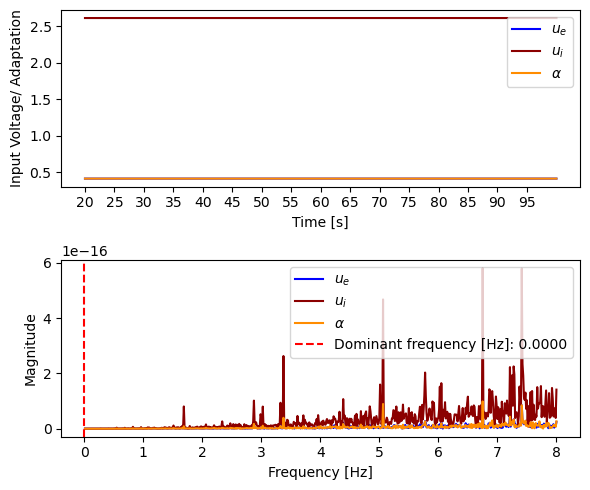

Frequency:  0.0
Amplitude:  0.0
Midpoint Oscillation e:  0.4128164195678642
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1155.5555555555557
17  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


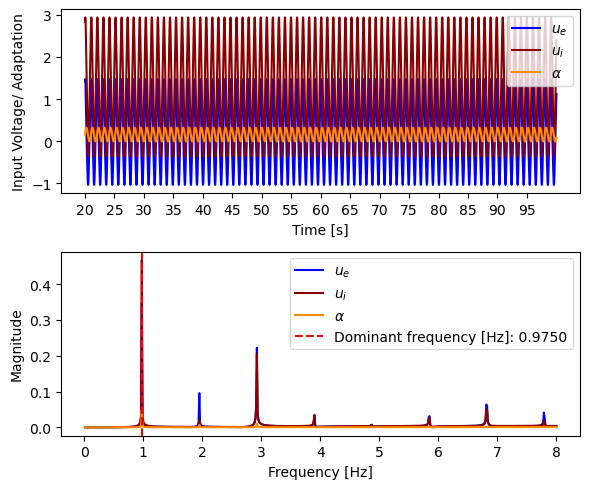

Frequency:  0.975
Amplitude:  2.5084258982772694
Midpoint Oscillation e:  0.2202187450392703
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


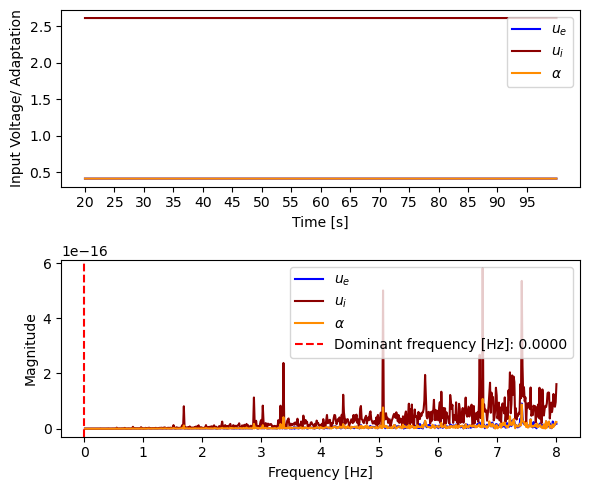

Frequency:  0.0
Amplitude:  0.0
Midpoint Oscillation e:  0.4128164195678627
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1177.7777777777778
18  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


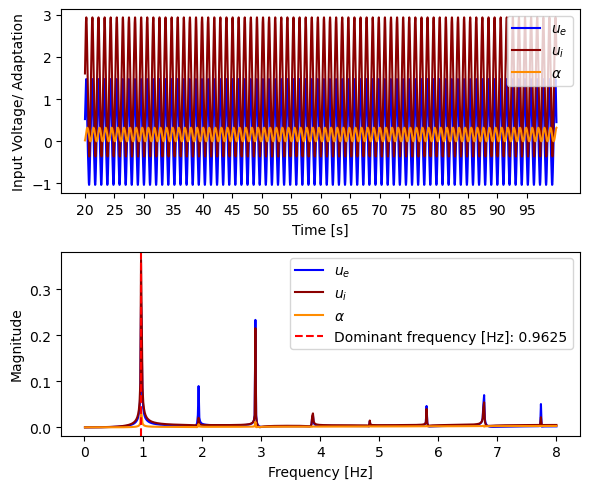

Frequency:  0.9625
Amplitude:  2.509640221234599
Midpoint Oscillation e:  0.22034736484317552
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


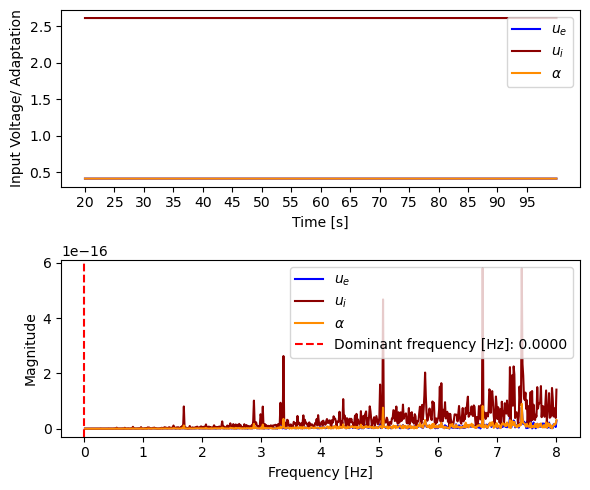

Frequency:  0.0
Amplitude:  0.0
Midpoint Oscillation e:  0.4128164195678615
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1200.0
19  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


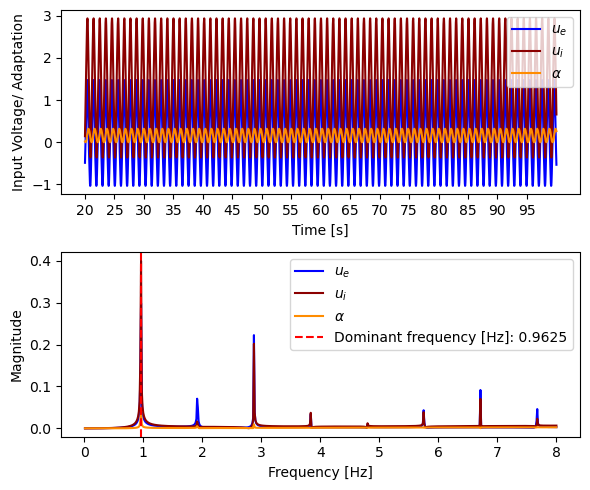

Frequency:  0.9625
Amplitude:  2.510923153953792
Midpoint Oscillation e:  0.22080055700563928
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


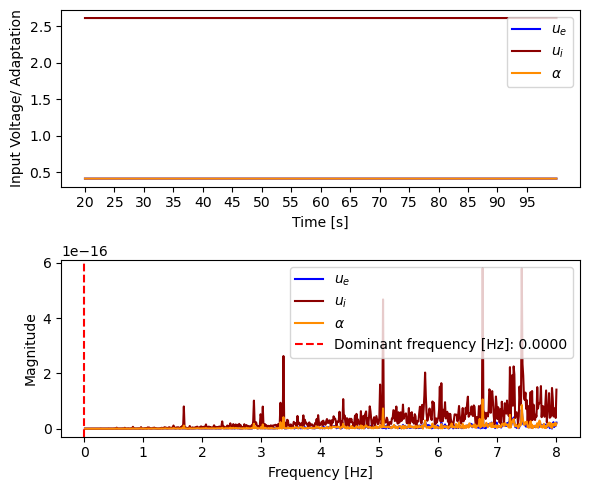

Frequency:  0.0
Amplitude:  0.0
Midpoint Oscillation e:  0.4128164195678602
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1222.2222222222222
20  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


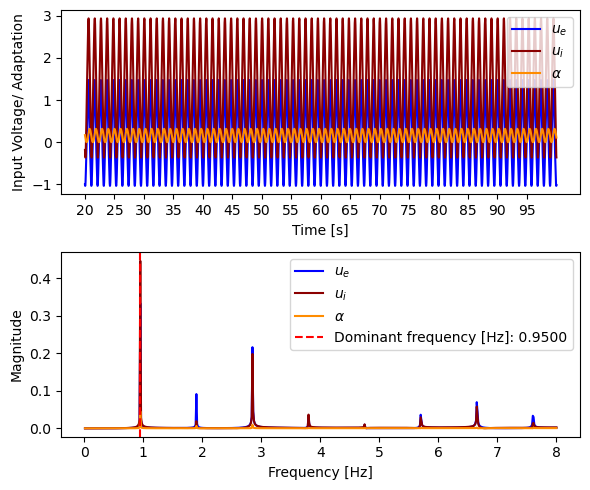

Frequency:  0.95
Amplitude:  2.5121740008575024
Midpoint Oscillation e:  0.22127881856456122
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


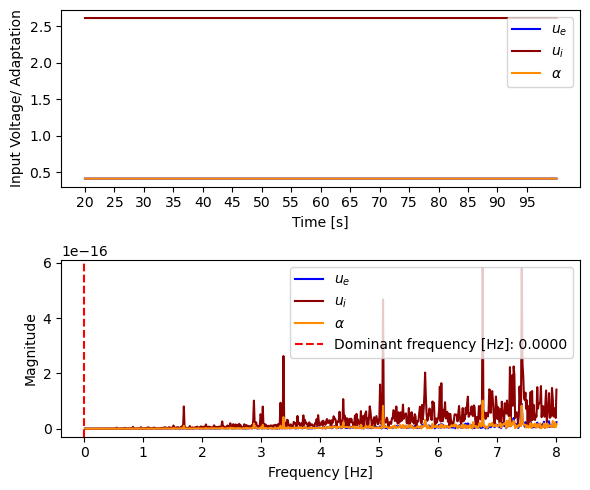

Frequency:  0.0
Amplitude:  0.0
Midpoint Oscillation e:  0.4128164195678584
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1244.4444444444443
21  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


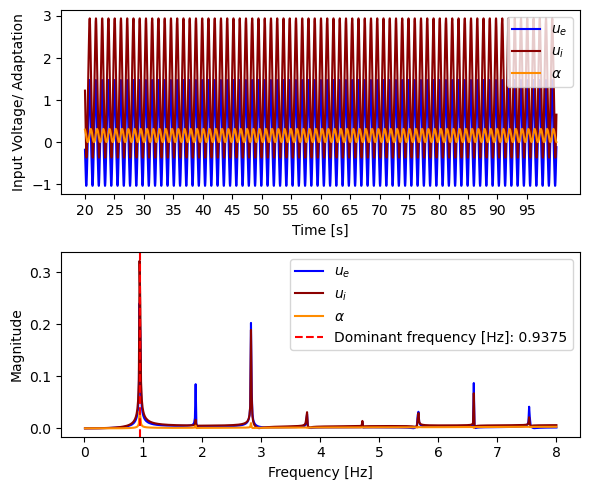

Frequency:  0.9375
Amplitude:  2.513381016109938
Midpoint Oscillation e:  0.22174203114066948
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


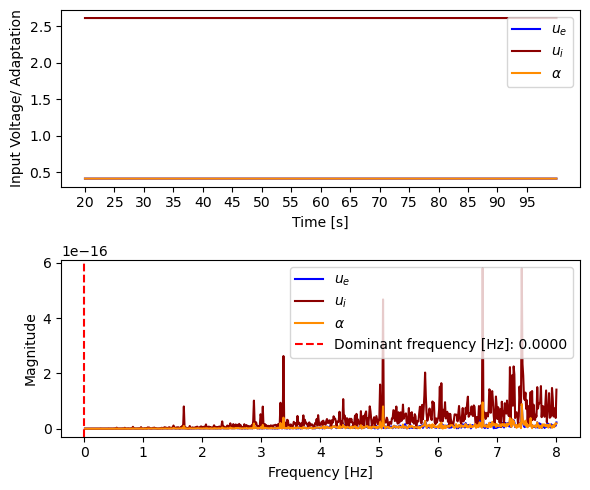

Frequency:  0.0
Amplitude:  0.0
Midpoint Oscillation e:  0.4128164195678571
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1266.6666666666665
22  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


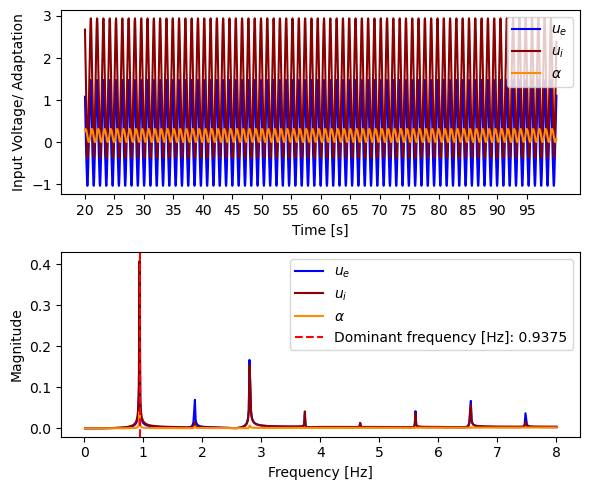

Frequency:  0.9375
Amplitude:  2.514546450502058
Midpoint Oscillation e:  0.22219090536151298
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


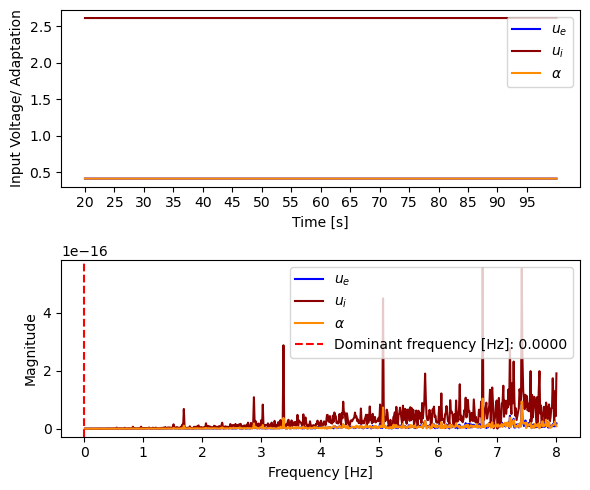

Frequency:  0.0
Amplitude:  0.0
Midpoint Oscillation e:  0.4128164195678553
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1288.888888888889
23  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


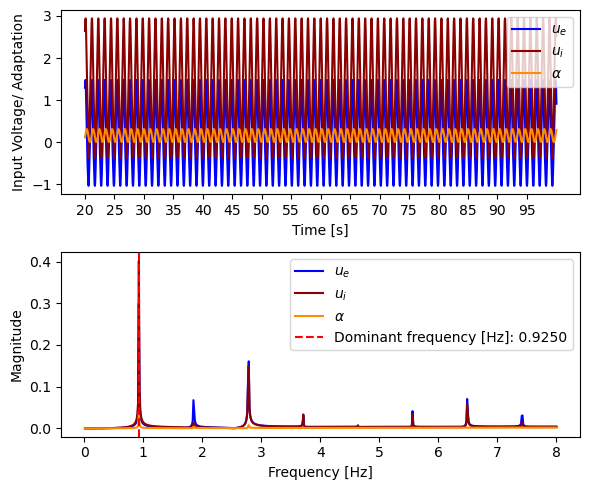

Frequency:  0.925
Amplitude:  2.515672403210668
Midpoint Oscillation e:  0.22262610631513213
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


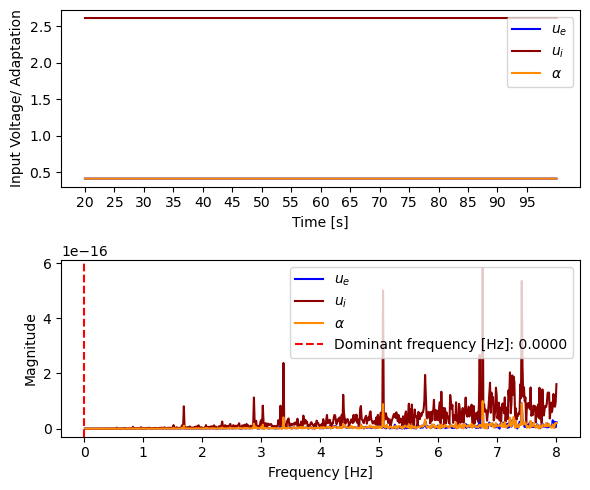

Frequency:  0.0
Amplitude:  0.0
Midpoint Oscillation e:  0.412816419567854
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1311.111111111111
24  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


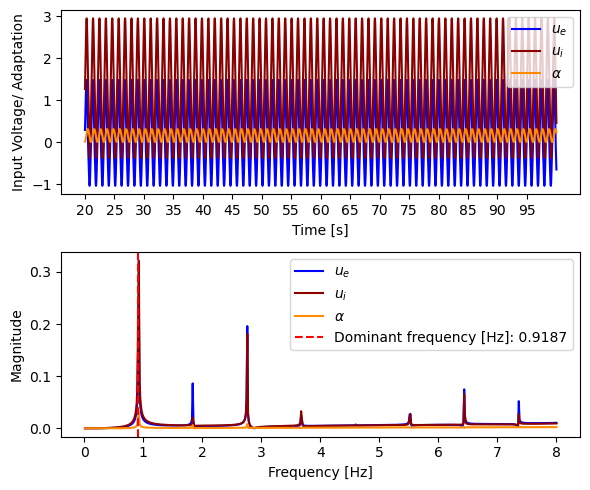

Frequency:  0.91875
Amplitude:  2.516760835368313
Midpoint Oscillation e:  0.2230482585237269
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


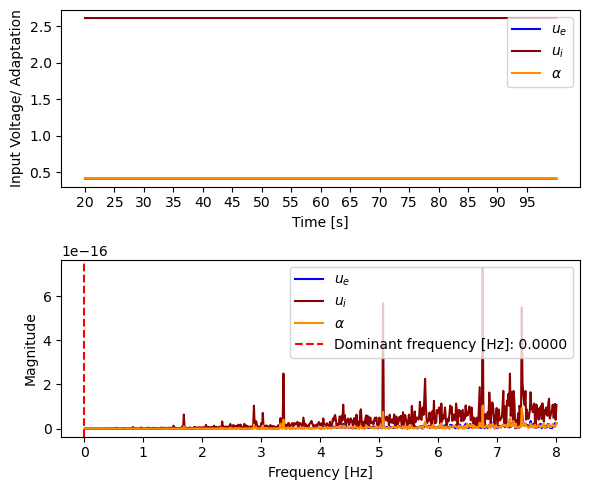

Frequency:  0.0
Amplitude:  0.0
Midpoint Oscillation e:  0.4128164195678525
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1333.3333333333333
25  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


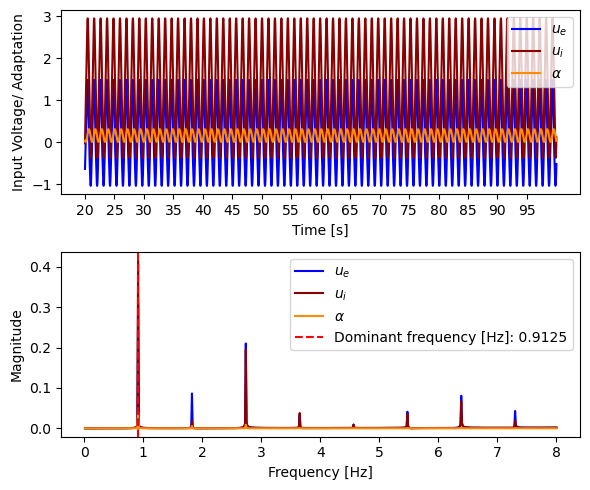

Frequency:  0.9125
Amplitude:  2.5178135811322897
Midpoint Oscillation e:  0.22345794858280965
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


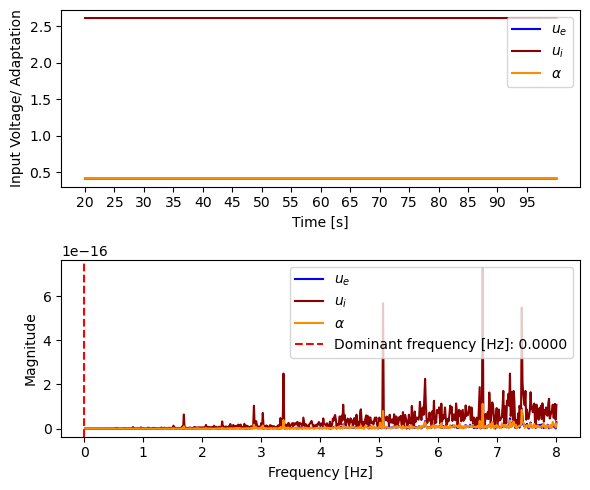

Frequency:  0.0
Amplitude:  0.0
Midpoint Oscillation e:  0.4128164195678507
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1355.5555555555557
26  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


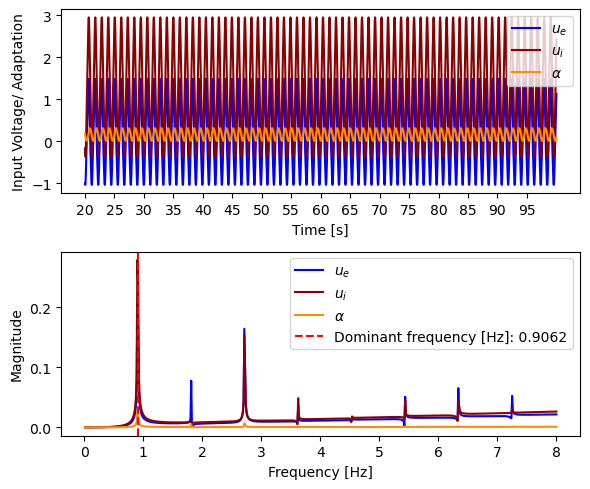

Frequency:  0.90625
Amplitude:  2.518832357303352
Midpoint Oscillation e:  0.2238557278300154
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


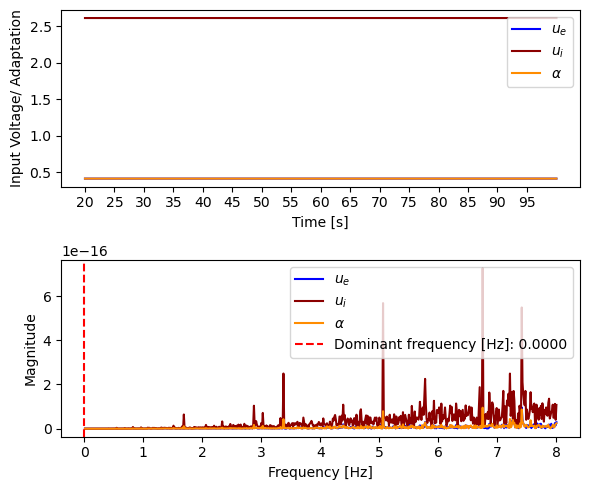

Frequency:  0.0
Amplitude:  0.0
Midpoint Oscillation e:  0.4128164195678491
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1377.7777777777778
27  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


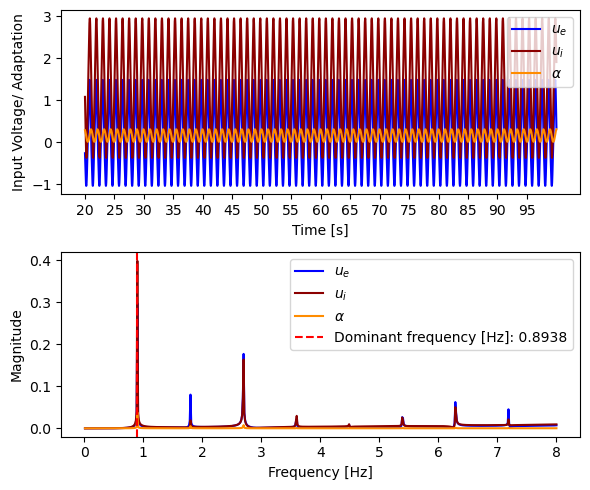

Frequency:  0.89375
Amplitude:  2.5198187736397433
Midpoint Oscillation e:  0.22424211511952563
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


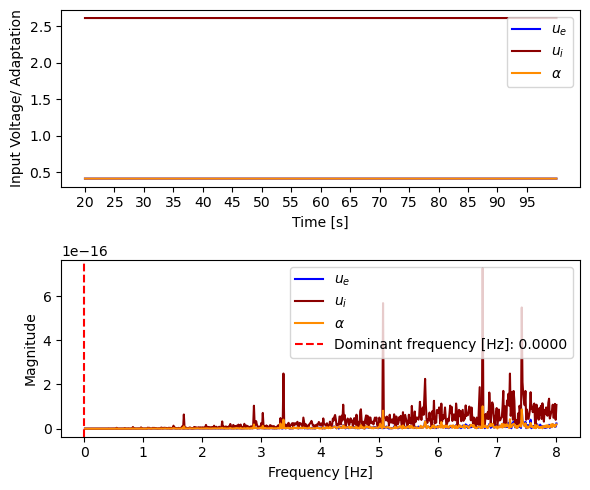

Frequency:  0.0
Amplitude:  0.0
Midpoint Oscillation e:  0.412816419567848
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1400.0
28  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


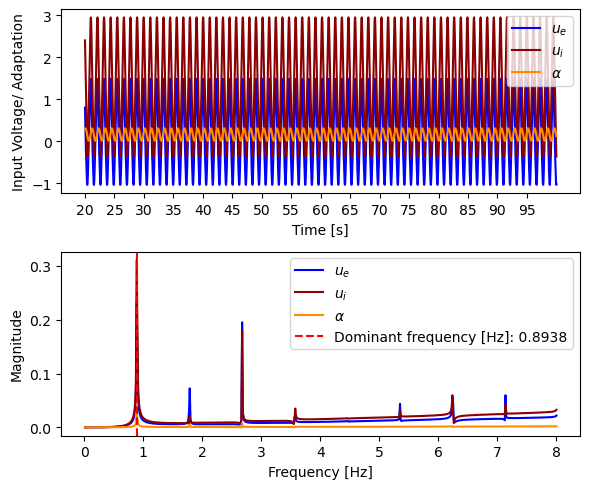

Frequency:  0.89375
Amplitude:  2.5207743378961487
Midpoint Oscillation e:  0.22461760002894893
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


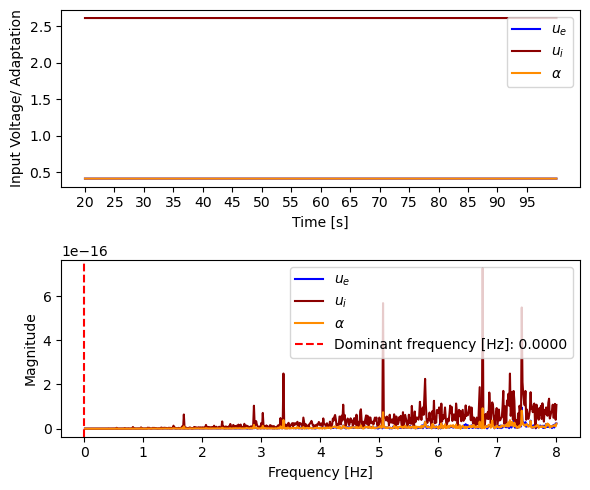

Frequency:  0.0
Amplitude:  0.0
Midpoint Oscillation e:  0.4128164195678467
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1422.2222222222222
29  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


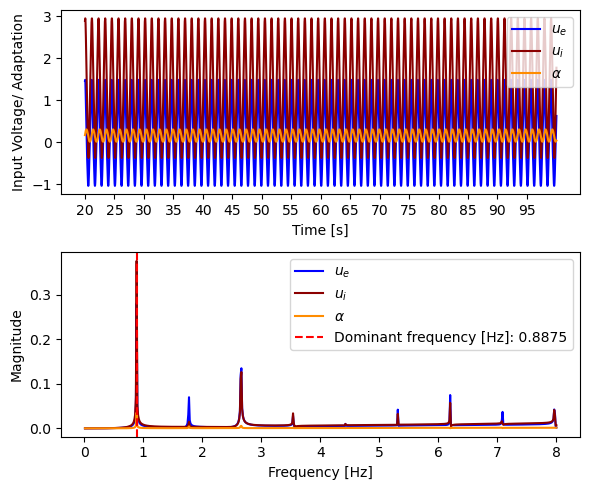

Frequency:  0.8875
Amplitude:  2.5217004690247906
Midpoint Oscillation e:  0.2249826427801972
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


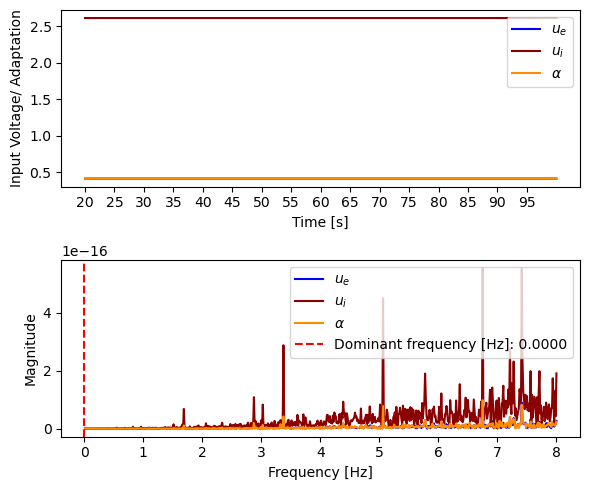

Frequency:  0.0
Amplitude:  0.0
Midpoint Oscillation e:  0.4128164195678449
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1444.4444444444443
30  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


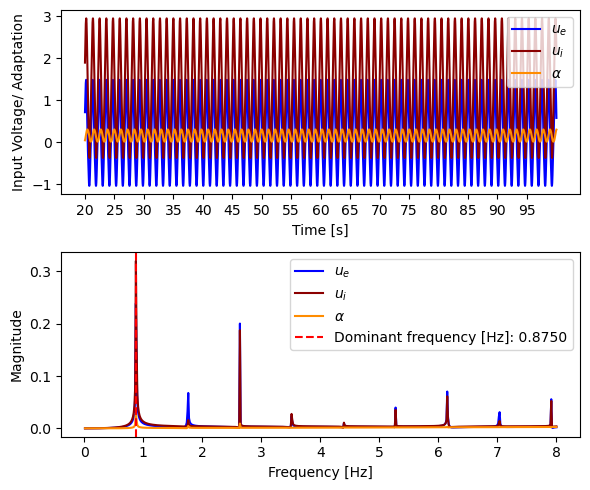

Frequency:  0.875
Amplitude:  2.52259849858269
Midpoint Oscillation e:  0.22533767836936258
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


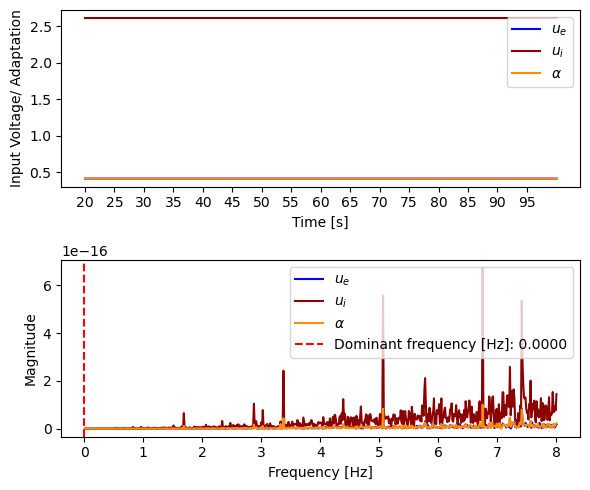

Frequency:  0.0
Amplitude:  0.0
Midpoint Oscillation e:  0.41281641956784404
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1466.6666666666665
31  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


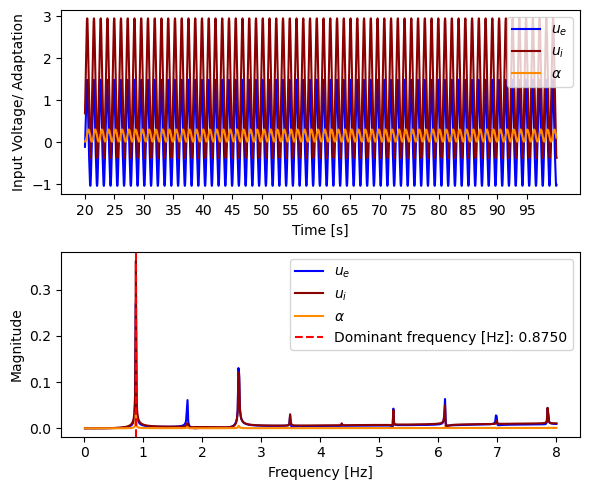

Frequency:  0.875
Amplitude:  2.5234696821926983
Midpoint Oscillation e:  0.22568311791988394
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


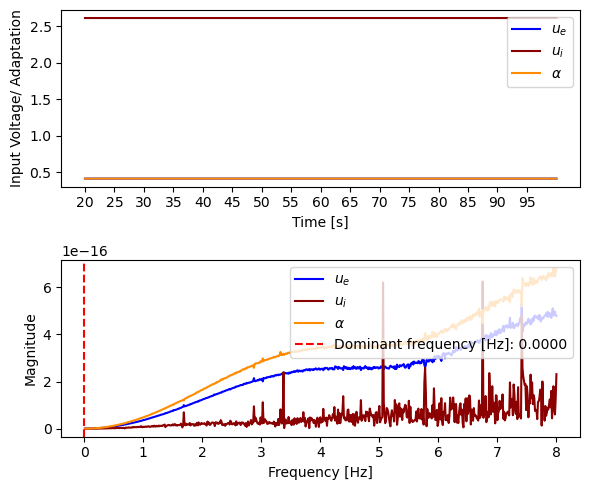

Frequency:  0.0
Amplitude:  4.39648317751562e-14
Midpoint Oscillation e:  0.41281641956782034
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1488.888888888889
32  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


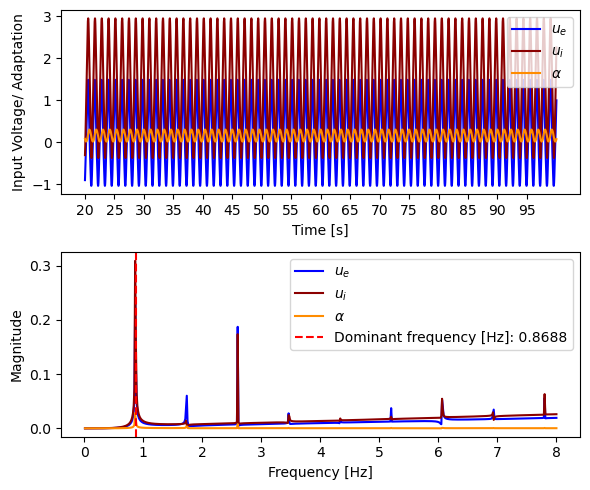

Frequency:  0.86875
Amplitude:  2.5243151955914818
Midpoint Oscillation e:  0.22601935082810098
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


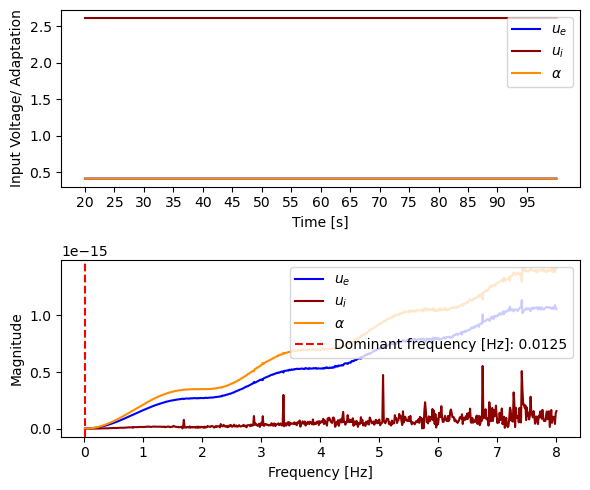

Frequency:  0.0125
Amplitude:  1.0952350137927169e-13
Midpoint Oscillation e:  0.4128164195677866
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1511.111111111111
33  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


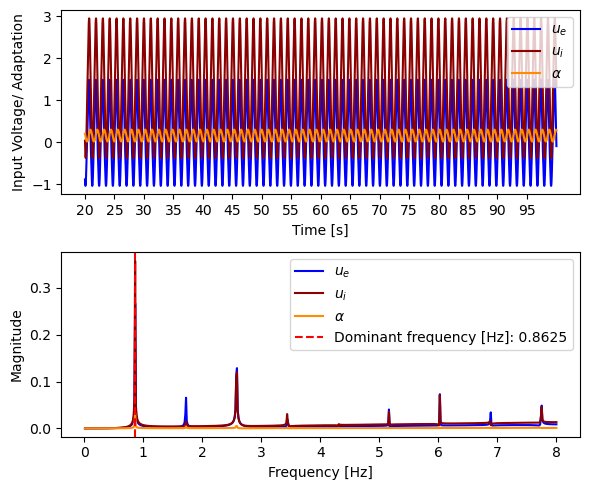

Frequency:  0.8625
Amplitude:  2.525136156496865
Midpoint Oscillation e:  0.22634674234546936
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


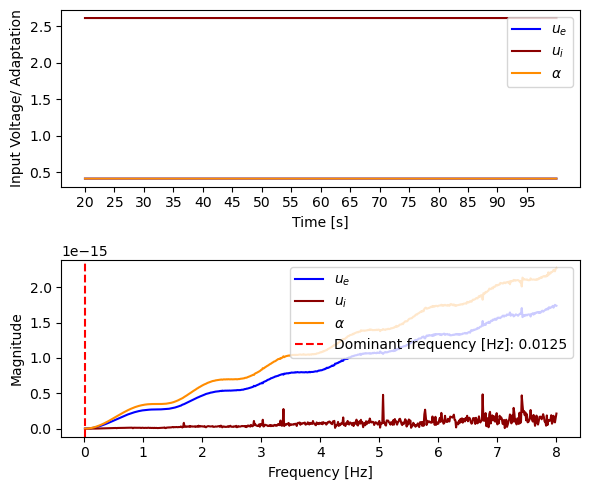

Frequency:  0.0125
Amplitude:  1.7341683644644945e-13
Midpoint Oscillation e:  0.4128164195677529
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1533.3333333333333
34  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


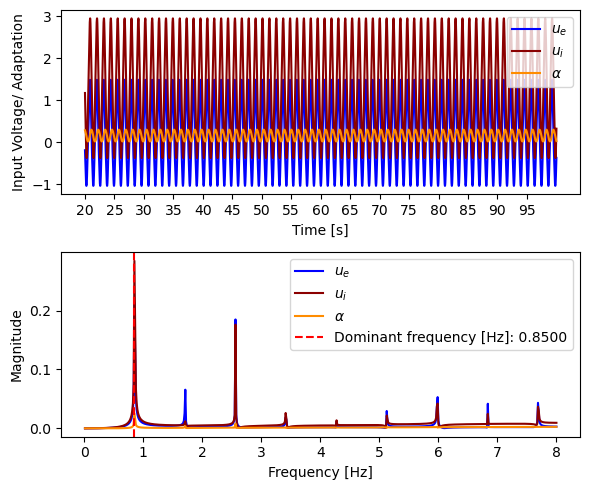

Frequency:  0.85
Amplitude:  2.5259336087607043
Midpoint Oscillation e:  0.2266656433021198
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


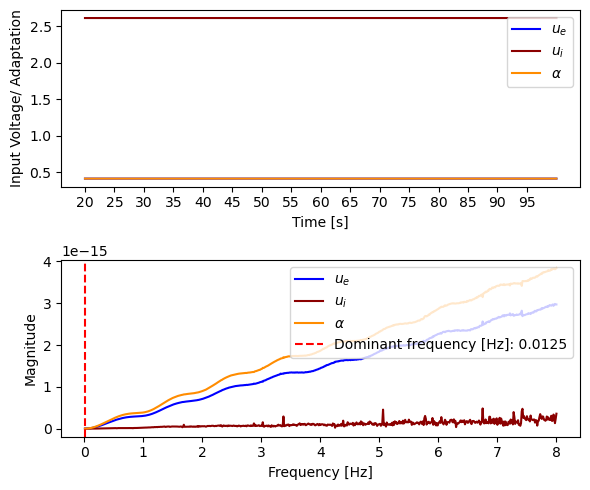

Frequency:  0.0125
Amplitude:  2.944311461305915e-13
Midpoint Oscillation e:  0.4128164195676908
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1555.5555555555557
35  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


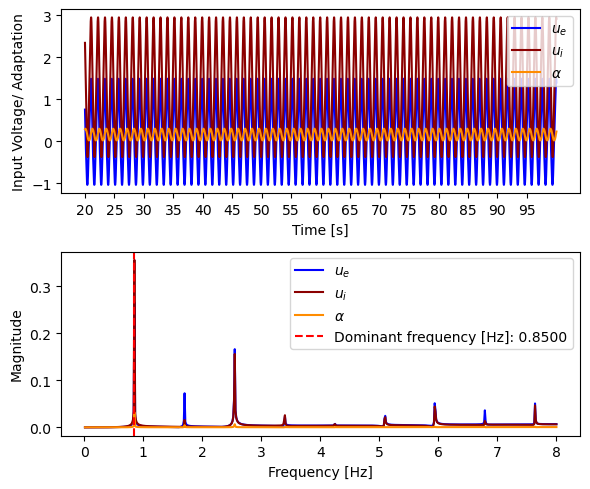

Frequency:  0.85
Amplitude:  2.5267085464207115
Midpoint Oscillation e:  0.2269763808949632
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


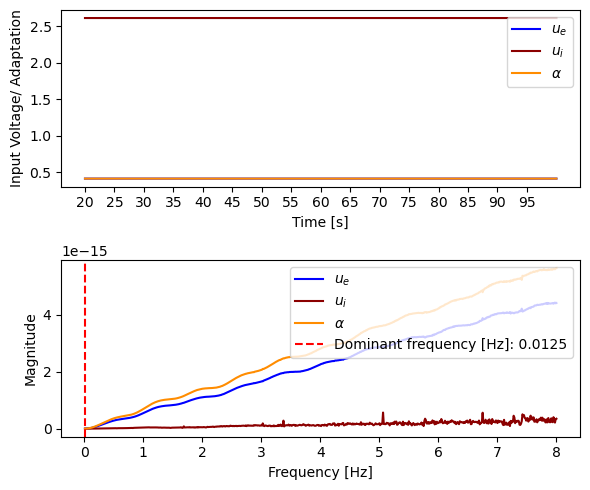

Frequency:  0.0125
Amplitude:  4.468647674116255e-13
Midpoint Oscillation e:  0.4128164195676132
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1577.7777777777778
36  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


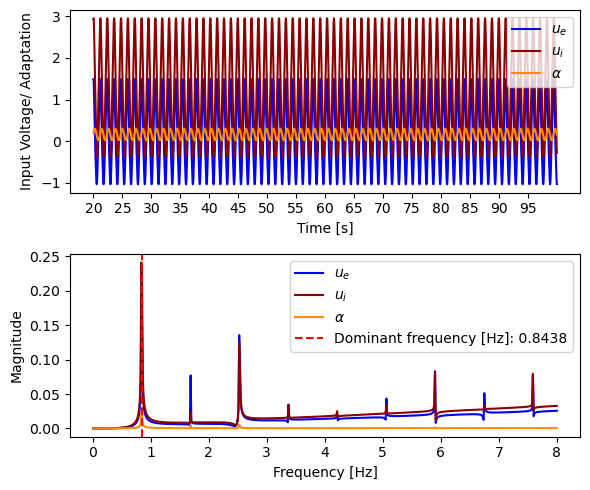

Frequency:  0.84375
Amplitude:  2.527461905775347
Midpoint Oscillation e:  0.22727926947365973
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


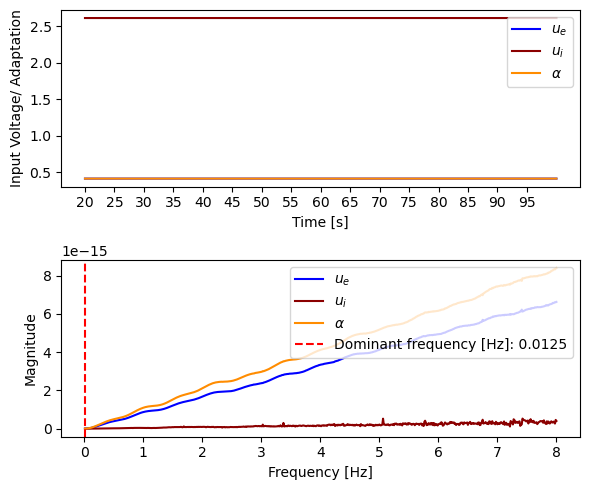

Frequency:  0.0125
Amplitude:  6.564193633096238e-13
Midpoint Oscillation e:  0.41281641956750714
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1600.0
37  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


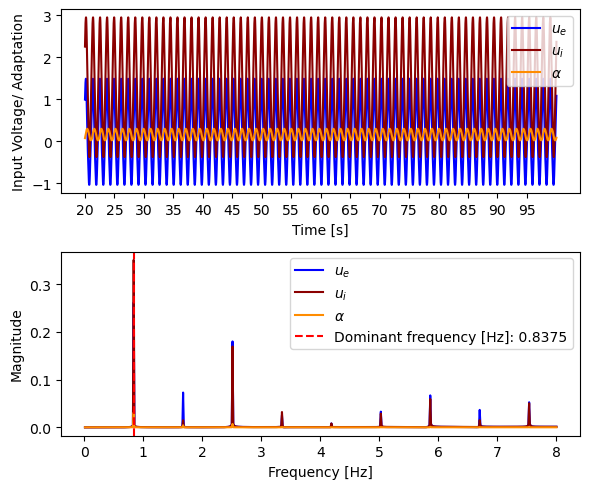

Frequency:  0.8375
Amplitude:  2.528194573926503
Midpoint Oscillation e:  0.2275746043266712
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


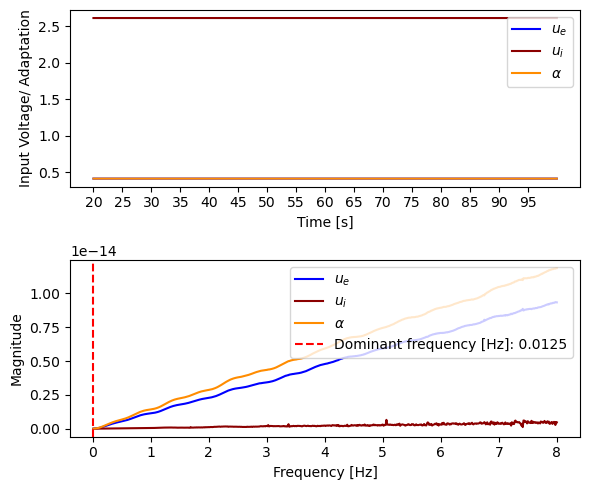

Frequency:  0.0125
Amplitude:  9.349188090368443e-13
Midpoint Oscillation e:  0.4128164195673668
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1622.2222222222222
38  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


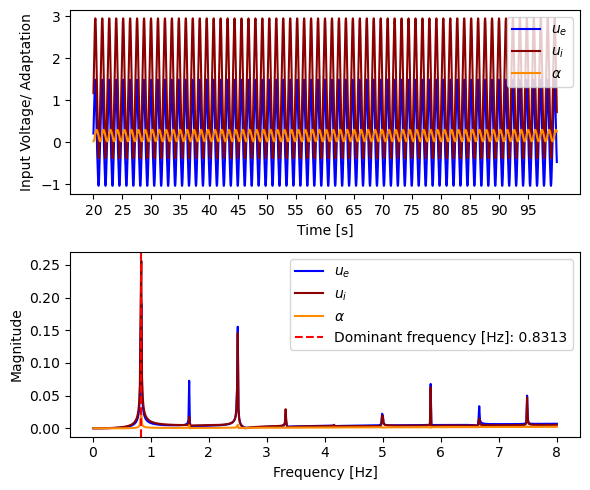

Frequency:  0.83125
Amplitude:  2.5289074027707152
Midpoint Oscillation e:  0.22786267912439095
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


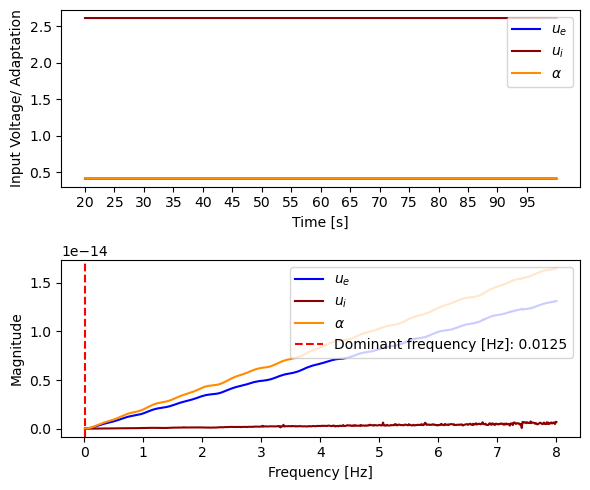

Frequency:  0.0125
Amplitude:  1.309896635603991e-12
Midpoint Oscillation e:  0.41281641956717796
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1644.4444444444443
39  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


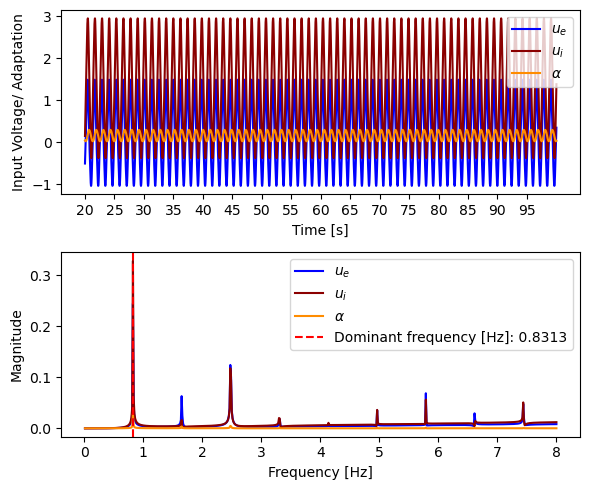

Frequency:  0.83125
Amplitude:  2.5296011249829142
Midpoint Oscillation e:  0.22814373193618864
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


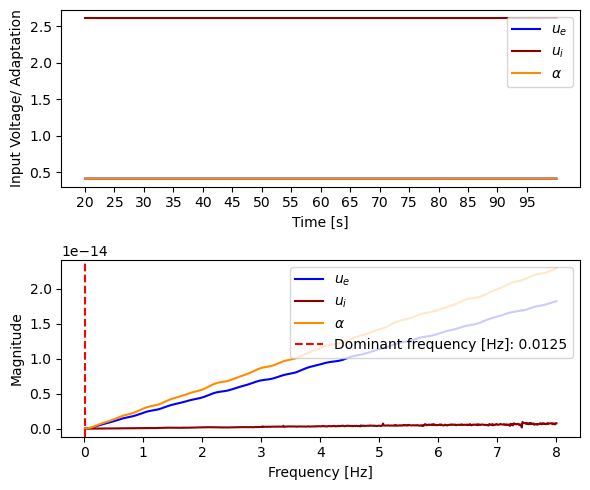

Frequency:  0.0125
Amplitude:  1.8083867736606862e-12
Midpoint Oscillation e:  0.41281641956692716
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1666.6666666666665
40  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


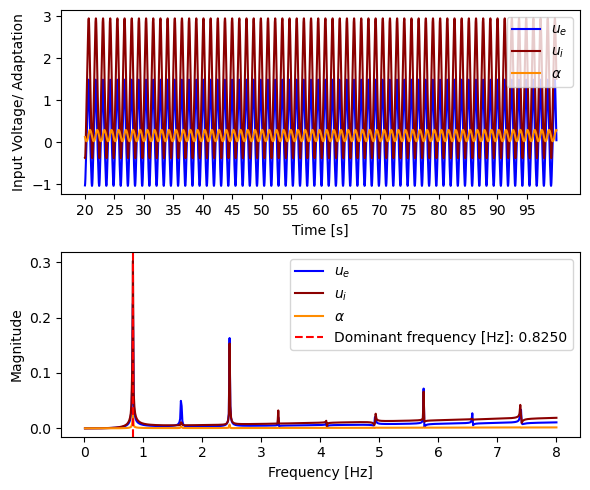

Frequency:  0.825
Amplitude:  2.53027657627688
Midpoint Oscillation e:  0.22841805453967334
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


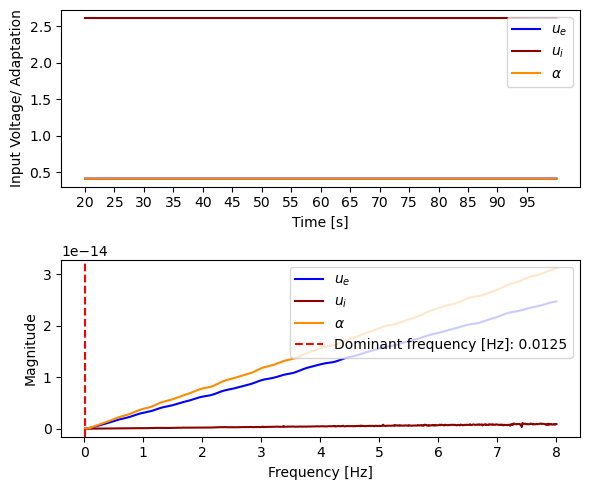

Frequency:  0.0125
Amplitude:  2.4661384045998602e-12
Midpoint Oscillation e:  0.41281641956659676
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1688.888888888889
41  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


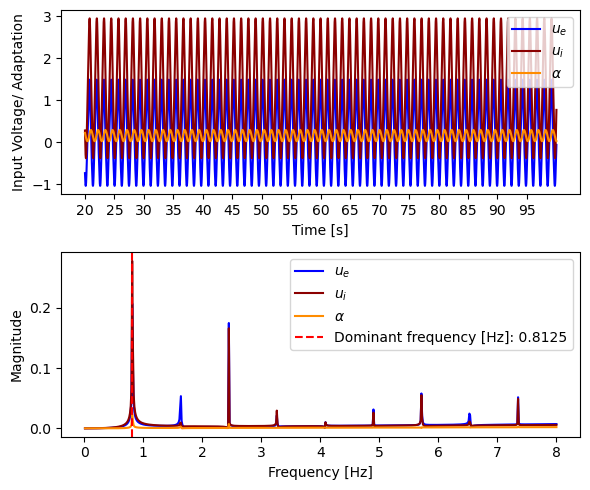

Frequency:  0.8125
Amplitude:  2.5309345082283663
Midpoint Oscillation e:  0.22868579397546107
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


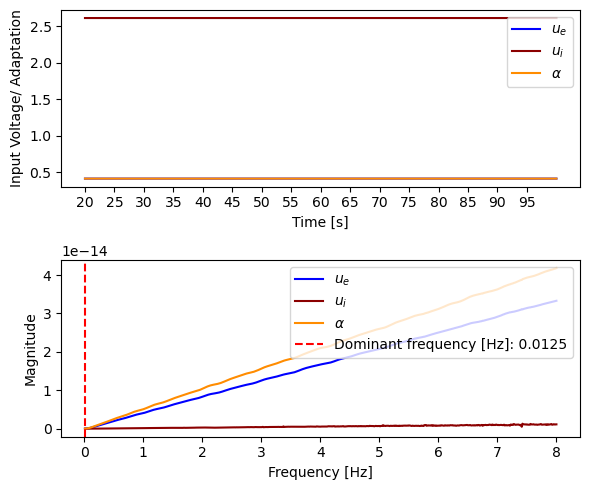

Frequency:  0.0125
Amplitude:  3.320843600107537e-12
Midpoint Oscillation e:  0.41281641956616777
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1711.111111111111
42  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


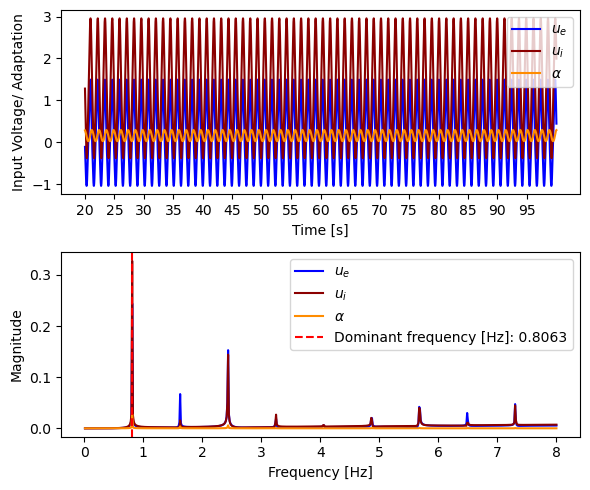

Frequency:  0.80625
Amplitude:  2.5315753465209165
Midpoint Oscillation e:  0.22894737706341384
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


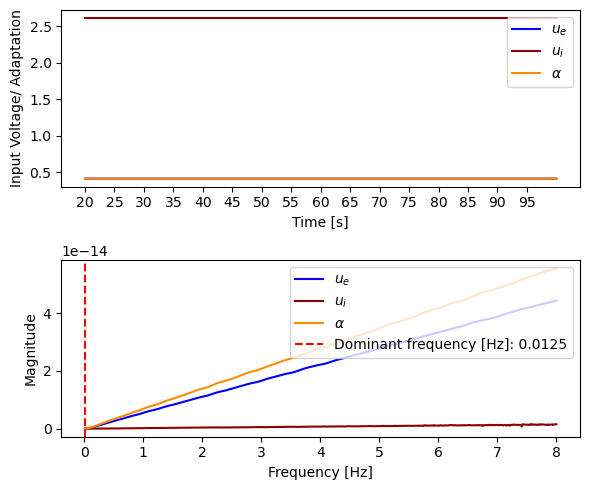

Frequency:  0.0125
Amplitude:  4.423905686223861e-12
Midpoint Oscillation e:  0.41281641956561493
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1733.3333333333333
43  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


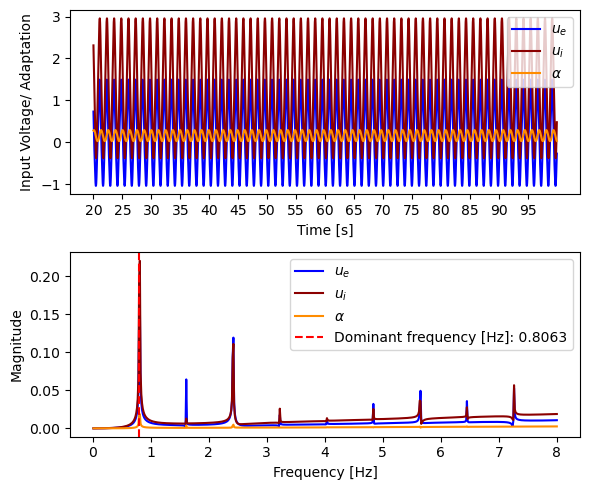

Frequency:  0.80625
Amplitude:  2.5322000737037893
Midpoint Oscillation e:  0.22920279049446501
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


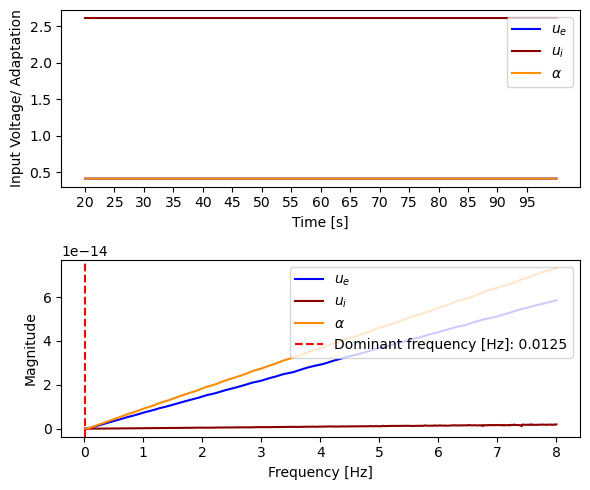

Frequency:  0.0125
Amplitude:  5.8408833325529486e-12
Midpoint Oscillation e:  0.41281641956490484
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1755.5555555555557
44  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


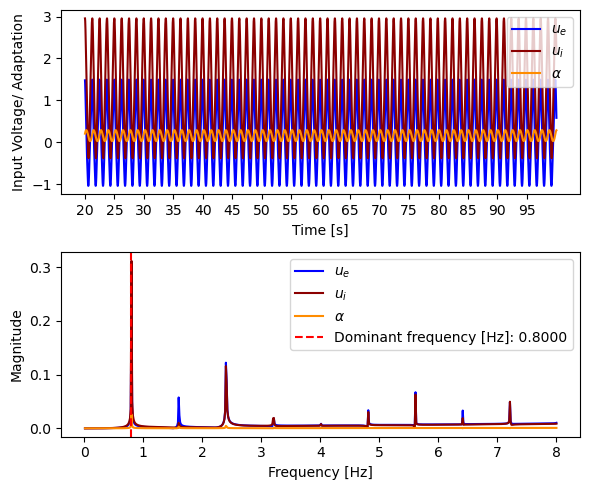

Frequency:  0.8
Amplitude:  2.5328091634017555
Midpoint Oscillation e:  0.22945240392645805
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


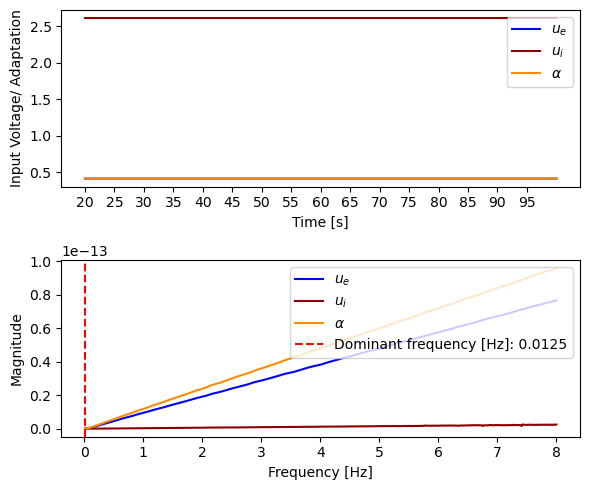

Frequency:  0.0125
Amplitude:  7.648326416642703e-12
Midpoint Oscillation e:  0.4128164195639999
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1777.7777777777778
45  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


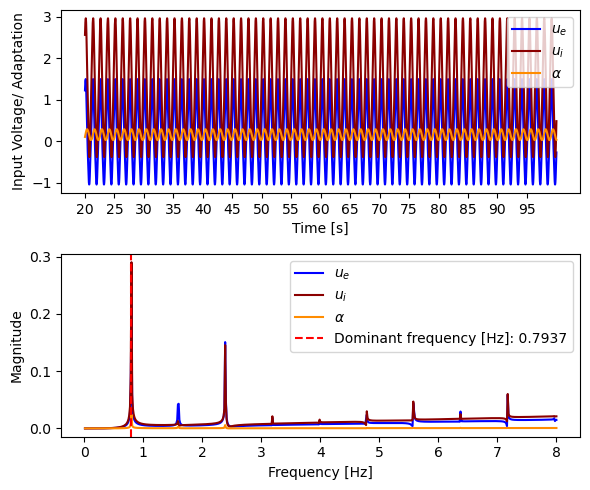

Frequency:  0.79375
Amplitude:  2.533402935135997
Midpoint Oscillation e:  0.22969643245575877
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


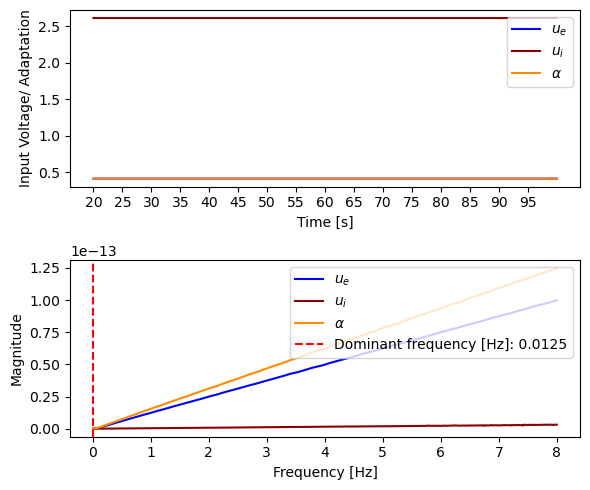

Frequency:  0.0125
Amplitude:  9.935607891975451e-12
Midpoint Oscillation e:  0.4128164195628545
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1800.0
46  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


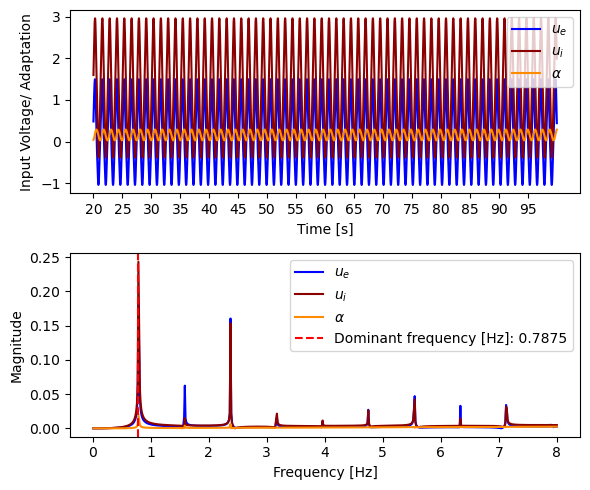

Frequency:  0.7875
Amplitude:  2.533982425952682
Midpoint Oscillation e:  0.22993489668510103
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


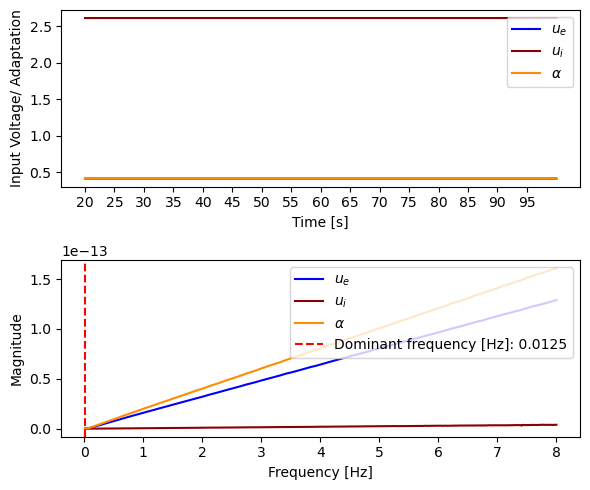

Frequency:  0.0125
Amplitude:  1.2817302774692507e-11
Midpoint Oscillation e:  0.41281641956141274
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1822.2222222222222
47  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


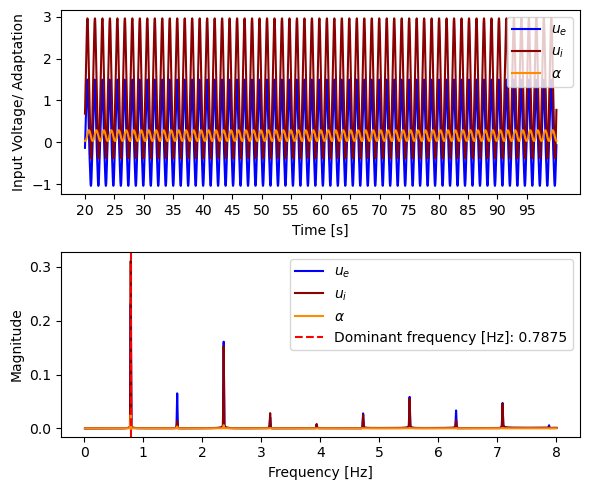

Frequency:  0.7875
Amplitude:  2.5345477488330177
Midpoint Oscillation e:  0.23016809794704918
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


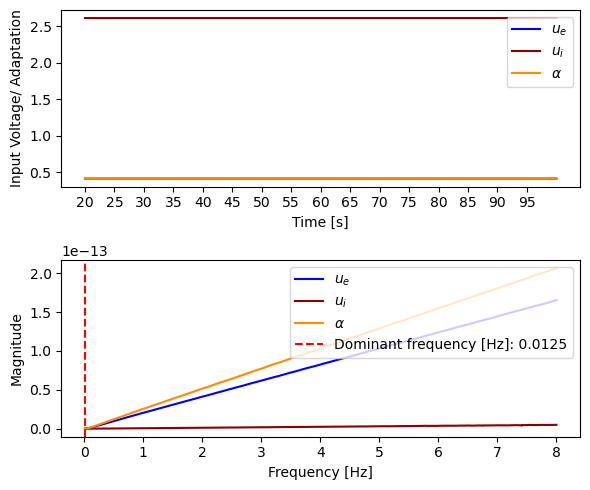

Frequency:  0.0125
Amplitude:  1.6423695736733634e-11
Midpoint Oscillation e:  0.41281641955960824
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1844.4444444444443
48  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


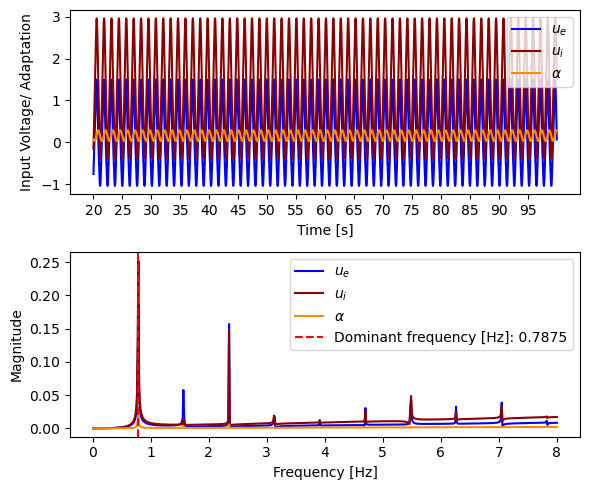

Frequency:  0.7875
Amplitude:  2.535099784659689
Midpoint Oscillation e:  0.2303963276389721
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


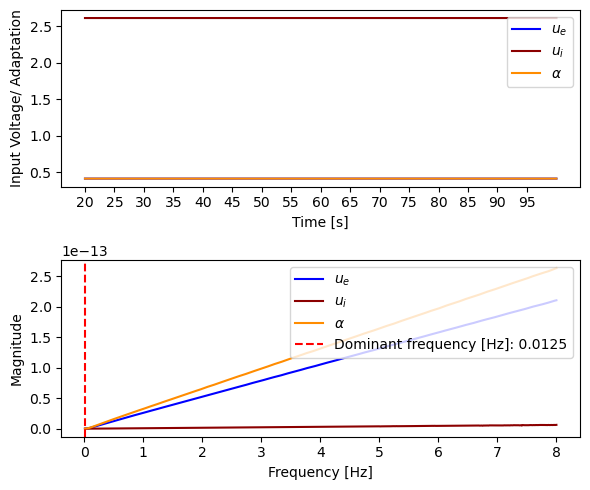

Frequency:  0.0125
Amplitude:  2.0910773113058667e-11
Midpoint Oscillation e:  0.4128164195573635
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1866.6666666666665
49  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


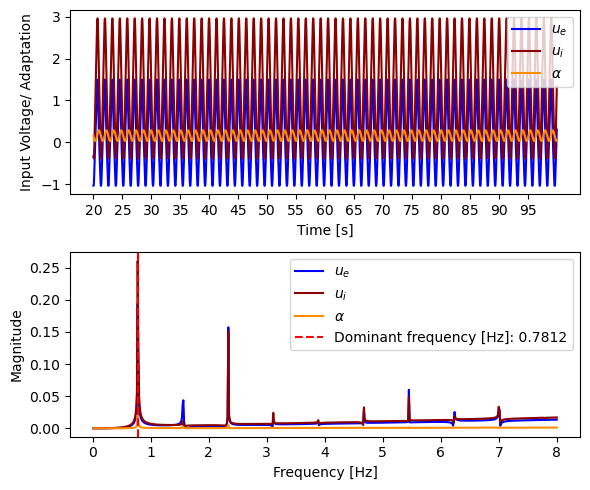

Frequency:  0.78125
Amplitude:  2.5356386302381386
Midpoint Oscillation e:  0.23061956640632397
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


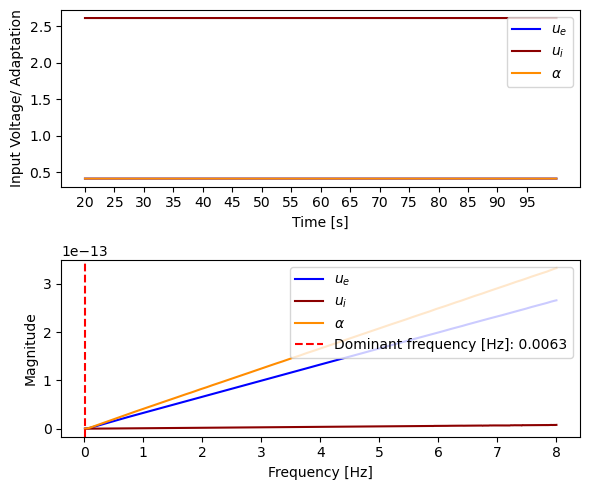

Frequency:  0.00625
Amplitude:  2.6460056368193818e-11
Midpoint Oscillation e:  0.412816419554588
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1888.888888888889
50  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


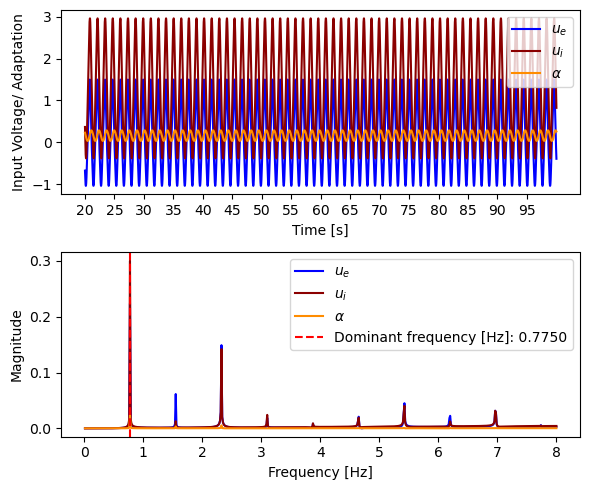

Frequency:  0.775
Amplitude:  2.5361648764878857
Midpoint Oscillation e:  0.2308379643725016
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


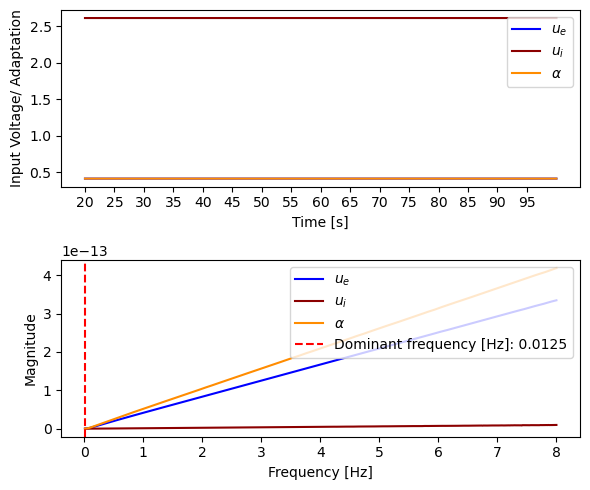

Frequency:  0.0125
Amplitude:  3.328864961460454e-11
Midpoint Oscillation e:  0.4128164195511719
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1911.111111111111
51  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


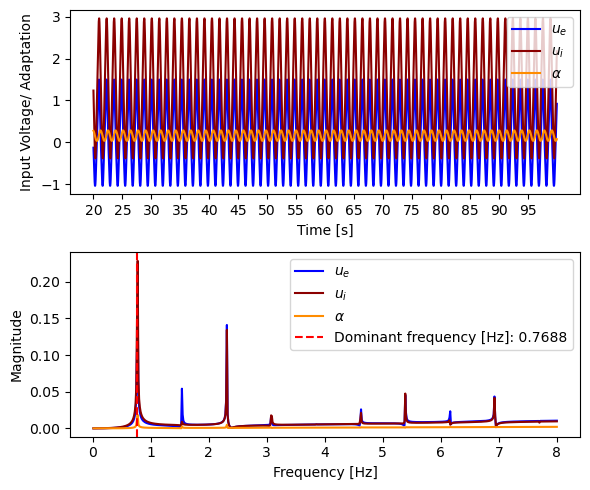

Frequency:  0.76875
Amplitude:  2.5366789965548415
Midpoint Oscillation e:  0.23105178657083658
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


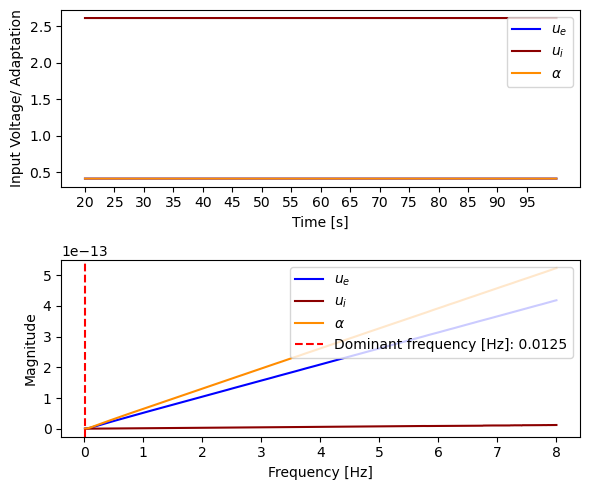

Frequency:  0.0125
Amplitude:  4.164923961269551e-11
Midpoint Oscillation e:  0.4128164195469903
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1933.3333333333333
52  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


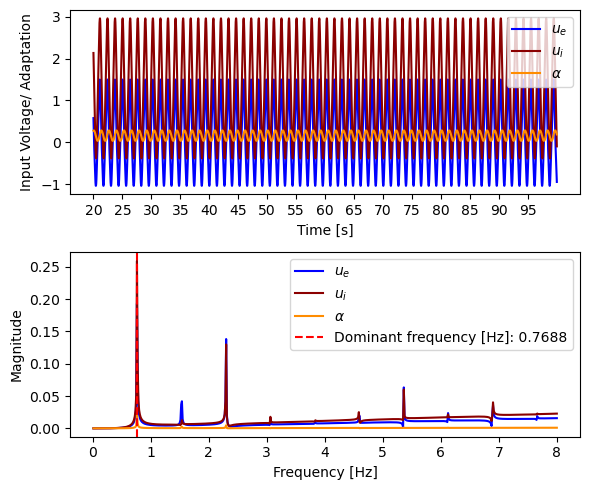

Frequency:  0.76875
Amplitude:  2.5371812227084627
Midpoint Oscillation e:  0.231261046194292
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


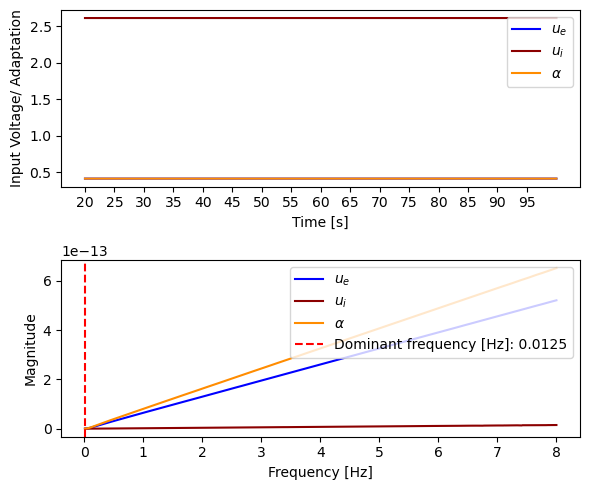

Frequency:  0.0125
Amplitude:  5.183109497153282e-11
Midpoint Oscillation e:  0.41281641954189785
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1955.5555555555554
53  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


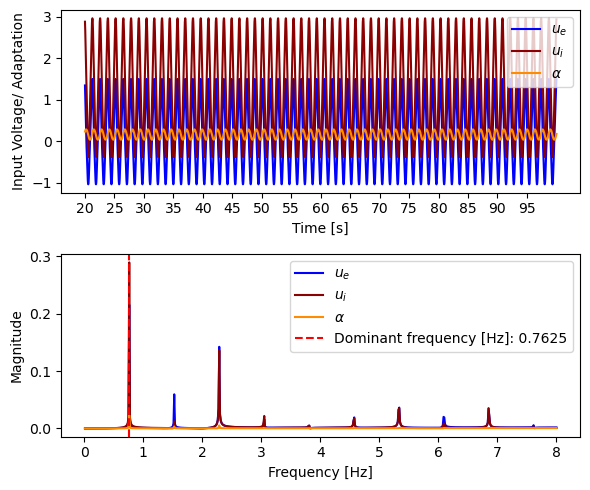

Frequency:  0.7625
Amplitude:  2.5376722892154313
Midpoint Oscillation e:  0.23146609086744863
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


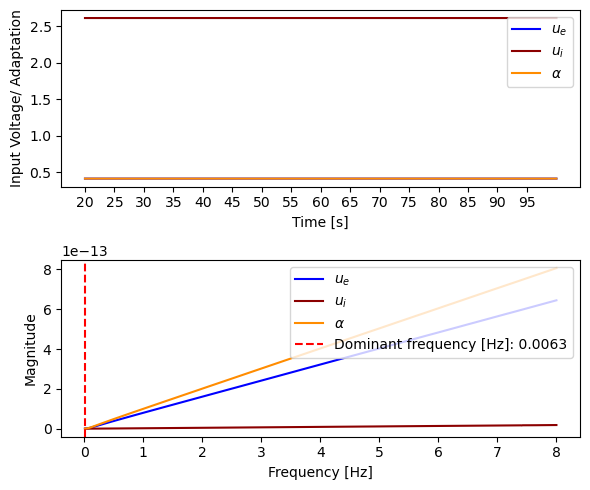

Frequency:  0.00625
Amplitude:  6.417394393665177e-11
Midpoint Oscillation e:  0.4128164195357248
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  1977.7777777777778
54  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


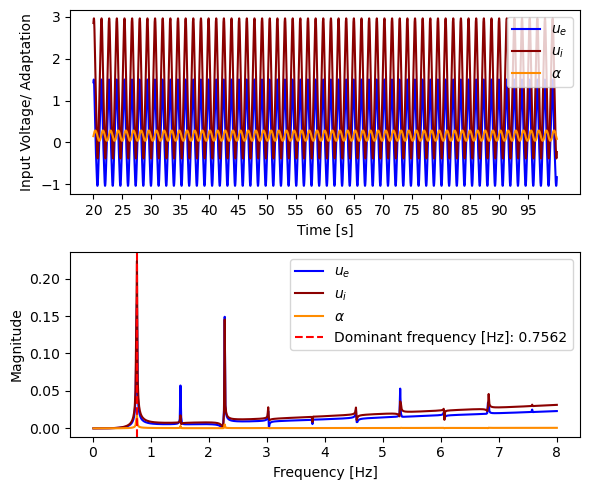

Frequency:  0.75625
Amplitude:  2.5381531639200103
Midpoint Oscillation e:  0.23166722934046746
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


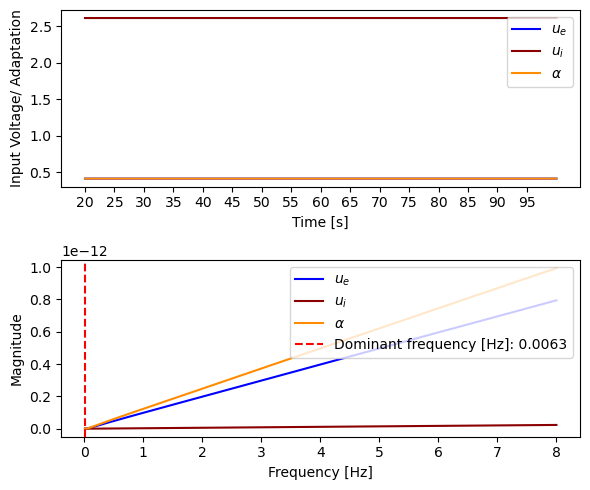

Frequency:  0.00625
Amplitude:  7.906653110012485e-11
Midpoint Oscillation e:  0.4128164195282772
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2000.0
55  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


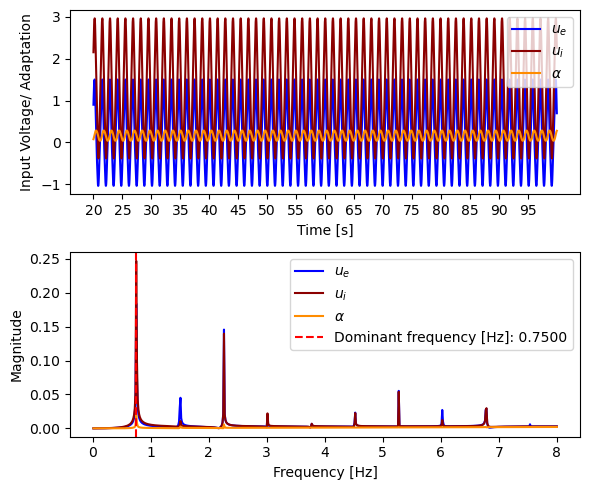

Frequency:  0.75
Amplitude:  2.538622940893941
Midpoint Oscillation e:  0.23186416759342965
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


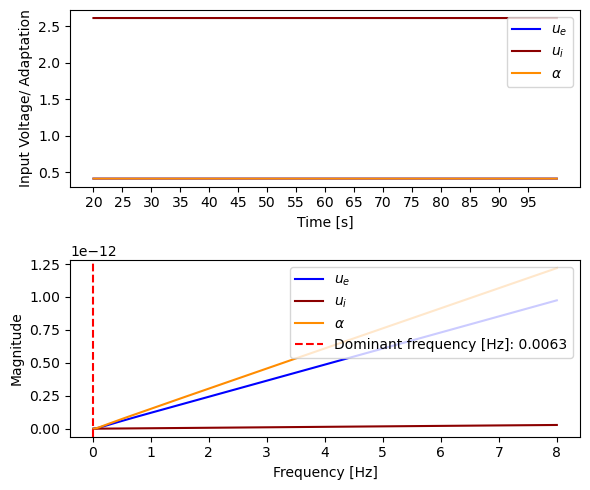

Frequency:  0.00625
Amplitude:  9.695338976101198e-11
Midpoint Oscillation e:  0.41281641951933234
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2022.2222222222222
56  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


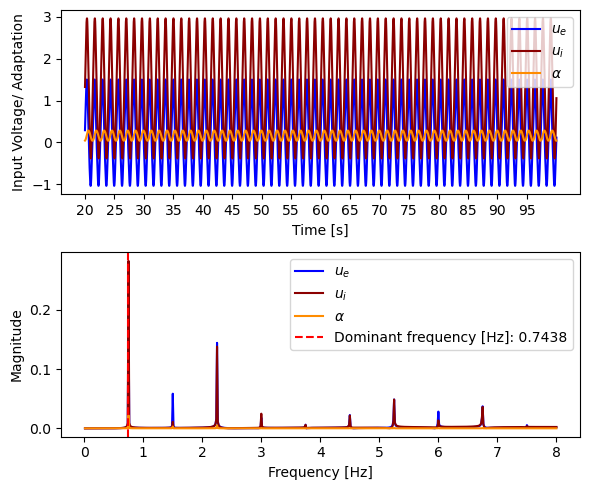

Frequency:  0.74375
Amplitude:  2.5390823800560263
Midpoint Oscillation e:  0.23205696660528152
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


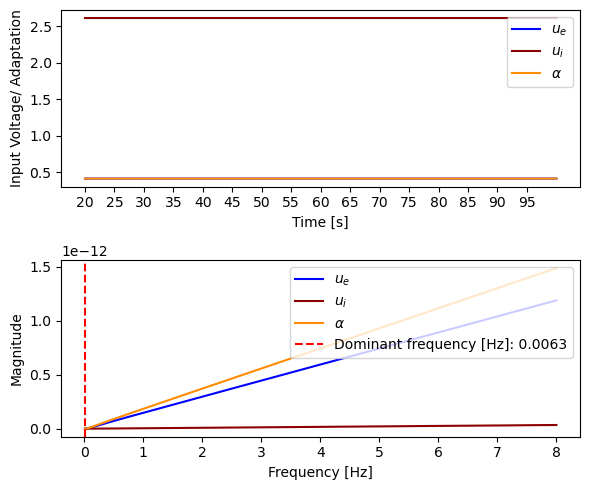

Frequency:  0.00625
Amplitude:  1.1834538904409442e-10
Midpoint Oscillation e:  0.4128164195086351
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2044.4444444444443
57  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


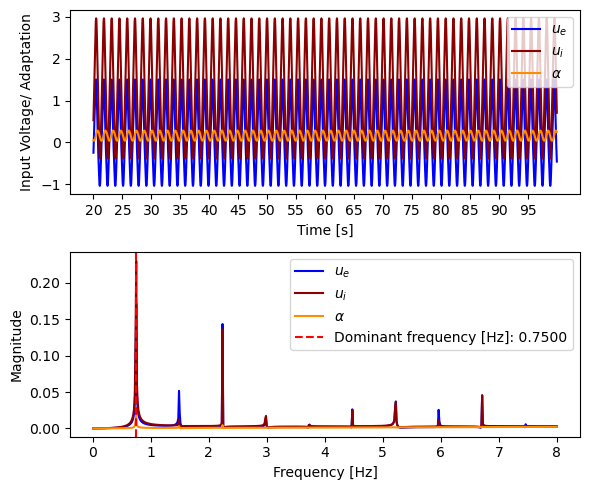

Frequency:  0.75
Amplitude:  2.539532012971624
Midpoint Oscillation e:  0.2322460354071213
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


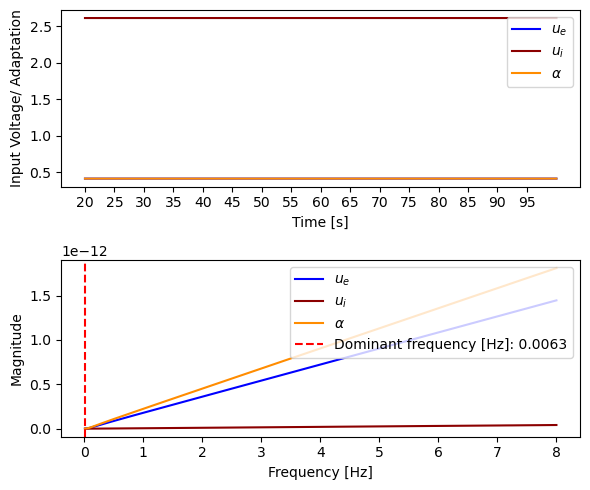

Frequency:  0.00625
Amplitude:  1.4382056656714326e-10
Midpoint Oscillation e:  0.41281641949589576
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2066.6666666666665
58  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


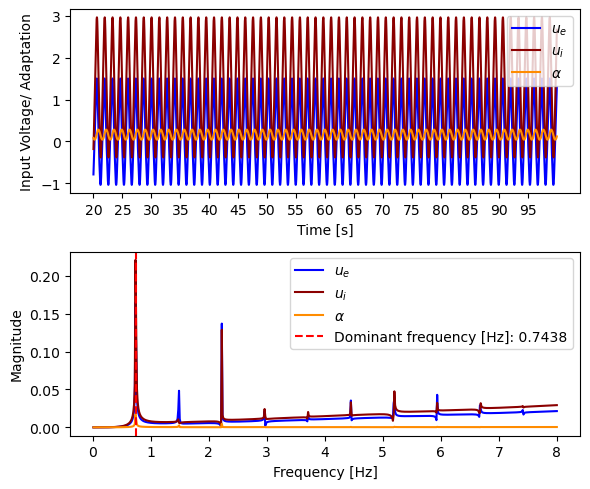

Frequency:  0.74375
Amplitude:  2.539972140852627
Midpoint Oscillation e:  0.2324314676735949
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


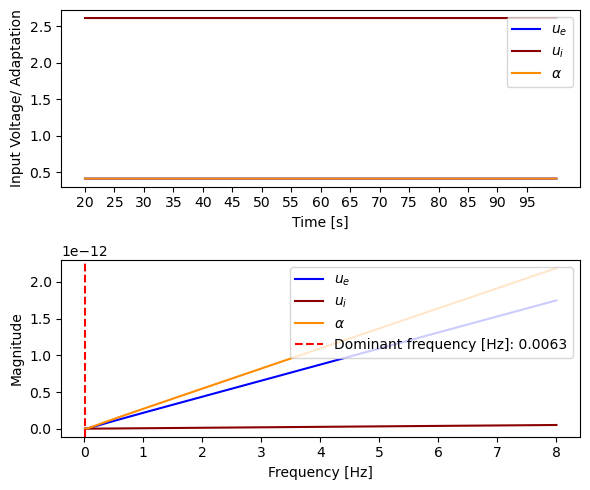

Frequency:  0.00625
Amplitude:  1.7403650742764398e-10
Midpoint Oscillation e:  0.4128164194807864
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2088.8888888888887
59  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


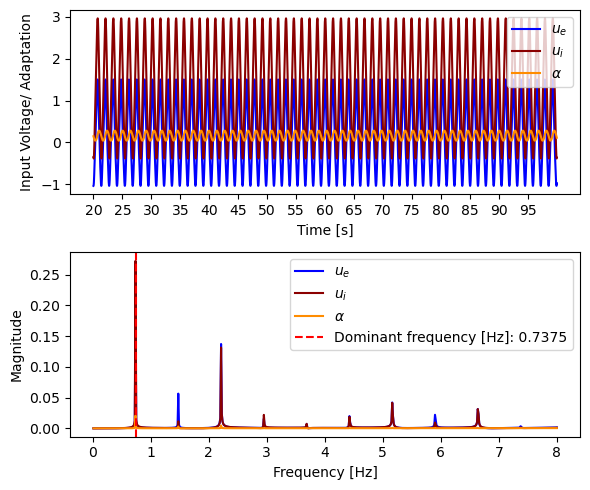

Frequency:  0.7375
Amplitude:  2.5404028892575194
Midpoint Oscillation e:  0.23261319899186117
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


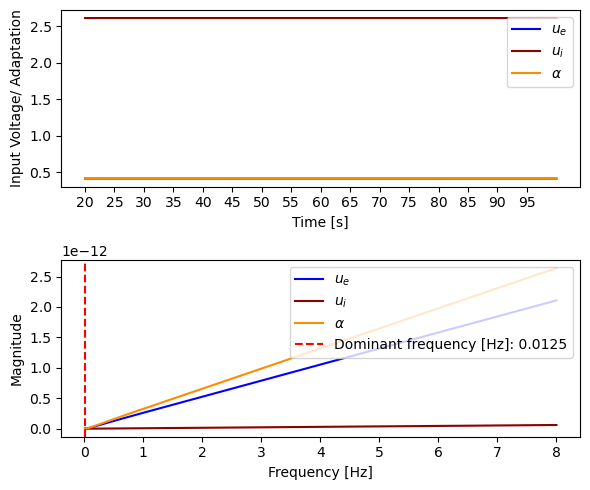

Frequency:  0.0125
Amplitude:  2.0973300873805556e-10
Midpoint Oscillation e:  0.41281641946293685
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2111.1111111111113
60  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


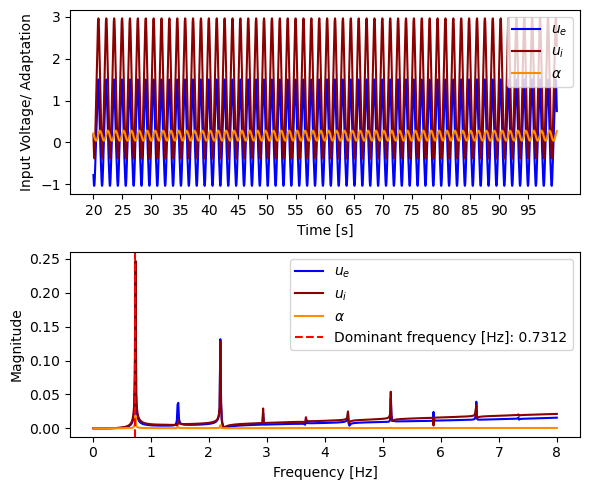

Frequency:  0.73125
Amplitude:  2.5408265228393683
Midpoint Oscillation e:  0.232790552885782
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


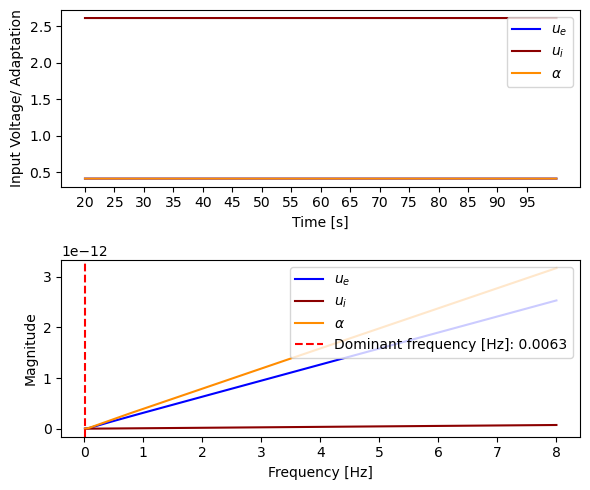

Frequency:  0.00625
Amplitude:  2.5174828888197e-10
Midpoint Oscillation e:  0.4128164194419279
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2133.333333333333
61  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


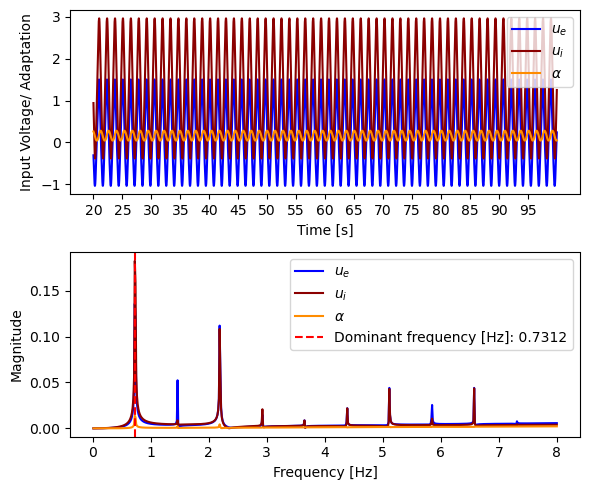

Frequency:  0.73125
Amplitude:  2.5412394328456016
Midpoint Oscillation e:  0.23296549712562986
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


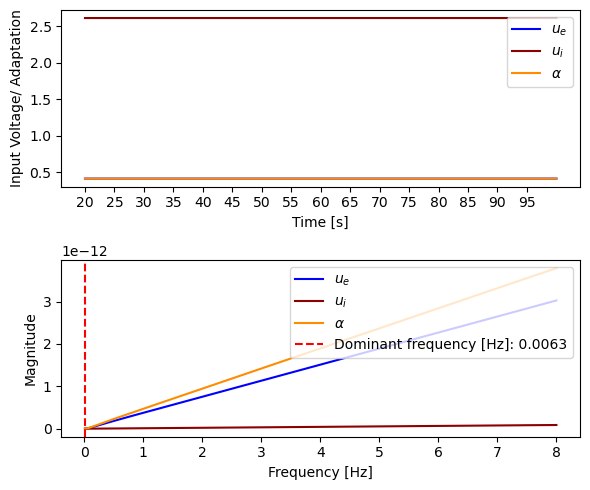

Frequency:  0.00625
Amplitude:  3.0101809933569257e-10
Midpoint Oscillation e:  0.41281641941729147
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2155.5555555555557
62  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


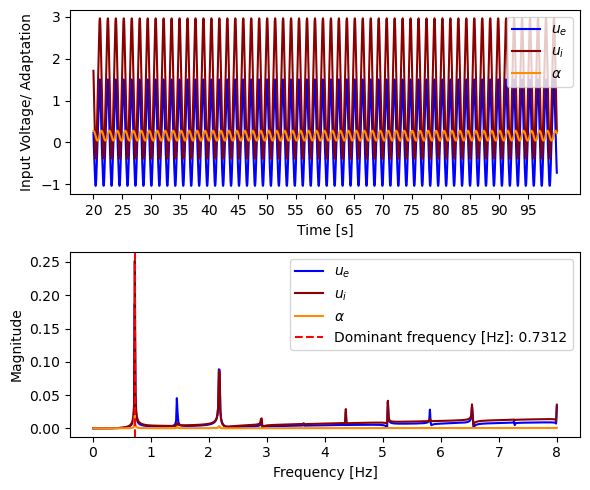

Frequency:  0.73125
Amplitude:  2.5416439764405245
Midpoint Oscillation e:  0.23313731440798402
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


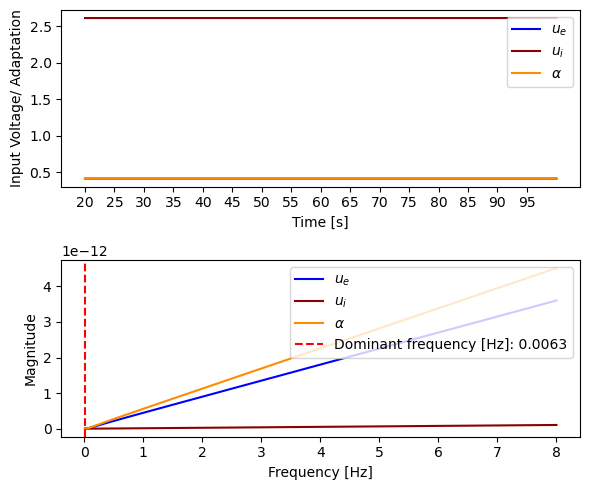

Frequency:  0.00625
Amplitude:  3.5858688240963943e-10
Midpoint Oscillation e:  0.41281641938850533
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2177.777777777778
63  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


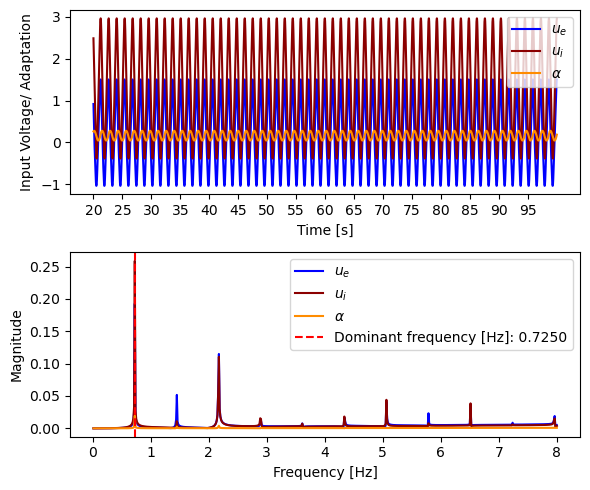

Frequency:  0.725
Amplitude:  2.5420401736486107
Midpoint Oscillation e:  0.2333058392332159
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


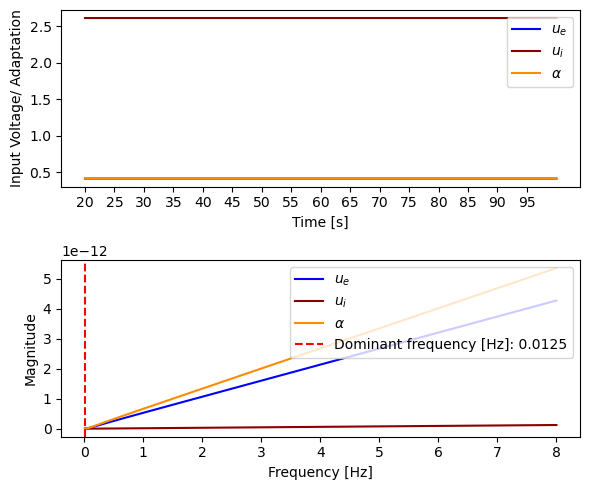

Frequency:  0.0125
Amplitude:  4.2562386948219455e-10
Midpoint Oscillation e:  0.4128164193549852
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2200.0
64  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


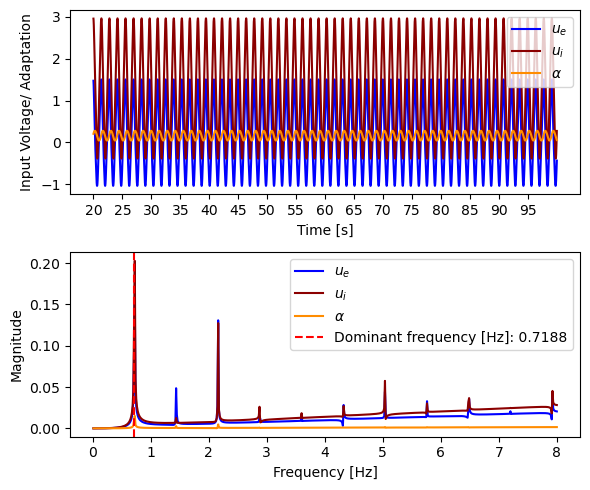

Frequency:  0.71875
Amplitude:  2.5424284601886784
Midpoint Oscillation e:  0.23347126298598797
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


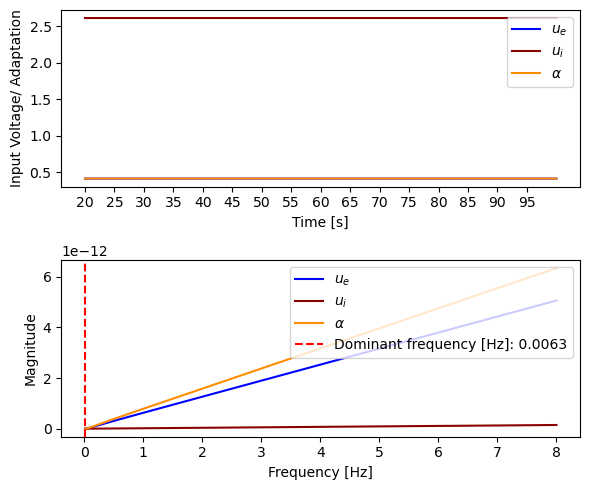

Frequency:  0.00625
Amplitude:  5.03426023090725e-10
Midpoint Oscillation e:  0.41281641931608337
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2222.222222222222
65  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


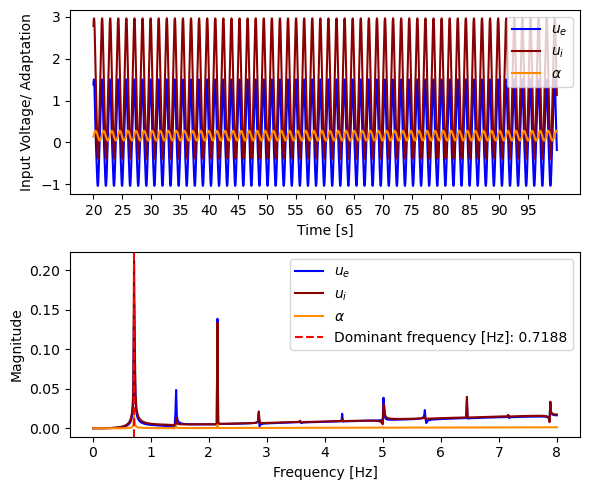

Frequency:  0.71875
Amplitude:  2.5428090652619884
Midpoint Oscillation e:  0.23363375518976603
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


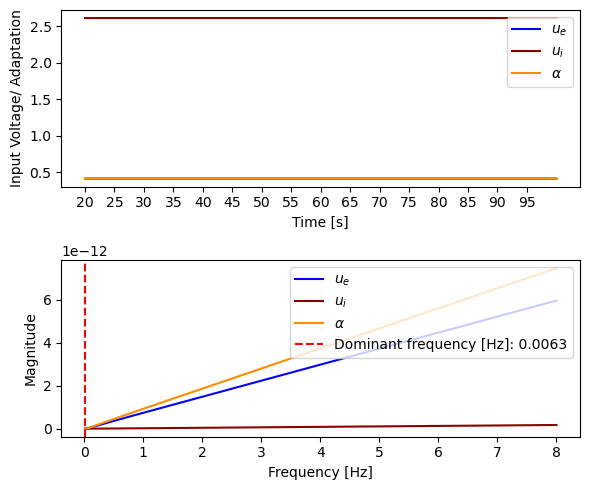

Frequency:  0.00625
Amplitude:  5.934307489852131e-10
Midpoint Oscillation e:  0.4128164192710798
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2244.4444444444443
66  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


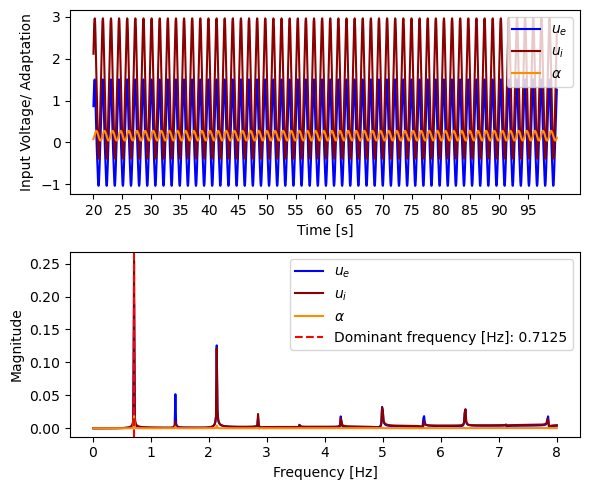

Frequency:  0.7125
Amplitude:  2.543182138536433
Midpoint Oscillation e:  0.23379330373192198
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


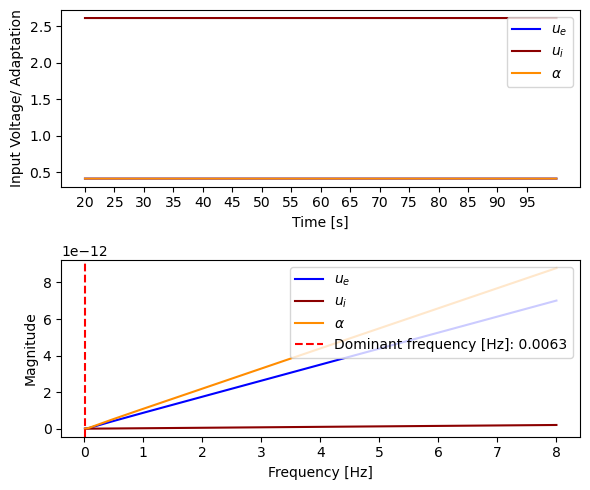

Frequency:  0.00625
Amplitude:  6.972256660908727e-10
Midpoint Oscillation e:  0.4128164192191808
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2266.6666666666665
67  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


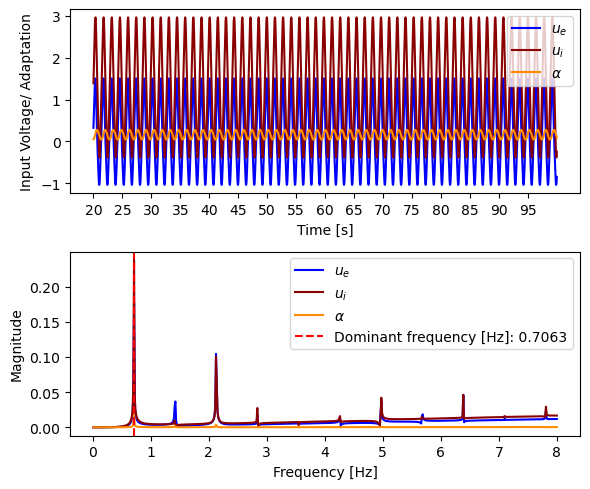

Frequency:  0.70625
Amplitude:  2.5435482559486013
Midpoint Oscillation e:  0.2339498486610101
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


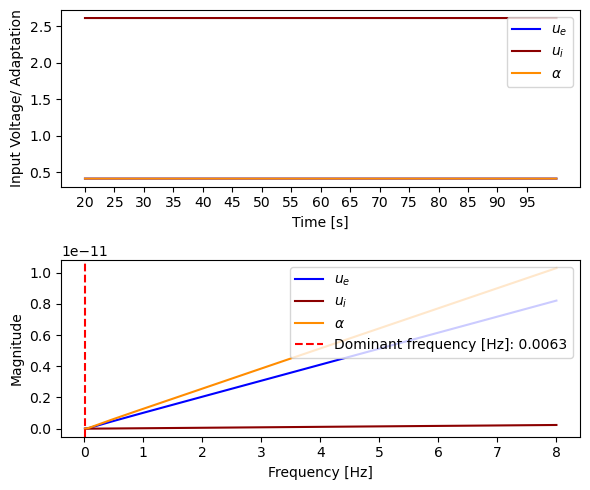

Frequency:  0.00625
Amplitude:  8.165573772700441e-10
Midpoint Oscillation e:  0.4128164191595131
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2288.8888888888887
68  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


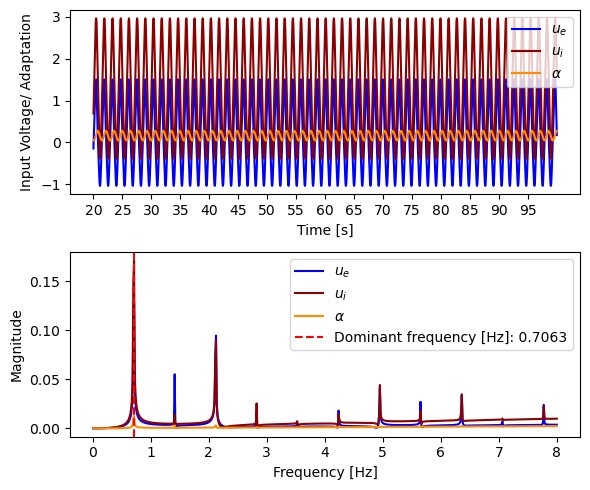

Frequency:  0.70625
Amplitude:  2.5439072943405483
Midpoint Oscillation e:  0.23410351467138224
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


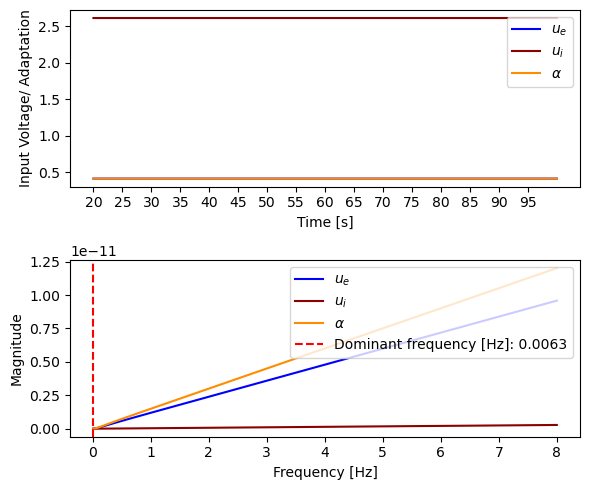

Frequency:  0.00625
Amplitude:  9.533517864035446e-10
Midpoint Oscillation e:  0.41281641909111455
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2311.1111111111113
69  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


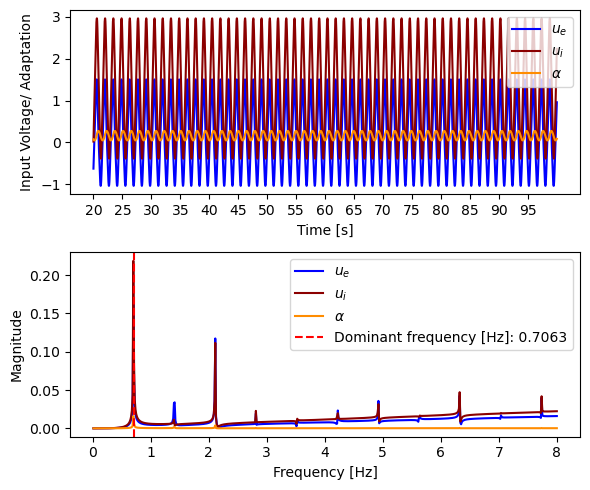

Frequency:  0.70625
Amplitude:  2.544259673011353
Midpoint Oscillation e:  0.2342544679213947
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


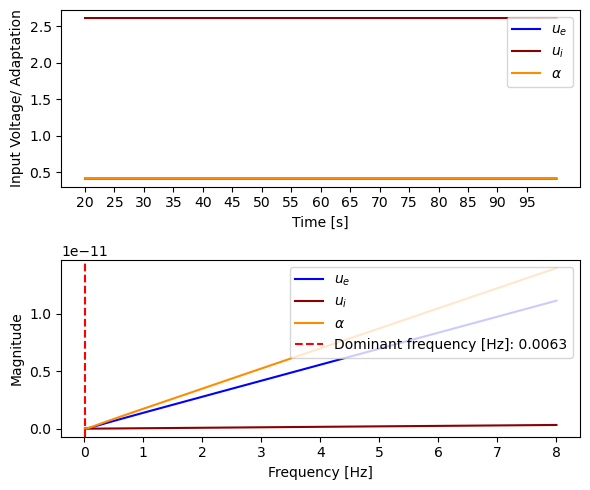

Frequency:  0.00625
Amplitude:  1.1097122665226777e-09
Midpoint Oscillation e:  0.412816419012933
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2333.333333333333
70  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


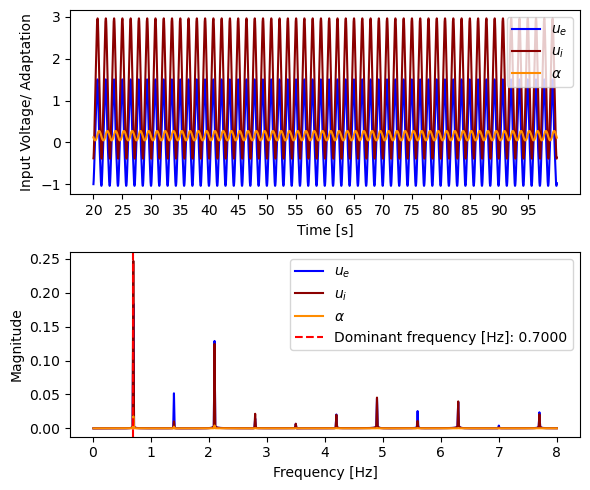

Frequency:  0.7
Amplitude:  2.5446055525278086
Midpoint Oscillation e:  0.23440287075817157
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


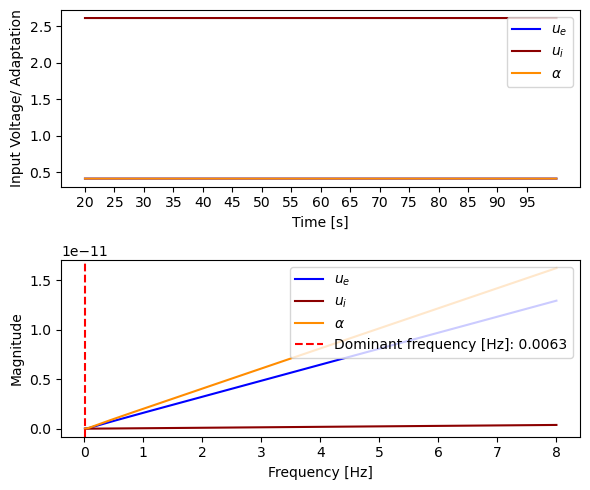

Frequency:  0.00625
Amplitude:  1.2879470268067905e-09
Midpoint Oscillation e:  0.41281641892381415
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2355.5555555555557
71  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


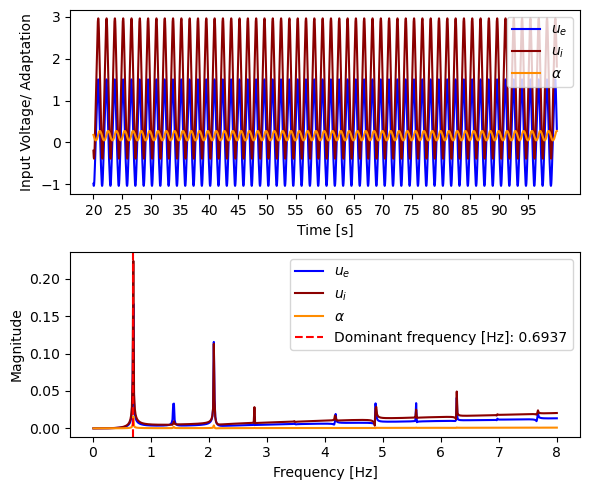

Frequency:  0.69375
Amplitude:  2.544962088213393
Midpoint Oscillation e:  0.23454022076937864
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


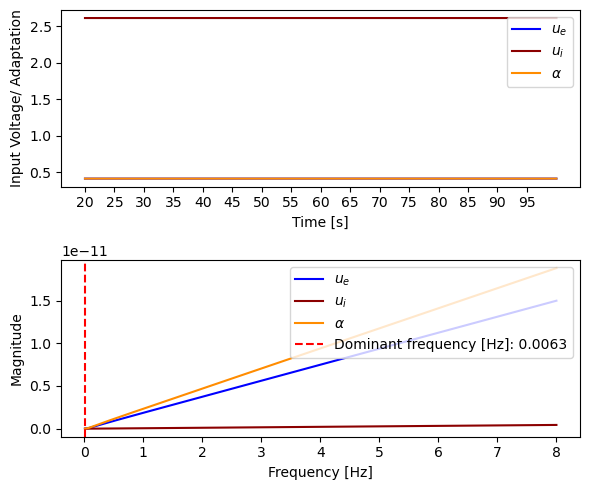

Frequency:  0.00625
Amplitude:  1.4905675027598875e-09
Midpoint Oscillation e:  0.41281641882250253
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2377.777777777778
72  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


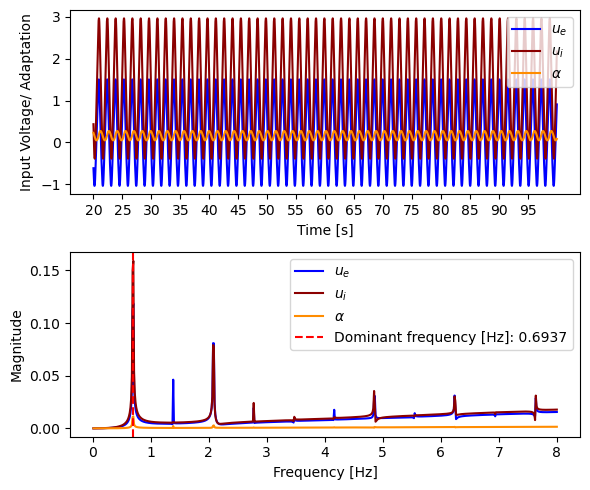

Frequency:  0.69375
Amplitude:  2.5452977212587857
Midpoint Oscillation e:  0.2346822866713738
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


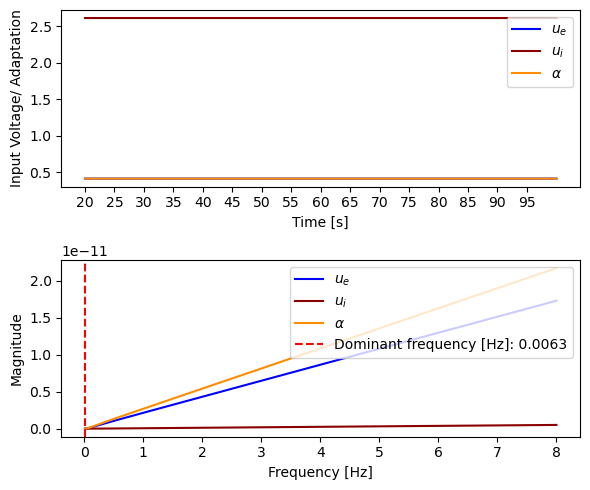

Frequency:  0.00625
Amplitude:  1.7203057867121174e-09
Midpoint Oscillation e:  0.4128164187076318
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2400.0
73  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


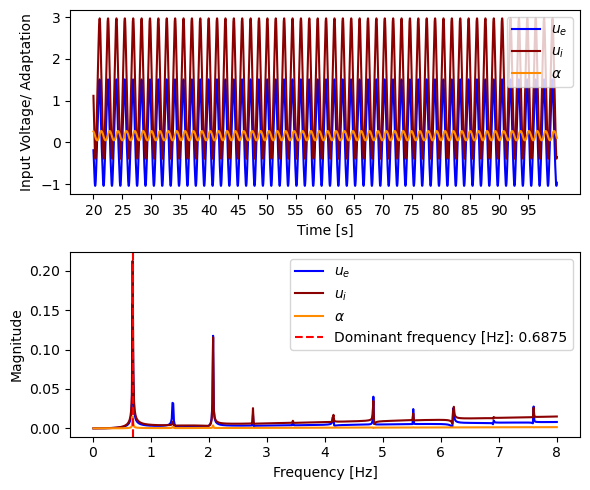

Frequency:  0.6875
Amplitude:  2.545627378052676
Midpoint Oscillation e:  0.23482187990494252
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


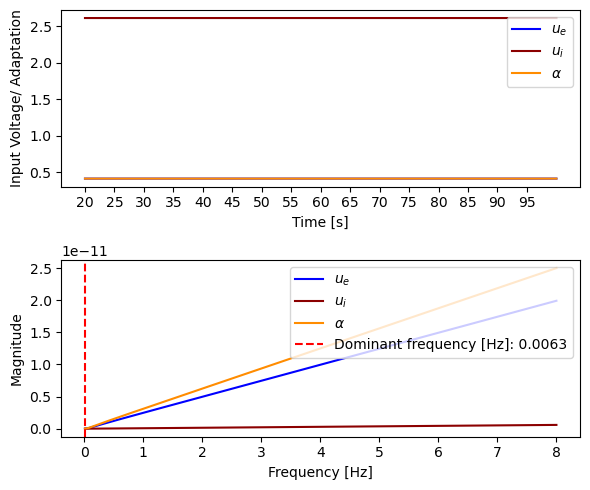

Frequency:  0.00625
Amplitude:  1.9801292827636985e-09
Midpoint Oscillation e:  0.4128164185777187
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2422.222222222222
74  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


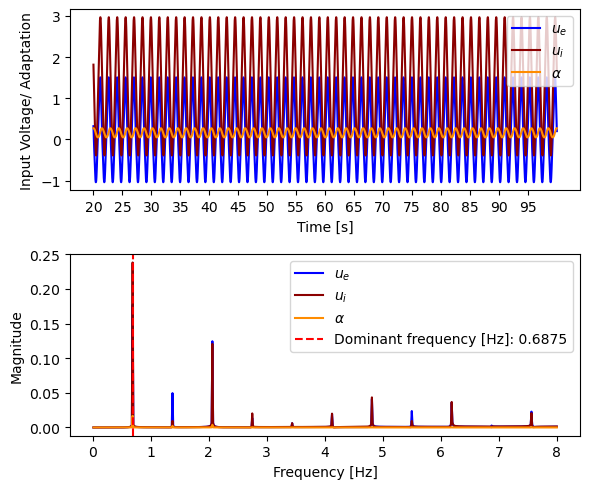

Frequency:  0.6875
Amplitude:  2.5459513324791105
Midpoint Oscillation e:  0.23495902026801785
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


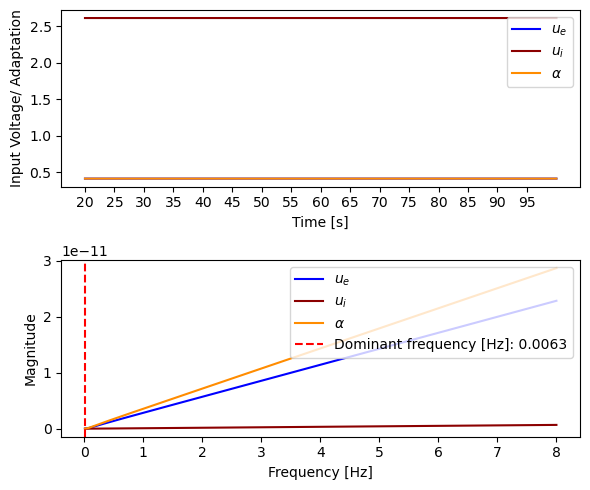

Frequency:  0.00625
Amplitude:  2.2732551951953894e-09
Midpoint Oscillation e:  0.41281641843115446
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2444.4444444444443
75  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


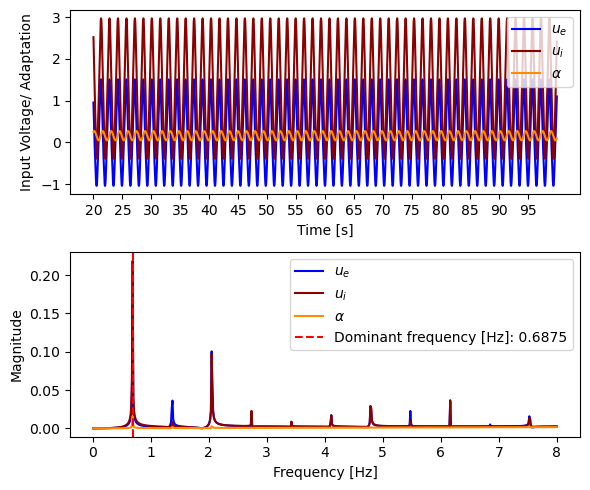

Frequency:  0.6875
Amplitude:  2.5462697537459196
Midpoint Oscillation e:  0.23509372851405497
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


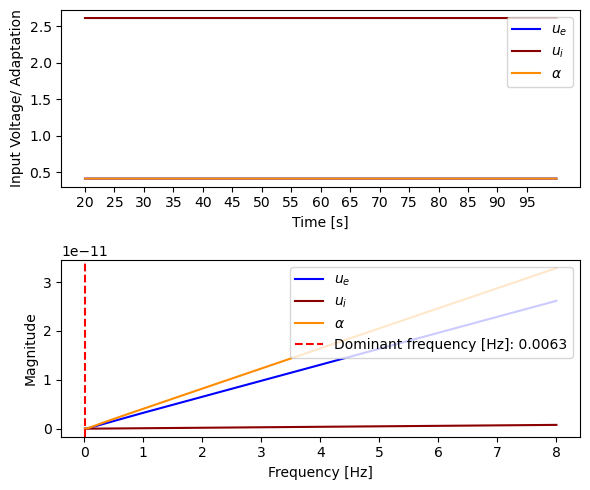

Frequency:  0.00625
Amplitude:  2.6031586330965695e-09
Midpoint Oscillation e:  0.4128164182662014
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2466.6666666666665
76  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


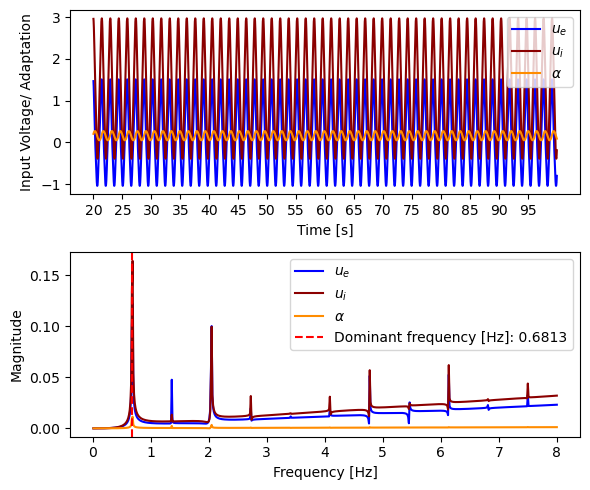

Frequency:  0.68125
Amplitude:  2.5465829101034476
Midpoint Oscillation e:  0.23522603825814503
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


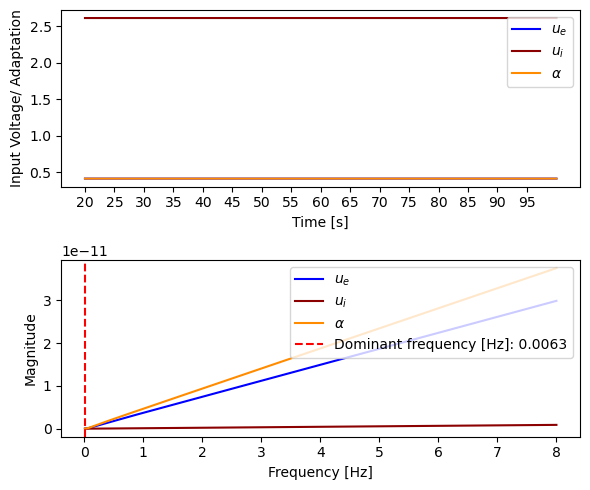

Frequency:  0.00625
Amplitude:  2.97358532241887e-09
Midpoint Oscillation e:  0.4128164180809867
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2488.8888888888887
77  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


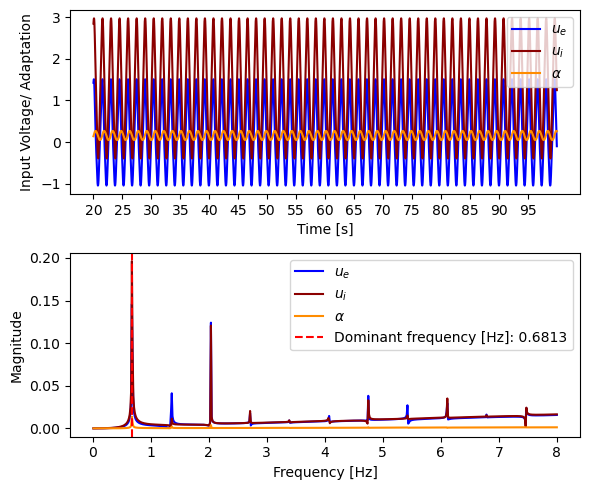

Frequency:  0.68125
Amplitude:  2.546947244980358
Midpoint Oscillation e:  0.23538434601301694
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


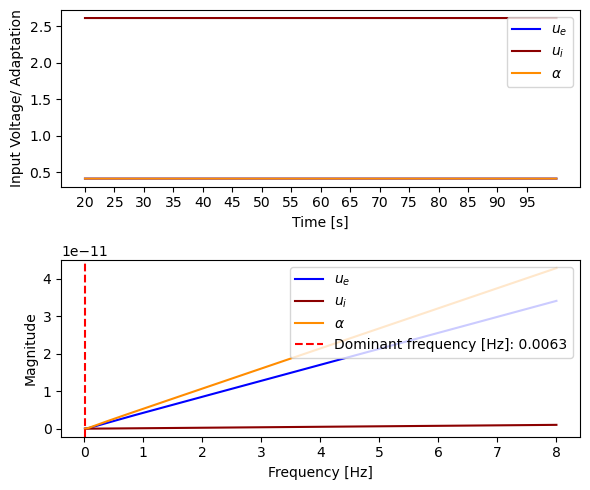

Frequency:  0.00625
Amplitude:  3.388575031681995e-09
Midpoint Oscillation e:  0.4128164178734901
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2511.1111111111113
78  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


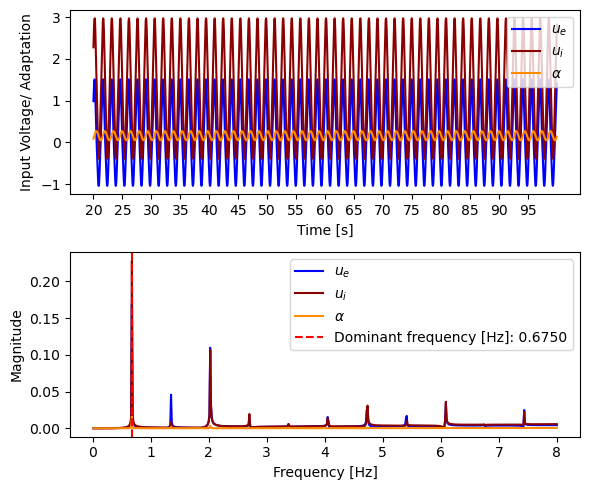

Frequency:  0.675
Amplitude:  2.5472506479066634
Midpoint Oscillation e:  0.23551243653617882
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


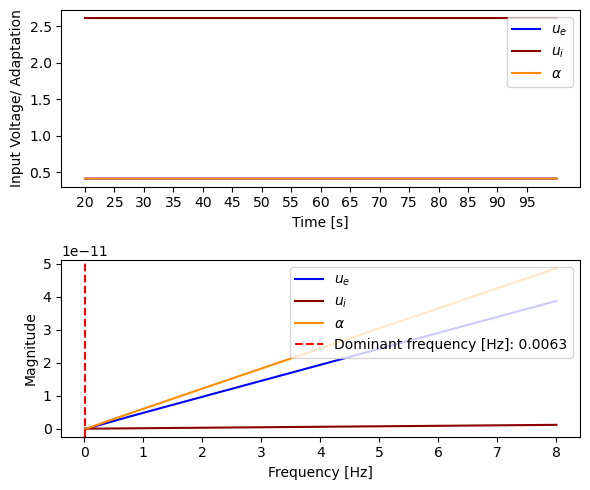

Frequency:  0.00625
Amplitude:  3.852462349129837e-09
Midpoint Oscillation e:  0.4128164176415451
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2533.333333333333
79  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


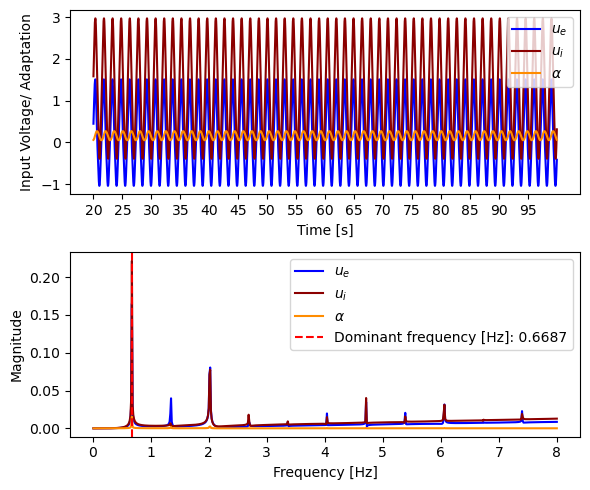

Frequency:  0.66875
Amplitude:  2.547548661865245
Midpoint Oscillation e:  0.23563800628131892
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


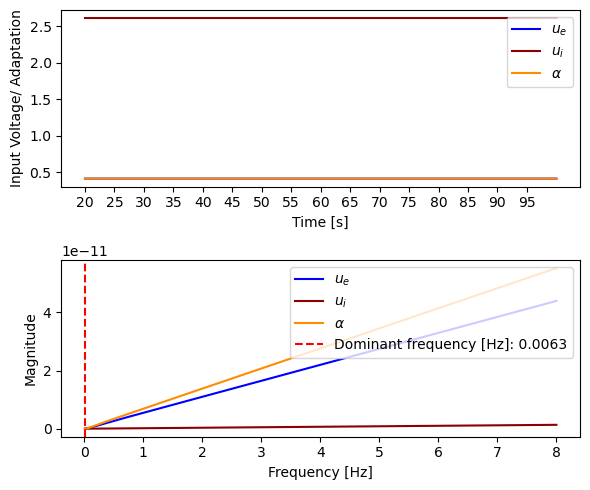

Frequency:  0.00625
Amplitude:  4.36989300300894e-09
Midpoint Oscillation e:  0.4128164173828284
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2555.5555555555557
80  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


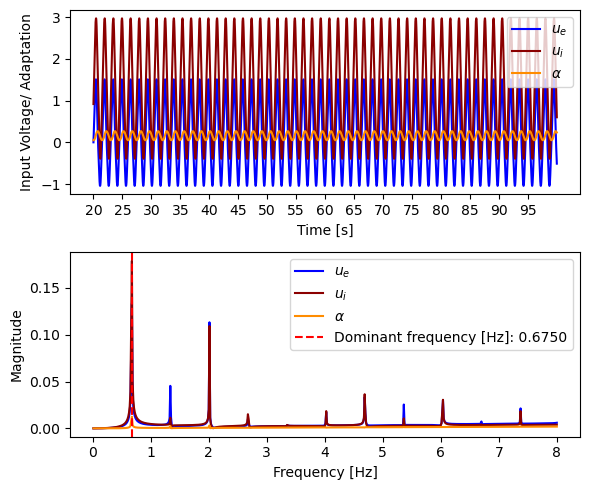

Frequency:  0.675
Amplitude:  2.547841658738031
Midpoint Oscillation e:  0.23576134271010063
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


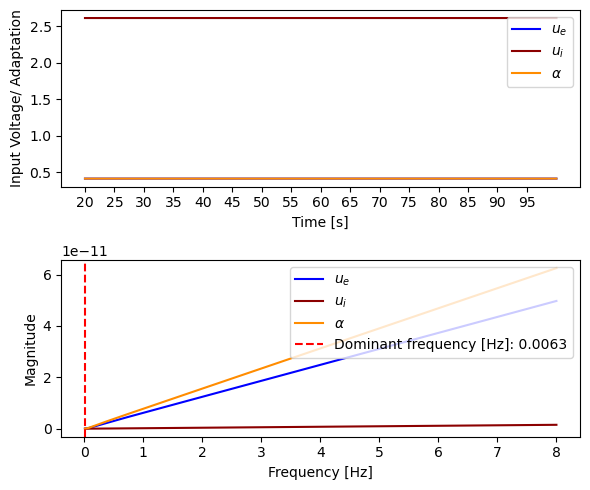

Frequency:  0.00625
Amplitude:  4.94584823096389e-09
Midpoint Oscillation e:  0.4128164170948493
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2577.777777777778
81  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


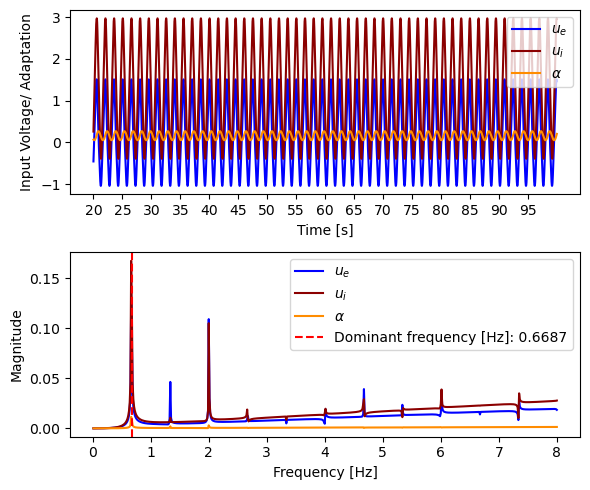

Frequency:  0.66875
Amplitude:  2.548129684159728
Midpoint Oscillation e:  0.23588236234176319
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


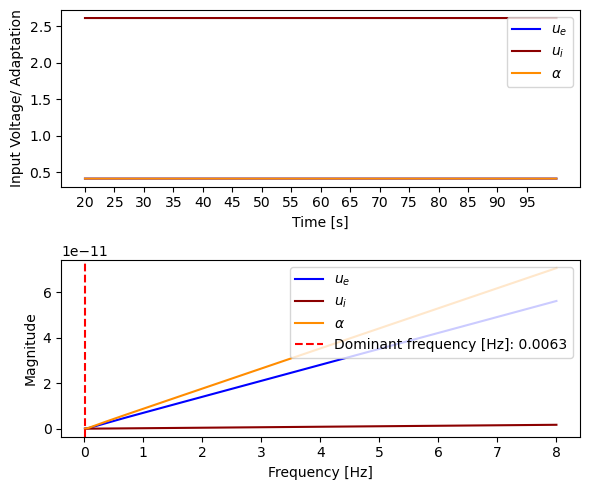

Frequency:  0.00625
Amplitude:  5.585641504879391e-09
Midpoint Oscillation e:  0.41281641677495134
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2600.0
82  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


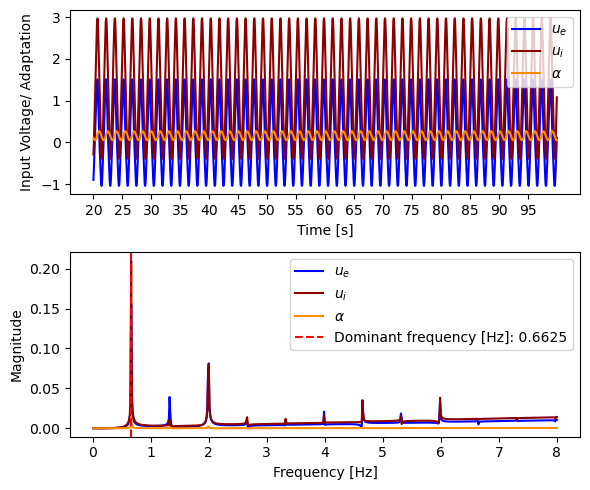

Frequency:  0.6625
Amplitude:  2.548412854151224
Midpoint Oscillation e:  0.23600108657816632
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


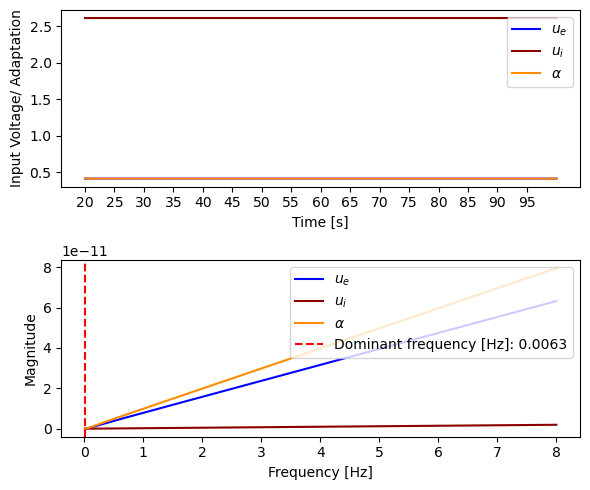

Frequency:  0.00625
Amplitude:  6.294946952589697e-09
Midpoint Oscillation e:  0.4128164164202974
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2622.222222222222
83  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


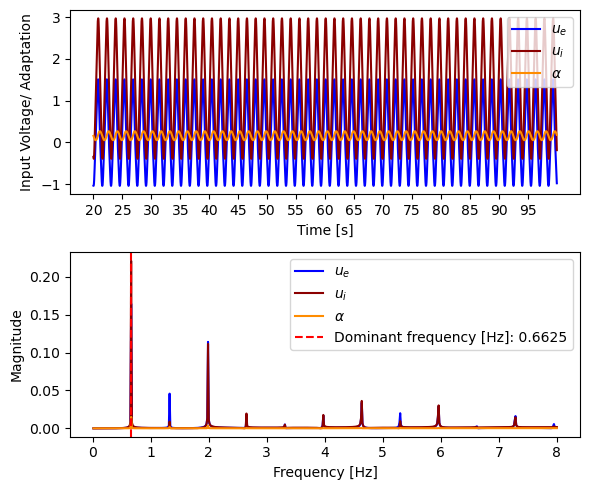

Frequency:  0.6625
Amplitude:  2.548691051888625
Midpoint Oscillation e:  0.2361173970446615
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


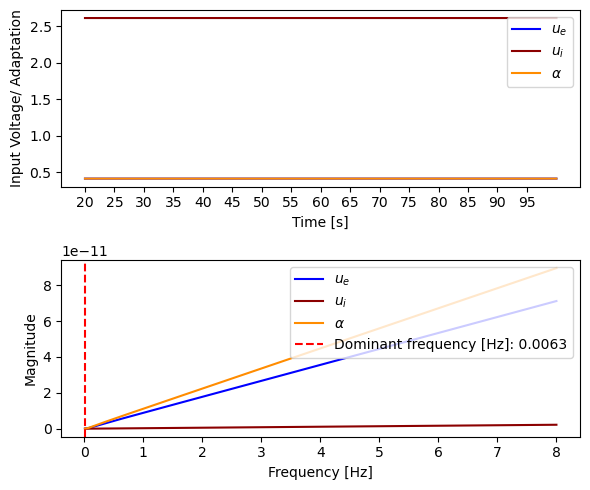

Frequency:  0.00625
Amplitude:  7.079802466503082e-09
Midpoint Oscillation e:  0.4128164160278682
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2644.4444444444443
84  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


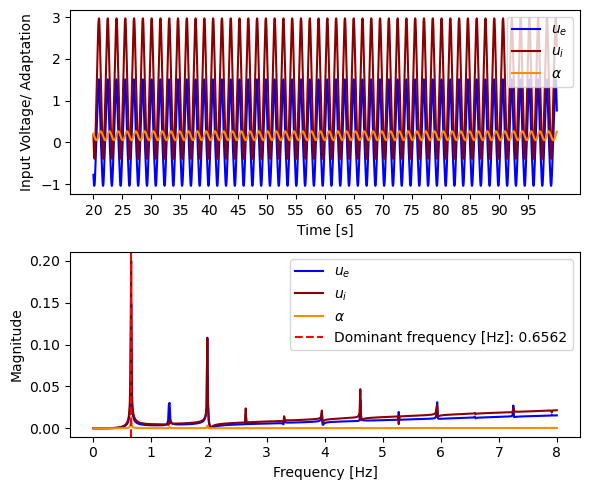

Frequency:  0.65625
Amplitude:  2.5489647971385248
Midpoint Oscillation e:  0.23623144378538263
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


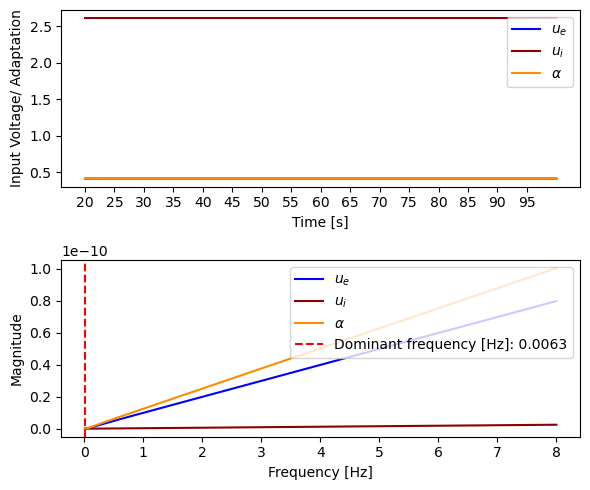

Frequency:  0.00625
Amplitude:  7.946622582188922e-09
Midpoint Oscillation e:  0.41281641559445653
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2666.6666666666665
85  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


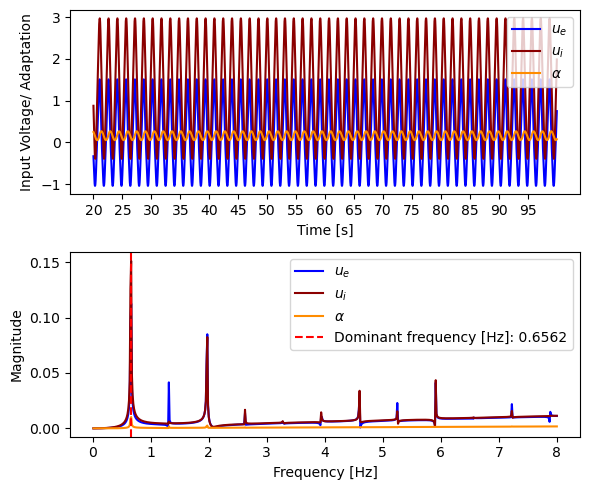

Frequency:  0.65625
Amplitude:  2.549233540037598
Midpoint Oscillation e:  0.23634303983991034
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


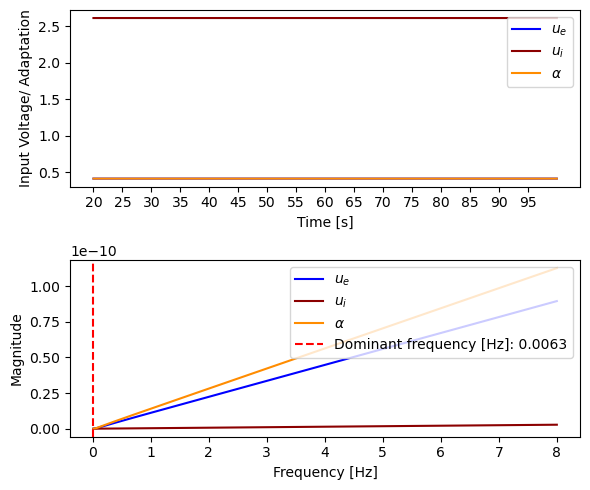

Frequency:  0.00625
Amplitude:  8.902221459994308e-09
Midpoint Oscillation e:  0.4128164151166558
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2688.8888888888887
86  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


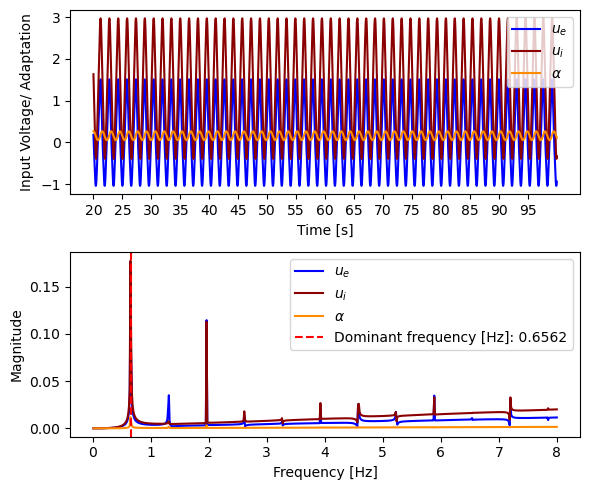

Frequency:  0.65625
Amplitude:  2.5494972903924475
Midpoint Oscillation e:  0.23645213271501853
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


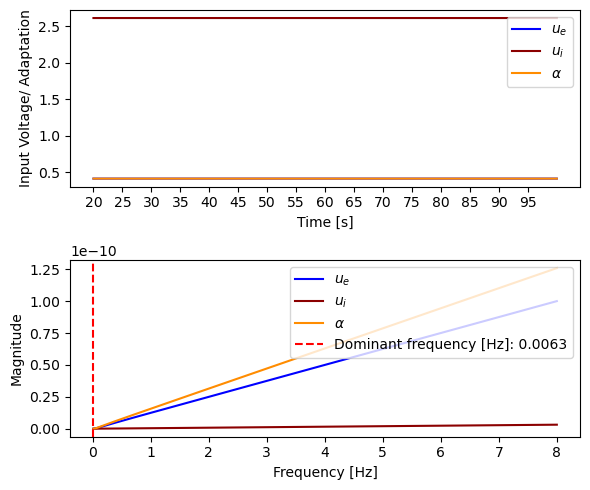

Frequency:  0.00625
Amplitude:  9.953818880248377e-09
Midpoint Oscillation e:  0.41281641459085555
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2711.1111111111113
87  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


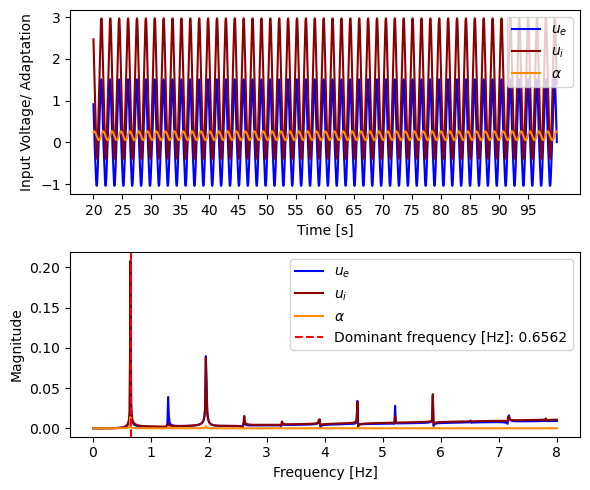

Frequency:  0.65625
Amplitude:  2.5497562492924533
Midpoint Oscillation e:  0.23655842066999266
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


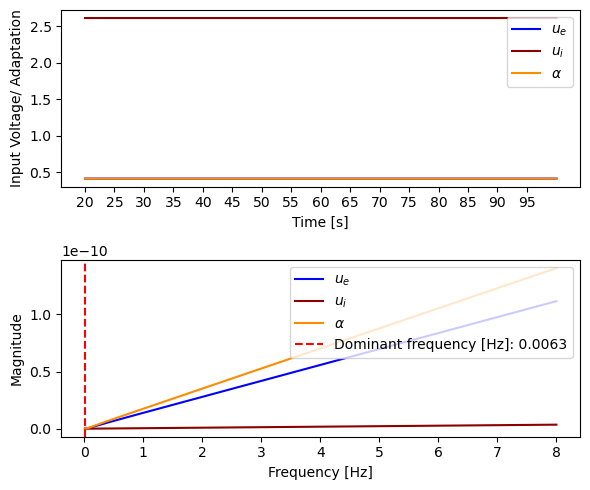

Frequency:  0.00625
Amplitude:  1.1109050179758384e-08
Midpoint Oscillation e:  0.4128164140132383
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2733.333333333333
88  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


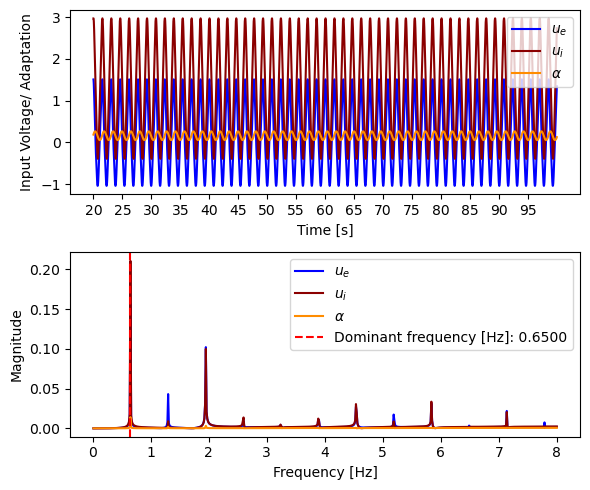

Frequency:  0.65
Amplitude:  2.5500098766950137
Midpoint Oscillation e:  0.23666140015438775
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


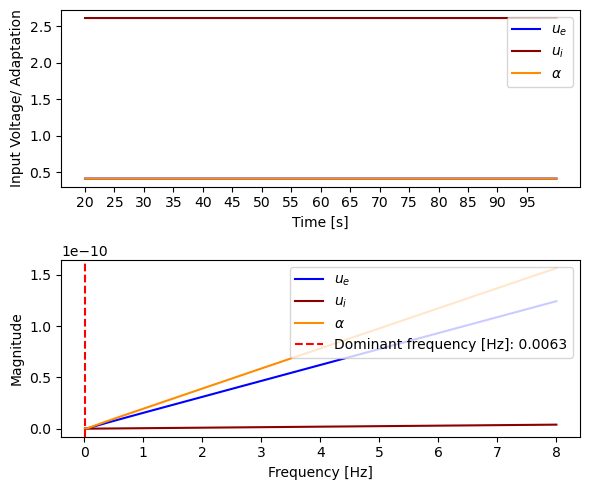

Frequency:  0.00625
Amplitude:  1.2375983737822338e-08
Midpoint Oscillation e:  0.41281641337977015
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2755.5555555555557
89  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


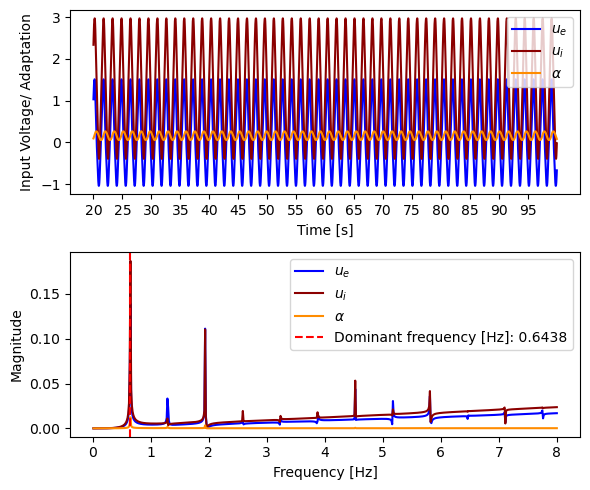

Frequency:  0.64375
Amplitude:  2.550256641248995
Midpoint Oscillation e:  0.23675962923350347
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


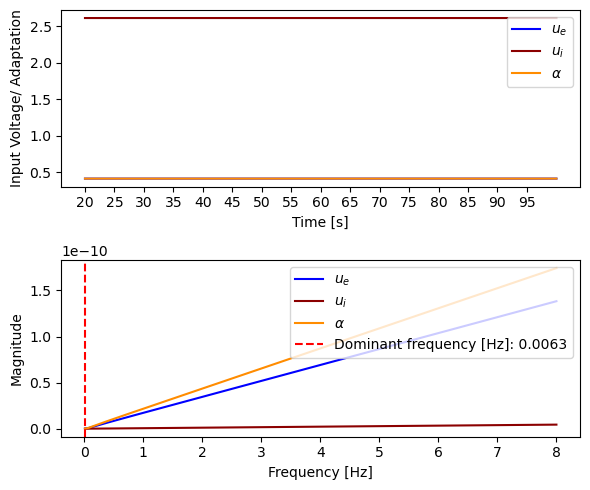

Frequency:  0.00625
Amplitude:  1.3763128248189815e-08
Midpoint Oscillation e:  0.4128164126861966
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2777.7777777777774
90  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


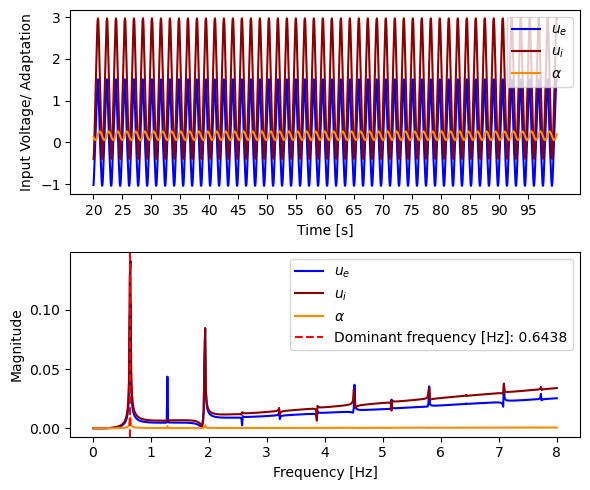

Frequency:  0.64375
Amplitude:  2.550640073804038
Midpoint Oscillation e:  0.23691005479474547
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


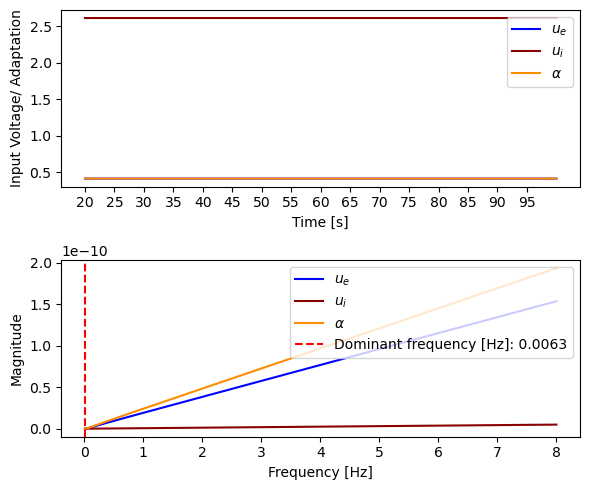

Frequency:  0.00625
Amplitude:  1.52794525920541e-08
Midpoint Oscillation e:  0.4128164119280329
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2800.0
91  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


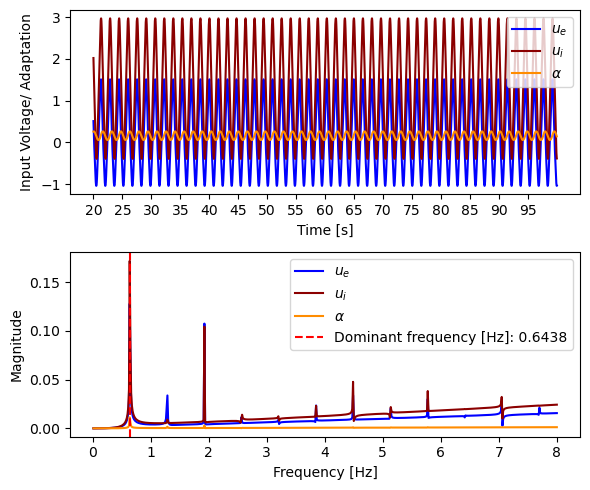

Frequency:  0.64375
Amplitude:  2.5508349146927625
Midpoint Oscillation e:  0.23690137153839663
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


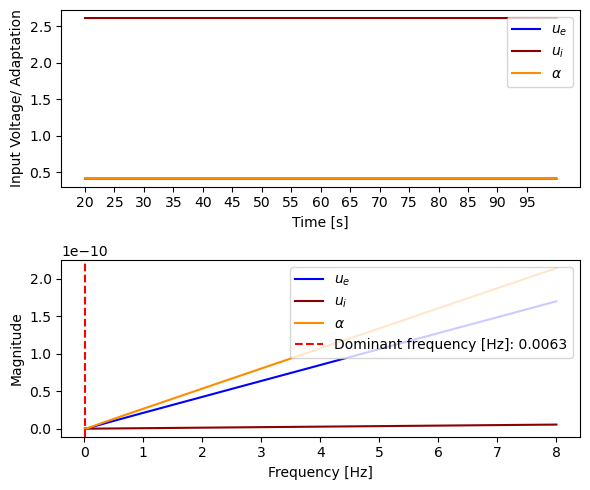

Frequency:  0.00625
Amplitude:  1.693438761440902e-08
Midpoint Oscillation e:  0.4128164111005642
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2822.222222222222
92  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


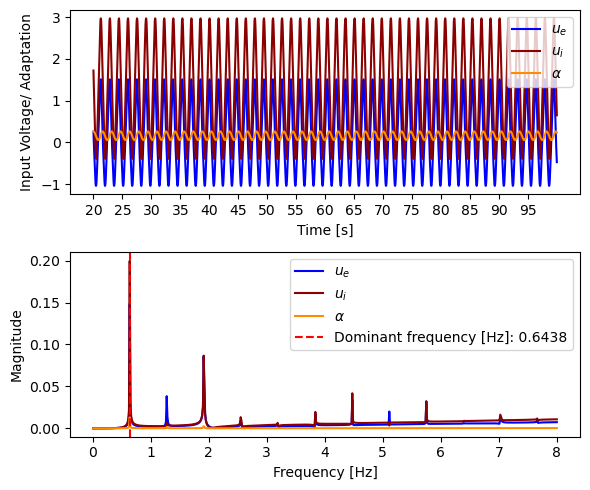

Frequency:  0.64375
Amplitude:  2.551089981784744
Midpoint Oscillation e:  0.23700019895925406
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


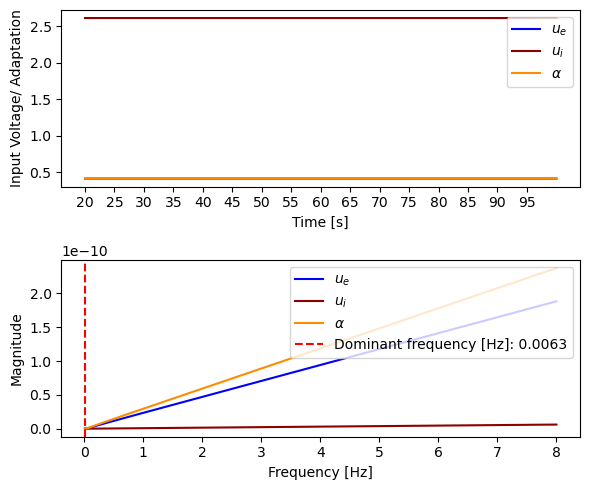

Frequency:  0.00625
Amplitude:  1.8737842444327413e-08
Midpoint Oscillation e:  0.4128164101988351
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2844.4444444444443
93  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


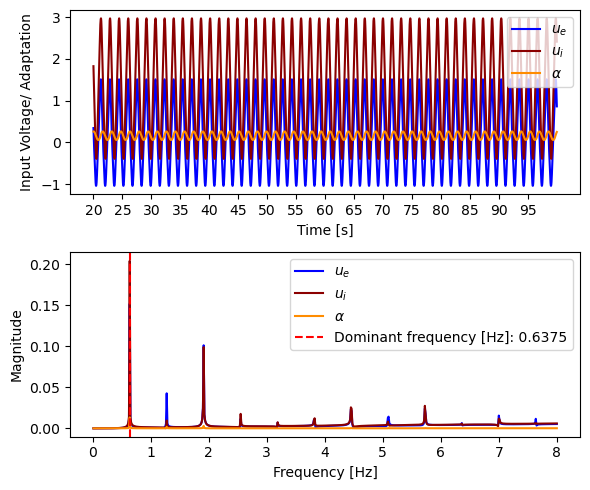

Frequency:  0.6375
Amplitude:  2.551336346347359
Midpoint Oscillation e:  0.23709823524321993
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


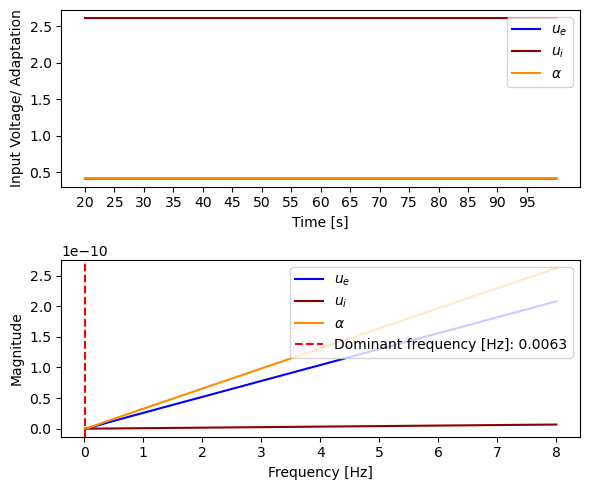

Frequency:  0.00625
Amplitude:  2.070021132283273e-08
Midpoint Oscillation e:  0.41281640921764956
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2866.6666666666665
94  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


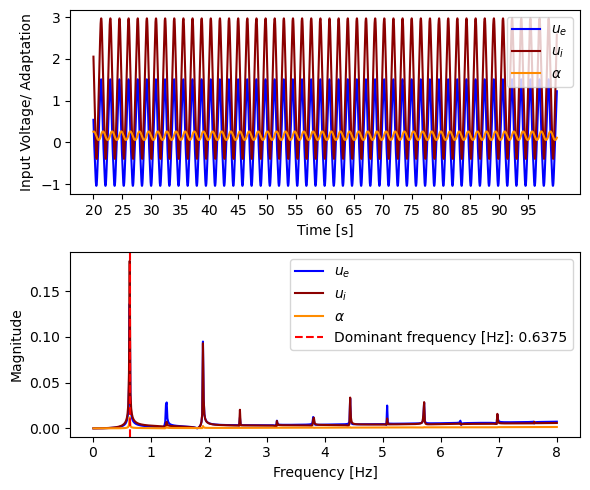

Frequency:  0.6375
Amplitude:  2.5515770680279193
Midpoint Oscillation e:  0.23719495244035815
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


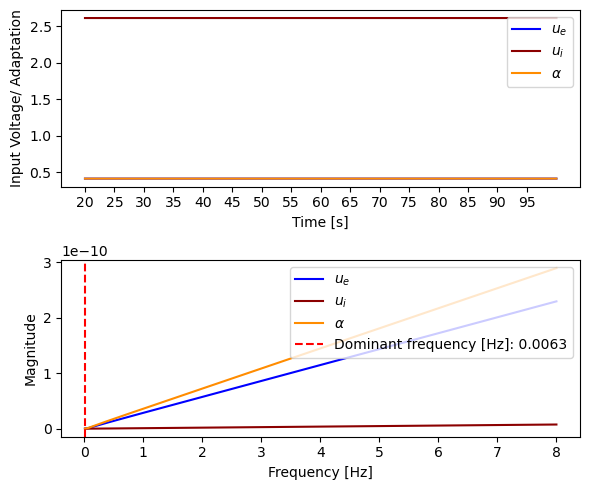

Frequency:  0.00625
Amplitude:  2.2832393420380015e-08
Midpoint Oscillation e:  0.4128164081515572
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2888.8888888888887
95  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


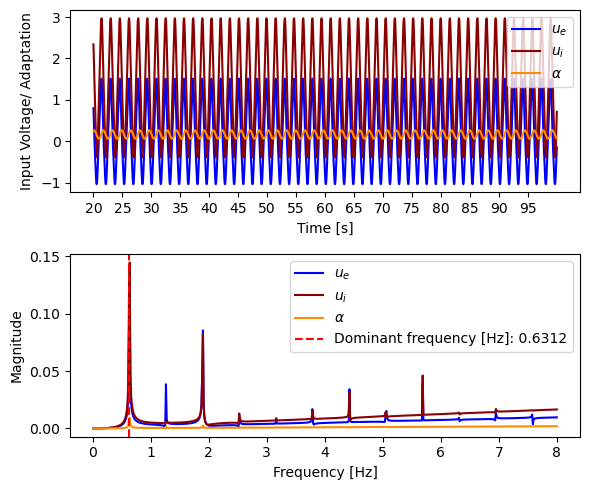

Frequency:  0.63125
Amplitude:  2.5518139512672073
Midpoint Oscillation e:  0.23729030485180458
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


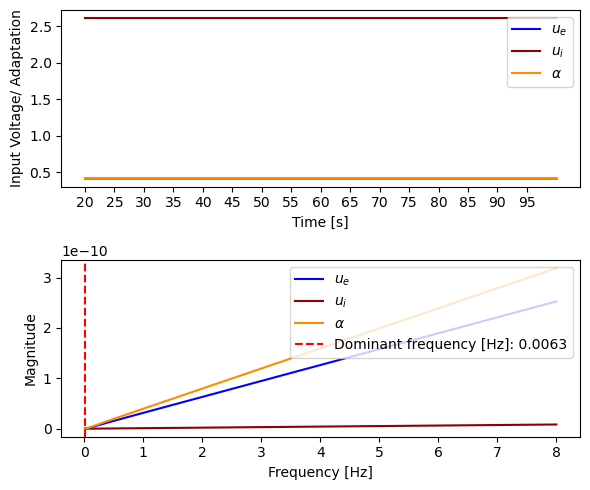

Frequency:  0.00625
Amplitude:  2.5145789395164542e-08
Midpoint Oscillation e:  0.41281640699485755
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2911.111111111111
96  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


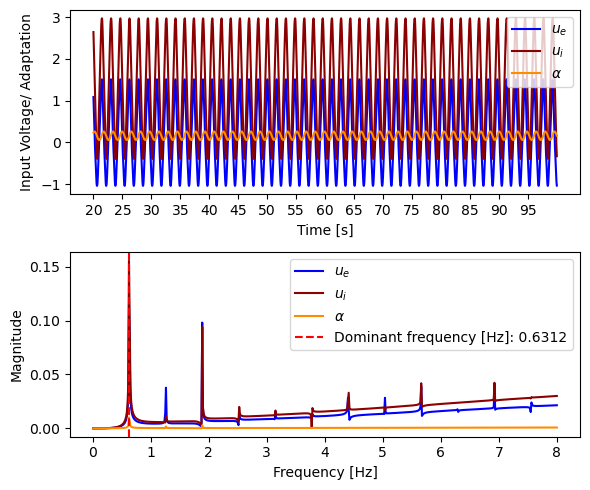

Frequency:  0.63125
Amplitude:  2.5520467837684953
Midpoint Oscillation e:  0.23738414715672662
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


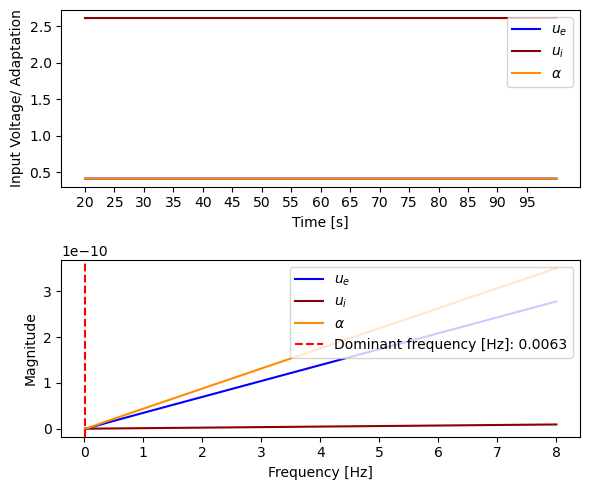

Frequency:  0.00625
Amplitude:  2.765231843504523e-08
Midpoint Oscillation e:  0.4128164057415922
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2933.333333333333
97  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


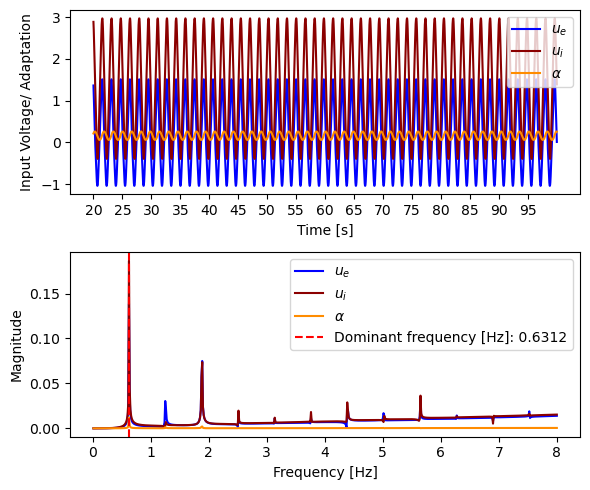

Frequency:  0.63125
Amplitude:  2.552276150695617
Midpoint Oscillation e:  0.23747665792471162
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


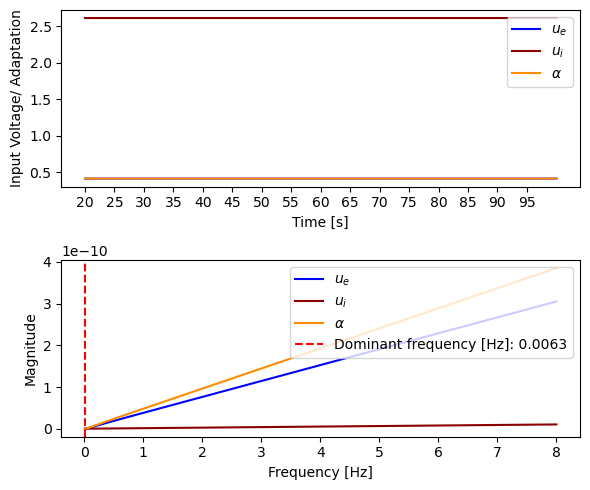

Frequency:  0.00625
Amplitude:  3.036442974835296e-08
Midpoint Oscillation e:  0.41281640438553563
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2955.5555555555557
98  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


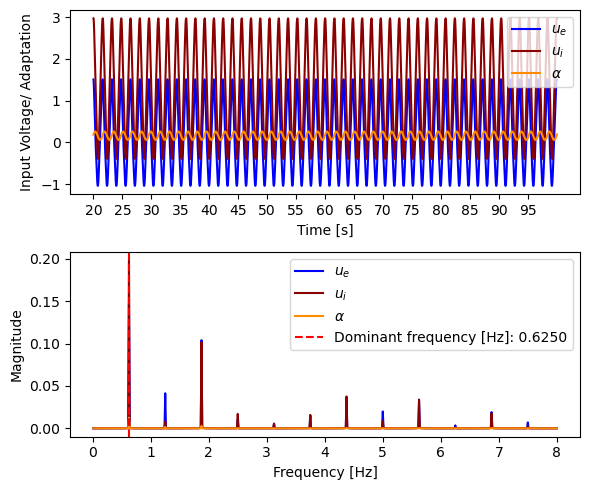

Frequency:  0.625
Amplitude:  2.5525022056285707
Midpoint Oscillation e:  0.2375676185548733
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


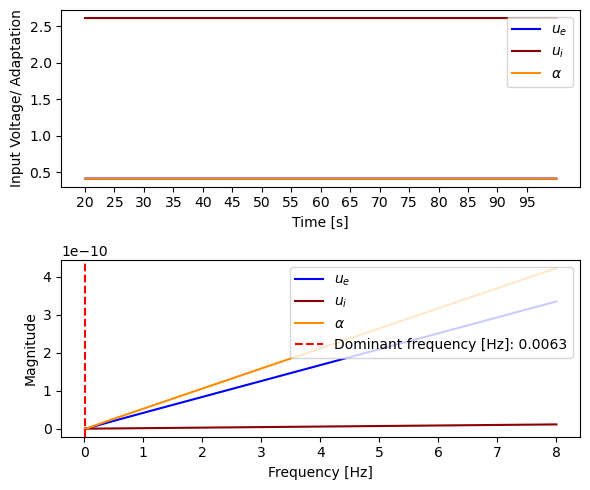

Frequency:  0.00625
Amplitude:  3.3295099288732644e-08
Midpoint Oscillation e:  0.4128164029201994
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  2977.777777777778
99  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


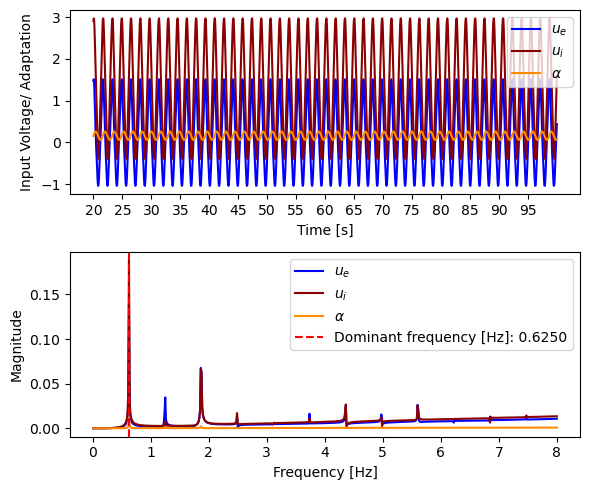

Frequency:  0.625
Amplitude:  2.5535717288926336
Midpoint Oscillation e:  0.23808057343103028
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


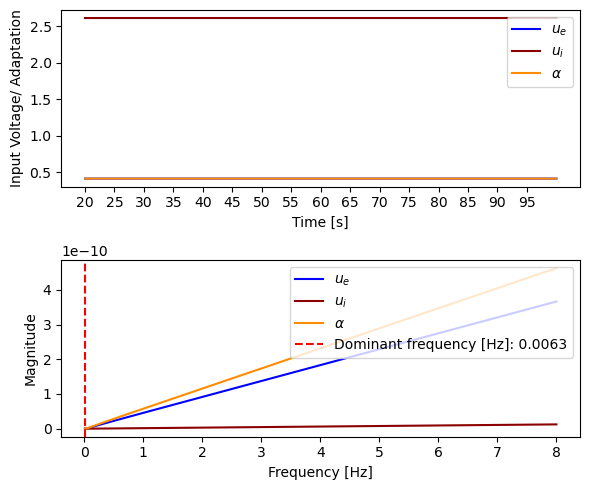

Frequency:  0.00625
Amplitude:  3.6457851071425296e-08
Midpoint Oscillation e:  0.4128164013388214
Midpoint Equilibrium e:  0.13382238024901616

tau_alpha  =  3000.0
100  /  100
Type of Instability: ['Dynamic Turing', 'Mixed Turing']
ue_0: -0.14517165906990526
ui_0: 0.15006273090899716
alpha: -0.14517165906990526


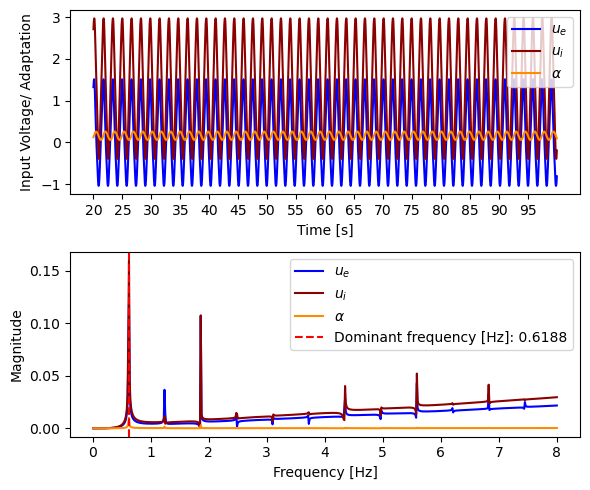

Frequency:  0.61875
Amplitude:  2.553823124785466
Midpoint Oscillation e:  0.238184663699459
Midpoint Equilibrium e:  0.13382238024901616
Type of Instability: ['Static Turing']
ue_0: 0.4128164195679376
ui_0: 2.614604332797428
alpha: 0.4128164195679376


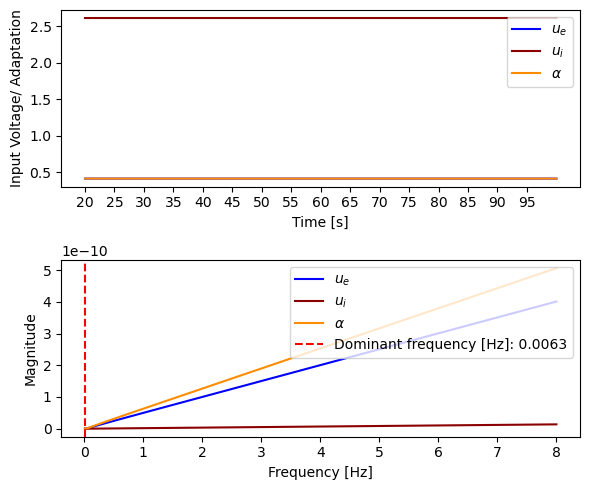

Frequency:  0.00625
Amplitude:  3.986675622957847e-08
Midpoint Oscillation e:  0.4128163996343675
Midpoint Equilibrium e:  0.13382238024901616


In [ ]:
refresh()
param = parameterset

param["tau_e"] = 20
param["tau_i"] = 40
param["tau_alpha"] = 1200
param["g"] = 0.8

I_e = 1.2
I_i = 0.3

perturbation_type = 'random'
# perturbation_type = 'box'
perturbation_box_size = 0.4
perturbation_strength = 0.01

connectivity = 'rect'

dt=2e-1
t_max=100e3
t_start = 20

variable = 'tau_alpha'
variable_start=800
variable_stop=3000
steps=100

name = 'Simulation_Data/rect_result_tau_alpha'
gauss_result_tau_alpha = parameter_variation(
                              param=param,
                              name=name,
                              I_e=I_e,
                              I_i=I_i,
                              variable=variable,
                              variable_start=variable_start,
                              connectivity=connectivity,
                              perturbation_type=perturbation_type,
                              perturbation_strength=perturbation_strength,
                              perturbation_box_size=perturbation_box_size,
                              variable_stop=variable_stop,
                              steps=steps,
                              t_max=t_max,
                              t_start=t_start,
                              dt=dt,
                              )

## Plots

Gaussian Connectivity
amplitude_alpha start:  0.8382750969678627
amplitude_alpha stop:  0.23881951807785523
frequency start:  0.23125
frequency stop:  1.03125



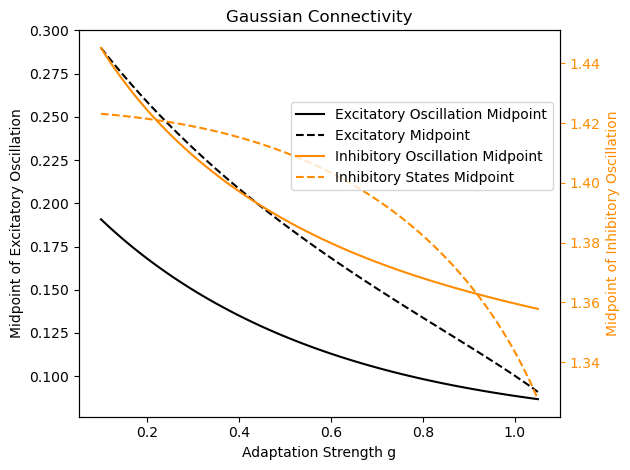

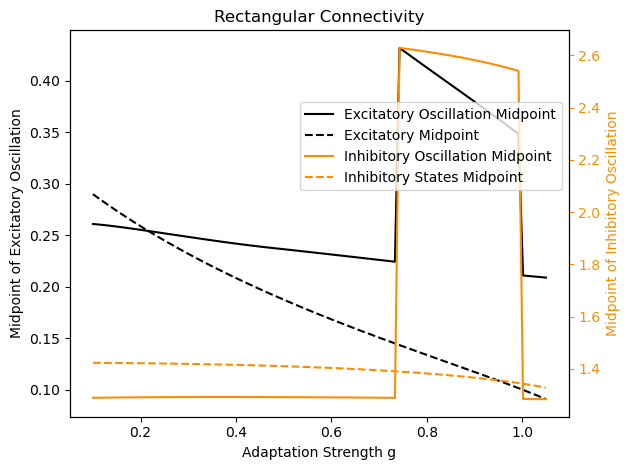

In [35]:
name = 'Simulation_Data/gauss_result_g'
res = {}
with h5py.File(name, 'r') as f:
    for key in f:
        res[key] = f[key][()]
res['variable'] = res['variable'].decode('utf-8')

color_alpha = "darkorange"

print("Gaussian Connectivity")
print("amplitude_alpha start: ",res['amplitude_alpha'][0])
print("amplitude_alpha stop: ",res['amplitude_alpha'][-1])
print("frequency start: ",res['frequencies'][0])
print("frequency stop: ",res['frequencies'][-1])
print()

# Plot Frequency and alpha_amplitude
fig, ax1 = plt.subplots(1, 1)

# Create a second y-axis for the alpha
ax1.plot(res["variable_values"], res["midpoint_e"], label='Excitatory Oscillation Midpoint', color="black")
ax1.plot(res["variable_values"], res["midpoint_eq_e"], label='Excitatory Midpoint', color="black", linestyle='--')
ax1.set_ylabel('Midpoint of Excitatory Oscillation')
ax1.set_xlabel('Adaptation Strength g')
ax1.set_title('Gaussian Connectivity')

# Create a second y-axis for the alpha
ax2 = ax1.twinx()
ax2.plot(res["variable_values"], res["midpoint_i"], label='Inhibitory Oscillation Midpoint', color=color_alpha)
ax2.plot(res["variable_values"], res["midpoint_eq_i"], label='Inhibitory States Midpoint', color=color_alpha, linestyle='--')
ax2.set_ylabel('Midpoint of Inhibitory Oscillation', color=color_alpha)
ax2.tick_params('y',  colors=color_alpha)

fig.legend(loc="center right", bbox_to_anchor=(1,0.7), bbox_transform=ax1.transAxes)
fig.tight_layout()
plt.show()

name = 'Simulation_Data/rect_result_g'
res = {}
with h5py.File(name, 'r') as f:
    for key in f:
        res[key] = f[key][()]
res['variable'] = res['variable'].decode('utf-8')

# Plot Frequency and alpha_amplitude
fig, ax1 = plt.subplots(1, 1)

# Create a second y-axis for the alpha
ax1.plot(res["variable_values"], res["midpoint_e"], label='Excitatory Oscillation Midpoint', color="black")
ax1.plot(res["variable_values"], res["midpoint_eq_e"], label='Excitatory Midpoint', color="black", linestyle='--')
ax1.set_ylabel('Midpoint of Excitatory Oscillation')
ax1.set_xlabel('Adaptation Strength g')
ax1.set_title('Rectangular Connectivity')

# Create a second y-axis for the alpha
ax2 = ax1.twinx()
ax2.plot(res["variable_values"], res["midpoint_i"], label='Inhibitory Oscillation Midpoint', color=color_alpha)
ax2.plot(res["variable_values"], res["midpoint_eq_i"], label='Inhibitory States Midpoint', color=color_alpha, linestyle='--')
ax2.set_ylabel('Midpoint of Inhibitory Oscillation', color=color_alpha)
ax2.tick_params('y',  colors=color_alpha)

fig.legend(loc="center right", bbox_to_anchor=(1,0.7), bbox_transform=ax1.transAxes)
fig.tight_layout()
plt.show()

### Adaptation Strength

Gaussian Connectivity
amplitude_alpha start:  0.8382750969678627
amplitude_alpha stop:  0.23881951807785523
frequency start:  0.23125
frequency stop:  1.03125



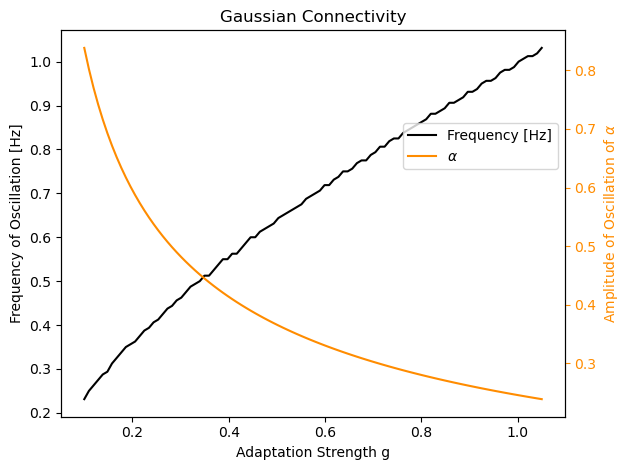

Rectangular Connectivity
amplitude_alpha start:  0.9544083364199845
amplitude_alpha stop:  0.2844928456384506
frequency start:  0.2875
frequency stop:  1.075



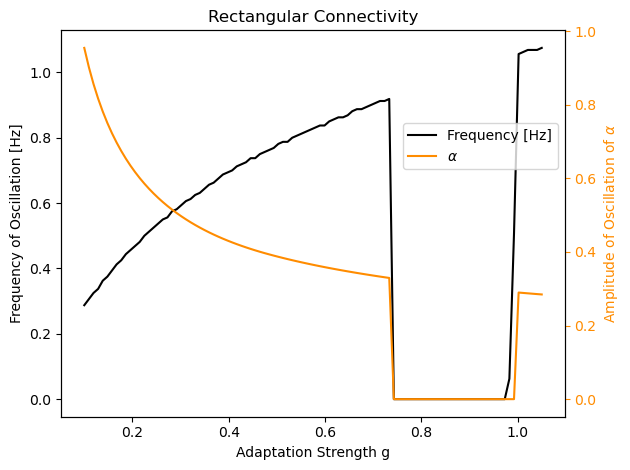

In [38]:
name = 'Simulation_Data/gauss_result_g'
res = {}
with h5py.File(name, 'r') as f:
    for key in f:
        res[key] = f[key][()]
res['variable'] = res['variable'].decode('utf-8')

color_alpha = "darkorange"

print("Gaussian Connectivity")
print("amplitude_alpha start: ",res['amplitude_alpha'][0])
print("amplitude_alpha stop: ",res['amplitude_alpha'][-1])
print("frequency start: ",res['frequencies'][0])
print("frequency stop: ",res['frequencies'][-1])
print()

# Plot Frequency and alpha_amplitude
fig, ax1 = plt.subplots(1, 1)

# Create a second y-axis for the alpha
ax1.plot(res["variable_values"], res["frequencies"], label='Frequency [Hz]', color="black")
ax1.set_ylabel('Frequency of Oscillation [Hz]')
ax1.set_xlabel('Adaptation Strength g')
ax1.set_title('Gaussian Connectivity')

# Create a second y-axis for the alpha
ax2 = ax1.twinx()
ax2.plot(res['variable_values'], res['amplitude_alpha'], color=color_alpha, label=r"$\alpha$")
ax2.set_ylabel(r'Amplitude of Oscillation of $\alpha$',  color=color_alpha)
ax2.tick_params('y',  colors=color_alpha)

fig.legend(loc="center right", bbox_to_anchor=(1,0.7), bbox_transform=ax1.transAxes)
fig.tight_layout()
plt.show()

#######################################################################################################################

name = 'Simulation_Data/rect_result_g'
res = {}
with h5py.File(name, 'r') as f:
    for key in f:
        res[key] = f[key][()]
res['variable'] = res['variable'].decode('utf-8')

print("Rectangular Connectivity")
print("amplitude_alpha start: ",res['amplitude_alpha'][0])
print("amplitude_alpha stop: ",res['amplitude_alpha'][-1])
print("frequency start: ",res['frequencies'][0])
print("frequency stop: ",res['frequencies'][-1])
print()

fig, ax1 = plt.subplots(1, 1)

# Create a second y-axis for the alpha
ax1.plot(res["variable_values"], res["frequencies"], label='Frequency [Hz]', color="black")
ax1.set_ylabel('Frequency of Oscillation [Hz]')
ax1.set_xlabel('Adaptation Strength g')
ax1.set_title('Rectangular Connectivity')

# Create a second y-axis for the alpha
ax2 = ax1.twinx()
ax2.plot(res['variable_values'], res['amplitude_alpha'], color=color_alpha, label=r"$\alpha$")
ax2.set_ylabel(r'Amplitude of Oscillation of $\alpha$',  color=color_alpha)
ax2.tick_params('y',  colors=color_alpha)

fig.legend(loc="center right", bbox_to_anchor=(1,0.7), bbox_transform=ax1.transAxes)
fig.tight_layout()
plt.show()


Gaussian Connectivity
amplitude_e start:  1.7085941041928852
amplitude_e stop:  1.8149196164026482
amplitude_i start:  2.7046151495553534
amplitude_i stop:  2.9150372969820686



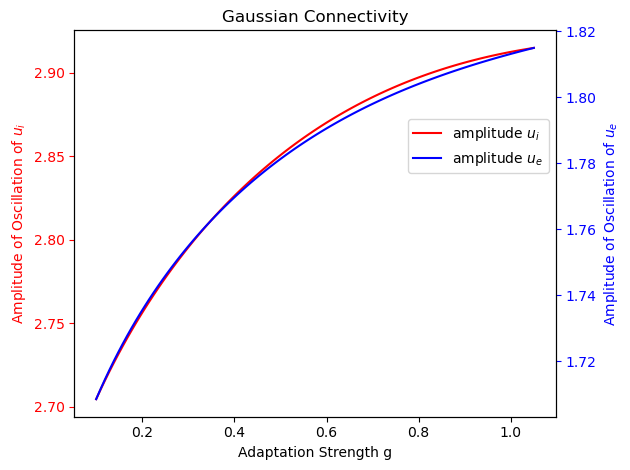

Rectangular Connectivity
amplitude_e start:  2.4554678290498217
amplitude_e stop:  2.5097909250355785
amplitude_i start:  3.3236274453163985
amplitude_i max:  3.331014524953985
amplitude_i stop:  3.2821408537774652



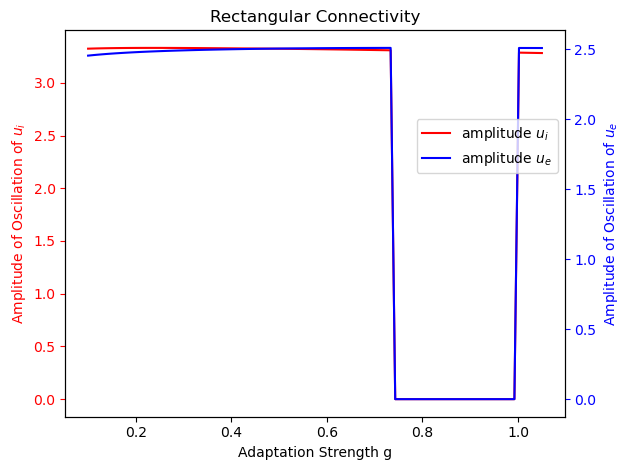

In [31]:
name = 'Simulation_Data/gauss_result_g'
res = {}
with h5py.File(name, 'r') as f:
    for key in f:
        res[key] = f[key][()]
res['variable'] = res['variable'].decode('utf-8')

color_alpha = "darkorange"
color_e = "blue"
color_i = "red"

print("Gaussian Connectivity")
print("amplitude_e start: ",res['amplitude_e'][0])
print("amplitude_e stop: ",res['amplitude_e'][-1])
print("amplitude_i start: ",res['amplitude_i'][0])
print("amplitude_i stop: ",res['amplitude_i'][-1])
print()

# Plot Frequency and alpha_amplitude
fig, ax1 = plt.subplots(1, 1)

# Create a second y-axis for the alpha
ax1.plot(res['variable_values'], res['amplitude_i'], color=color_i, label=r"amplitude $u_i$")
ax1.set_ylabel(r'Amplitude of Oscillation of $u_i$',  color=color_i)
ax1.set_xlabel('Adaptation Strength g')
ax1.set_title('Gaussian Connectivity')
ax1.tick_params('y',  colors=color_i)

# Create a second y-axis for the alpha
ax2 = ax1.twinx()
ax2.plot(res['variable_values'], res['amplitude_e'], color=color_e, label=r"amplitude $u_e$")
ax2.set_ylabel(r'Amplitude of Oscillation of $u_e$',  color=color_e)
ax2.tick_params('y',  colors=color_e)

fig.legend(loc="center right", bbox_to_anchor=(1,0.7), bbox_transform=ax1.transAxes)
fig.tight_layout()
plt.show()

#######################################################################################################################

name = 'Simulation_Data/rect_result_g'
res = {}
with h5py.File(name, 'r') as f:
    for key in f:
        res[key] = f[key][()]
res['variable'] = res['variable'].decode('utf-8')

color_alpha = "darkorange"
color_e = "blue"
color_i = "red"

print("Rectangular Connectivity")
print("amplitude_e start: ",res['amplitude_e'][0])
print("amplitude_e stop: ",res['amplitude_e'][-1])
print("amplitude_i start: ",res['amplitude_i'][0])
print("amplitude_i max: ",np.max(res['amplitude_i']))
print("amplitude_i stop: ",res['amplitude_i'][-1])
print()

# Plot Frequency and alpha_amplitude
fig, ax1 = plt.subplots(1, 1)

# Create a second y-axis for the alpha
ax1.plot(res['variable_values'], res['amplitude_i'], color=color_i, label=r"amplitude $u_i$")
ax1.set_ylabel(r'Amplitude of Oscillation of $u_i$',  color=color_i)
ax1.set_xlabel('Adaptation Strength g')
ax1.tick_params('y',  colors=color_i)
ax1.set_title('Rectangular Connectivity')

# Create a second y-axis for the alpha
ax2 = ax1.twinx()
ax2.plot(res['variable_values'], res['amplitude_e'], color=color_e, label=r"amplitude $u_e$")
ax2.set_ylabel(r'Amplitude of Oscillation of $u_e$',  color=color_e)
ax2.tick_params('y',  colors=color_e)

fig.legend(loc="center right", bbox_to_anchor=(1,0.7), bbox_transform=ax1.transAxes)
fig.tight_layout()
plt.show()

### Adaptation Timeconstant

Gaussian Connectivity
amplitude_alpha start:  0.3404779429373223
amplitude_alpha stop:  0.17886230387204746
frequency start:  1.05625
frequency stop:  0.55



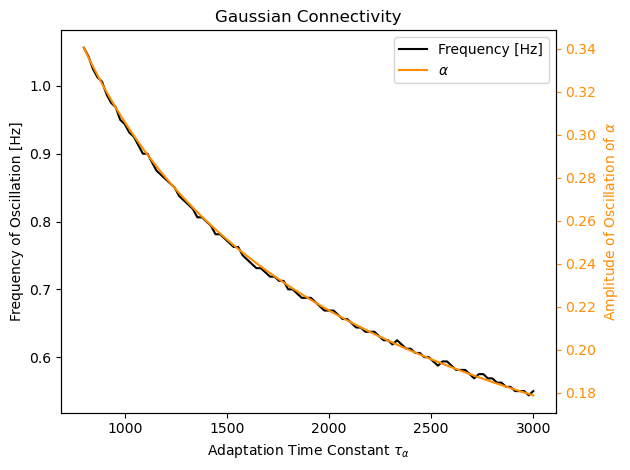

Rectangular Connectivity
amplitude_alpha start:  0.0
amplitude_alpha stop:  0.0
frequency start:  0.0
frequency stop:  0.00625



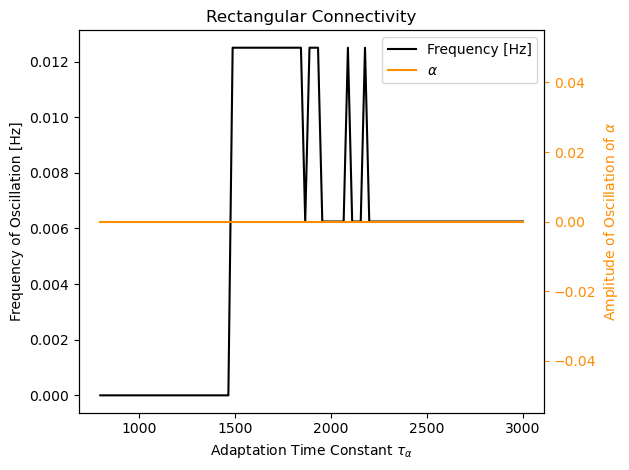

In [32]:
name = 'Simulation_Data/gauss_result_tau_alpha'
res = {}
with h5py.File(name, 'r') as f:
    for key in f:
        res[key] = f[key][()]
res['variable'] = res['variable'].decode('utf-8')

color_alpha = "darkorange"

print("Gaussian Connectivity")
print("amplitude_alpha start: ",res['amplitude_alpha'][0])
print("amplitude_alpha stop: ",res['amplitude_alpha'][-1])
print("frequency start: ",res['frequencies'][0])
print("frequency stop: ",res['frequencies'][-1])
print()

fig, ax1 = plt.subplots(1, 1)

# Create a second y-axis for the alpha
ax1.plot(res["variable_values"], res["frequencies"], label='Frequency [Hz]', color="black")
ax1.set_xlabel(r'Adaptation Time Constant $\tau_\alpha$')
ax1.set_ylabel('Frequency of Oscillation [Hz]')
ax1.set_title('Gaussian Connectivity')

# Create a second y-axis for the alpha
ax2 = ax1.twinx()
ax2.plot(res['variable_values'], res['amplitude_alpha'], color=color_alpha, label=r"$\alpha$")
ax2.set_ylabel(r'Amplitude of Oscillation of $\alpha$',  color=color_alpha)
ax2.tick_params('y',  colors=color_alpha)

fig.legend(loc="upper right", bbox_to_anchor=(1, 1), bbox_transform=ax1.transAxes)
fig.tight_layout()
plt.show()

#######################################################################################################################

name = 'Simulation_Data/rect_result_tau_alpha'
res = {}
with h5py.File(name, 'r') as f:
    for key in f:
        res[key] = f[key][()]
res['variable'] = res['variable'].decode('utf-8')

print("Rectangular Connectivity")
print("amplitude_alpha start: ",res['amplitude_alpha'][0])
print("amplitude_alpha stop: ",res['amplitude_alpha'][-1])
print("frequency start: ",res['frequencies'][0])
print("frequency stop: ",res['frequencies'][-1])
print()

fig, ax1 = plt.subplots(1, 1)

# Create a second y-axis for the alpha
ax1.plot(res["variable_values"], res["frequencies"], label='Frequency [Hz]', color="black")
ax1.set_xlabel(r'Adaptation Time Constant $\tau_\alpha$')
ax1.set_ylabel('Frequency of Oscillation [Hz]')
ax1.set_title('Rectangular Connectivity')

# Create a second y-axis for the alpha
ax2 = ax1.twinx()
ax2.plot(res['variable_values'], res['amplitude_alpha'], color=color_alpha, label=r"$\alpha$")
ax2.set_ylabel(r'Amplitude of Oscillation of $\alpha$',  color=color_alpha)
ax2.tick_params('y',  colors=color_alpha)

fig.legend(loc="upper right", bbox_to_anchor=(1, 1), bbox_transform=ax1.transAxes)
fig.tight_layout()
plt.show()


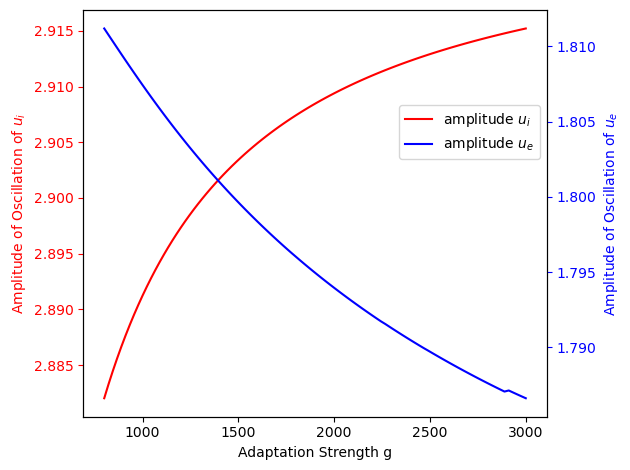

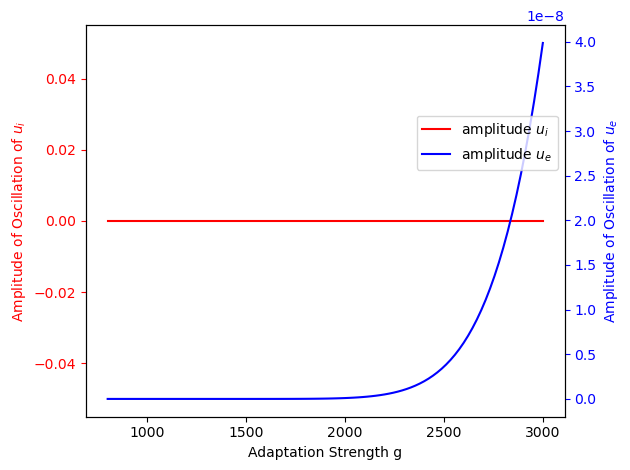

In [33]:
name = 'Simulation_Data/gauss_result_tau_alpha'
res = {}
with h5py.File(name, 'r') as f:
    for key in f:
        res[key] = f[key][()]
res['variable'] = res['variable'].decode('utf-8')

color_alpha = "darkorange"
color_e = "blue"
color_i = "red"

# Plot Frequency and alpha_amplitude
fig, ax1 = plt.subplots(1, 1)

# Create a second y-axis for the alpha
ax1.plot(res['variable_values'], res['amplitude_i'], color=color_i, label=r"amplitude $u_i$")
ax1.set_ylabel(r'Amplitude of Oscillation of $u_i$',  color=color_i)
ax1.set_xlabel('Adaptation Strength g')
ax1.tick_params('y',  colors=color_i)

# Create a second y-axis for the alpha
ax2 = ax1.twinx()
ax2.plot(res['variable_values'], res['amplitude_e'], color=color_e, label=r"amplitude $u_e$")
ax2.set_ylabel(r'Amplitude of Oscillation of $u_e$',  color=color_e)
ax2.tick_params('y',  colors=color_e)

fig.legend(loc="center right", bbox_to_anchor=(1,0.7), bbox_transform=ax1.transAxes)
fig.tight_layout()
plt.show()

#######################################################################################################################

name = 'Simulation_Data/rect_result_tau_alpha'
res = {}
with h5py.File(name, 'r') as f:
    for key in f:
        res[key] = f[key][()]
res['variable'] = res['variable'].decode('utf-8')

color_alpha = "darkorange"
color_e = "blue"
color_i = "red"

# Plot Frequency and alpha_amplitude
fig, ax1 = plt.subplots(1, 1)

# Create a second y-axis for the alpha
ax1.plot(res['variable_values'], res['amplitude_i'], color=color_i, label=r"amplitude $u_i$")
ax1.set_ylabel(r'Amplitude of Oscillation of $u_i$',  color=color_i)
ax1.set_xlabel('Adaptation Strength g')
ax1.tick_params('y',  colors=color_i)

# Create a second y-axis for the alpha
ax2 = ax1.twinx()
ax2.plot(res['variable_values'], res['amplitude_e'], color=color_e, label=r"amplitude $u_e$")
ax2.set_ylabel(r'Amplitude of Oscillation of $u_e$',  color=color_e)
ax2.tick_params('y',  colors=color_e)

fig.legend(loc="center right", bbox_to_anchor=(1,0.7), bbox_transform=ax1.transAxes)
fig.tight_layout()
plt.show()